In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
#tf.config.run_functions_eagerly(True)
import pandas
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from numpy.polynomial import Polynomial as Polyn
import math
from keras.models import Sequential
from keras.layers import Dense
import pylab as pl
from sklearn.preprocessing import MinMaxScaler
from tensorflow.python.ops import math_ops
import keras.backend as K
import keras

**Dataset**

In [ ]:
# YUCATAN

T0 = [1930,1940,1950,1960,1970,1980,1990,1995,2000,2005,2010,2015,2020]
Espa = [0.2775,0.2547,0.3596,0.4362,0.4501,0.4960,0.5636,0.6033,0.6284,0.6709,0.7039,.7153,0.773]
Bilin= [0.3850,0.4695,0.5407,0.4373,0.4647,0.4290,0.4015,0.3625,0.3388,0.3105,0.2734,.271,0.216]
Maya = [0.3375,0.2758,0.0998,0.1265,0.0852,0.0751,0.0349,0.0342,0.0328,0.0186,0.0227,.0137,0.011]

ll = len(T0)
print(ll)


13


In [ ]:
initiall = 8 #10

T0t = T0[initiall:ll]
Espat = Espa[initiall:ll]
Bilint = Bilin[initiall:ll]
Mayat = Maya[initiall:ll]

T0 = T0[0:initiall]
Espa = Espa[0:initiall]
Bilin = Bilin[0:initiall]
Maya = Maya[0:initiall]

print(T0,T0t)

[1930, 1940, 1950, 1960, 1970, 1980, 1990, 1995] [2000, 2005, 2010, 2015, 2020]


In [ ]:
# Para el enfoque evolucionario

ll = len(T0)

T0t = T0[8:ll]
Espat = Espa[8:ll]
Bilint = Bilin[8:ll]
Mayat = Maya[8:ll]

T0 = T0[0:8]
Espa = Espa[0:8]
Bilin = Bilin[0:8]
Maya = Maya[0:8]

print(T0)
print(T0t)


[1930, 1940, 1950, 1960, 1970, 1980, 1990, 1995]
[2000, 2005, 2010, 2015, 2020]


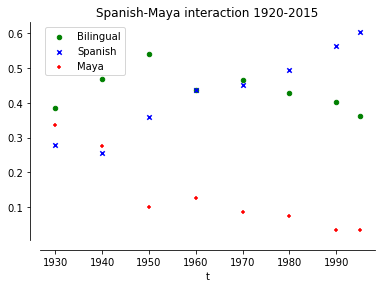

In [ ]:
fig,ax = plt.subplots()

ax.scatter(T0,Bilin, color = 'green',label='Bilingual',marker='o',s=20)
ax.scatter(T0,Espa, color = (0,0,1),label='Spanish',marker='x',s=20)
ax.scatter(T0,Maya, color = (1,0,0),label='Maya',marker='+',s=20)
ax.set_title(u"Spanish-Maya interaction 1920-2015")#1920-2015")
#ax.yaxis.title("t")
ax.set_xlabel("t")
#ax.set_ylabel("Casos registrados")
ax.spines['left'].set_position(('outward',10))
ax.spines['bottom'].set_position(('outward',10))
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
#ax.set_yticks(range(10),minor=True)
#ax.set_ylim([0,100])
ax.legend(framealpha=1)
#ax.legend(bbox_to_anchor=(1.1, 1.05))
ax.legend()#(loc="upper left", bbox_to_anchor=(0.8,0.2))
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
plt.show()

# Custom Loss

In [ ]:
import keras
import numpy as np
import tensorflow as tf
from tensorflow.python.ops import math_ops
#tf.config.run_functions_eagerly(False)
import keras.backend as K

In [ ]:
y_true = np.random.rand(3,6)#np.array([[10.,4.,5.,2.],[0.5,0.3,0.2],[0.7,0.2,0.1]])
y_pred = np.random.rand(3,6)#np.array([8.0,6.0])

a = keras.losses.MSE(y_true,y_pred)
print(a.numpy())

[0.17357233 0.29033941 0.17794263]


In [ ]:
model = keras.Sequential([ keras.layers.Dense(10,input_shape=(3,), activation='relu'),
                           keras.layers.Dense(1)])
model.compile(loss='mse',optimizer='adam')
X_train = np.array([[0.4,0.3,0.3],[0.5,0.3,0.2],[0.7,0.2,0.1]]) #np.array([[10.0],[20.0],[30.0],[40.0],[50.0],[60.0],[10.0],[20.0]])
y_train = y_true #np.array([6.,12,18,24,30,36,6,12])
model.fit(X_train,y_train, epochs=10)

Epoch 1/10
1/1 [==============================] - 1s 588ms/step - loss: 0.7953
Epoch 2/10
1/1 [==============================] - 0s 10ms/step - loss: 0.7834
Epoch 3/10
1/1 [==============================] - 0s 8ms/step - loss: 0.7715
Epoch 4/10
1/1 [==============================] - 0s 10ms/step - loss: 0.7598
Epoch 5/10
1/1 [==============================] - 0s 8ms/step - loss: 0.7483
Epoch 6/10
1/1 [==============================] - 0s 8ms/step - loss: 0.7369
Epoch 7/10
1/1 [==============================] - 0s 8ms/step - loss: 0.7256
Epoch 8/10
1/1 [==============================] - 0s 7ms/step - loss: 0.7144
Epoch 9/10
1/1 [==============================] - 0s 7ms/step - loss: 0.7034
Epoch 10/10
1/1 [==============================] - 0s 7ms/step - loss: 0.6926


In [ ]:
def custom_loss(y_true,y_pred):
  #y_pred = y_pred.numpy()
  #print(y_pred[:,0].numpy())
  f1 = y_pred[:,0]
  f2 = y_pred[:,1]
  f3 = y_pred[:,2]
  f4 = y_pred[:,3]
  #f5 = y_pred[:,4]
  #f5 = y_pred[:,5]
  a = f2 - f1
  b = f1 + f4 - f2 - f3
  c = f3 - f4
  n1 = len(y_true)

  """
  y_pred2 = tf.zeros([n1,3])
  y_pred2[:,0] = a
  y_pred2[:,1] = b
  y_pred2[:,2] = c
  """
  a = tf.reshape(a, [len(a), 1])
  b = tf.reshape(b, [len(b), 1])
  c = tf.reshape(c, [len(c), 1])

  y_pred2 = tf.concat((a, b ,c ),axis=1)
  #y_pred2 = tf.transpose(y_pred2)


  #y_pred2 = tf.concat((a, b ,c ),axis=0)
  #y_pred2 = tf.reshape(y_pred2, [n1, 3])
  #y_pred2 = tf.transpose(y_pred2)
  #y_pred2 = y_pred2.reshape((n1,3)).T
  #print(y_pred2)
  #print(y_true.numpy())
  #print(y_true.numpy())
  #y_pred2 = tf.convert_to_tensor(y_pred2, np.float32)
  diff = math_ops.squared_difference(y_pred2,y_true)
  loss = K.mean(diff, axis=-1)
  return loss

In [ ]:
def custom_loss2(y_true,y_pred):
  #y_pred = y_pred.numpy()
  #print(y_pred[:,0].numpy())
  f1 = y_pred[:,0]
  f2 = y_pred[:,1]
  f3 = y_pred[:,2]
  f4 = y_pred[:,3]
  x = y_pred[:,4]
  b = y_pred[:,5]
  y = y_pred[:,6]

  a = b*f2 - x*f1
  b = x*f1 + y*f4 - b*f2 - b*f3
  c = b*f3 - y*f4
  n1 = len(y_true)

  """
  y_pred2 = tf.zeros([n1,3])
  y_pred2[:,0] = a
  y_pred2[:,1] = b
  y_pred2[:,2] = c
  """
  a = tf.reshape(a, [len(a), 1])
  b = tf.reshape(b, [len(b), 1])
  c = tf.reshape(c, [len(c), 1])

  y_pred2 = tf.concat((a, b ,c ),axis=1)
  #y_pred2 = tf.transpose(y_pred2)


  #y_pred2 = tf.concat((a, b ,c ),axis=0)
  #y_pred2 = tf.reshape(y_pred2, [n1, 3])
  #y_pred2 = tf.transpose(y_pred2)
  #y_pred2 = y_pred2.reshape((n1,3)).T
  #print(y_pred2)
  #print(y_true.numpy())
  #print(y_true.numpy())
  #y_pred2 = tf.convert_to_tensor(y_pred2, np.float32)
  diff = math_ops.squared_difference(y_pred2,y_true)
  loss = K.mean(diff, axis=-1)
  return loss

In [ ]:
a = tf.constant([2.0, 3.0, 4.0, 3.0])
b = tf.constant([1.0, 3.0, 4.0, 2.0])
c = tf.constant([3.0, 3.0, 4.0, 1.0])

a = tf.reshape(a, [len(a), 1])
b = tf.reshape(b, [len(b), 1])
c = tf.reshape(c, [len(c), 1])

y_pred2 = tf.concat((a, b ,c ),axis=1)
#y_pred2 = tf.transpose(y_pred2)
print(y_pred2.numpy())

[[2. 1. 3.]
 [3. 3. 3.]
 [4. 4. 4.]
 [3. 2. 1.]]


In [ ]:
y_true = np.random.rand(4,3)#np.array([[10.,4.,5.,2.],[0.5,0.3,0.2],[0.7,0.2,0.1]])
y_pred = np.random.rand(4,6)#np.array([8.0,6.0])

#print(y_pred)

f1 = y_pred[:,0]
f2 = y_pred[:,1]
f3 = y_pred[:,2]
f4 = y_pred[:,3]
f5 = y_pred[:,4]
f5 = y_pred[:,5]
a = f2 - f1
b = f1 + f4 - f2 - f3
c = f3 - f4

print(a)

n1 = len(y_true)

y_pred2 = np.zeros((n1,3))
y_pred2[:,0] = a
y_pred2[:,1] = b
y_pred2[:,2] = c

y_pred3 = np.array([a,b,c]).T

print(y_pred2)
print(y_pred3)

[-0.69727326 -0.12647438 -0.18418565 -0.53041634]
[[-0.69727326  0.2818239   0.41544937]
 [-0.12647438  0.35501534 -0.22854097]
 [-0.18418565  0.84388609 -0.65970044]
 [-0.53041634  0.85481977 -0.32440343]]
[[-0.69727326  0.2818239   0.41544937]
 [-0.12647438  0.35501534 -0.22854097]
 [-0.18418565  0.84388609 -0.65970044]
 [-0.53041634  0.85481977 -0.32440343]]


In [ ]:
a = keras.losses.MSE(y_true,y_pred)
print(a.numpy())

In [ ]:
def custom_loss(y_true, y_pred):
 diff = math_ops.squared_difference(y_pred, y_true)  #squared difference
 loss = K.mean(diff, axis=-1) #mean over last dimension
 loss = loss / 10.0
 return loss

In [ ]:
X_train = np.array([[0.4,0.3,0.3],[0.5,0.3,0.2],[0.7,0.2,0.1],[0.8,0.1,0.1]]) #np.array([[10.0],[20.0],[30.0],[40.0],[50.0],[60.0],[10.0],[20.0]])
y_train = np.random.rand(4,3) #np.array([6.,12,18,24,30,36,6,12])

In [ ]:
y_pred = model.predict(X_train)
print(y_pred)

[[ 0.09513976  0.029966   -0.00918317  0.00404339  0.06616327  0.01733246]
 [ 0.15457524 -0.01000853 -0.00780295  0.01592837  0.17060138  0.02258731]
 [ 0.2237804   0.04186337  0.049201    0.08854987  0.27713472  0.03013287]]


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


In [ ]:
print(y_train)

[[0.22782824 0.96106038 0.47818285]
 [0.40868463 0.45663468 0.32206119]
 [0.68225791 0.44113846 0.1421239 ]
 [0.68687515 0.38253474 0.10458374]]


In [ ]:
model = keras.Sequential([keras.layers.Dense(10,activation='relu',input_shape=(3,)),
                          keras.layers.Dense(6)
])

model.compile(loss=custom_loss, optimizer='sgd')

model.fit(X_train,y_train, epochs=10)

Epoch 1/10


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


1/1 [==============================] - 0s 171ms/step - loss: 0.3664
Epoch 2/10
1/1 [==============================] - 0s 24ms/step - loss: 0.3658
Epoch 3/10
1/1 [==============================] - 0s 23ms/step - loss: 0.3653
Epoch 4/10
1/1 [==============================] - 0s 24ms/step - loss: 0.3648
Epoch 5/10
1/1 [==============================] - 0s 26ms/step - loss: 0.3643
Epoch 6/10
1/1 [==============================] - 0s 26ms/step - loss: 0.3639
Epoch 7/10
1/1 [==============================] - 0s 20ms/step - loss: 0.3634
Epoch 8/10
1/1 [==============================] - 0s 20ms/step - loss: 0.3630
Epoch 9/10
1/1 [==============================] - 0s 25ms/step - loss: 0.3626
Epoch 10/10
1/1 [==============================] - 0s 21ms/step - loss: 0.3622


In [ ]:
print(X_train.shape)
print(y_train.shape)

(3, 3)
(3, 3)


In [ ]:
print(y_train)

[[0.0097425  0.98117935 0.9692761 ]
 [0.53680645 0.6181857  0.6688668 ]
 [0.92653871 0.46750868 0.58287818]]


# Primer intento

In [ ]:
def derPoly(theta,t): # Derivada polinomial
        m1 = len(theta)
        pun= np.array(range(m1))
        #theta = np.dot(pun,theta)
        sum = 0
        for i in range(m1):
                t = float(t)
                if theta[i]*i*t != 0:
                        sum +=  theta[i]*i*t**(float(i-1))
                else:
                        sum += 0
        return sum

In [ ]:
def lineal(T,X):
  T = np.array(T)
  X = np.array(X)
 
  T = T.reshape(-1,1)
  X = X.reshape(-1,1)
 
  poly = PolynomialFeatures(degree=10)
  X_poly = poly.fit_transform(T)
  lin2 = LinearRegression()
 
 
  lin2.fit(X_poly,X)
 
  poly.fit(T,X)
 
  plt.scatter(T,X,color='red',label = 'Real')
  plt.plot(T,lin2.predict(poly.fit_transform(T)),label='Ajustada')
  plt.legend()
  plt.show()
 
  theta = lin2.coef_[0]
  #print(theta)
  theta[0] =  lin2.intercept_
  return theta


In [ ]:
def derPoly(theta,t): # Derivada polinomial
        m1 = len(theta)
        pun= np.array(range(m1))
        #theta = np.dot(pun,theta)
        sum = 0
        for i in range(m1):
                t = float(t)
                if theta[i]*i*t != 0:
                        sum +=  theta[i]*i*t**(float(i-1))
                else:
                        sum += 0
        return sum

def polinomio(theta,t):
        m1 = len(theta)
        sum = 0
        for i in range(m1):
                t = float(t)
                sum += theta[i]*t**(i)
        return sum

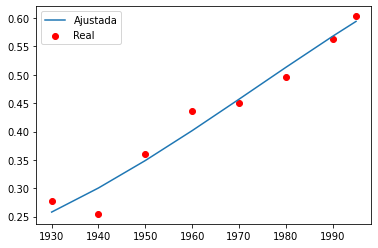

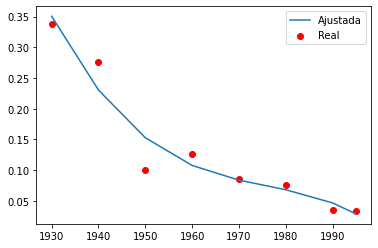

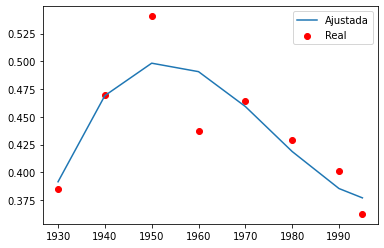

In [ ]:
theta1 = lineal(T0,Espa)
theta2 = lineal(T0,Maya)
theta3 = lineal(T0,Bilin)

In [ ]:
tfinal = T0[-1]
print(tfinal)

1995


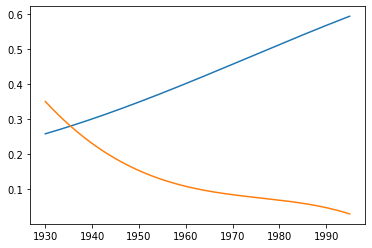

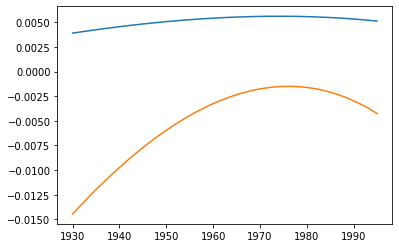

In [ ]:
T = np.linspace(1930,tfinal,1000).reshape(-1, 1) # 1995

dX = [] 
dY = []
dB = []

X = []
Y = [] 
B = []

for t in T:
  dx = derPoly(theta1,t)
  x  = polinomio(theta1,t)
  dy = derPoly(theta2,t)
  y  = polinomio(theta2,t)
  db = derPoly(theta3,t)
  b = polinomio(theta3,t)
  dX.append(dx)
  dY.append(dy)
  dB.append(db)
  X.append(x)
  Y.append(y)
  B.append(b)
 
X = np.array(X) 
Y = np.array(Y)
B = np.array(B)
dX = np.array(dX)
dY = np.array(dY)
dB = np.array(dB)

plt.plot(T,X)
plt.plot(T,Y)
plt.show()

plt.plot(T,dX)
plt.plot(T,dY)
plt.show()

Método clásico

Epoch 1/500
32/32 - 1s - loss: 9.2683e-05 - mae: 0.0066 - 561ms/epoch - 18ms/step
Epoch 2/500
32/32 - 0s - loss: 2.2981e-06 - mae: 0.0012 - 34ms/epoch - 1ms/step
Epoch 3/500
32/32 - 0s - loss: 3.3036e-07 - mae: 4.2981e-04 - 35ms/epoch - 1ms/step
Epoch 4/500
32/32 - 0s - loss: 2.1725e-07 - mae: 3.1969e-04 - 45ms/epoch - 1ms/step
Epoch 5/500
32/32 - 0s - loss: 2.0093e-07 - mae: 3.2063e-04 - 39ms/epoch - 1ms/step
Epoch 6/500
32/32 - 0s - loss: 1.5328e-07 - mae: 2.7267e-04 - 40ms/epoch - 1ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3099e-07 - mae: 2.5509e-04 - 42ms/epoch - 1ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1164e-07 - mae: 2.4704e-04 - 37ms/epoch - 1ms/step
Epoch 9/500
32/32 - 0s - loss: 9.0148e-08 - mae: 2.1665e-04 - 37ms/epoch - 1ms/step
Epoch 10/500
32/32 - 0s - loss: 6.9692e-08 - mae: 1.8570e-04 - 38ms/epoch - 1ms/step
Epoch 11/500
32/32 - 0s - loss: 6.4203e-08 - mae: 1.8490e-04 - 43ms/epoch - 1ms/step
Epoch 12/500
32/32 - 0s - loss: 5.4308e-08 - mae: 1.6922e-04 - 36ms/epoch - 1ms/

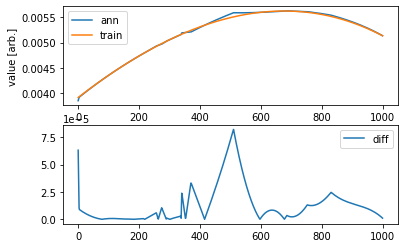

In [ ]:
X = X.reshape(-1,1)
Y = Y.reshape(-1,1)
dX= dX.reshape(-1,1)
dY= dY.reshape(-1,1)

#Xa = np.concatenate((X,X**2,Y,Y**2,X*Y),axis=1)
Xa = np.concatenate((X,Y),axis=1)
 
#x_scaler = MinMaxScaler()
#y_scaler = MinMaxScaler(feature_range=(-1.0, 1.0))
#y_scaler = MinMaxScaler()
 
#Xa = x_scaler.fit_transform(Xa)
#X = y_scaler.fit_transform(X)
 
model = Sequential()
model.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))
model.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))
model.add(Dense(1, activation='linear',use_bias=False))
 
 
model.compile(loss='mse', optimizer='adam', metrics=['mae'])
 
model.fit(Xa, dX, epochs=500, batch_size=32, verbose=2)
 
res = model.predict(Xa, batch_size=32)
 
#res_rscl = y_scaler.inverse_transform(res)
#Y_rscl = y_scaler.inverse_transform(dX)
 
pl.subplot(211)
pl.plot(res, label='ann')
pl.plot(dX, label='train')
pl.xlabel('#')
pl.ylabel('value [arb.]')
pl.legend()
pl.subplot(212)
pl.plot(np.abs(dX - res), label='diff')
pl.legend()
pl.show()

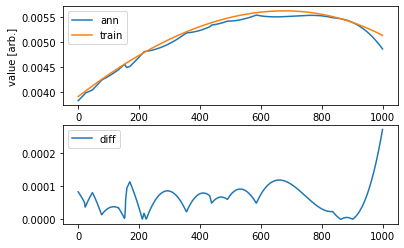

In [ ]:
res = model.predict(Xa, batch_size=32)
 
#res_rscl = y_scaler.inverse_transform(res)
#Y_rscl = y_scaler.inverse_transform(dX)
 
pl.subplot(211)
pl.plot(res, label='ann')
pl.plot(dX, label='train')
pl.xlabel('#')
pl.ylabel('value [arb.]')
pl.legend()
pl.subplot(212)
pl.plot(np.abs(dX - res), label='diff')
pl.legend()
pl.show()

Epoch 1/500
32/32 - 1s - loss: 1.9701e-04 - mae: 0.0105 - 583ms/epoch - 18ms/step
Epoch 2/500
32/32 - 0s - loss: 7.3735e-06 - mae: 0.0021 - 60ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.3186e-06 - mae: 9.2951e-04 - 57ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 7.1975e-07 - mae: 6.6523e-04 - 63ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.2409e-07 - mae: 5.0036e-04 - 58ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 2.4337e-07 - mae: 3.6181e-04 - 54ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3018e-07 - mae: 2.5389e-04 - 55ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 7.4798e-08 - mae: 1.8215e-04 - 56ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.7030e-08 - mae: 1.4097e-04 - 71ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6755e-08 - mae: 1.2969e-04 - 56ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0432e-08 - mae: 1.1965e-04 - 58ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6983e-08 - mae: 1.1012e-04 - 58ms/epoch - 2ms/

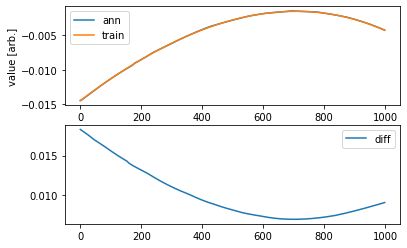

In [ ]:
#Xa = np.linspace(0.0 , 2.0 * np.pi, 10000).reshape(-1, 1)

X = X.reshape(-1,1)
Y = Y.reshape(-1,1)
dX= dX.reshape(-1,1)
dY= dY.reshape(-1,1)

#Xa2 = np.concatenate((X,X**2,Y,Y**2,X*Y),axis=1)
#print(Xa2[0])

Xa2 = np.concatenate((Y,X),axis=1)



#x_scaler = MinMaxScaler()
#y_scaler = MinMaxScaler(feature_range=(-1.0, 1.0))
#y_scaler = MinMaxScaler()
 
#Xa2 = x_scaler.fit_transform(Xa2)
#Y = y_scaler.fit_transform(Y)
 
model2 = Sequential()
model2.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))
model2.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))
model2.add(Dense(1, activation='linear',use_bias=False))
 
 
model2.compile(loss='mse', optimizer='adam', metrics=['mae'])
 
model2.fit(Xa2, dY, epochs=500, batch_size=32, verbose=2)
 
res2 = model2.predict(Xa2, batch_size=32)
 
#res_rscl2 = y_scaler.inverse_transform(res)
#Y_rscl2 = y_scaler.inverse_transform(dY)
 
pl.subplot(211)
pl.plot(res2, label='ann')
pl.plot(dY, label='train')
pl.xlabel('#')
pl.ylabel('value [arb.]')
pl.legend()
pl.subplot(212)
pl.plot(np.abs(dY - res), label='diff')
pl.legend()
pl.show()

In [ ]:
x0 = polinomio(theta1,1930)
y0 = polinomio(theta2,1930)
#y02= polinomio(theta2,1930)


Xn = [x0]
Bn = [1-x0-y0]
Yn = [y0]
#Yn2= [y02]

h = 1/10.
t = 1930
Tn = [t]
#D = []

j = 0

suma = 0

for i in range(int((2025-1930)*(1/h))):
  t  += h
  #p = [[x0,x0**2,y0,y0**2,x0*y0],]
  p1 = [[x0,y0]]
  p2 = [[y0,x0]]
  #p = x_scaler.fit_transform(Xa2)
  #d1 = model.predict([[x0,x0**2,y0,y0**2,x0*y0],])[0][0]
  d1 = model.predict(p1)[0][0]
  d2 = model2.predict(p2)[0][0]
  x1 = x0 + h*d1 #*res_rscl[i][0]
  y1 = y0 + h*d2 #res_rscl2[i][0]
  #print(t)

  if len(T0t) > j:
    if abs(t-float(T0t[j])) < 0.0001:
      print("AG")
      suma += (x1-Espat[j])**2 + (y1-Mayat[j])**2
      j += 1


  Xn.append(x1)
  Yn.append(y1)
  Bn.append(1-x1-y1)
  #Yn2.append(y2)
  Tn.append(t)
  x0 = x1 + 0
  y0 = y1 + 0
  #y02 = y2 + 0
print(suma)

0


In [ ]:
Trad = [0.03252960787637424,0.07452209734167309,0.05139384134851478,0.08021181171232922]

In [ ]:
print(T0t)

[2000, 2005, 2010]


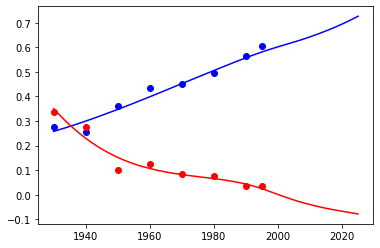

In [ ]:
plt.scatter(T0,Espa,color='blue')
plt.scatter(T0t,Espat,color='blue',marker='+')
plt.plot(Tn,Xn,color='blue')
plt.scatter(T0,Maya,color='red')
plt.scatter(T0t,Mayat,color='red',marker='+')
plt.plot(Tn,Yn,color='red')
plt.show()

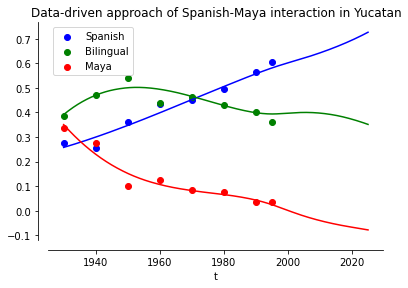

In [ ]:
fig,ax = plt.subplots()

ax.scatter(T0,Espa,color='blue',label='Spanish')
ax.scatter(T0t,Espat,color='blue',marker='+')
ax.plot(Tn,Xn,color='blue')
ax.scatter(T0,Bilin,color='green',label='Bilingual')
ax.scatter(T0t,Bilint,color='green',marker='+')
ax.plot(Tn,Bn,color='green')
ax.scatter(T0,Maya,color='red',label='Maya')
ax.scatter(T0t,Mayat,color='red',marker='+')
ax.plot(Tn,Yn,color='red')

#ax.scatter(T0,Bilin, color = (0.4,0.7,0.3),label='Bilingual',marker='o',s=20)
#ax.scatter(T0,Espa, color = (0,0,1),label='Spanish',marker='x',s=20)
#ax.scatter(T0,Maya, color = (1,0,0),label='Maya',marker='+',s=20)
ax.set_title(u"Data-driven approach of Spanish-Maya interaction in Yucatan")#1920-2015")
#ax.yaxis.title("t")
ax.set_xlabel("t")
#ax.set_ylabel("Casos registrados")
ax.spines['left'].set_position(('outward',10))
ax.spines['bottom'].set_position(('outward',10))
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
#ax.set_yticks(range(10),minor=True)
#ax.set_ylim([0,100])
ax.legend(framealpha=1)
#ax.legend(bbox_to_anchor=(1.1, 1.05))
ax.legend()#(loc="upper left", bbox_to_anchor=(0.8,0.2))
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
plt.savefig('traditional.eps')
plt.show()

In [ ]:
def train1(X,Y,dX,dY):
  X = X.reshape(-1,1)
  Y = Y.reshape(-1,1)
  dX= dX.reshape(-1,1)
  dY= dY.reshape(-1,1)

  #Xa = np.concatenate((X,X**2,Y,Y**2,X*Y),axis=1)
  Xa = np.concatenate((X,Y),axis=1)
  
  model = Sequential()
  model.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))
  model.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))
  model.add(Dense(1, activation='linear',use_bias=False))
  
  model.compile(loss='mse', optimizer='adam', metrics=['mae'])
  
  model.fit(Xa, dX, epochs=500, batch_size=32, verbose=2)
  
  res = model.predict(Xa, batch_size=32)  
  
  pl.subplot(211)
  pl.plot(res, label='ann')
  pl.plot(dX, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(212)
  pl.plot(np.abs(dX - res), label='diff')
  pl.legend()
  pl.show()

  X = X.reshape(-1,1)
  Y = Y.reshape(-1,1)
  dX= dX.reshape(-1,1)
  dY= dY.reshape(-1,1)

  Xa2 = np.concatenate((Y,X),axis=1)
  
  model2 = Sequential()
  model2.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))
  model2.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))
  model2.add(Dense(1, activation='linear',use_bias=False))
    
  model2.compile(loss='mse', optimizer='adam', metrics=['mae'])
  
  model2.fit(Xa2, dY, epochs=500, batch_size=32, verbose=2)
  
  res2 = model2.predict(Xa2, batch_size=32)
  
  pl.subplot(211)
  pl.plot(res2, label='ann')
  pl.plot(dY, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(212)
  pl.plot(np.abs(dY - res), label='diff')
  pl.legend()
  pl.show()

  x0 = polinomio(theta1,1930)
  y0 = polinomio(theta2,1930)
  #y02= polinomio(theta2,1930)


  Xn = [x0]
  Bn = [1-x0-y0]
  Yn = [y0]
  #Yn2= [y02]

  h = 1/10.
  t = 1930
  Tn = [t]
  #D = []

  j = 0

  suma = 0

  for i in range(int((2025-1930)*(1/h))):
    t  += h
    #p = [[x0,x0**2,y0,y0**2,x0*y0],]
    p1 = [[x0,y0]]
    p2 = [[y0,x0]]
    #p = x_scaler.fit_transform(Xa2)
    #d1 = model.predict([[x0,x0**2,y0,y0**2,x0*y0],])[0][0]
    d1 = model.predict(p1)[0][0]
    d2 = model2.predict(p2)[0][0]
    x1 = x0 + h*d1 #*res_rscl[i][0]
    y1 = y0 + h*d2 #res_rscl2[i][0]
    #print(t)

    if len(T0t) > j:
      if abs(t-float(T0t[j])) < 0.0001:
        print("AG")
        suma += (x1-Espat[j])**2 + (y1-Mayat[j])**2
        j += 1


    Xn.append(x1)
    Yn.append(y1)
    Bn.append(1-x1-y1)
    #Yn2.append(y2)
    Tn.append(t)
    x0 = x1 + 0
    y0 = y1 + 0
    #y02 = y2 + 0
  print(suma)

  fig,ax = plt.subplots()

  ax.scatter(T0,Espa,color='blue',label='Spanish')
  ax.scatter(T0t,Espat,color='blue',marker='+')
  ax.plot(Tn,Xn,color='blue')
  ax.scatter(T0,Bilin,color='green',label='Bilingual')
  ax.scatter(T0t,Bilint,color='green',marker='+')
  ax.plot(Tn,Bn,color='green')
  ax.scatter(T0,Maya,color='red',label='Maya')
  ax.scatter(T0t,Mayat,color='red',marker='+')
  ax.plot(Tn,Yn,color='red')

  #ax.scatter(T0,Bilin, color = (0.4,0.7,0.3),label='Bilingual',marker='o',s=20)
  #ax.scatter(T0,Espa, color = (0,0,1),label='Spanish',marker='x',s=20)
  #ax.scatter(T0,Maya, color = (1,0,0),label='Maya',marker='+',s=20)
  ax.set_title(u"Data-driven approach of Spanish-Maya interaction in Yucatan")#1920-2015")
  #ax.yaxis.title("t")
  ax.set_xlabel("t")
  #ax.set_ylabel("Casos registrados")
  ax.spines['left'].set_position(('outward',10))
  ax.spines['bottom'].set_position(('outward',10))
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  #ax.set_yticks(range(10),minor=True)
  #ax.set_ylim([0,100])
  ax.legend(framealpha=1)
  #ax.legend(bbox_to_anchor=(1.1, 1.05))
  ax.legend()#(loc="upper left", bbox_to_anchor=(0.8,0.2))
  ax.yaxis.set_ticks_position('left')
  ax.xaxis.set_ticks_position('bottom')
  plt.savefig('traditional.eps')
  plt.show()

  return suma

Epoch 1/500
32/32 - 0s - loss: 6.2480e-05 - mae: 0.0060 - 471ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 2.3715e-06 - mae: 0.0012 - 66ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.6572e-07 - mae: 3.0025e-04 - 59ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 3.1457e-08 - mae: 1.3744e-04 - 56ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.1736e-08 - mae: 1.1490e-04 - 51ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4284e-08 - mae: 9.5160e-05 - 52ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0822e-08 - mae: 8.2584e-05 - 61ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 8.1759e-09 - mae: 7.2950e-05 - 54ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 6.9457e-09 - mae: 6.7129e-05 - 53ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.9769e-09 - mae: 6.3062e-05 - 52ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 5.2305e-09 - mae: 5.8173e-05 - 50ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 4.4837e-09 - mae: 5.6057e-05 - 55ms/epoch - 2ms/

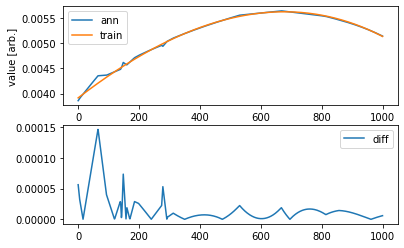

Epoch 1/500
32/32 - 0s - loss: 9.2890e-05 - mae: 0.0072 - 459ms/epoch - 14ms/step
Epoch 2/500
32/32 - 0s - loss: 3.2017e-06 - mae: 0.0014 - 53ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 4.2610e-07 - mae: 5.0665e-04 - 54ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6351e-07 - mae: 3.1404e-04 - 53ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0597e-07 - mae: 2.5281e-04 - 54ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 8.8894e-08 - mae: 2.3222e-04 - 67ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 7.6187e-08 - mae: 2.1773e-04 - 55ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.4064e-08 - mae: 1.7700e-04 - 54ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3109e-08 - mae: 1.5891e-04 - 56ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.3508e-08 - mae: 1.5984e-04 - 53ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.4750e-08 - mae: 1.4267e-04 - 56ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.9455e-08 - mae: 1.2843e-04 - 57ms/epoch - 2ms/

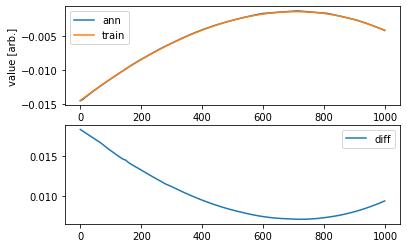

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.07249029938117227


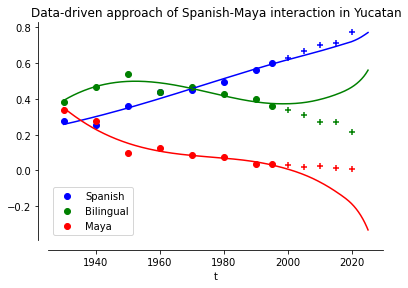

Epoch 1/500
32/32 - 0s - loss: 0.0017 - mae: 0.0300 - 497ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 3.3713e-05 - mae: 0.0047 - 58ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.5350e-06 - mae: 0.0013 - 58ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 4.9309e-07 - mae: 5.6157e-04 - 71ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.5261e-07 - mae: 3.6594e-04 - 65ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.7125e-07 - mae: 2.7842e-04 - 68ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1176e-07 - mae: 2.2958e-04 - 67ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 8.1950e-08 - mae: 1.8770e-04 - 66ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 5.3286e-08 - mae: 1.5153e-04 - 66ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.5723e-08 - mae: 1.2344e-04 - 66ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.5547e-08 - mae: 1.0653e-04 - 77ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 1.8658e-08 - mae: 9.0839e-05 - 75ms/epoch - 2ms/step
Epo

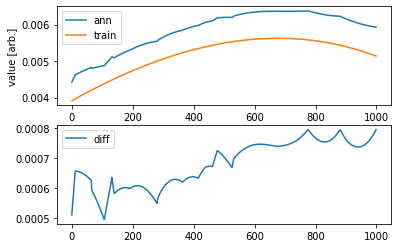

Epoch 1/500
32/32 - 0s - loss: 6.1010e-05 - mae: 0.0060 - 496ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 2.7950e-06 - mae: 0.0014 - 75ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 9.5307e-07 - mae: 7.6760e-04 - 80ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 6.9097e-07 - mae: 6.3646e-04 - 56ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 5.4175e-07 - mae: 5.4175e-04 - 57ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.5869e-07 - mae: 4.8057e-04 - 59ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 4.0482e-07 - mae: 4.5812e-04 - 63ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 4.7186e-07 - mae: 5.1556e-04 - 56ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4640e-07 - mae: 4.2975e-04 - 58ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.3135e-07 - mae: 4.1899e-04 - 61ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.1758e-07 - mae: 4.1157e-04 - 66ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.9162e-07 - mae: 3.9323e-04 - 67ms/epoch - 2ms/

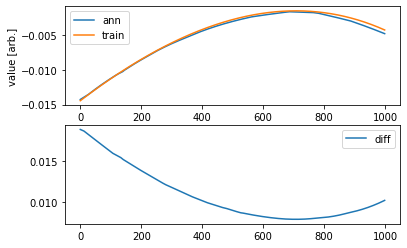

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.09878491021093194


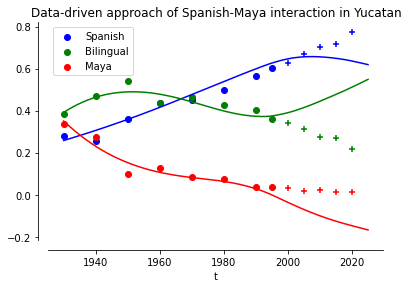

Epoch 1/500
32/32 - 0s - loss: 6.9979e-05 - mae: 0.0065 - 500ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 2.4225e-06 - mae: 0.0013 - 62ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.1806e-07 - mae: 2.6119e-04 - 62ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 3.6483e-08 - mae: 1.3690e-04 - 61ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.7839e-08 - mae: 1.2136e-04 - 58ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 2.7721e-08 - mae: 1.2505e-04 - 59ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 2.5699e-08 - mae: 1.2232e-04 - 61ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 2.1933e-08 - mae: 1.1030e-04 - 57ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.1277e-08 - mae: 1.1297e-04 - 59ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 1.8576e-08 - mae: 1.0430e-04 - 63ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 1.8650e-08 - mae: 1.0450e-04 - 63ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 1.6323e-08 - mae: 9.9809e-05 - 58ms/epoch - 2ms/

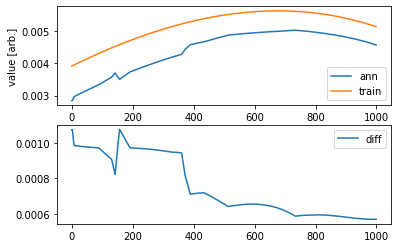

Epoch 1/500
32/32 - 0s - loss: 3.7945e-04 - mae: 0.0144 - 449ms/epoch - 14ms/step
Epoch 2/500
32/32 - 0s - loss: 1.1148e-05 - mae: 0.0026 - 69ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.3153e-06 - mae: 9.1331e-04 - 60ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 6.6937e-07 - mae: 6.7355e-04 - 60ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.6940e-07 - mae: 5.6663e-04 - 69ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.2952e-07 - mae: 4.7910e-04 - 77ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 2.3185e-07 - mae: 4.0678e-04 - 66ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.7054e-07 - mae: 3.4519e-04 - 62ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.3699e-07 - mae: 3.0323e-04 - 75ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2108e-07 - mae: 2.7725e-04 - 64ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1965e-07 - mae: 2.6988e-04 - 80ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0592e-07 - mae: 2.5032e-04 - 69ms/epoch - 2ms/

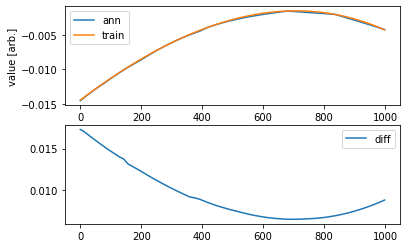

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.05435699792029483


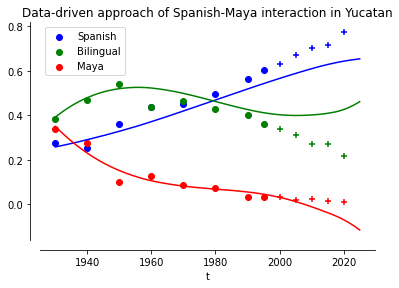

Epoch 1/500
32/32 - 1s - loss: 2.8250e-04 - mae: 0.0125 - 532ms/epoch - 17ms/step
Epoch 2/500
32/32 - 0s - loss: 1.3426e-05 - mae: 0.0029 - 75ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.1014e-06 - mae: 0.0012 - 71ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 6.6719e-07 - mae: 6.2907e-04 - 74ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 3.2551e-07 - mae: 4.3847e-04 - 61ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.9619e-07 - mae: 3.4200e-04 - 74ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3322e-07 - mae: 2.8926e-04 - 58ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 9.1636e-08 - mae: 2.4189e-04 - 63ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 6.7731e-08 - mae: 2.0856e-04 - 61ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.3595e-08 - mae: 1.8707e-04 - 66ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 4.5765e-08 - mae: 1.7389e-04 - 58ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.7736e-08 - mae: 1.5767e-04 - 61ms/epoch - 2ms/step

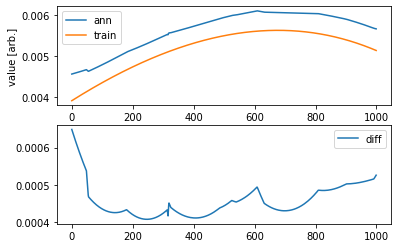

Epoch 1/500
32/32 - 0s - loss: 2.1344e-04 - mae: 0.0105 - 473ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 7.7478e-06 - mae: 0.0021 - 68ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.1517e-06 - mae: 8.6454e-04 - 59ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.8570e-07 - mae: 6.3836e-04 - 77ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 3.7420e-07 - mae: 5.1708e-04 - 83ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.4310e-07 - mae: 4.1152e-04 - 71ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5132e-07 - mae: 3.2336e-04 - 72ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.2357e-07 - mae: 2.8317e-04 - 74ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 7.6446e-08 - mae: 2.2296e-04 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.2410e-08 - mae: 1.9803e-04 - 73ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 5.3928e-08 - mae: 1.8160e-04 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.3084e-08 - mae: 1.7960e-04 - 78ms/epoch - 2ms/

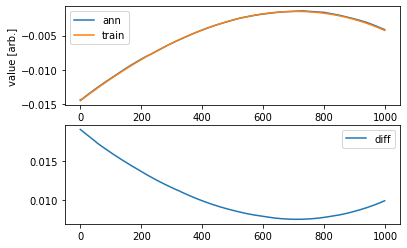

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.13000703450153595


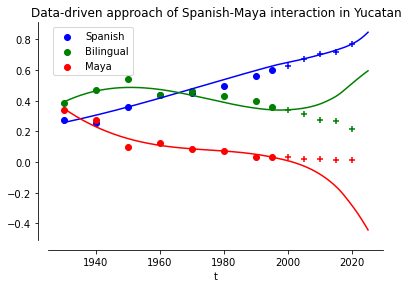

Epoch 1/500
32/32 - 0s - loss: 1.6590e-04 - mae: 0.0084 - 467ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 5.4889e-06 - mae: 0.0019 - 81ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2060e-06 - mae: 8.4946e-04 - 66ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 6.4217e-07 - mae: 5.9953e-04 - 63ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 3.7735e-07 - mae: 4.8336e-04 - 59ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 2.0868e-07 - mae: 3.7305e-04 - 65ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.6011e-07 - mae: 3.3692e-04 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4114e-07 - mae: 3.2130e-04 - 60ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.1482e-07 - mae: 2.9260e-04 - 64ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 9.7073e-08 - mae: 2.6933e-04 - 60ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 7.0629e-08 - mae: 2.3266e-04 - 64ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.1757e-08 - mae: 2.0140e-04 - 69ms/epoch - 2ms/

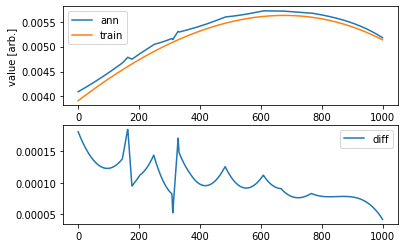

Epoch 1/500
32/32 - 0s - loss: 2.8147e-04 - mae: 0.0121 - 480ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 6.0417e-06 - mae: 0.0019 - 76ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 3.3470e-07 - mae: 4.6478e-04 - 70ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 9.8088e-08 - mae: 2.3716e-04 - 84ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.5660e-08 - mae: 1.9336e-04 - 68ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.7810e-08 - mae: 1.5841e-04 - 65ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 2.8459e-08 - mae: 1.3907e-04 - 60ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 2.6420e-08 - mae: 1.2947e-04 - 73ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.3966e-08 - mae: 1.2276e-04 - 61ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 2.2340e-08 - mae: 1.1726e-04 - 63ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1191e-08 - mae: 1.1525e-04 - 64ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.0521e-08 - mae: 1.0982e-04 - 70ms/epoch - 2ms/

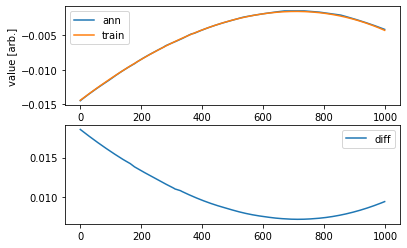

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.32257854174299244


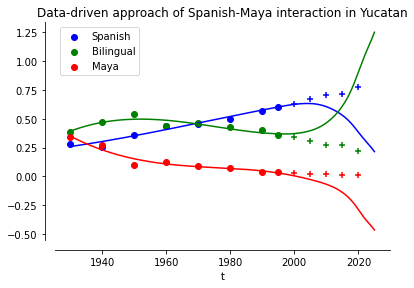

Epoch 1/500
32/32 - 0s - loss: 7.0901e-05 - mae: 0.0059 - 482ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 1.8535e-06 - mae: 0.0011 - 64ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 3.4993e-07 - mae: 4.5958e-04 - 72ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.7258e-07 - mae: 4.0940e-04 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.0895e-07 - mae: 3.5254e-04 - 65ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8338e-07 - mae: 3.3368e-04 - 73ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2515e-07 - mae: 2.6484e-04 - 62ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 9.5171e-08 - mae: 2.2531e-04 - 74ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 8.5636e-08 - mae: 2.1415e-04 - 66ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 8.1602e-08 - mae: 2.1836e-04 - 65ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 6.7880e-08 - mae: 1.8736e-04 - 72ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 6.8202e-08 - mae: 1.9668e-04 - 92ms/epoch - 3ms/

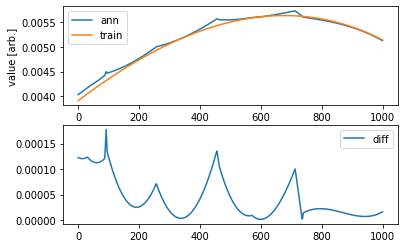

Epoch 1/500
32/32 - 0s - loss: 2.6611e-04 - mae: 0.0122 - 455ms/epoch - 14ms/step
Epoch 2/500
32/32 - 0s - loss: 8.8931e-06 - mae: 0.0023 - 86ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2355e-06 - mae: 8.7752e-04 - 66ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.3632e-07 - mae: 6.0510e-04 - 67ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.8078e-07 - mae: 4.1781e-04 - 67ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.7923e-07 - mae: 3.4705e-04 - 63ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.4914e-07 - mae: 3.1667e-04 - 68ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1623e-07 - mae: 2.7719e-04 - 82ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.5475e-08 - mae: 2.5317e-04 - 69ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 7.7683e-08 - mae: 2.2723e-04 - 68ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 6.5228e-08 - mae: 2.0915e-04 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.7165e-08 - mae: 1.9493e-04 - 69ms/epoch - 2ms/

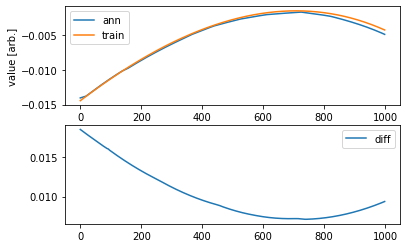

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.20412209063901995


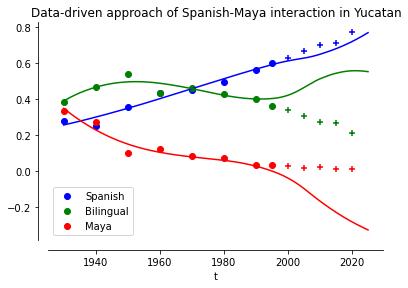

Epoch 1/500
32/32 - 0s - loss: 2.4641e-05 - mae: 0.0037 - 487ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 6.7658e-07 - mae: 6.6271e-04 - 68ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 9.8250e-08 - mae: 2.4774e-04 - 74ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.7344e-08 - mae: 1.3387e-04 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 9.4590e-09 - mae: 7.7414e-05 - 74ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.5770e-09 - mae: 5.2414e-05 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.0348e-09 - mae: 4.1996e-05 - 78ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 2.6744e-09 - mae: 3.9587e-05 - 74ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.1318e-09 - mae: 3.5044e-05 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.9235e-09 - mae: 3.3218e-05 - 76ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.7915e-09 - mae: 4.3066e-05 - 68ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.2169e-09 - mae: 3.6851e-05 - 79ms/epoch - 

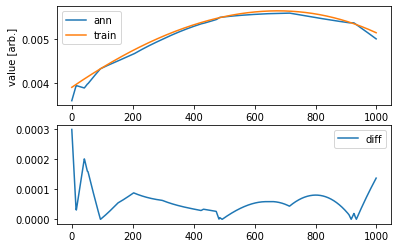

Epoch 1/500
32/32 - 0s - loss: 2.2379e-04 - mae: 0.0110 - 464ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 8.2156e-06 - mae: 0.0022 - 84ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.2823e-06 - mae: 0.0012 - 68ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6249e-06 - mae: 0.0010 - 76ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.1485e-06 - mae: 8.6146e-04 - 69ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9539e-07 - mae: 6.9140e-04 - 70ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 5.4267e-07 - mae: 5.4906e-04 - 67ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 4.2627e-07 - mae: 4.8779e-04 - 72ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.9198e-07 - mae: 3.9658e-04 - 79ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 2.0323e-07 - mae: 3.3335e-04 - 69ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 1.5622e-07 - mae: 2.9369e-04 - 71ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 1.3043e-07 - mae: 2.7695e-04 - 66ms/epoch - 2ms/step
Epo

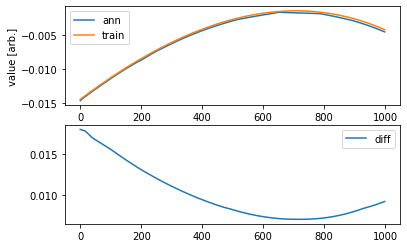

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.16822256133920482


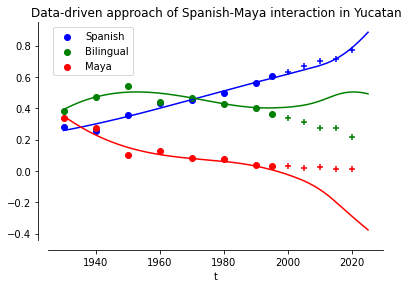

Epoch 1/500
32/32 - 1s - loss: 5.1562e-05 - mae: 0.0048 - 552ms/epoch - 17ms/step
Epoch 2/500
32/32 - 0s - loss: 1.8978e-06 - mae: 0.0010 - 80ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7149e-07 - mae: 3.2548e-04 - 69ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 6.8440e-08 - mae: 1.9479e-04 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.2214e-08 - mae: 1.6371e-04 - 71ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.8265e-08 - mae: 1.5667e-04 - 73ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 4.8320e-08 - mae: 1.5717e-04 - 65ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 4.4428e-08 - mae: 1.5686e-04 - 71ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.5875e-08 - mae: 1.2955e-04 - 68ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.5078e-08 - mae: 1.5881e-04 - 70ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 4.8660e-08 - mae: 1.6284e-04 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4196e-08 - mae: 1.3373e-04 - 71ms/epoch - 2ms/

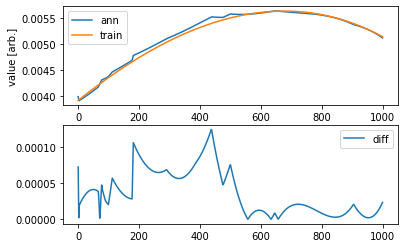

Epoch 1/500
32/32 - 1s - loss: 8.8389e-04 - mae: 0.0214 - 526ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 2.1496e-05 - mae: 0.0037 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.5602e-06 - mae: 9.9762e-04 - 83ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.2676e-07 - mae: 5.5659e-04 - 87ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.2332e-07 - mae: 4.7581e-04 - 77ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 2.7742e-07 - mae: 4.2361e-04 - 86ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.5750e-07 - mae: 3.9781e-04 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.1971e-07 - mae: 3.5714e-04 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.1619e-07 - mae: 3.5079e-04 - 97ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.0163e-07 - mae: 3.3116e-04 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1032e-07 - mae: 3.3891e-04 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.0995e-07 - mae: 3.4182e-04 - 79ms/epoch - 2ms/

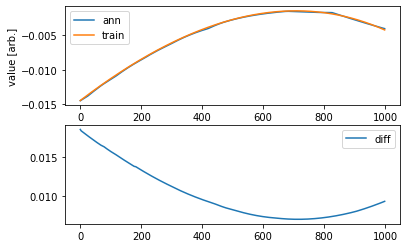

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.06613283043314652


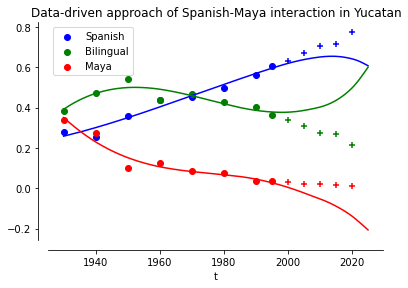

Epoch 1/500
32/32 - 1s - loss: 2.1586e-04 - mae: 0.0106 - 674ms/epoch - 21ms/step
Epoch 2/500
32/32 - 0s - loss: 6.1524e-06 - mae: 0.0019 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.4082e-07 - mae: 5.2886e-04 - 140ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.0898e-07 - mae: 3.5517e-04 - 113ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.6762e-07 - mae: 3.2391e-04 - 113ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3012e-07 - mae: 2.8922e-04 - 136ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1104e-07 - mae: 2.6587e-04 - 115ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 9.5518e-08 - mae: 2.5151e-04 - 128ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 7.7897e-08 - mae: 2.2624e-04 - 134ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 6.1677e-08 - mae: 2.0472e-04 - 121ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 5.2763e-08 - mae: 1.8623e-04 - 126ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 4.0200e-08 - mae: 1.5970e-04 - 107ms/ep

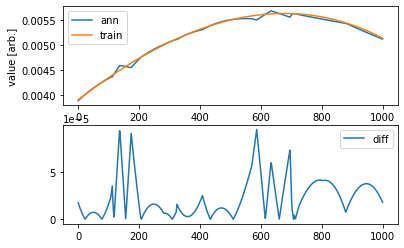

Epoch 1/500
32/32 - 1s - loss: 3.9263e-04 - mae: 0.0147 - 517ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 1.7069e-05 - mae: 0.0031 - 80ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 9.0695e-07 - mae: 7.6722e-04 - 75ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.9667e-07 - mae: 3.6376e-04 - 85ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.3987e-07 - mae: 3.0801e-04 - 83ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.1399e-07 - mae: 2.7484e-04 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.1593e-08 - mae: 2.4401e-04 - 74ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.5887e-08 - mae: 2.0548e-04 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.0182e-08 - mae: 1.7819e-04 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.2376e-08 - mae: 1.6144e-04 - 92ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.2024e-08 - mae: 1.3947e-04 - 84ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6604e-08 - mae: 1.2630e-04 - 78ms/epoch - 2ms/

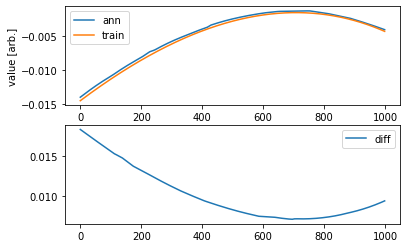

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.04129412332920217


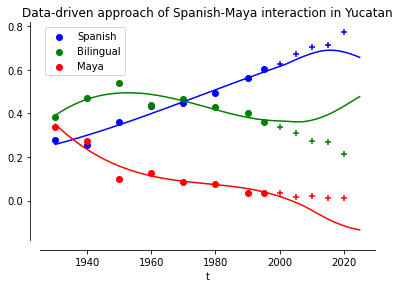

Epoch 1/500
32/32 - 1s - loss: 4.2018e-04 - mae: 0.0155 - 513ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4149e-05 - mae: 0.0030 - 82ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4745e-06 - mae: 9.1001e-04 - 81ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.0715e-07 - mae: 4.5691e-04 - 75ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.5422e-07 - mae: 3.0267e-04 - 80ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9054e-08 - mae: 2.2611e-04 - 84ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.0189e-08 - mae: 1.8577e-04 - 79ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.5445e-08 - mae: 1.5812e-04 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.1785e-08 - mae: 1.4700e-04 - 82ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.6880e-08 - mae: 1.3317e-04 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.3498e-08 - mae: 1.2467e-04 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.4693e-08 - mae: 1.2688e-04 - 98ms/epoch - 3ms/

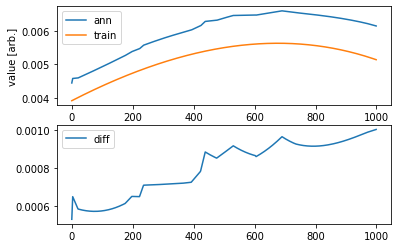

Epoch 1/500
32/32 - 0s - loss: 1.9661e-04 - mae: 0.0106 - 473ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 4.8339e-06 - mae: 0.0018 - 79ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.4331e-07 - mae: 4.0439e-04 - 76ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 7.4509e-08 - mae: 2.1337e-04 - 81ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.5812e-08 - mae: 1.7566e-04 - 75ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.7703e-08 - mae: 1.6452e-04 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.2606e-08 - mae: 1.5692e-04 - 75ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.5809e-08 - mae: 1.4592e-04 - 77ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.0561e-08 - mae: 1.3455e-04 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 2.6558e-08 - mae: 1.2457e-04 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.3235e-08 - mae: 1.1871e-04 - 95ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.0701e-08 - mae: 1.1342e-04 - 98ms/epoch - 3ms/

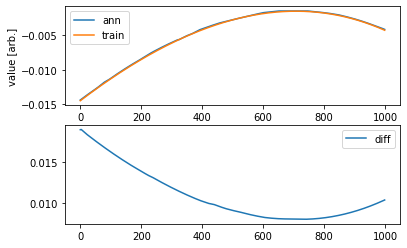

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.038446028643305145


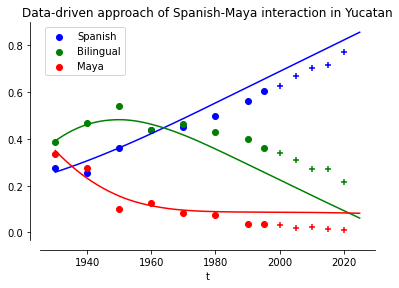

Epoch 1/500
32/32 - 1s - loss: 8.3368e-04 - mae: 0.0211 - 521ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6031e-05 - mae: 0.0032 - 90ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7289e-06 - mae: 0.0011 - 88ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.2463e-07 - mae: 6.5653e-04 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.4122e-07 - mae: 5.5193e-04 - 104ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.2800e-07 - mae: 4.7913e-04 - 100ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.5889e-07 - mae: 4.2170e-04 - 74ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.9849e-07 - mae: 3.7005e-04 - 78ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.5982e-07 - mae: 3.3066e-04 - 82ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3432e-07 - mae: 2.9852e-04 - 76ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1388e-07 - mae: 2.7458e-04 - 86ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 9.0784e-08 - mae: 2.4342e-04 - 76ms/epoch - 2ms/st

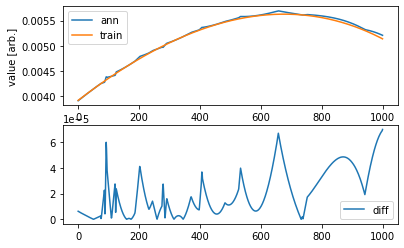

Epoch 1/500
32/32 - 1s - loss: 2.0317e-04 - mae: 0.0108 - 508ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 6.2361e-06 - mae: 0.0020 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0322e-06 - mae: 8.2256e-04 - 86ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.3271e-07 - mae: 5.7996e-04 - 105ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.4804e-07 - mae: 4.5947e-04 - 86ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.5307e-07 - mae: 3.8657e-04 - 88ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.8414e-07 - mae: 3.1937e-04 - 83ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.5034e-07 - mae: 2.9037e-04 - 81ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0998e-07 - mae: 2.4208e-04 - 85ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.1671e-08 - mae: 2.2702e-04 - 81ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.6799e-08 - mae: 1.8396e-04 - 79ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.4034e-08 - mae: 1.6638e-04 - 81ms/epoch - 3ms

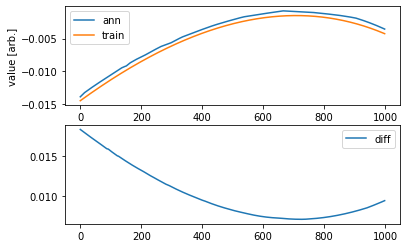

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.0659826345948115


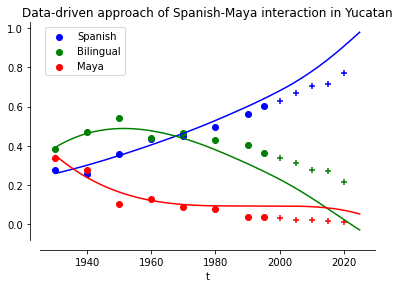

Epoch 1/500
32/32 - 1s - loss: 1.9983e-05 - mae: 0.0033 - 541ms/epoch - 17ms/step
Epoch 2/500
32/32 - 0s - loss: 7.6016e-07 - mae: 6.6338e-04 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.9684e-07 - mae: 3.3047e-04 - 72ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3229e-07 - mae: 2.4412e-04 - 84ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.7957e-08 - mae: 2.0262e-04 - 73ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 8.1830e-08 - mae: 1.9148e-04 - 75ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 7.2514e-08 - mae: 1.8778e-04 - 78ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.4400e-08 - mae: 1.7708e-04 - 86ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.2160e-08 - mae: 1.5735e-04 - 80ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.3619e-08 - mae: 1.5013e-04 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.2363e-08 - mae: 1.5318e-04 - 82ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.6904e-08 - mae: 1.6210e-04 - 79ms/epoch - 

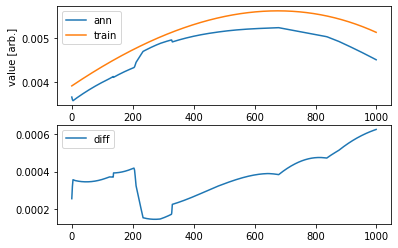

Epoch 1/500
32/32 - 0s - loss: 6.8094e-05 - mae: 0.0061 - 470ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 2.4408e-06 - mae: 0.0012 - 76ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 6.3927e-07 - mae: 5.9227e-04 - 68ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.1671e-07 - mae: 5.2978e-04 - 88ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.4071e-07 - mae: 4.8782e-04 - 82ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.8446e-07 - mae: 4.4175e-04 - 78ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 4.0221e-07 - mae: 4.7788e-04 - 72ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.2110e-07 - mae: 3.9669e-04 - 74ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.7891e-07 - mae: 3.6791e-04 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.2658e-07 - mae: 3.2464e-04 - 77ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.0778e-07 - mae: 3.0573e-04 - 76ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.1087e-07 - mae: 3.2696e-04 - 79ms/epoch - 2ms/

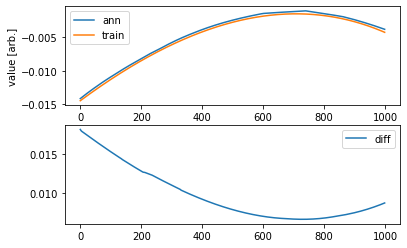

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.027728281754178262


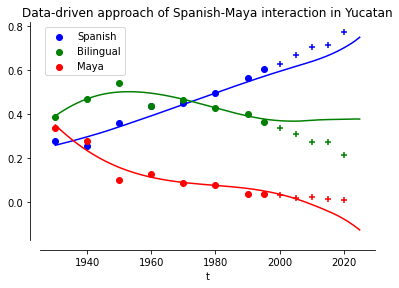

Epoch 1/500
32/32 - 0s - loss: 1.8889e-04 - mae: 0.0101 - 498ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 4.5874e-06 - mae: 0.0017 - 84ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.7311e-07 - mae: 4.1507e-04 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2061e-07 - mae: 2.3107e-04 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.3031e-08 - mae: 2.0491e-04 - 83ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.6215e-08 - mae: 1.7370e-04 - 84ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.6441e-08 - mae: 1.6775e-04 - 72ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 4.1951e-08 - mae: 1.4589e-04 - 75ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.5550e-08 - mae: 1.3445e-04 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1708e-08 - mae: 1.2767e-04 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8845e-08 - mae: 1.2367e-04 - 94ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6525e-08 - mae: 1.1871e-04 - 85ms/epoch - 3ms/

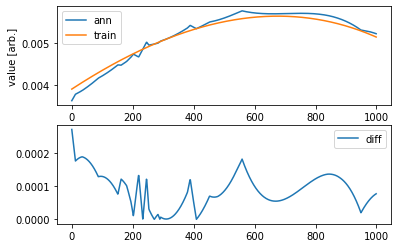

Epoch 1/500
32/32 - 0s - loss: 1.8475e-04 - mae: 0.0098 - 488ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 5.3807e-06 - mae: 0.0018 - 83ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.1357e-07 - mae: 4.4744e-04 - 85ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.3558e-08 - mae: 1.9019e-04 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.1577e-08 - mae: 1.5746e-04 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.2189e-08 - mae: 1.4291e-04 - 83ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.6647e-08 - mae: 1.3062e-04 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.2589e-08 - mae: 1.2079e-04 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.9476e-08 - mae: 1.1284e-04 - 87ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.7467e-08 - mae: 1.0692e-04 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.4893e-08 - mae: 9.8002e-05 - 80ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 1.3293e-08 - mae: 9.1214e-05 - 90ms/epoch - 3ms/

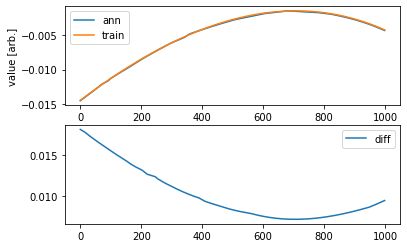

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.23044690878581636


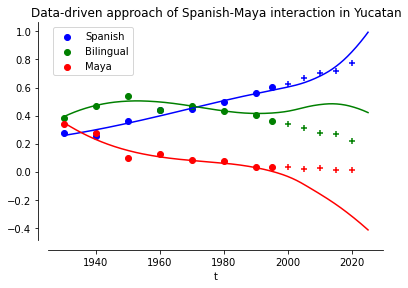

Epoch 1/500
32/32 - 0s - loss: 0.0015 - mae: 0.0269 - 478ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 3.2125e-05 - mae: 0.0046 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.1802e-06 - mae: 0.0017 - 77ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.2790e-06 - mae: 0.0012 - 85ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.5777e-06 - mae: 9.9190e-04 - 75ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 9.6172e-07 - mae: 7.8399e-04 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.4413e-07 - mae: 5.4565e-04 - 85ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.0018e-07 - mae: 3.6029e-04 - 94ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.2128e-07 - mae: 2.6918e-04 - 81ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.3546e-08 - mae: 2.3190e-04 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.0529e-08 - mae: 1.9628e-04 - 91ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.5359e-08 - mae: 1.7073e-04 - 89ms/epoch - 3ms/step
Epoch 1

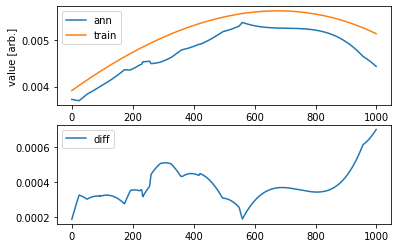

Epoch 1/500
32/32 - 1s - loss: 5.0148e-04 - mae: 0.0165 - 504ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6004e-05 - mae: 0.0032 - 103ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.0299e-06 - mae: 0.0012 - 101ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 8.1236e-07 - mae: 7.7821e-04 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.1511e-07 - mae: 6.0692e-04 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.4123e-07 - mae: 5.5542e-04 - 86ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.7513e-07 - mae: 5.0240e-04 - 83ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.5865e-07 - mae: 4.7951e-04 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4454e-07 - mae: 4.5616e-04 - 75ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.2561e-07 - mae: 4.3635e-04 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8590e-07 - mae: 3.9599e-04 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.7326e-07 - mae: 3.8597e-04 - 89ms/epoch - 3ms/s

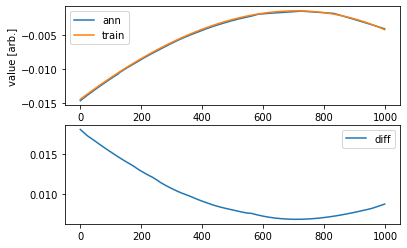

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.04928250469413123


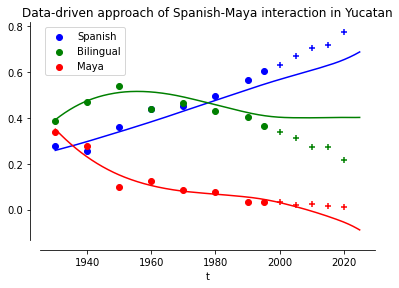

Epoch 1/500
32/32 - 0s - loss: 1.0847e-04 - mae: 0.0076 - 498ms/epoch - 16ms/step
Epoch 2/500
32/32 - 0s - loss: 7.0361e-06 - mae: 0.0020 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.9073e-07 - mae: 4.9262e-04 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2541e-07 - mae: 2.7858e-04 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.4029e-08 - mae: 2.3317e-04 - 84ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.6940e-08 - mae: 2.1170e-04 - 85ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.4462e-08 - mae: 1.9279e-04 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.5019e-08 - mae: 1.7396e-04 - 82ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.5608e-08 - mae: 1.7418e-04 - 65ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.0056e-08 - mae: 1.4029e-04 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8841e-08 - mae: 1.3476e-04 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.2938e-08 - mae: 1.2181e-04 - 95ms/epoch - 3ms/

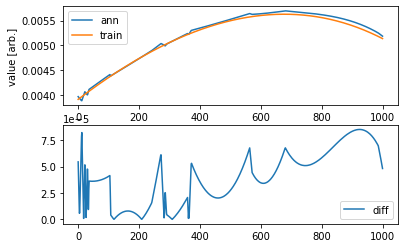

Epoch 1/500
32/32 - 0s - loss: 3.8100e-05 - mae: 0.0042 - 476ms/epoch - 15ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6761e-06 - mae: 9.6620e-04 - 69ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.3744e-07 - mae: 3.7377e-04 - 79ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.5512e-07 - mae: 2.9613e-04 - 82ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4244e-07 - mae: 2.8835e-04 - 86ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.1834e-07 - mae: 2.6410e-04 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1036e-07 - mae: 2.6201e-04 - 85ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.2958e-08 - mae: 2.2557e-04 - 81ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.5332e-08 - mae: 2.3197e-04 - 85ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.0823e-08 - mae: 2.2274e-04 - 102ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.2590e-08 - mae: 1.9776e-04 - 68ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.8513e-08 - mae: 1.9208e-04 - 78ms/epoch -

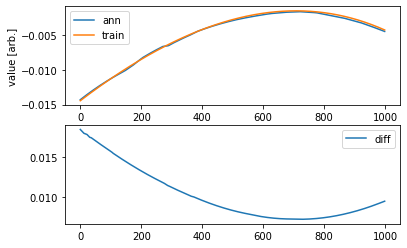

AG
AG
AG
AG
AG


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


0.8786355148266742


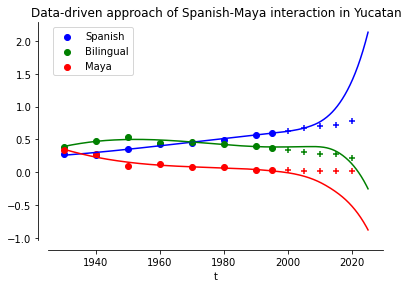

In [ ]:
Trad = [0.03252960787637424, 0.07452209734167309, 0.05139384134851478, 0.08021181171232922, 0.07604668266187496, 0.6639024860300051, 0.3385766920572754, 0.025793318505296002, 0.06526144435340066, 0.026133787086991246, 0.06509614614495701, 0.4225739424896667, 0.31301485053728506, 0.00393915236591014, 0.030767771334020977]

for _ in range(15):
  suma = train1(X,Y,dX,dY)
  Trad.append(suma)

In [ ]:
Trad = [0.03252960787637424, 0.07452209734167309, 0.05139384134851478, 0.08021181171232922, 0.07604668266187496, 0.6639024860300051, 0.3385766920572754, 0.025793318505296002, 0.06526144435340066, 0.026133787086991246, 0.06509614614495701, 0.4225739424896667, 0.31301485053728506, 0.00393915236591014, 0.030767771334020977, 0.07249029938117227, 0.09878491021093194, 0.05435699792029483, 0.13000703450153595, 0.32257854174299244, 0.20412209063901995, 0.16822256133920482, 0.06613283043314652, 0.04129412332920217, 0.038446028643305145, 0.0659826345948115, 0.027728281754178262, 0.23044690878581636, 0.04928250469413123, 0.8786355148266742]
print(len(Trad))

30


In [ ]:
print(sum(Trad)/30.)

0.15727582982139973


# Novel approach

In [ ]:
from keras.constraints import NonNeg
import matplotlib as mpl

In [ ]:
X = X.reshape(-1,1)
Y = Y.reshape(-1,1)
B = B.reshape(-1,1)
dX= dX.reshape(-1,1)
dY= dY.reshape(-1,1)
dB= dB.reshape(-1,1)

#Xa = np.concatenate((X,X**2,Y,Y**2,X*Y),axis=1)
Xa = np.concatenate((X,B,Y),axis=1)
dXa = np.concatenate((dX,dB,dY),axis=1)

print(Xa.shape[1])

#x_scaler = MinMaxScaler()
#y_scaler = MinMaxScaler(feature_range=(-1.0, 1.0))
#y_scaler = MinMaxScaler()
 
#Xa = x_scaler.fit_transform(Xa)
#X = y_scaler.fit_transform(X)

""" 
model = Sequential()
model.add(keras.layers.Dropout(0.9))
model.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))#,kernel_regularizer='l1'))
model.add(keras.layers.Dropout(0.9))
model.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))#,kernel_regularizer='l1'))
model.add(keras.layers.Dropout(0.9))
model.add(Dense(50, input_dim=Xa.shape[1], activation='relu'))#,kernel_regularizer='l1'))
model.add(Dense(4, activation='linear',use_bias=False))

model = keras.Sequential([keras.layers.Dense(10,activation='relu',input_shape=(3,)),
                          keras.layers.Dense(4)
])
"""

lambda1 = 0.00000000001

inp = keras.layers.Input(shape=(3,))
x1 = Dense(50,activation='relu')(inp) # 
x2 = Dense(50,activation='relu')(x1)
x3 = Dense(4,activation='linear',kernel_constraint=NonNeg())(x2) # ,kernel_constraint=NonNeg()

# kernel_regularizer=keras.regularizers.L1(l1=lambda1)

conc = keras.layers.Concatenate()([x3,inp])

#out = Dense(1)(conc)

model = keras.models.Model(inputs=inp,outputs=conc)

model.compile(loss=custom_loss2, optimizer='adam')
 
model.fit(Xa, dXa, epochs=500, batch_size=32, verbose=2)
 

3


NameError: ignored

In [ ]:
model.predict(Xa)[0]

array([-1.0992603e-02,  2.7536992e-03, -2.3606885e-04,  4.1103877e-02,
        2.5796607e-01,  3.9148232e-01,  3.5055301e-01], dtype=float32)

100 épocas

50-50-50

*   Adam:  4.4427e-07
*   Adam + Dropout: 1.7820e-07 
*   SGD: 1.8645e-05
*   RMSprop: 3.6338e-06

100-100-100

*   Adam: 1.3835e-06
*   Adam + Dropout: 1.1007e-06
*   RMSprop: 4.5947e-06




In [ ]:
model.fit(Xa, dXa, epochs=500, batch_size=32, verbose=2)

Epoch 1/500
32/32 - 0s - loss: 6.6803e-09 - 137ms/epoch - 4ms/step
Epoch 2/500
32/32 - 0s - loss: 9.5126e-09 - 132ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 5.6606e-09 - 136ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.7899e-08 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.9459e-08 - 160ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 2.0496e-08 - 180ms/epoch - 6ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3691e-08 - 162ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 1.2653e-08 - 173ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0427e-08 - 122ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.5155e-08 - 143ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.8301e-08 - 175ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 9.7759e-09 - 242ms/epoch - 8ms/step
Epoch 13/500
32/32 - 0s - loss: 2.8818e-08 - 219ms/epoch - 7ms/step
Epoch 14/500
32/32 - 0s - loss: 3.4863e-08 - 158ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0558e-07 - 235ms/epoch -

In [ ]:
res = model.predict(Xa) # 2.8746e-08  

In [ ]:
def procesarSalida(y_pred):
  f1 = y_pred[:,0]
  f2 = y_pred[:,1]
  f3 = y_pred[:,2]
  f4 = y_pred[:,3]
  x = y_pred[:,4]
  b = y_pred[:,5]
  y = y_pred[:,6]
  a = b*f2 - x*f1
  b = x*f1 + y*f4 - b*f2 - b*f3
  c = b*f3 - y*f4
  n1 = len(y_pred)
  #print(np.sum(a+b+c))
  y_pred2 = np.array([a,b,c]).T
  #y_pred2 = np.concatenate((a, b ,c ),axis=0)
  #y_pred2 = y_pred2.reshape(len(y_pred), 3).T
  return y_pred2

In [ ]:
def procesarSalida2(y_pred):
  f1 = y_pred[0]
  f2 = y_pred[1]
  f3 = y_pred[2]
  f4 = y_pred[3]
  x = y_pred[4]
  b = y_pred[5]
  y = y_pred[6]

  a = b*f2 - x*f1
  b = x*f1 + y*f4 - b*f2 - b*f3
  c = b*f3 - y*f4
  n1 = len(y_pred)
  #print(a,b,c)
  #print(a+b+c)
  #print(b*f2 - x*f1 + x*f1 + y*f4 - b*f2 - b*f3 + b*f3 - y*f4)
  y_pred2 = np.array([a,b,c]).T
  #y_pred2 = np.concatenate((a, b ,c ),axis=0)
  #y_pred2 = y_pred2.reshape(len(y_pred), 3).T
  return y_pred2

In [ ]:
y_pred = procesarSalida(res).T

NameError: ignored

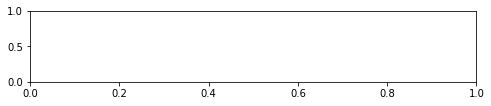

In [ ]:
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (8, 6)

pl.subplot(411)
pl.plot(y_pred[0], label='ann')
pl.plot(dX, label='train')
pl.xlabel('#')
pl.ylabel('value [arb.]')
pl.legend()
pl.subplot(412)
pl.plot(y_pred[2], label='ann')
pl.plot(dY, label='train')
pl.xlabel('#')
pl.ylabel('value [arb.]')
pl.legend()
pl.subplot(413)
pl.plot(y_pred[1], label='ann')
pl.plot(dB, label='train')
pl.xlabel('#')
pl.ylabel('value [arb.]')
pl.legend()
pl.subplot(414)
pl.plot(np.abs(dX - res), label='diff')
pl.legend()
pl.show()

In [ ]:
x0 = polinomio(theta1,1930)
y0 = polinomio(theta2,1930)
b0 = polinomio(theta3,1930)
d1 = y_pred[0,0]
d2 = y_pred[1,0]
d3 = y_pred[2,0]
print(d1,d2,d3)

p1 = [[x0,y0,b0]]
out = model.predict(p1)[0]
print(out)
print(procesarSalida2(out).T)


0.0036594735 0.010647774 -0.014472014
[0.01102716 0.01570018 0.00367796 0.04207479 0.25796607 0.350553
 0.39148232]
[ 0.00265911  0.0125231  -0.01642548]


In [ ]:
x0 = polinomio(theta1,1930)
y0 = polinomio(theta2,1930)
b0 = polinomio(theta3,1930)
#y02= polinomio(theta2,1930)


Xn = [x0]
Yn = [y0]
#Yn2= [y02]

h = .06506507 #1/10.
t = 1930
Tn = [t]
#D = []

j = 0

suma = 0

for i in range(len(T)):#range(int((2025-1930)*(1/h))):
  t = T[i][0] #i*1 #+= h
  p1 = [[x0,b0,y0]]
  #p2 = [[y0,x0*y0]]
  #d1 = model.predict(p1)[0][0]
  #d2 = model2.predict(p2)[0][0]
  d1 = y_pred[0,i]
  d2 = y_pred[2,i]
  d3 = y_pred[1,i]
  x1 = x0 + h*d1 #*res_rscl[i][0]
  y1 = y0 + h*d2 #res_rscl2[i][0]
  b1 = b0 + h*d3
  print(x1 + y1+ b1)


  if len(T0t) > j:
    if abs(t-float(T0t[j])) < .07:
      print("AG")
      suma += (x1-Espat[j])**2 + (y1-Mayat[j])**2
      j += 1


  Xn.append(x1)
  Yn.append(y1)
  #Yn2.append(y2)
  Tn.append(t)
  x0 = x1 + 0
  y0 = y1 + 0
  b0 = b1 + 0
  #y02 = y2 + 0
print(suma)

1.0000039645900811
1.000005089807762
1.0000046173969137
1.000004158771785
1.000003774104768
1.0000033688955143
1.0000028930912586
1.000002345722455
1.0000017275768598
1.0000010388059637
1.0000002792279774
0.9999994486914094
0.9999985473174529
0.9999975754696871
0.999996532602743
0.9999954191104984
0.9999942347505668
0.9999929803713004
0.9999916553667333
0.9999902599489537
0.9999887945118391
0.9999872585403189
0.9999856533978155
0.9999839776300117
0.9999822322064524
0.9999804166726631
0.9999785315740133
0.9999765767893098
0.9999745517428851
0.9999724578284602
0.9999702941673849
0.9999680617292045
0.999965759907953
0.9999633891581049
0.9999609494190635
0.9999584408120221
0.9999558628825062
0.9999532168727456
0.9999505022070729
0.9999477194308573
0.9999448684532037
0.9999419486378484
0.9999389614997054
0.9999359057965451
0.9999327827100006
0.9999295918461943
0.9999263337504953
0.9999230079381308
0.9999196150453651
0.9999161548298119
0.9999126277156469
0.9999090337634668
0.9999053731247631

In [ ]:
print(t)

1995.0


In [ ]:
x0 = polinomio(theta1,1930)
y0 = polinomio(theta2,1930)
b0 = polinomio(theta3,1930)
#y02= polinomio(theta2,1930)


Xn = [x0]
Yn = [y0]
#Yn2= [y02]

h = .06506507 #1/10.
t = 1930
Tn = [t]
#D = []

j = 0



suma = 0

for i in range(1600):#range(int((2025-1930)*(1/h))):
  t += h
  p1 = [[x0,b0,y0]]
  out = model.predict(p1)[0]
  d = procesarSalida2(out).T
  d1 = d[0]
  d2 = d[2]
  d3 = d[1]
  x1 = x0 + h*d1 #*res_rscl[i][0]
  y1 = y0 + h*d2 #res_rscl2[i][0]
  b1 = 1 - x1 - y1  #b0 + h*d3 

  #if y1 <0:
  #  print(d1,d2,d3)
    #break

  print(x1 + y1+ b1)


  if len(T0t) > j:
    if abs(t-float(T0t[j])) < .07:
      print("AG")
      suma += (x1-Espat[j])**2 + (y1-Mayat[j])**2
      j += 1


  Xn.append(x1)
  Yn.append(y1)
  #Yn2.append(y2)
  Tn.append(t)
  x0 = x1 + 0
  y0 = y1 + 0
  b0 = b1 + 0
  #y02 = y2 + 0
print(suma)

1.0
1.0
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9999999999999999
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9999999999999999
1.0
1.0
1.0
0.9999999999999999
1.0
1.0
1.0
1.0
1.0
1.0


In [ ]:
print(out) #0.03252960787637424

[3.9293502e-02 6.5721273e-02 1.2264444e-02 1.1393370e-01 5.9142989e-01
 4.4981603e-04 4.0812027e-01]


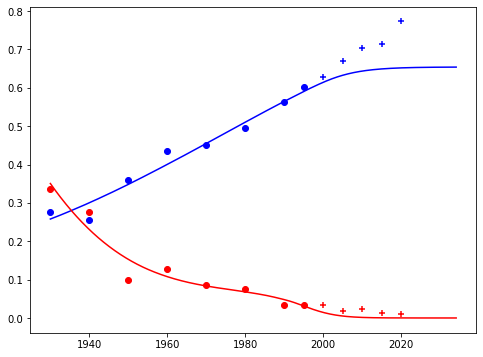

In [ ]:
plt.scatter(T0,Espa,color='blue')
plt.scatter(T0t,Espat,color='blue',marker='+')
plt.plot(Tn,Xn,color='blue')
plt.scatter(T0,Maya,color='red')
plt.scatter(T0t,Mayat,color='red',marker='+')
plt.plot(Tn,Yn,color='red')
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


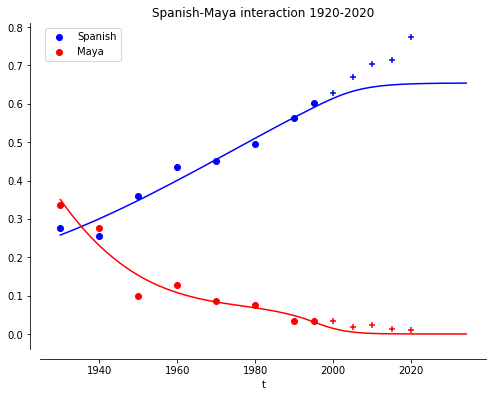

In [ ]:
fig,ax = plt.subplots()

ax.scatter(T0,Espa,color='blue',label='Spanish')
ax.scatter(T0t,Espat,color='blue',marker='+')
ax.plot(Tn,Xn,color='blue')
ax.scatter(T0,Maya,color='red',label='Maya')
ax.scatter(T0t,Mayat,color='red',marker='+')
ax.plot(Tn,Yn,color='red')

#ax.scatter(T0,Bilin, color = (0.4,0.7,0.3),label='Bilingual',marker='o',s=20)
#ax.scatter(T0,Espa, color = (0,0,1),label='Spanish',marker='x',s=20)
#ax.scatter(T0,Maya, color = (1,0,0),label='Maya',marker='+',s=20)
ax.set_title(u"Spanish-Maya interaction 1920-2020")#1920-2015")
#ax.yaxis.title("t")
ax.set_xlabel("t")
#ax.set_ylabel("Casos registrados")
ax.spines['left'].set_position(('outward',10))
ax.spines['bottom'].set_position(('outward',10))
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
#ax.set_yticks(range(10),minor=True)
#ax.set_ylim([0,100])
ax.legend(framealpha=1)
#ax.legend(bbox_to_anchor=(1.1, 1.05))
ax.legend()#(loc="upper left", bbox_to_anchor=(0.8,0.2))
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
plt.savefig('new2.eps')
plt.show()

In [ ]:
M1 = [0.010454283423124447,0.019254480315644293,0.021692743207853894,0.06645435828369922,0.006066428194062207,0.021482497861640304,0.030612596024007524,0.003658614976937473]
M2 = [0.026426995058175477,0.025571506303966887,0.01209504588776629,0.02839082054287933,0.01607127611631844,0.0029592931009926886,0.019412653185795645,0.003328131287920092]

In [ ]:
def train2(X,Y,B,dX,dY,dB,mode = '1'):
  X = X.reshape(-1,1)
  Y = Y.reshape(-1,1)
  B = B.reshape(-1,1)
  dX= dX.reshape(-1,1)
  dY= dY.reshape(-1,1)
  dB= dB.reshape(-1,1)

  Xa = np.concatenate((X,B,Y),axis=1)
  dXa = np.concatenate((dX,dB,dY),axis=1)

  inp = keras.layers.Input(shape=(3,))
  x1 = Dense(50,activation='relu')(inp) # 
  if mode == '1':
    x2 = Dense(50,activation='relu')(x1)
    x3 = Dense(4,activation='linear')(x2)
  else:
    x2 = Dense(50,activation='relu')(x1)
    x3 = Dense(4,activation='linear',kernel_constraint=NonNeg())(x2) # ,kernel_constraint=NonNeg()

  conc = keras.layers.Concatenate()([x3,inp])

  model = keras.models.Model(inputs=inp,outputs=conc)

  model.compile(loss=custom_loss2, optimizer='adam')
 
  model.fit(Xa, dXa, epochs=500, batch_size=32, verbose=2)
  res = model.predict(Xa)
  y_pred = procesarSalida(res).T

  mpl.rcParams['figure.figsize'] = (8, 6)

  pl.subplot(411)
  pl.plot(y_pred[0], label='ann')
  pl.plot(dX, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(412)
  pl.plot(y_pred[2], label='ann')
  pl.plot(dY, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(413)
  pl.plot(y_pred[1], label='ann')
  pl.plot(dB, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(414)
  pl.plot(np.abs(dX - res), label='diff')
  pl.legend()
  pl.show()

  x0 = polinomio(theta1,1930)
  y0 = polinomio(theta2,1930)
  b0 = polinomio(theta3,1930)
  #y02= polinomio(theta2,1930)


  Xn = [x0]
  Yn = [y0]
  Bn = [b0]
  #Yn2= [y02]

  h = .06506507 #1/10.
  t = 1930
  Tn = [t]
  #D = []

  j = 0
  suma = 0

  for i in range(1600):#range(int((2025-1930)*(1/h))):
    t += h
    p1 = [[x0,b0,y0]]
    out = model.predict(p1)[0]
    d = procesarSalida2(out).T
    d1 = d[0]
    d2 = d[2]
    d3 = d[1]
    y1 = y0 + h*d2 #res_rscl2[i][0]
    b1 = b0 + h*d3 
    x1 = 1 - y1-b1 #x0 + h*d1 #*res_rscl[i][0]
    #if y1 <0:
    #  print(d1,d2,d3)
      #break

    #print(x1 + y1+ b1)


    if len(T0t) > j:
      if abs(t-float(T0t[j])) < .07:
        print("AG")
        suma += (x1-Espat[j])**2 + (y1-Mayat[j])**2
        j += 1


    Xn.append(x1)
    Yn.append(y1)
    Bn.append(b1)
    #Yn2.append(y2)
    Tn.append(t)
    x0 = x1 + 0
    y0 = y1 + 0
    b0 = b1 + 0
    #y02 = y2 + 0
  print(suma)

  fig,ax = plt.subplots()

  ax.scatter(T0,Espa,color='blue',label='Spanish')
  ax.scatter(T0t,Espat,color='blue',marker='+')
  ax.plot(Tn,Xn,color='blue')
  ax.scatter(T0,Bilin,color='green',label='Bilingual')
  ax.scatter(T0t,Bilint,color='green',marker='+')
  ax.plot(Tn,Bn,color='green')
  ax.scatter(T0,Maya,color='red',label='Maya')
  ax.scatter(T0t,Mayat,color='red',marker='+')
  ax.plot(Tn,Yn,color='red')

  #ax.scatter(T0,Bilin, color = (0.4,0.7,0.3),label='Bilingual',marker='o',s=20)
  #ax.scatter(T0,Espa, color = (0,0,1),label='Spanish',marker='x',s=20)
  #ax.scatter(T0,Maya, color = (1,0,0),label='Maya',marker='+',s=20)
  if mode == '1':
    ax.set_title(u"Graph-informed approximation of Spanish-Maya interaction in Yucatan")
  else:
    ax.set_title(u"Graph-informed approximation with non-negative weights")#1920-2015")
  #ax.yaxis.title("t")
  ax.set_xlabel("t")
  #ax.set_ylabel("Casos registrados")
  ax.spines['left'].set_position(('outward',10))
  ax.spines['bottom'].set_position(('outward',10))
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  #ax.set_yticks(range(10),minor=True)
  #ax.set_ylim([0,100])
  ax.legend(framealpha=1)
  #ax.legend(bbox_to_anchor=(1.1, 1.05))
  ax.legend()#(loc="upper left", bbox_to_anchor=(0.8,0.2))
  ax.yaxis.set_ticks_position('left')
  ax.xaxis.set_ticks_position('bottom')
  if mode == '1':
    plt.savefig('new1.eps')
  else:
    plt.savefig('new2.eps')
  plt.show() 

  return suma

Epoch 1/500
32/32 - 2s - loss: 1.9250e-04 - 2s/epoch - 75ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0331e-05 - 124ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.0877e-06 - 119ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.4296e-06 - 98ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.1966e-07 - 100ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.2833e-07 - 106ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.9674e-07 - 123ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 3.3863e-07 - 175ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 3.1290e-07 - 116ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.9572e-07 - 115ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8605e-07 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.7861e-07 - 101ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.7268e-07 - 147ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 2.6663e-07 - 78ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.6086e-07 - 143ms/epoch - 4ms

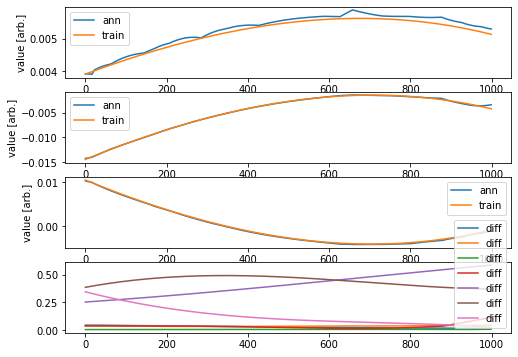

0


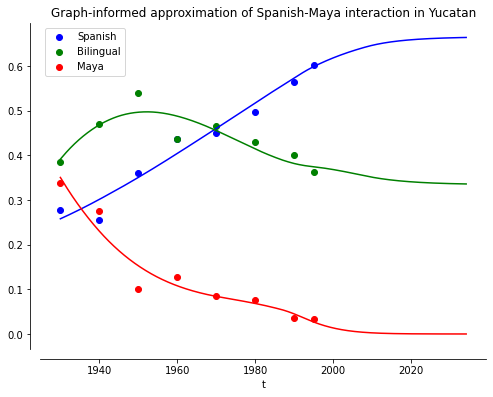

In [ ]:
total = train2(X,Y,B,dX,dY,dB,mode = '1')

Resultado del modelo original: [0.07965078, 0.00768354,0.00768354,0.00768354]

In [ ]:
M1 = [0.010454283423124447, 0.019254480315644293, 0.021692743207853894, 0.06645435828369922, 0.006066428194062207, 0.021482497861640304, 0.030612596024007524, 0.003658614976937473, 0.01880122686615164, 0.01579714694507681, 0.011415258313340585, 0.03220557820742494, 0.0181698626416682, 0.002777574705453019, 0.031671126014965384]
M2 = [0.026426995058175477, 0.025571506303966887, 0.01209504588776629, 0.02839082054287933, 0.01607127611631844, 0.0029592931009926886, 0.019412653185795645, 0.003328131287920092, 0.047308590256843114, 0.006360455354487345, 0.0221719056018232, 0.026470638304661124, 0.016726306935615217, 0.03354420073602951, 0.003858890029825336]

print(sum(M1)/15)
print(sum(M2)/15)


0.02070091839873666
0.01937978058020664


Epoch 1/500
32/32 - 1s - loss: 1.3642e-04 - 876ms/epoch - 27ms/step
Epoch 2/500
32/32 - 0s - loss: 5.1347e-06 - 53ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.8187e-06 - 57ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2893e-06 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 9.9938e-07 - 62ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.5040e-07 - 55ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 5.8647e-07 - 63ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 4.6802e-07 - 65ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.0128e-07 - 60ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.5699e-07 - 62ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.2347e-07 - 61ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.9359e-07 - 56ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.6851e-07 - 57ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.4796e-07 - 62ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2894e-07 - 57ms/epoch - 2ms/step
Ep

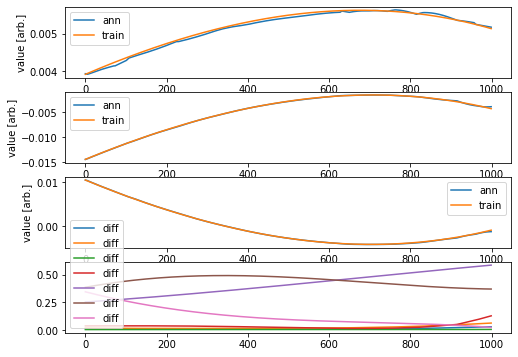

AG
AG
AG
AG
AG


0.02575461558963701


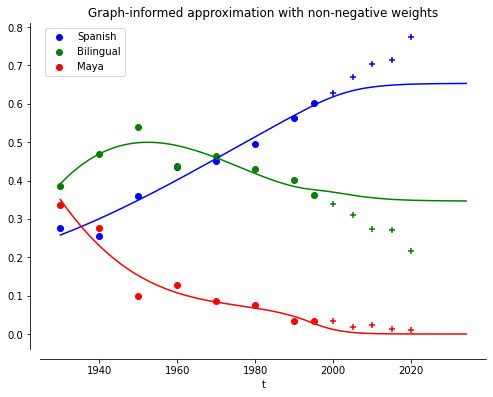

Epoch 1/500
32/32 - 1s - loss: 6.1084e-04 - 1s/epoch - 33ms/step
Epoch 2/500
32/32 - 0s - loss: 5.6305e-05 - 67ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 8.9657e-06 - 71ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.6713e-06 - 73ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4604e-06 - 88ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0845e-06 - 80ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.1456e-07 - 80ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 8.1104e-07 - 62ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 7.4010e-07 - 64ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 6.7834e-07 - 58ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 6.2391e-07 - 58ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.7420e-07 - 62ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 5.3009e-07 - 59ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.9324e-07 - 59ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.6529e-07 - 65ms/epoch - 2ms/step
Epoch

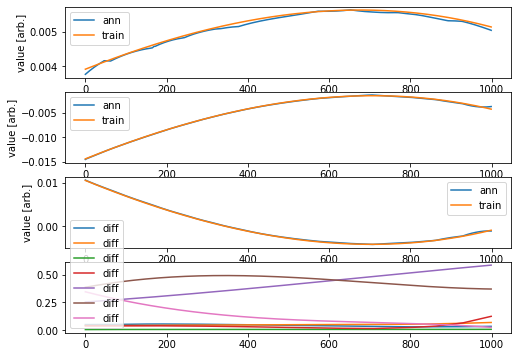

AG
AG
AG
AG
AG


0.025878354408378778


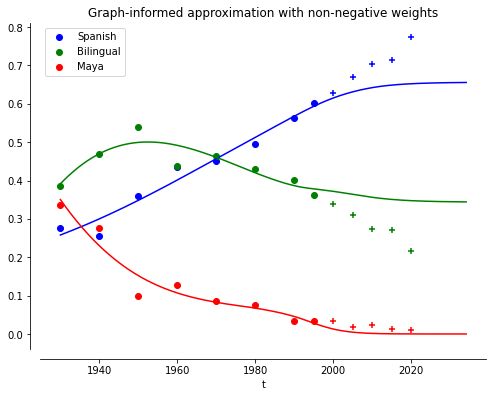

Epoch 1/500
32/32 - 1s - loss: 3.1532e-04 - 925ms/epoch - 29ms/step
Epoch 2/500
32/32 - 0s - loss: 1.9163e-05 - 60ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 4.9453e-06 - 60ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.7082e-06 - 66ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.1484e-06 - 65ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8802e-06 - 58ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.7020e-06 - 58ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.5581e-06 - 77ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4287e-06 - 61ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2997e-06 - 64ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1607e-06 - 65ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0265e-06 - 61ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 9.1038e-07 - 68ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 8.0913e-07 - 68ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 7.2109e-07 - 62ms/epoch - 2ms/step
Ep

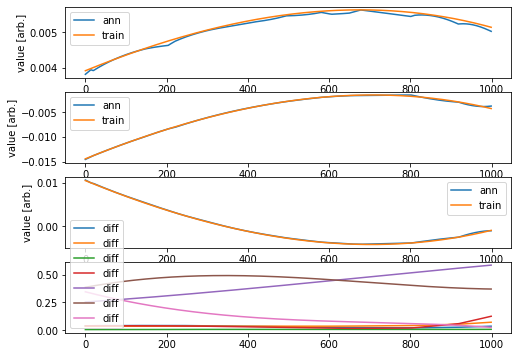

AG
AG
AG
AG
AG


0.021818934607130303


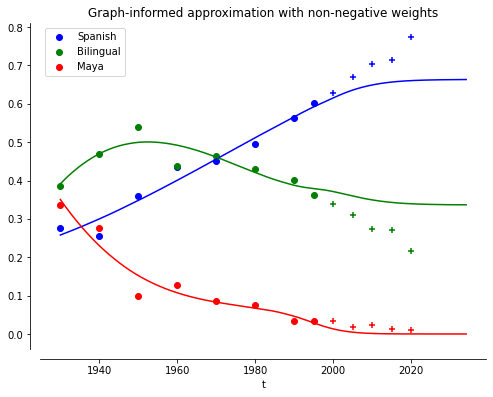

Epoch 1/500
32/32 - 1s - loss: 3.8138e-04 - 915ms/epoch - 29ms/step
Epoch 2/500
32/32 - 0s - loss: 1.5208e-05 - 69ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7782e-06 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0048e-06 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 8.8735e-07 - 80ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 8.0685e-07 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.3815e-07 - 66ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.7382e-07 - 82ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.1872e-07 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.6891e-07 - 76ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 5.2571e-07 - 82ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.8816e-07 - 77ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 4.5440e-07 - 69ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.2220e-07 - 117ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.9393e-07 - 75ms/epoch - 2ms/step
E

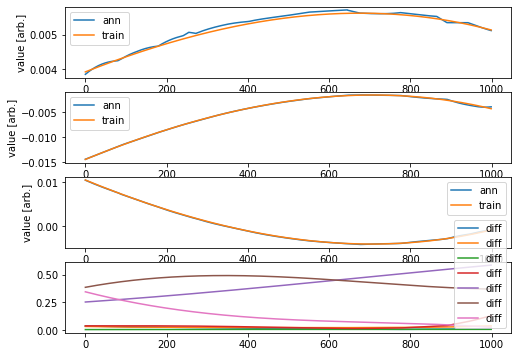

AG
AG
AG
AG
AG


0.024659598685438426


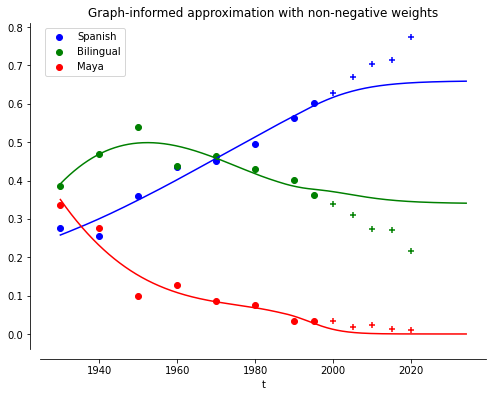

Epoch 1/500
32/32 - 1s - loss: 4.1404e-04 - 944ms/epoch - 30ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4829e-05 - 68ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 4.1307e-06 - 63ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.5530e-06 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.9576e-06 - 67ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.5401e-06 - 66ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2466e-06 - 66ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0232e-06 - 64ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 8.9992e-07 - 69ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 8.0977e-07 - 64ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 7.4256e-07 - 77ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 6.8372e-07 - 77ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 6.3674e-07 - 77ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 5.9174e-07 - 95ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.5605e-07 - 81ms/epoch - 3ms/step
Ep

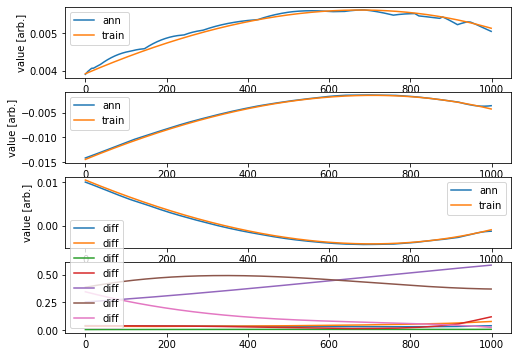

AG
AG
AG
AG
AG


0.01568496811622431


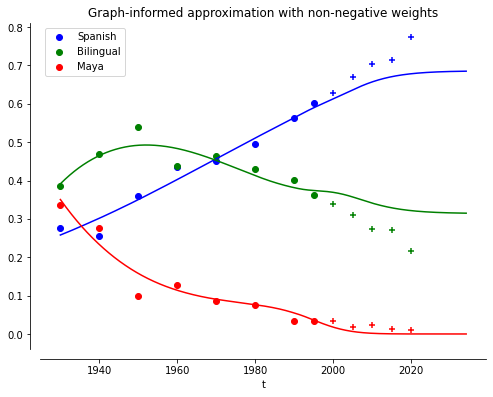

Epoch 1/500
32/32 - 1s - loss: 7.5312e-04 - 837ms/epoch - 26ms/step
Epoch 2/500
32/32 - 0s - loss: 3.1285e-05 - 70ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 4.4364e-06 - 59ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.9759e-06 - 61ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4992e-06 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2900e-06 - 69ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1434e-06 - 68ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0177e-06 - 73ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 9.0358e-07 - 59ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 8.0106e-07 - 68ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 7.1219e-07 - 74ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 6.2963e-07 - 69ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 5.5674e-07 - 66ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.9637e-07 - 62ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.4314e-07 - 67ms/epoch - 2ms/step
Ep

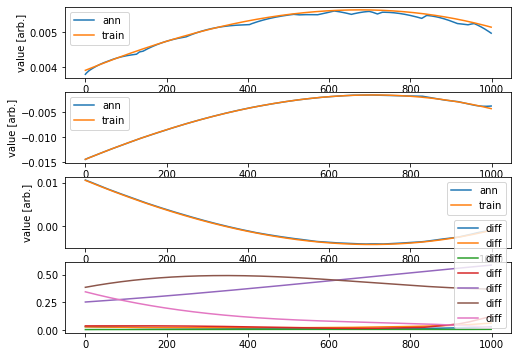

AG
AG
AG
AG
AG


0.019548361728626378


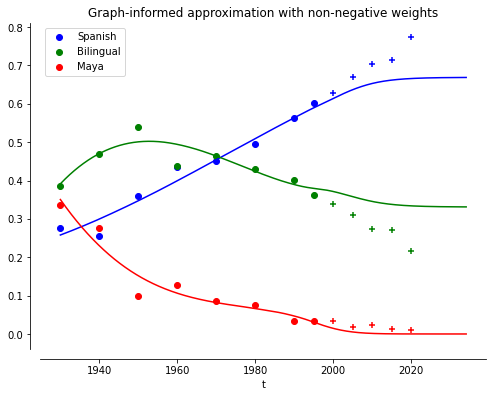

Epoch 1/500
32/32 - 1s - loss: 4.4388e-04 - 937ms/epoch - 29ms/step
Epoch 2/500
32/32 - 0s - loss: 8.2193e-06 - 68ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 3.0755e-06 - 65ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.8169e-06 - 77ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2757e-06 - 68ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 9.5350e-07 - 75ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 7.4876e-07 - 63ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.1682e-07 - 66ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 5.2755e-07 - 77ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.6863e-07 - 74ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 4.3364e-07 - 79ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 4.0363e-07 - 84ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.8185e-07 - 79ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.6460e-07 - 85ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.5181e-07 - 85ms/epoch - 3ms/step
Ep

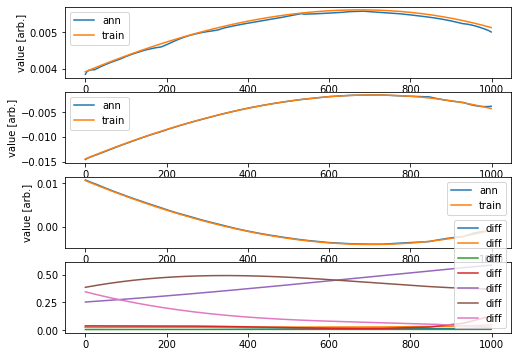

AG
AG
AG
AG
AG


0.02567789124868794


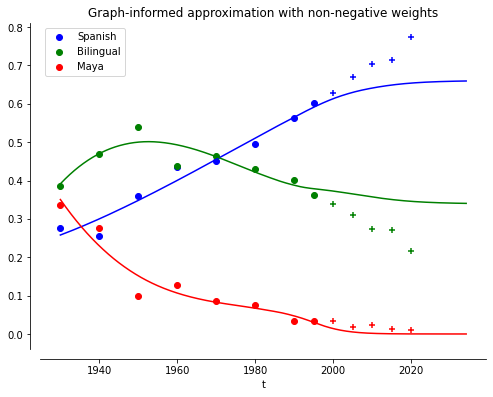

Epoch 1/500
32/32 - 1s - loss: 0.0010 - 907ms/epoch - 28ms/step
Epoch 2/500
32/32 - 0s - loss: 5.5945e-05 - 99ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 8.5438e-06 - 100ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 3.1402e-06 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.8090e-06 - 98ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2237e-06 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.1567e-07 - 84ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.5805e-07 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.4546e-07 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.6079e-07 - 84ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.9990e-07 - 98ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.5199e-07 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.0806e-07 - 79ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.7152e-07 - 78ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 3.4425e-07 - 74ms/epoch - 2ms/step
Epoch

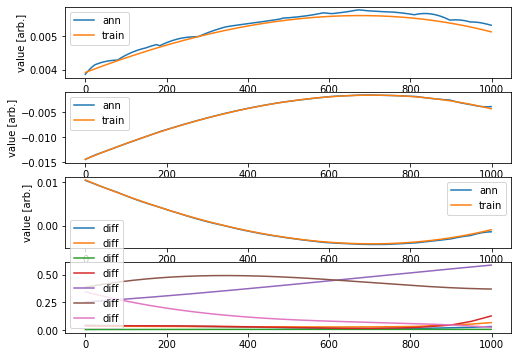

AG
AG
AG
AG
AG


0.025484804518834524


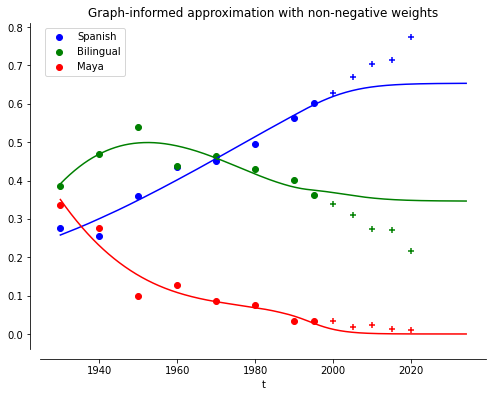

Epoch 1/500
32/32 - 1s - loss: 6.8540e-05 - 895ms/epoch - 28ms/step
Epoch 2/500
32/32 - 0s - loss: 2.7877e-06 - 78ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 9.7088e-07 - 83ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.9109e-07 - 79ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 5.6508e-07 - 88ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.8220e-07 - 80ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 4.2808e-07 - 78ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.7214e-07 - 73ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4578e-07 - 79ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1729e-07 - 79ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8104e-07 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.5529e-07 - 97ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.3548e-07 - 74ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.1777e-07 - 79ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0333e-07 - 89ms/epoch - 3ms/step
Ep

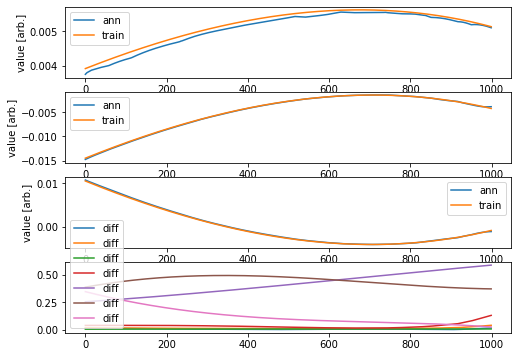

AG
AG
AG
AG
AG


0.026692226575102646


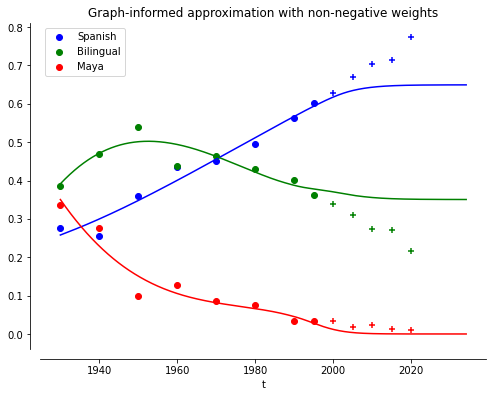

Epoch 1/500
32/32 - 1s - loss: 6.9258e-04 - 826ms/epoch - 26ms/step
Epoch 2/500
32/32 - 0s - loss: 2.5522e-05 - 90ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.2803e-06 - 76ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3945e-06 - 67ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0810e-06 - 64ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 8.5440e-07 - 73ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 6.9383e-07 - 71ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.8037e-07 - 78ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 5.0357e-07 - 70ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.4968e-07 - 75ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 4.0749e-07 - 69ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.7250e-07 - 66ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 3.4258e-07 - 78ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.1886e-07 - 64ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.9738e-07 - 69ms/epoch - 2ms/step
Ep

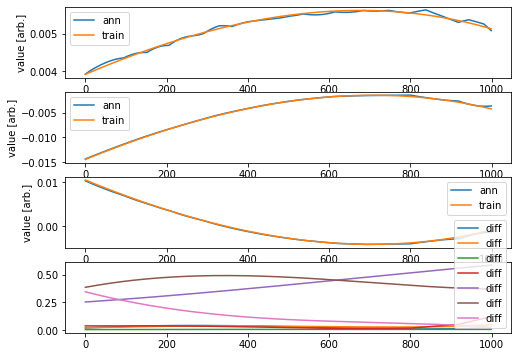

AG
AG
AG
AG
AG


0.025127512133166316


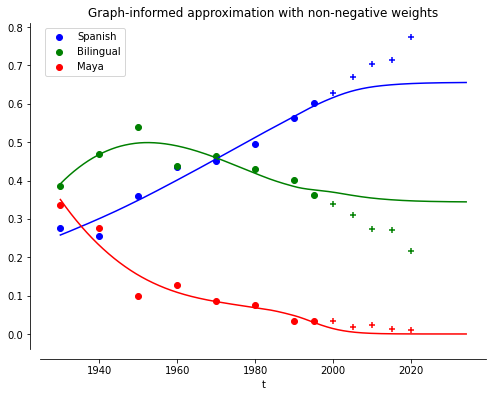

Epoch 1/500
32/32 - 1s - loss: 2.4594e-04 - 852ms/epoch - 27ms/step
Epoch 2/500
32/32 - 0s - loss: 9.0412e-06 - 75ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 3.8059e-06 - 67ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.2703e-06 - 72ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.5214e-06 - 75ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.1032e-06 - 70ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 8.2723e-07 - 75ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.3736e-07 - 67ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 5.0024e-07 - 75ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.1895e-07 - 75ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.7218e-07 - 72ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4284e-07 - 70ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 3.2078e-07 - 69ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.0438e-07 - 78ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.9297e-07 - 75ms/epoch - 2ms/step
Ep

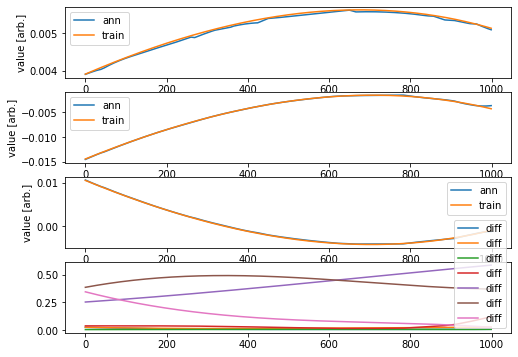

AG
AG
AG
AG
AG


0.01856771023674737


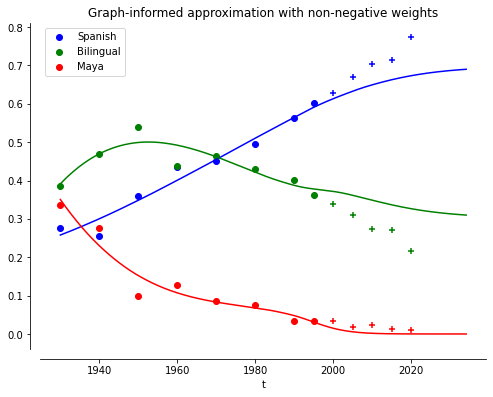

Epoch 1/500
32/32 - 1s - loss: 0.0011 - 866ms/epoch - 27ms/step
Epoch 2/500
32/32 - 0s - loss: 7.5077e-05 - 68ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.9708e-05 - 74ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 8.1524e-06 - 69ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.6375e-06 - 72ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.0287e-06 - 73ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 2.1697e-06 - 67ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.6612e-06 - 67ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.3076e-06 - 80ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0484e-06 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.7150e-07 - 80ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 7.4842e-07 - 68ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 6.5783e-07 - 68ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 5.8816e-07 - 78ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 5.3372e-07 - 73ms/epoch - 2ms/step
Epoch 

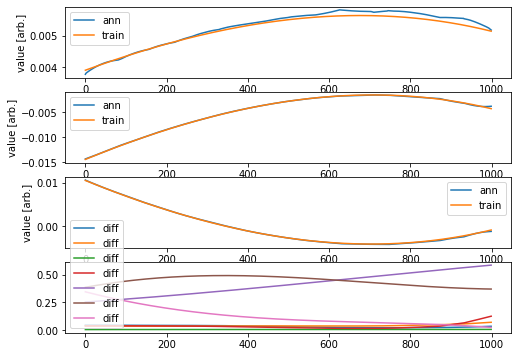

AG
AG
AG
AG
AG


0.027442093816087983


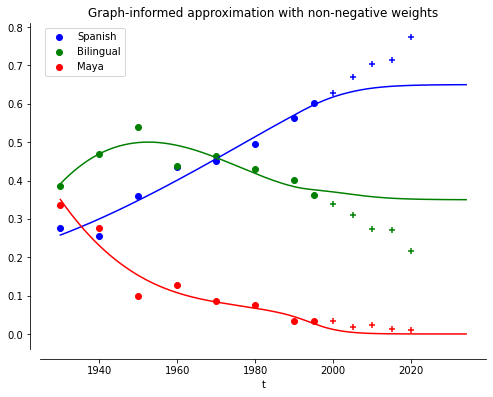

Epoch 1/500
32/32 - 1s - loss: 3.5390e-04 - 879ms/epoch - 27ms/step
Epoch 2/500
32/32 - 0s - loss: 1.3298e-05 - 80ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.7176e-06 - 80ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.3816e-06 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7951e-06 - 103ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4384e-06 - 84ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2132e-06 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0628e-06 - 73ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 9.5415e-07 - 76ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 8.6537e-07 - 73ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 7.8495e-07 - 71ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 7.0724e-07 - 83ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.4114e-07 - 74ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 5.7957e-07 - 71ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 5.2742e-07 - 78ms/epoch - 2ms/step
E

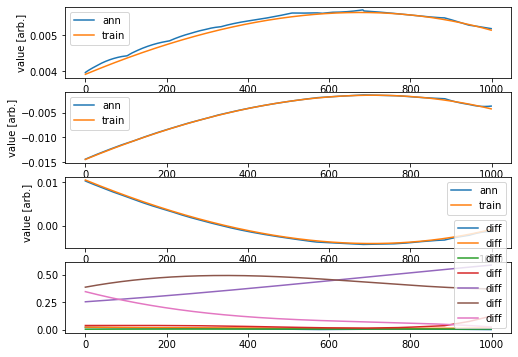

AG
AG
AG
AG
AG


0.012162947505837202


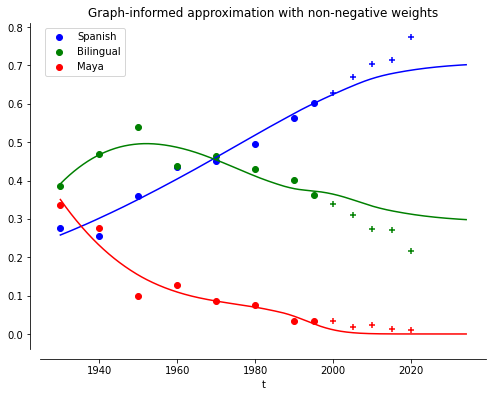

Epoch 1/500
32/32 - 1s - loss: 3.5684e-04 - 835ms/epoch - 26ms/step
Epoch 2/500
32/32 - 0s - loss: 6.6178e-06 - 76ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.3607e-06 - 79ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.7911e-06 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.5152e-06 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3260e-06 - 80ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1533e-06 - 94ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0062e-06 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.0858e-07 - 101ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.4921e-07 - 85ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.9235e-07 - 94ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.3280e-07 - 80ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 6.9317e-07 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.5522e-07 - 83ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.2592e-07 - 92ms/epoch - 3ms/step
E

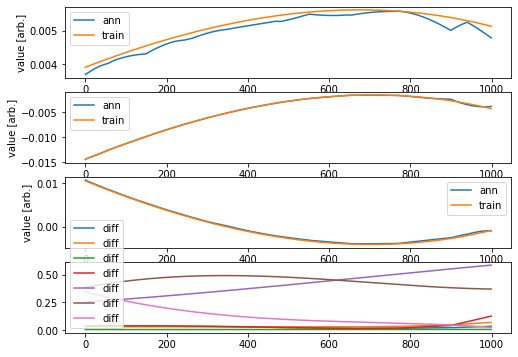

AG
AG
AG
AG
AG


0.023091042334413454


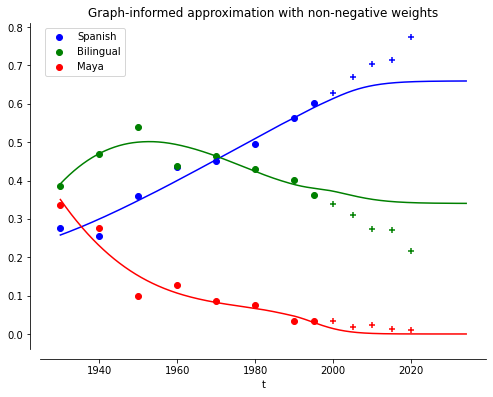

Epoch 1/500
32/32 - 1s - loss: 3.6997e-04 - 856ms/epoch - 27ms/step
Epoch 2/500
32/32 - 0s - loss: 5.0929e-06 - 72ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.0570e-06 - 74ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3095e-06 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.0300e-07 - 78ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.2556e-07 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.3013e-07 - 85ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.7931e-07 - 82ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.4674e-07 - 80ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.2410e-07 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.0673e-07 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.8681e-07 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.8120e-07 - 81ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.6547e-07 - 81ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.5560e-07 - 76ms/epoch - 2ms/step
Ep

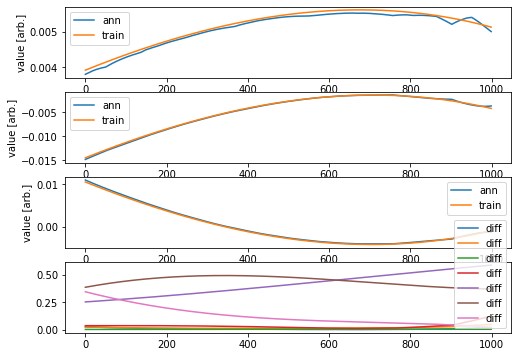

AG
AG
AG
AG
AG


0.030266233978997293


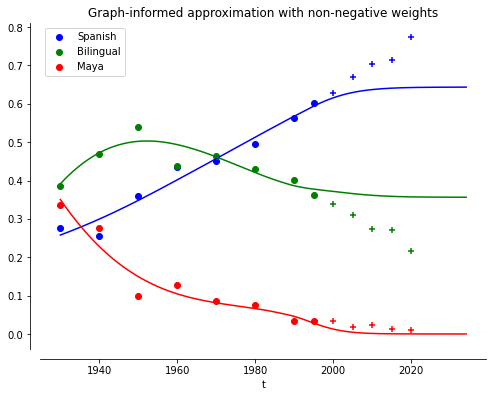

Epoch 1/500
32/32 - 1s - loss: 5.5024e-04 - 851ms/epoch - 27ms/step
Epoch 2/500
32/32 - 0s - loss: 4.1988e-05 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 8.4927e-06 - 76ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 4.4144e-06 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.7810e-06 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8242e-06 - 103ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2531e-06 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 9.3756e-07 - 99ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.6282e-07 - 124ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 6.5318e-07 - 101ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.8567e-07 - 98ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.3905e-07 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.0700e-07 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.7674e-07 - 90ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.5458e-07 - 97ms/epoch - 3ms/step

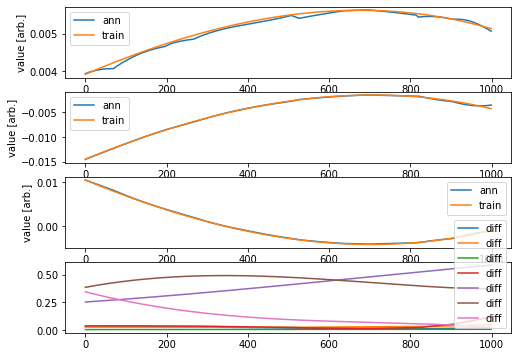

AG
AG
AG
AG
AG


0.025775827626451323


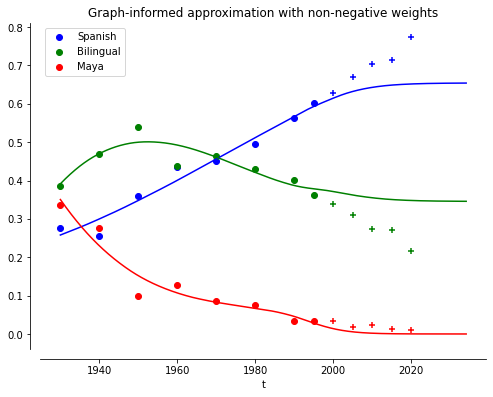

Epoch 1/500
32/32 - 1s - loss: 8.0530e-04 - 853ms/epoch - 27ms/step
Epoch 2/500
32/32 - 0s - loss: 3.0632e-05 - 87ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.9794e-06 - 81ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2625e-06 - 82ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.1100e-07 - 77ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9895e-07 - 80ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.3115e-07 - 79ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.5935e-07 - 91ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.9531e-07 - 73ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.4876e-07 - 78ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 5.1658e-07 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.8815e-07 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.6608e-07 - 81ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.4600e-07 - 78ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.2973e-07 - 78ms/epoch - 2ms/step
Ep

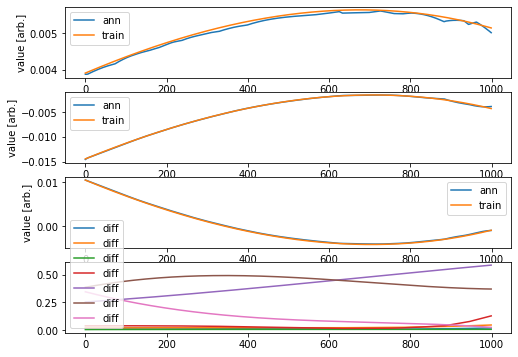

AG
AG
AG
AG
AG


0.029465637674096098


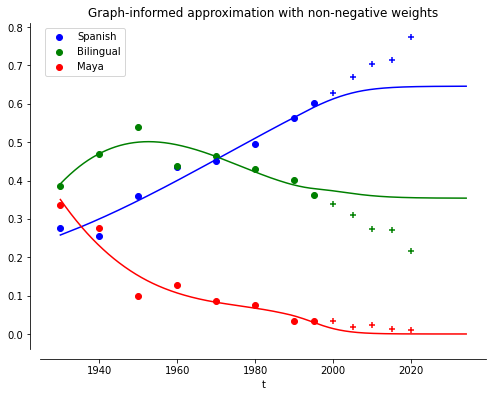

Epoch 1/500
32/32 - 1s - loss: 2.2670e-04 - 939ms/epoch - 29ms/step
Epoch 2/500
32/32 - 0s - loss: 2.3024e-06 - 83ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 6.3483e-07 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.2386e-07 - 83ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.8376e-07 - 67ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.5990e-07 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.3919e-07 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.2309e-07 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.0983e-07 - 85ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.9788e-07 - 84ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8772e-07 - 85ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8007e-07 - 77ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.7171e-07 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.6559e-07 - 95ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5926e-07 - 80ms/epoch - 3ms/step
Ep

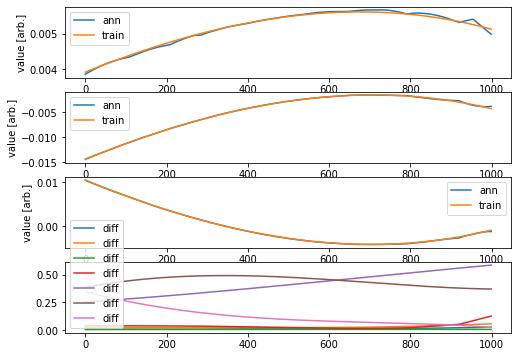

AG
AG
AG
AG
AG


0.022982037673078153


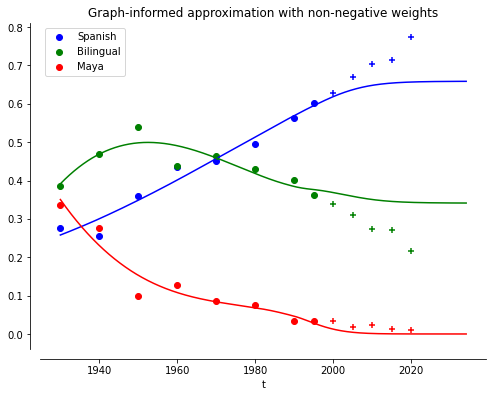

Epoch 1/500
32/32 - 1s - loss: 2.4746e-04 - 916ms/epoch - 29ms/step
Epoch 2/500
32/32 - 0s - loss: 6.5124e-06 - 75ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.8269e-06 - 85ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0196e-06 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 7.2171e-07 - 85ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.8736e-07 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.1233e-07 - 81ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.6045e-07 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.2253e-07 - 77ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.9348e-07 - 80ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.6767e-07 - 82ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4658e-07 - 89ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.2511e-07 - 85ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.0664e-07 - 86ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.8885e-07 - 81ms/epoch - 3ms/step
Ep

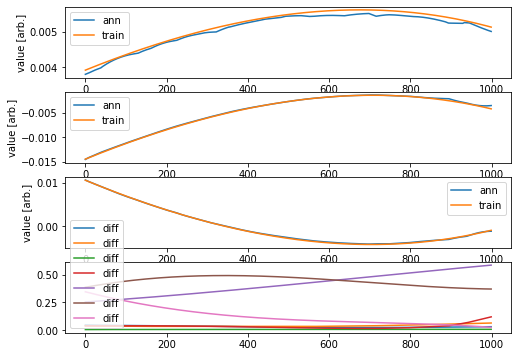

AG
AG
AG
AG
AG


0.019403939513184358


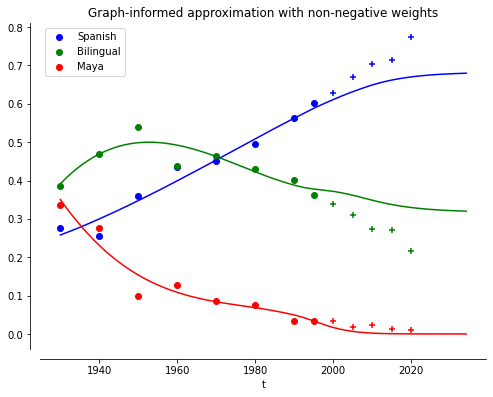

Epoch 1/500
32/32 - 1s - loss: 5.3208e-04 - 842ms/epoch - 26ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4592e-05 - 85ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.0678e-06 - 80ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.4446e-06 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.8262e-06 - 86ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.5091e-06 - 86ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3148e-06 - 85ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1721e-06 - 103ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0673e-06 - 84ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.8361e-07 - 90ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 9.1254e-07 - 86ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.5771e-07 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 8.0575e-07 - 93ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.6169e-07 - 82ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.1923e-07 - 76ms/epoch - 2ms/step
E

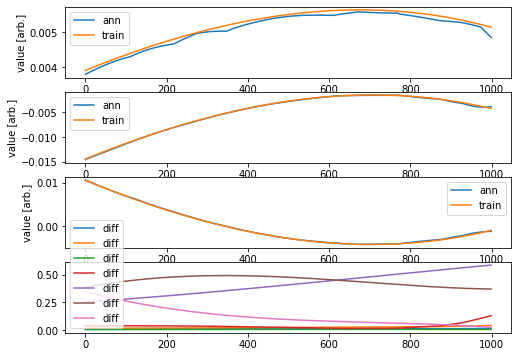

AG
AG
AG
AG
AG


0.016505023124488802


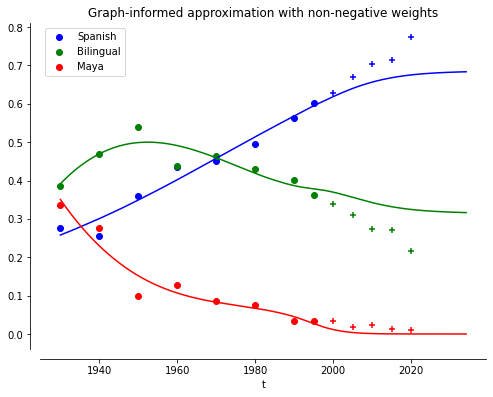

Epoch 1/500
32/32 - 1s - loss: 0.0013 - 836ms/epoch - 26ms/step
Epoch 2/500
32/32 - 0s - loss: 9.4703e-05 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.5204e-05 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.1003e-05 - 71ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 6.0075e-06 - 81ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.0618e-06 - 79ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 3.1500e-06 - 84ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.6140e-06 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.2267e-06 - 85ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.9351e-06 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.6932e-06 - 83ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.4989e-06 - 83ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.3431e-06 - 86ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.2165e-06 - 86ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.1063e-06 - 87ms/epoch - 3ms/step
Epoch 

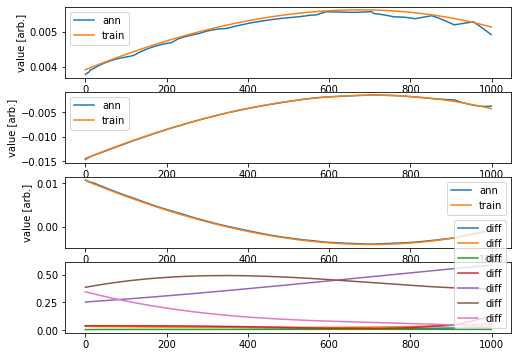

AG
AG
AG
AG
AG


0.023620078892798456


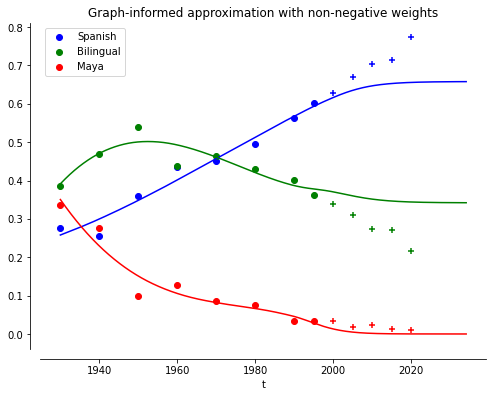

Epoch 1/500
32/32 - 1s - loss: 3.2563e-04 - 818ms/epoch - 26ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6742e-05 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.0663e-06 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.7898e-06 - 87ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2953e-06 - 97ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 9.6782e-07 - 75ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 7.5894e-07 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.1596e-07 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.1866e-07 - 80ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.6033e-07 - 82ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.1500e-07 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.7868e-07 - 77ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 3.5001e-07 - 81ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.2313e-07 - 84ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.0195e-07 - 80ms/epoch - 3ms/step
Ep

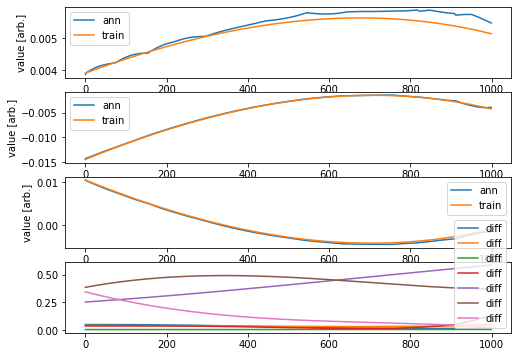

AG
AG
AG
AG
AG


0.023149736843428734


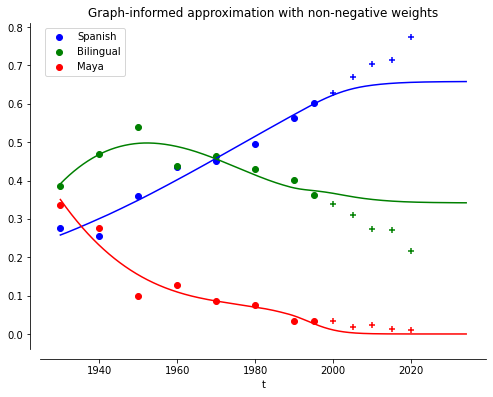

Epoch 1/500
32/32 - 1s - loss: 4.8117e-04 - 948ms/epoch - 30ms/step
Epoch 2/500
32/32 - 0s - loss: 5.0208e-06 - 111ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.1111e-06 - 83ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.4815e-06 - 83ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2198e-06 - 99ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0253e-06 - 101ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.8575e-07 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.9776e-07 - 85ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.3805e-07 - 84ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.8673e-07 - 85ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.4485e-07 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.0665e-07 - 83ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.7247e-07 - 84ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.3842e-07 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.0568e-07 - 126ms/epoch - 4ms/step

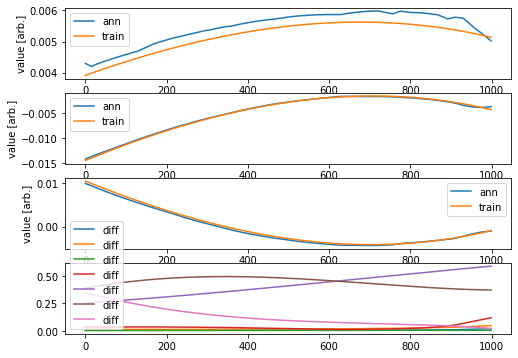

AG
AG
AG
AG
AG


0.030552811147124537


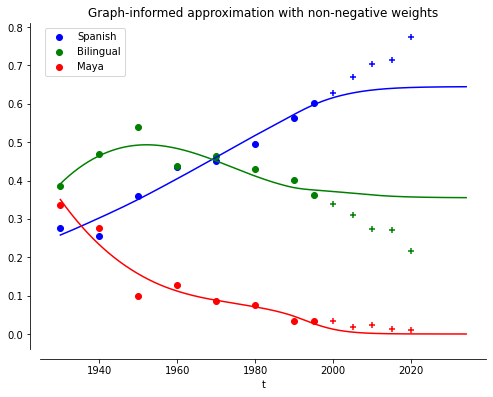

Epoch 1/500
32/32 - 1s - loss: 0.0019 - 858ms/epoch - 27ms/step
Epoch 2/500
32/32 - 0s - loss: 1.1669e-04 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.5030e-05 - 112ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.4505e-05 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.5183e-06 - 107ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.1501e-06 - 123ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 4.2699e-06 - 101ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.7282e-06 - 120ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 3.3011e-06 - 124ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.9381e-06 - 113ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6288e-06 - 120ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.3562e-06 - 75ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.1173e-06 - 77ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 1.9096e-06 - 75ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.7229e-06 - 77ms/epoch - 2ms/st

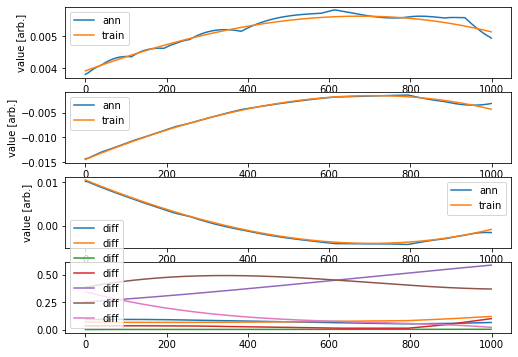

AG
AG
AG
AG
AG


0.03226435157325354


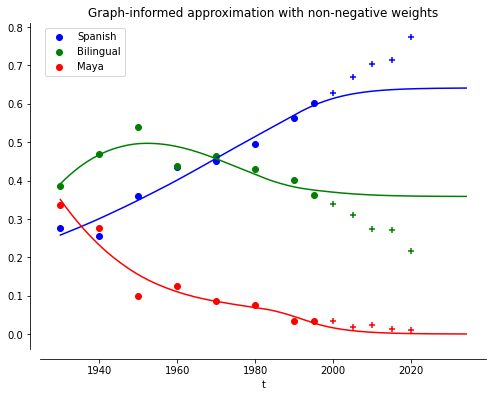

Epoch 1/500
32/32 - 1s - loss: 4.2792e-04 - 1s/epoch - 32ms/step
Epoch 2/500
32/32 - 0s - loss: 1.1286e-05 - 129ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.6395e-06 - 126ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.1105e-06 - 106ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.8322e-06 - 128ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.6503e-06 - 114ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5172e-06 - 126ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4034e-06 - 112ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.2970e-06 - 122ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.1967e-06 - 118ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1017e-06 - 134ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0152e-06 - 131ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 9.3805e-07 - 112ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.7431e-07 - 100ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.1488e-07 - 95ms/epoch - 3

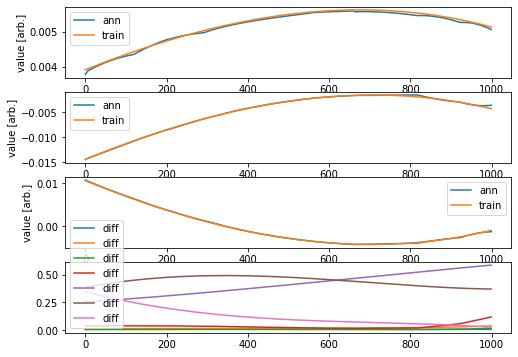

AG
AG
AG
AG
AG


0.021187411775716498


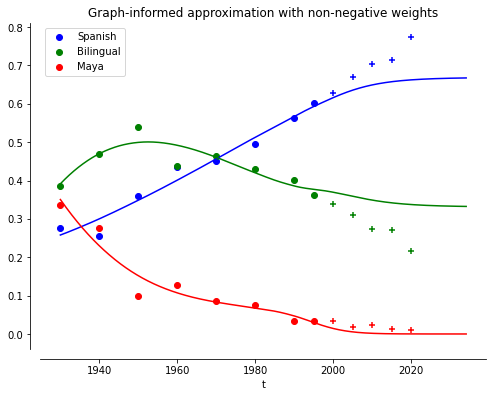

Epoch 1/500
32/32 - 1s - loss: 4.3587e-04 - 842ms/epoch - 26ms/step
Epoch 2/500
32/32 - 0s - loss: 3.5601e-05 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 5.5249e-06 - 83ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.7902e-06 - 84ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.9017e-06 - 81ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4133e-06 - 94ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1072e-06 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.8972e-07 - 92ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.4020e-07 - 81ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.3558e-07 - 79ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 5.5970e-07 - 84ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.9558e-07 - 100ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.4240e-07 - 109ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.9813e-07 - 97ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.6359e-07 - 106ms/epoch - 3ms/step

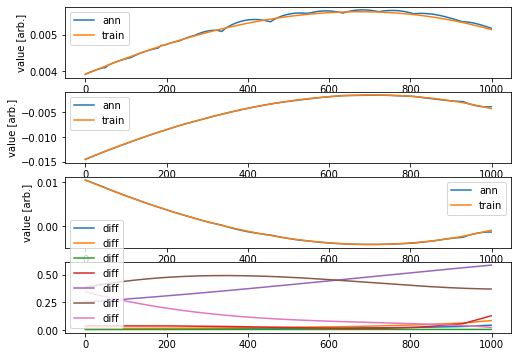

AG
AG
AG
AG
AG


0.02680966339646332


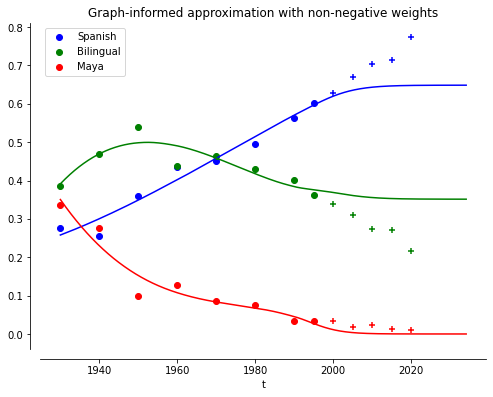

Epoch 1/500
32/32 - 1s - loss: 4.6954e-04 - 921ms/epoch - 29ms/step
Epoch 2/500
32/32 - 0s - loss: 1.1936e-05 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.9498e-06 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.1259e-06 - 85ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.6258e-06 - 81ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2130e-06 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.0358e-07 - 109ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.9121e-07 - 94ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.4436e-07 - 140ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 4.4392e-07 - 137ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.8588e-07 - 118ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.5367e-07 - 113ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.3420e-07 - 122ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 3.1935e-07 - 115ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.0718e-07 - 107ms/epoch - 3ms

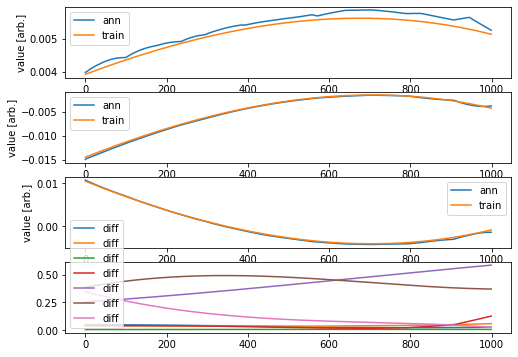

AG
AG
AG
AG
AG


0.020897723628448772


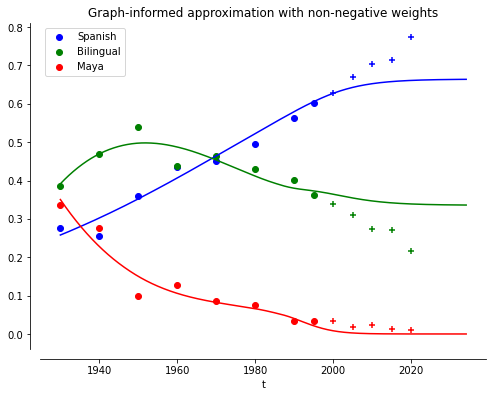

Epoch 1/500
32/32 - 1s - loss: 2.0810e-04 - 847ms/epoch - 26ms/step
Epoch 2/500
32/32 - 0s - loss: 9.0807e-06 - 87ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.6781e-06 - 83ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.0315e-06 - 80ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7657e-06 - 85ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.5437e-06 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3600e-06 - 83ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.2101e-06 - 75ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0837e-06 - 73ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 9.8311e-07 - 75ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 8.9627e-07 - 85ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.2730e-07 - 81ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.6663e-07 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.1600e-07 - 81ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.7337e-07 - 79ms/epoch - 2ms/step
Ep

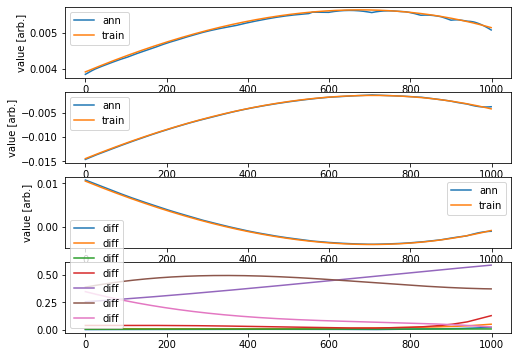

AG
AG
AG
AG
AG


0.026448137024705807


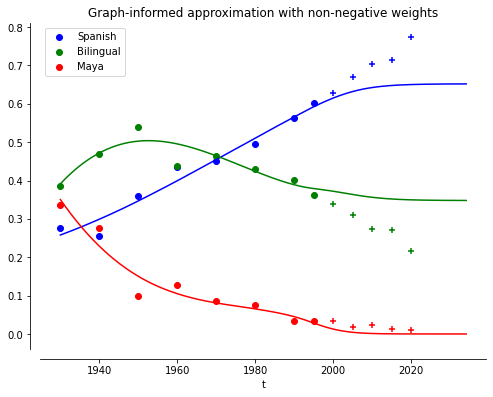

[0.020671255590110526, 0.026446942484066212, 0.02575461558963701, 0.025878354408378778, 0.021818934607130303, 0.024659598685438426, 0.01568496811622431, 0.019548361728626378, 0.02567789124868794, 0.025484804518834524, 0.026692226575102646, 0.025127512133166316, 0.01856771023674737, 0.027442093816087983, 0.012162947505837202, 0.023091042334413454, 0.030266233978997293, 0.025775827626451323, 0.029465637674096098, 0.022982037673078153, 0.019403939513184358, 0.016505023124488802, 0.023620078892798456, 0.023149736843428734, 0.030552811147124537, 0.03226435157325354, 0.021187411775716498, 0.02680966339646332, 0.020897723628448772, 0.026448137024705807]


In [ ]:
M2 = [0.020671255590110526,0.026446942484066212]

for _ in range(28):
  #total = train2(X,Y,B,dX,dY,dB,mode = '1')
  #M1.append(total)
  total = train2(X,Y,B,dX,dY,dB,mode = '2')
  M2.append(total)

#print(M1)
print(M2)

In [ ]:
M1 = [0.010454283423124447, 0.019254480315644293, 0.021692743207853894, 0.06645435828369922, 0.006066428194062207, 0.021482497861640304, 0.030612596024007524, 0.003658614976937473, 0.01880122686615164, 0.01579714694507681, 0.011415258313340585, 0.03220557820742494, 0.0181698626416682, 0.002777574705453019, 0.031671126014965384, 0.03188042431571689, 0.03789603408160484, 0.01751179584250416, 0.03492488481318315, 0.029686863644918265, 0.017253729266877404, 0.012886892871511737, 0.04049786884231662, 0.03170022423260563, 0.03204863302184853, 0.006719212888320001, 0.008448397738114354, 0.011364785541702916, 0.0246986078452396, 0.008672809876880166]
M2 = [0.026426995058175477, 0.025571506303966887, 0.01209504588776629, 0.02839082054287933, 0.01607127611631844, 0.0029592931009926886, 0.019412653185795645, 0.003328131287920092, 0.047308590256843114, 0.006360455354487345, 0.0221719056018232, 0.026470638304661124, 0.016726306935615217, 0.03354420073602951, 0.003858890029825336, 0.028860311298866077, 0.02935008009102282, 0.018140979966707747, 0.024776261982433788, 0.020368504568105066, 0.0039721307058488975, 0.03628468942508103, 0.023942586984323375, 0.011082129336498013, 0.05191106315549199, 0.022620950349245227, 0.012705584006793256, 0.03072386098754109, 0.13799981421780755, 0.017259789826829987]

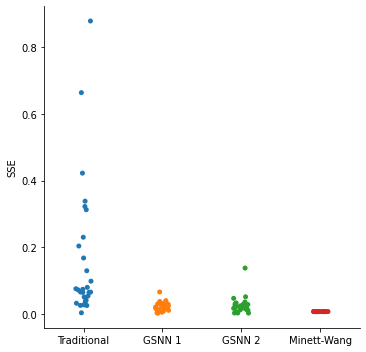

In [ ]:
import seaborn as sns
import pandas as pd

d = {'Traditional':Trad,'GSNN 1':M1,'GSNN 2':M2,'Minett-Wang':30*[0.00768354]}
df = pd.DataFrame(data=d)

g = sns.catplot(data=df)
#g.set(ylim=(0,0.2),ylabel='SSE')
g.set(ylabel='SSE')
g.savefig('comparison.eps')

In [ ]:
print(sum(Trad)/30.)
print(sum(M1)/30.)
print(sum(M2)/30.)

0.15727582982139973
0.02189016469347981
0.0238012624483575


In [ ]:
from scipy import stats

print(stats.ttest_ind(Trad,M1,equal_var=False))
print(stats.ttest_ind(Trad,M2,equal_var=False))
print(stats.ttest_ind(M1,M2,equal_var=False))

Ttest_indResult(statistic=3.681224581737918, pvalue=0.0009340026604260404)
Ttest_indResult(statistic=3.636797064140782, pvalue=0.0010607895520319663)
Ttest_indResult(statistic=-0.7226066623601995, pvalue=0.47467615236089733)


# Evolutionary approach

In [ ]:
import random

def binaryRarray(nl,p):
  Pr = []
  for i in range(nl):
    r = random.random()
    if r > p:
      Pr.append(0)
    else: 
      Pr.append(1)
  return Pr

i12,i13,i21,i23,i31,i32 = binaryRarray(6,1)


In [ ]:
def custom_loss3(y_true,y_pred):
  #y_pred = y_pred.numpy()
  #print(y_pred[:,0].numpy())
  #f11 = y_pred[:,0]
  f12 = y_pred[:,0]
  f13 = y_pred[:,1]
  f21 = y_pred[:,2]
  #f22 = y_pred[:,4]
  f23 = y_pred[:,3]
  f31 = y_pred[:,4]
  f32 = y_pred[:,5]
  #f33 = y_pred[:,8]
  x = y_pred[:,6]
  b = y_pred[:,7]
  y = y_pred[:,8]

  a = i12*b*f12 + i13*y*f13 - i21*x*f21 - i31*x*f31
  b = i21*x*f21 + i23*y*f23 - i12*b*f12 - i32*b*f32
  c = i31*x*f31 + i32*b*f32 - i13*y*f13 - i23*y*f23

  a = tf.reshape(a, [len(a), 1])
  b = tf.reshape(b, [len(b), 1])
  c = tf.reshape(c, [len(c), 1])

  y_pred2 = tf.concat((a, b ,c ),axis=1)

  diff = math_ops.squared_difference(y_pred2,y_true)
  loss = K.mean(diff, axis=-1)
  return loss

In [ ]:
def procesarSalida(y_pred):
  f12 = y_pred[:,0]
  f13 = y_pred[:,1]
  f21 = y_pred[:,2]
  #f22 = y_pred[:,4]
  f23 = y_pred[:,3]
  f31 = y_pred[:,4]
  f32 = y_pred[:,5]
  #f33 = y_pred[:,8]
  x = y_pred[:,6]
  b = y_pred[:,7]
  y = y_pred[:,8]

  a = i12*b*f12 + i13*y*f13 - i21*x*f21 - i31*x*f31
  b = i21*x*f21 + i23*y*f23 - i12*b*f12 - i32*b*f32
  c = i31*x*f31 + i32*b*f32 - i13*y*f13 - i23*y*f23
  #print(np.sum(a+b+c))
  y_pred2 = np.array([a,b,c]).T
  #y_pred2 = np.concatenate((a, b ,c ),axis=0)
  #y_pred2 = y_pred2.reshape(len(y_pred), 3).T
  return y_pred2

In [ ]:
def procesarSalida2(y_pred):
  f12 = y_pred[0]
  f13 = y_pred[1]
  f21 = y_pred[2]
  #f22 = y_pred[4]
  f23 = y_pred[3]
  f31 = y_pred[4]
  f32 = y_pred[5]
  #f33 = y_pred[8]
  x = y_pred[6]
  b = y_pred[7]
  y = y_pred[8]

  a = i12*b*f12 + i13*y*f13 - i21*x*f21 - i31*x*f31
  b = i21*x*f21 + i23*y*f23 - i12*b*f12 - i32*b*f32
  c = i31*x*f31 + i32*b*f32 - i13*y*f13 - i23*y*f23
  #print(a,b,c)
  #print(a+b+c)
  #print(b*f2 - x*f1 + x*f1 + y*f4 - b*f2 - b*f3 + b*f3 - y*f4)
  y_pred2 = np.array([a,b,c]).T
  #y_pred2 = np.concatenate((a, b ,c ),axis=0)
  #y_pred2 = y_pred2.reshape(len(y_pred), 3).T
  return y_pred2

In [ ]:
print(T0t) 

[2000, 2005, 2010, 2015, 2020]


In [ ]:
def train3(X,Y,B,dX,dY,dB,mode = '1'):
  X = X.reshape(-1,1)
  Y = Y.reshape(-1,1)
  B = B.reshape(-1,1)
  dX= dX.reshape(-1,1)
  dY= dY.reshape(-1,1)
  dB= dB.reshape(-1,1)

  Xa = np.concatenate((X,B,Y),axis=1)
  dXa = np.concatenate((dX,dB,dY),axis=1)

  inp = keras.layers.Input(shape=(3,))
  x1 = Dense(50,activation='relu')(inp) # 
  if mode == '1':
    x2 = Dense(50,activation='relu')(x1)
    x3 = Dense(6,activation='linear')(x2)
  else:
    x2 = Dense(50,activation='relu')(x1)
    x3 = Dense(6,activation='linear',kernel_constraint=NonNeg())(x2) # ,kernel_constraint=NonNeg()

  conc = keras.layers.Concatenate()([x3,inp])

  model = keras.models.Model(inputs=inp,outputs=conc)

  model.compile(loss=custom_loss3, optimizer='adam')
 
  model.fit(Xa, dXa, epochs=500, batch_size=32, verbose=2)
  res = model.predict(Xa)
  y_pred = procesarSalida(res).T

  mpl.rcParams['figure.figsize'] = (8, 6)

  pl.subplot(411)
  pl.plot(y_pred[0], label='ann')
  pl.plot(dX, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(412)
  pl.plot(y_pred[2], label='ann')
  pl.plot(dY, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(413)
  pl.plot(y_pred[1], label='ann')
  pl.plot(dB, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(414)
  pl.plot(np.abs(dX - res), label='diff')
  pl.legend()
  pl.show()

  x0 = polinomio(theta1,1930)
  y0 = polinomio(theta2,1930)
  b0 = polinomio(theta3,1930)
  #y02= polinomio(theta2,1930)


  Xn = [x0]
  Yn = [y0]
  Bn = [b0]
  #Yn2= [y02]

  h = .06506507 #1/10.
  t = 1930
  Tn = [t]
  #D = []

  j = 0
  suma = 0
  suma2 = 0

  for i in range(1600):#range(int((2025-1930)*(1/h))):
    t += h
    p1 = [[x0,b0,y0]]
    out = model.predict(p1)[0]
    d = procesarSalida2(out).T
    d1 = d[0]
    d2 = d[2]
    d3 = d[1]
    y1 = y0 + h*d2 #res_rscl2[i][0]
    b1 = b0 + h*d3 
    x1 = 1 - y1-b1 #x0 + h*d1 #*res_rscl[i][0]
    if y1 <0:
      suma += y1**2
      #break

    #print(x1 + y1+ b1)


    if len(T0t) > j:
      if abs(t-float(T0t[j])) < .07:
        print(t)
        if t > 1994 and t <= 2009:
          suma += (x1-Espat[j])**2 + (y1-Mayat[j])**2
        elif t >= 2009:
          suma2 += (x1-Espat[j])**2 + (y1-Mayat[j])**2 
        j += 1


    Xn.append(x1)
    Yn.append(y1)
    Bn.append(b1)
    #Yn2.append(y2)
    Tn.append(t)
    x0 = x1 + 0
    y0 = y1 + 0
    b0 = b1 + 0
    #y02 = y2 + 0
  print("Validation loss:",suma)
  print("Test loss:",suma2)

  fig,ax = plt.subplots()

  ax.scatter(T0,Espa,color='blue',label='Spanish')
  ax.scatter(T0t,Espat,color='blue',marker='+')
  ax.plot(Tn,Xn,color='blue')
  ax.scatter(T0,Bilin,color='green',label='Bilingual')
  ax.scatter(T0t,Bilint,color='green',marker='+')
  ax.plot(Tn,Bn,color='green')
  ax.scatter(T0,Maya,color='red',label='Maya')
  ax.scatter(T0t,Mayat,color='red',marker='+')
  ax.plot(Tn,Yn,color='red')

  #ax.scatter(T0,Bilin, color = (0.4,0.7,0.3),label='Bilingual',marker='o',s=20)
  #ax.scatter(T0,Espa, color = (0,0,1),label='Spanish',marker='x',s=20)
  #ax.scatter(T0,Maya, color = (1,0,0),label='Maya',marker='+',s=20)
  if mode == '1':
    ax.set_title(u"Graph-Supported approximation of Spanish-Maya interaction in Yucatan")
  else:
    ax.set_title(u"Graph-Supported approximation with non-negative weights")#1920-2015")
  #ax.yaxis.title("t")
  ax.set_xlabel("t")
  #ax.set_ylabel("Casos registrados")
  ax.spines['left'].set_position(('outward',10))
  ax.spines['bottom'].set_position(('outward',10))
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  #ax.set_yticks(range(10),minor=True)
  #ax.set_ylim([0,100])
  ax.legend(framealpha=1)
  #ax.legend(bbox_to_anchor=(1.1, 1.05))
  ax.legend()#(loc="upper left", bbox_to_anchor=(0.8,0.2))
  ax.yaxis.set_ticks_position('left')
  ax.xaxis.set_ticks_position('bottom')
  if mode == '1':
    plt.savefig('new1.eps')
  else:
    plt.savefig('evolved.eps')
  plt.show() 

  return suma

Epoch 1/500
32/32 - 1s - loss: 1.4741e-04 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 4.5892e-06 - 67ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.3729e-06 - 65ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 8.9224e-07 - 66ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 6.8266e-07 - 61ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 5.7660e-07 - 65ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 5.1128e-07 - 69ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 4.6627e-07 - 66ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3301e-07 - 62ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.0985e-07 - 60ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.9111e-07 - 58ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.7789e-07 - 41ms/epoch - 1ms/step
Epoch 13/500
32/32 - 0s - loss: 3.6700e-07 - 41ms/epoch - 1ms/step
Epoch 14/500
32/32 - 0s - loss: 3.5829e-07 - 45ms/epoch - 1ms/step
Epoch 15/500
32/32 - 0s - loss: 3.5120e-07 - 44ms/epoch - 1ms/step
Epoch

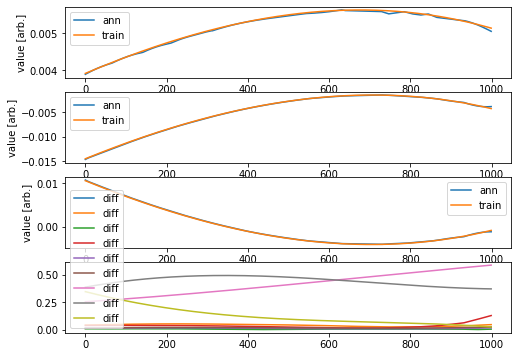

1999.944950249942
2004.9549606399378
2009.9649710299336
2014.9749814199295
2019.9849918099253


Validation loss: 0.0021945652256244166
Test loss: 0.023302830809405123


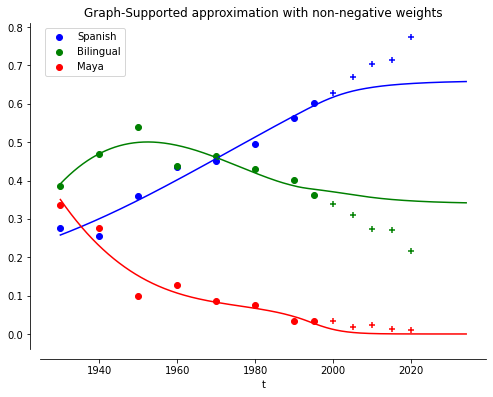

In [ ]:
i12,i13,i21,i23,i31,i32 = [1, 0, 1, 1, 0, 0] #[1,1,1,1,1,1] #[0, 1, 0, 1, 0, 0] 
total = train3(X,Y,B,dX,dY,dB,mode = '2')

Epoch 1/500
32/32 - 1s - loss: 1.3206e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 5.4455e-06 - 63ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.1978e-06 - 55ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 7.2172e-07 - 56ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 5.3974e-07 - 69ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.5721e-07 - 58ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 4.1541e-07 - 56ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.8436e-07 - 60ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.6898e-07 - 66ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.5609e-07 - 65ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.4379e-07 - 68ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.3344e-07 - 74ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 3.2215e-07 - 60ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.1434e-07 - 59ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 3.0528e-07 - 62ms/epoch - 2ms/step
Epoch

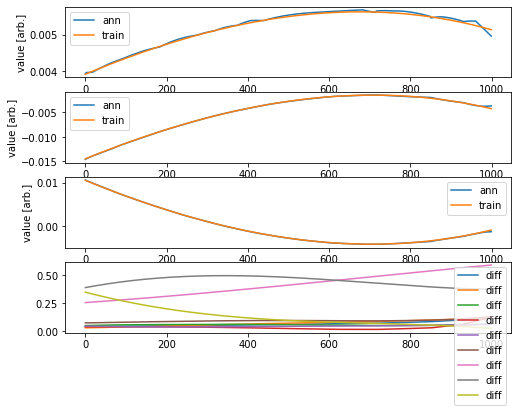

AG
AG
AG
AG
AG


0.032916250540085526


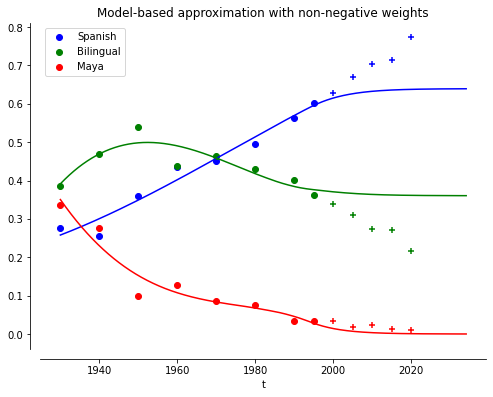

Epoch 1/500
32/32 - 1s - loss: 8.0554e-04 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 5.5515e-05 - 60ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.8206e-05 - 55ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 9.6282e-06 - 61ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.6579e-06 - 62ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 2.1929e-06 - 72ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1839e-06 - 65ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 8.2245e-07 - 64ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 6.6379e-07 - 63ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.8491e-07 - 68ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 5.3731e-07 - 59ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.0382e-07 - 60ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 4.7868e-07 - 70ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.5543e-07 - 75ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.3846e-07 - 77ms/epoch - 2ms/step
Epoch

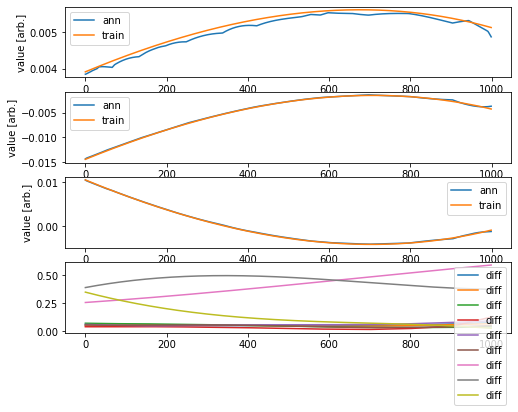

AG
AG
AG
AG
AG


0.03271228422255787


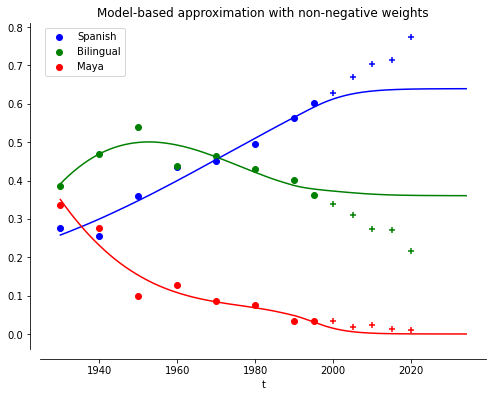

Epoch 1/500
32/32 - 1s - loss: 0.0016 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 8.7552e-05 - 64ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7869e-05 - 57ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.9114e-06 - 69ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.4039e-06 - 63ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2370e-06 - 69ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 8.4655e-07 - 61ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.9835e-07 - 64ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 6.2948e-07 - 65ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.8608e-07 - 70ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 5.5612e-07 - 65ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.3054e-07 - 63ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 5.0961e-07 - 64ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.9125e-07 - 64ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.7536e-07 - 64ms/epoch - 2ms/step
Epoch 16/

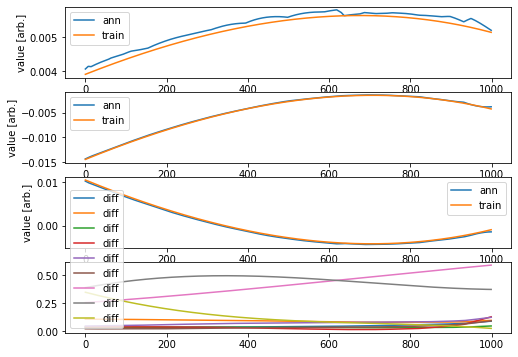

AG
AG
AG
AG
AG


0.027402478391873705


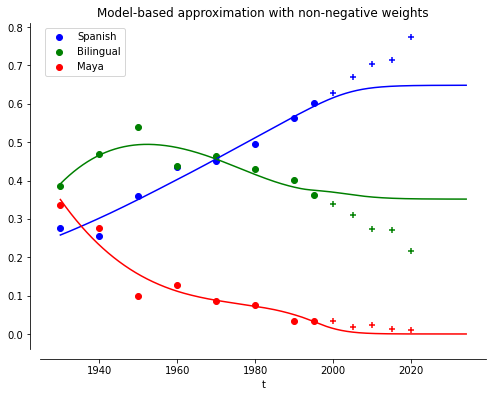

Epoch 1/500
32/32 - 1s - loss: 3.5741e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 7.0033e-06 - 61ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4021e-06 - 71ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 9.0993e-07 - 64ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 6.8006e-07 - 67ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 5.4871e-07 - 68ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 4.8064e-07 - 68ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 4.3554e-07 - 70ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.0451e-07 - 65ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.8069e-07 - 63ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.6133e-07 - 68ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4551e-07 - 75ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 3.3442e-07 - 66ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.2779e-07 - 69ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 3.2158e-07 - 75ms/epoch - 2ms/step
Epoch

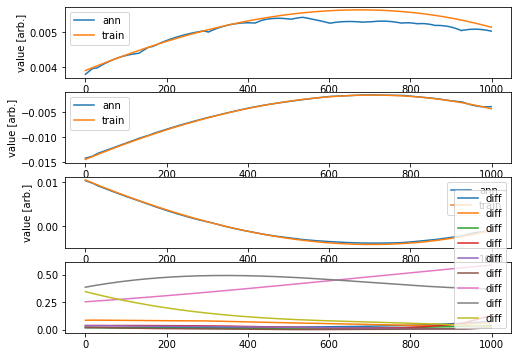

AG
AG
AG
AG
AG


0.027190385200374714


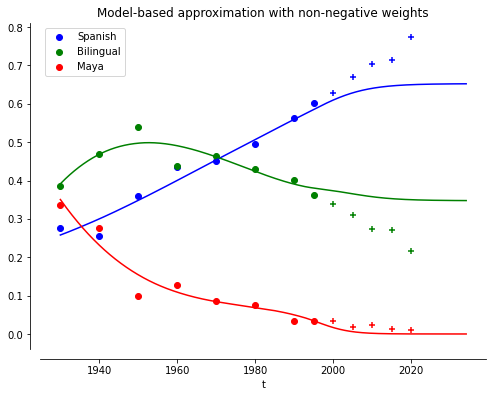

Epoch 1/500
32/32 - 1s - loss: 7.0046e-05 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 1.8943e-06 - 70ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 9.5626e-07 - 66ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 6.9767e-07 - 65ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 5.5590e-07 - 71ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.6875e-07 - 70ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 4.0810e-07 - 68ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.6338e-07 - 65ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.3335e-07 - 67ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1249e-07 - 66ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9578e-07 - 67ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8151e-07 - 69ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.7011e-07 - 70ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.6054e-07 - 67ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5224e-07 - 65ms/epoch - 2ms/step
Epoch

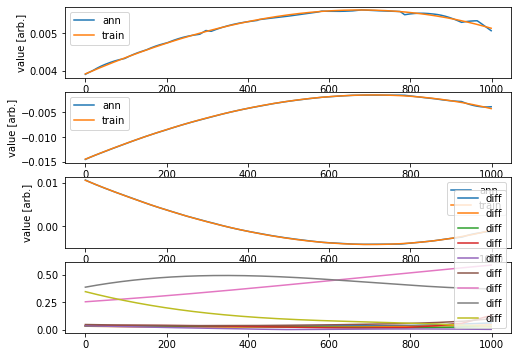

AG
AG
AG
AG
AG


0.02769129035158136


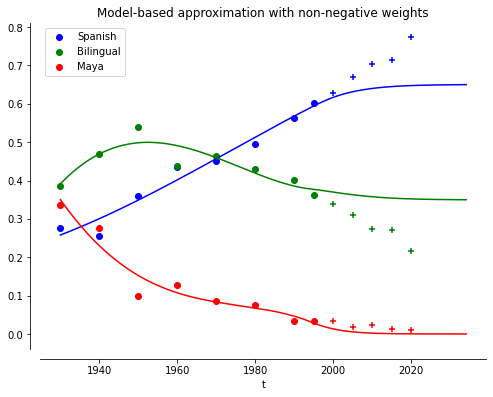

Epoch 1/500
32/32 - 1s - loss: 5.8663e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 2.7236e-05 - 64ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.8719e-06 - 74ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0743e-06 - 72ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 7.9921e-07 - 73ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.1220e-07 - 73ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 6.4876e-07 - 79ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.5581e-07 - 72ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.7325e-07 - 65ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.2698e-07 - 67ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.9688e-07 - 72ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.7242e-07 - 70ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 3.6046e-07 - 75ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.5211e-07 - 74ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 3.4436e-07 - 82ms/epoch - 3ms/step
Epoch

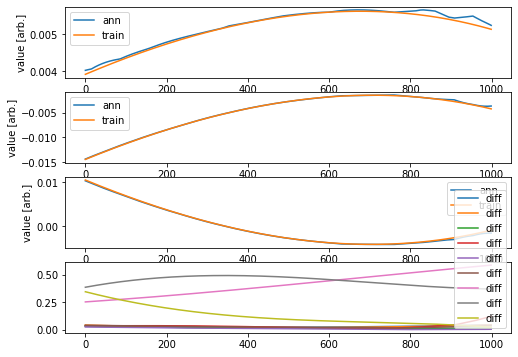

AG
AG
AG
AG
AG


0.0243074018731127


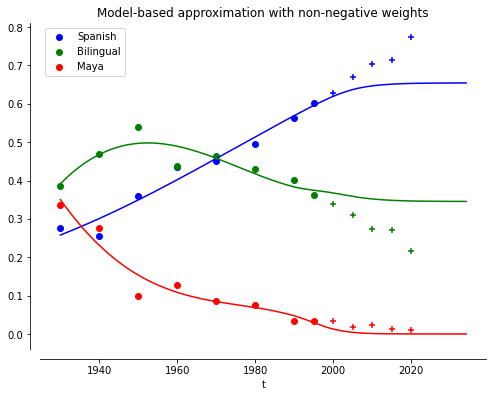

Epoch 1/500
32/32 - 1s - loss: 7.6044e-05 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 2.4732e-06 - 76ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 8.8908e-07 - 81ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.3605e-07 - 69ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.9681e-07 - 71ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.1632e-07 - 70ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 3.5938e-07 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.2350e-07 - 73ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.9695e-07 - 75ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 2.7599e-07 - 70ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.5882e-07 - 72ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.4305e-07 - 74ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.2917e-07 - 78ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.1845e-07 - 80ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0685e-07 - 94ms/epoch - 3ms/step
Epoch

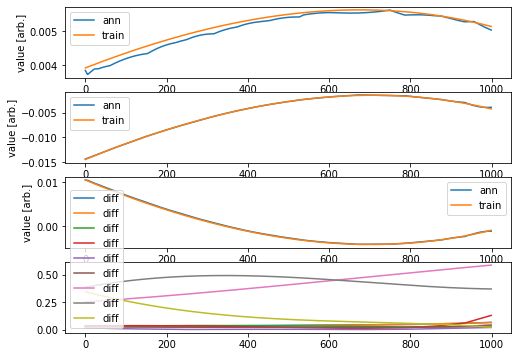

AG
AG
AG
AG
AG


0.019417431124501557


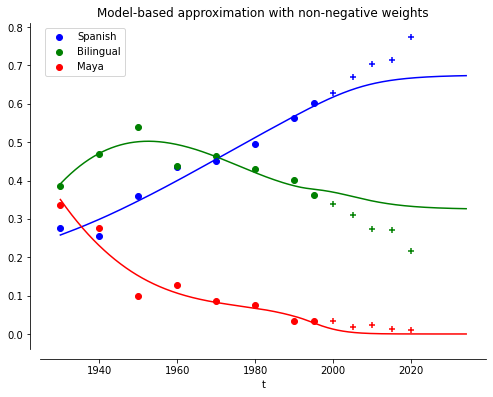

Epoch 1/500
32/32 - 1s - loss: 1.1470e-04 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 3.7096e-06 - 81ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 8.3374e-07 - 73ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.3415e-07 - 68ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.0740e-07 - 65ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.3511e-07 - 78ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 2.9910e-07 - 81ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.7602e-07 - 70ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.6038e-07 - 80ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.4895e-07 - 75ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.4125e-07 - 71ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.3360e-07 - 72ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.2828e-07 - 77ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.2275e-07 - 67ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.1850e-07 - 71ms/epoch - 2ms/step
Epoch

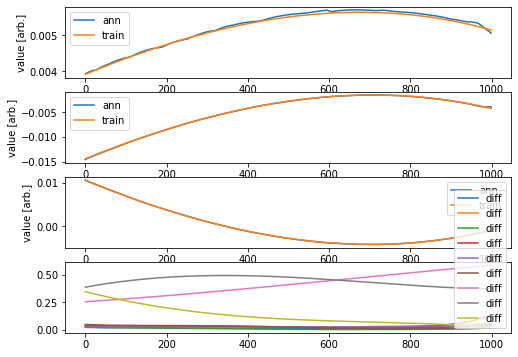

AG
AG
AG
AG
AG


0.026124385720490938


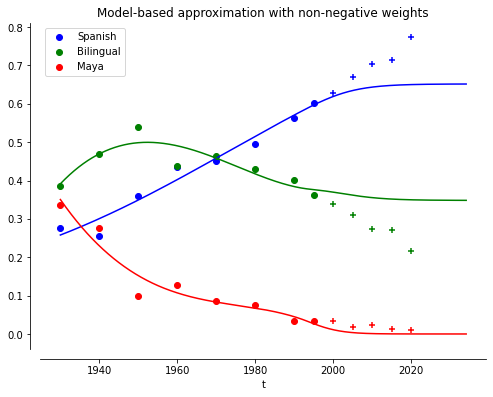

Epoch 1/500
32/32 - 1s - loss: 7.4379e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0131e-05 - 73ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7349e-06 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0149e-06 - 75ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 7.4808e-07 - 77ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 6.0353e-07 - 69ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 5.1265e-07 - 71ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 4.5043e-07 - 86ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.1033e-07 - 81ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.7919e-07 - 77ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.5555e-07 - 77ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.3374e-07 - 82ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.1608e-07 - 81ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.0070e-07 - 78ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.8454e-07 - 76ms/epoch - 2ms/step
Epoch

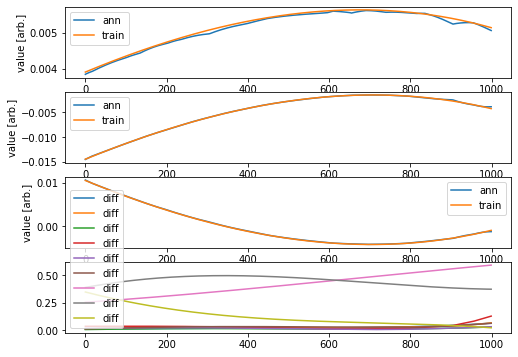

AG
AG
AG
AG
AG


0.026418419342401273


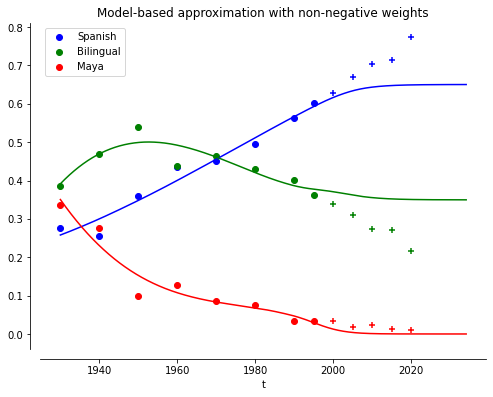

Epoch 1/500
32/32 - 1s - loss: 1.1043e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 8.6978e-06 - 84ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.2946e-06 - 71ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3252e-06 - 82ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.7610e-07 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9486e-07 - 79ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 6.8898e-07 - 75ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.9963e-07 - 72ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.9909e-07 - 81ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.3619e-07 - 74ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 4.0929e-07 - 75ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.9450e-07 - 78ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 3.8299e-07 - 71ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.7517e-07 - 88ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.6266e-07 - 82ms/epoch - 3ms/step
Epoch

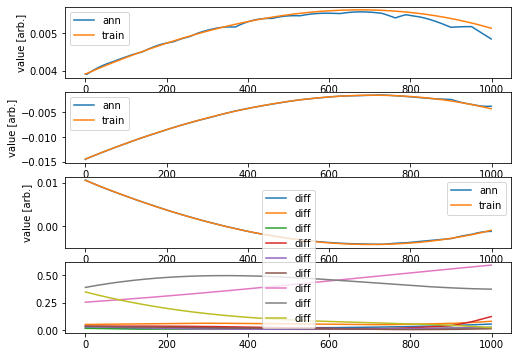

AG
AG
AG
AG
AG


0.022640726450408964


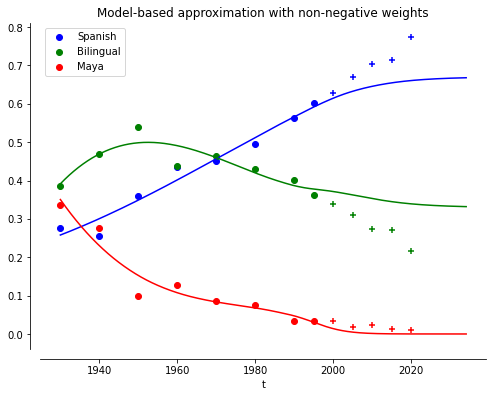

Epoch 1/500
32/32 - 1s - loss: 5.3088e-05 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4627e-06 - 74ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 4.0246e-07 - 78ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 3.3906e-07 - 74ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 3.1940e-07 - 78ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.0126e-07 - 81ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.8303e-07 - 77ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 2.6651e-07 - 72ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.5074e-07 - 82ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3574e-07 - 72ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.2306e-07 - 73ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.1126e-07 - 80ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.0107e-07 - 75ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 1.9270e-07 - 72ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.8583e-07 - 82ms/epoch - 3ms/step
Epoch

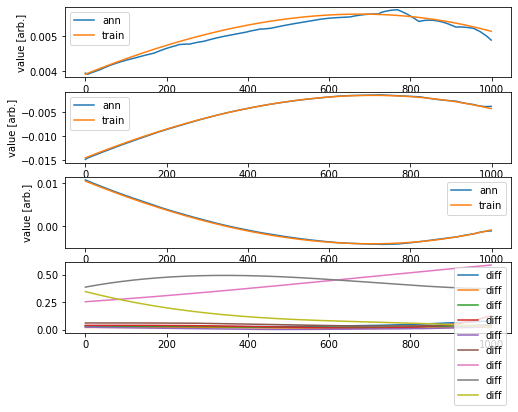

AG
AG
AG
AG
AG


0.0254128874344908


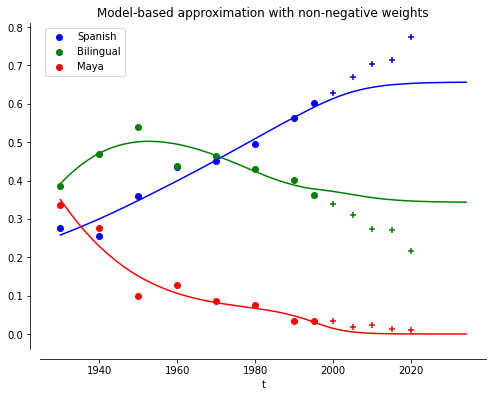

Epoch 1/500
32/32 - 1s - loss: 1.9204e-04 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 3.9265e-06 - 76ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4639e-06 - 77ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0545e-06 - 69ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 8.7797e-07 - 73ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.4706e-07 - 76ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 6.4891e-07 - 73ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.7978e-07 - 79ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 5.2498e-07 - 79ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.8746e-07 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.6000e-07 - 72ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 4.4193e-07 - 70ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 4.2210e-07 - 72ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.0946e-07 - 71ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 3.9805e-07 - 72ms/epoch - 2ms/step
Epoch

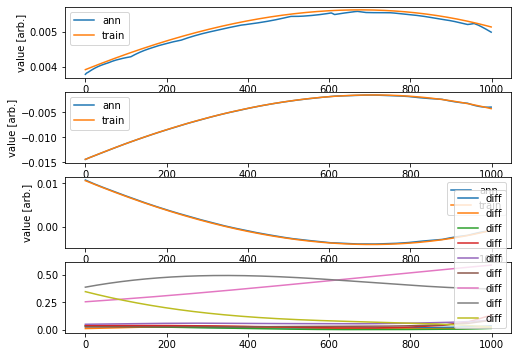

AG
AG
AG
AG
AG


0.021389630049100584


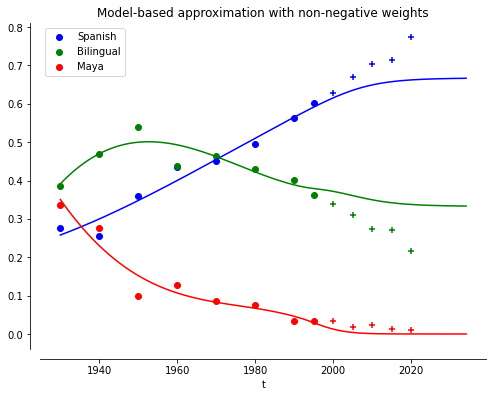

Epoch 1/500
32/32 - 1s - loss: 9.8173e-05 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 2.3917e-06 - 80ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 6.5024e-07 - 73ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 4.8761e-07 - 80ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.1540e-07 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.6326e-07 - 75ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 3.2744e-07 - 75ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.0209e-07 - 81ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.8302e-07 - 70ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 2.6980e-07 - 72ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.5910e-07 - 82ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.4932e-07 - 76ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.4027e-07 - 71ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.3239e-07 - 70ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2564e-07 - 74ms/epoch - 2ms/step
Epoch

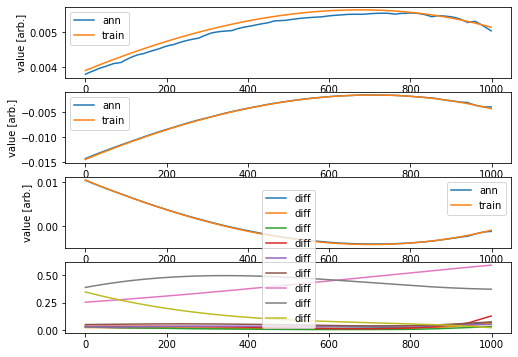

AG
AG
AG
AG
AG


0.029973772240015906


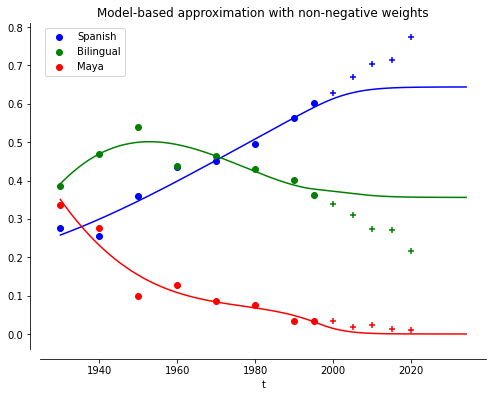

Epoch 1/500
32/32 - 1s - loss: 5.6962e-05 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 1.7724e-06 - 78ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 6.6986e-07 - 76ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 4.8126e-07 - 73ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.1784e-07 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.7373e-07 - 76ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 3.4563e-07 - 76ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.2193e-07 - 79ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.0186e-07 - 82ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.7925e-07 - 73ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6211e-07 - 84ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.5193e-07 - 70ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.4391e-07 - 80ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.3428e-07 - 74ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2739e-07 - 79ms/epoch - 2ms/step
Epoch

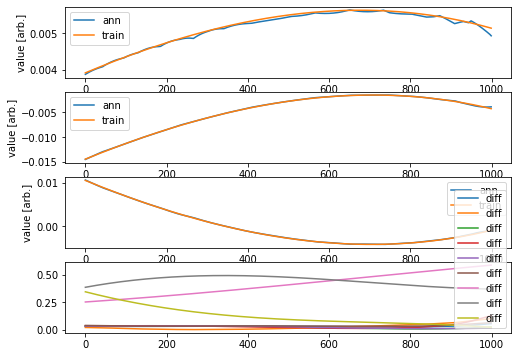

AG
AG
AG
AG
AG


0.03195854888907013


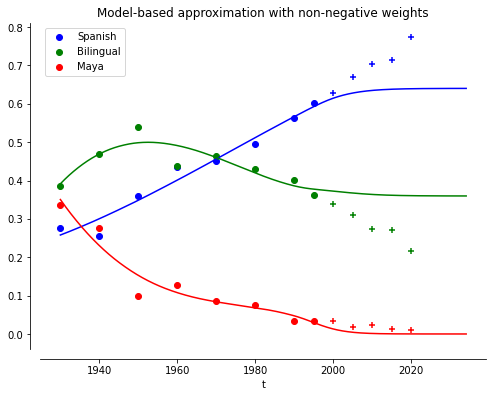

Epoch 1/500
32/32 - 1s - loss: 4.8477e-05 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2222e-06 - 85ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.3858e-07 - 68ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.7005e-07 - 76ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.8587e-07 - 77ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.3490e-07 - 80ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.0211e-07 - 74ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.7226e-07 - 74ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4008e-07 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.2004e-07 - 72ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9575e-07 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8056e-07 - 86ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.6822e-07 - 82ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.5736e-07 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.4882e-07 - 85ms/epoch - 3ms/step
Epoch

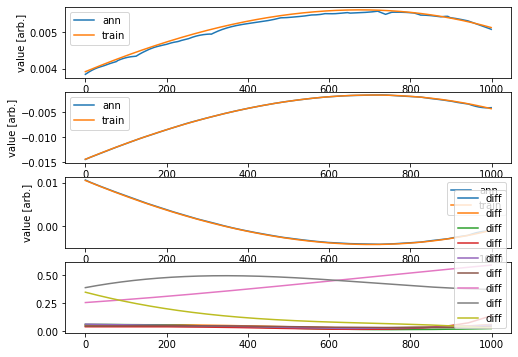

AG
AG
AG
AG
AG


0.025405214697555186


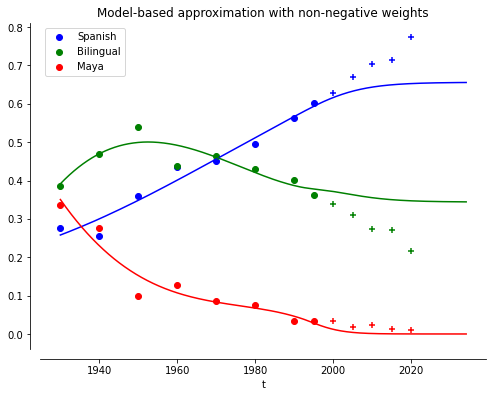

Epoch 1/500
32/32 - 1s - loss: 2.4197e-04 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 7.8025e-06 - 76ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.6451e-06 - 84ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6086e-06 - 81ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.1450e-06 - 84ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.8769e-07 - 81ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.3351e-07 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.5088e-07 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.9070e-07 - 74ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.5327e-07 - 78ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 5.2781e-07 - 75ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.0838e-07 - 80ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 4.9743e-07 - 83ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.8460e-07 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.8064e-07 - 93ms/epoch - 3ms/step
Epoch

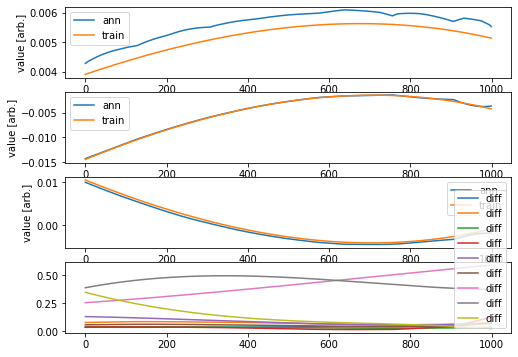

AG
AG
AG
AG
AG


0.026537571858003504


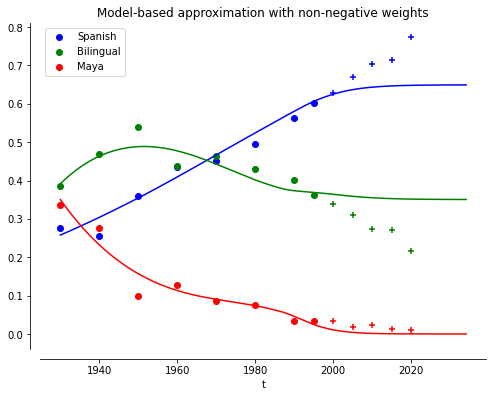

Epoch 1/500
32/32 - 2s - loss: 3.3548e-04 - 2s/epoch - 48ms/step
Epoch 2/500
32/32 - 0s - loss: 9.4061e-06 - 84ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.5350e-06 - 84ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 9.0475e-07 - 76ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 7.8358e-07 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.0327e-07 - 79ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 6.4078e-07 - 77ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.9022e-07 - 81ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.5377e-07 - 75ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.2163e-07 - 80ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.9466e-07 - 84ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.7302e-07 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.5382e-07 - 82ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.3799e-07 - 81ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.2545e-07 - 87ms/epoch - 3ms/step
Epoch

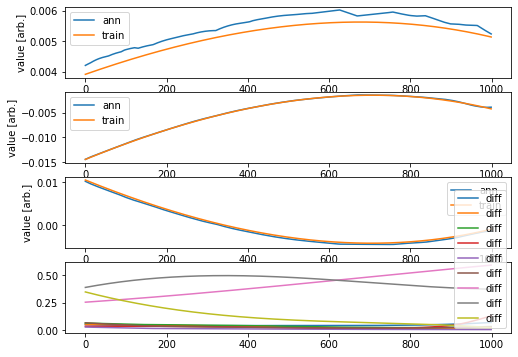

AG
AG
AG
AG
AG


0.02721412049288038


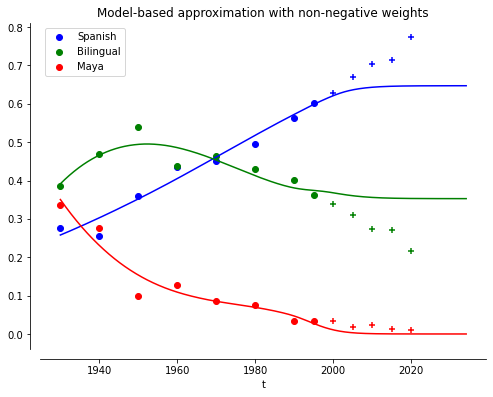

Epoch 1/500
32/32 - 1s - loss: 8.8384e-05 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 3.0988e-06 - 87ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.7502e-07 - 79ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 4.5448e-07 - 79ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 3.7265e-07 - 75ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.2608e-07 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.9921e-07 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.6602e-07 - 79ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.4346e-07 - 80ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.2348e-07 - 76ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.0971e-07 - 80ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.9667e-07 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.8613e-07 - 94ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.7737e-07 - 85ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.6707e-07 - 97ms/epoch - 3ms/step
Epoch

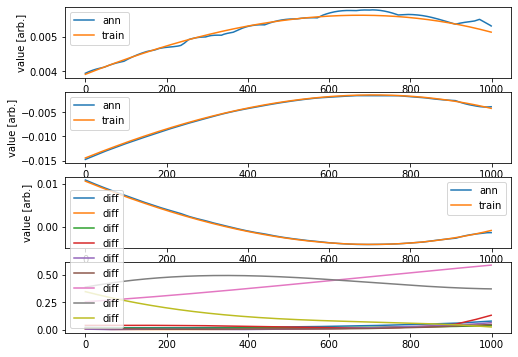

AG
AG
AG
AG
AG


0.026338656317394446


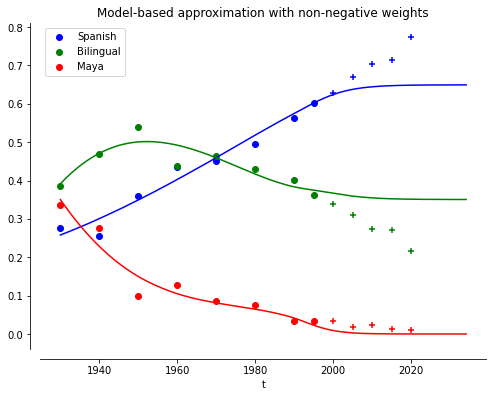

Epoch 1/500
32/32 - 1s - loss: 6.8487e-05 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2098e-06 - 90ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 5.2927e-07 - 107ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.6163e-07 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.2987e-07 - 87ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.0372e-07 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.8455e-07 - 83ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.6743e-07 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.5289e-07 - 91ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.4139e-07 - 81ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.2953e-07 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.1837e-07 - 80ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.0850e-07 - 93ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.0006e-07 - 87ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.9041e-07 - 84ms/epoch - 3ms/step
Epoc

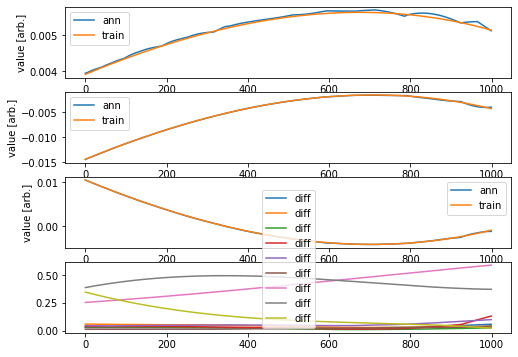

AG
AG
AG
AG
AG


0.02610992055097135


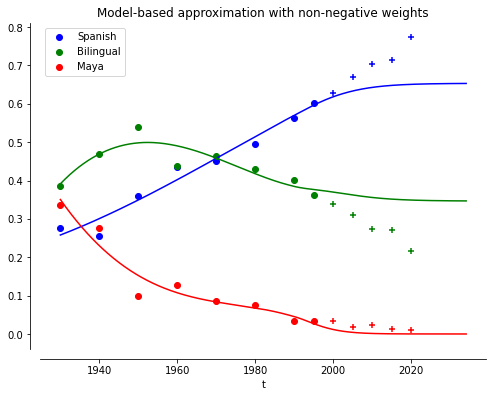

Epoch 1/500
32/32 - 1s - loss: 1.6965e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 3.4307e-06 - 86ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2919e-06 - 84ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 9.7666e-07 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.6731e-07 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.1889e-07 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.1464e-07 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.4147e-07 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.8778e-07 - 85ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.5087e-07 - 102ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.2501e-07 - 100ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.0761e-07 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.9354e-07 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.8161e-07 - 82ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.7081e-07 - 99ms/epoch - 3ms/step
Epo

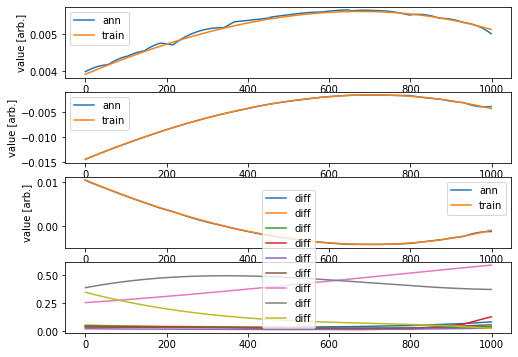

AG
AG
AG
AG
AG


0.023303379646957088


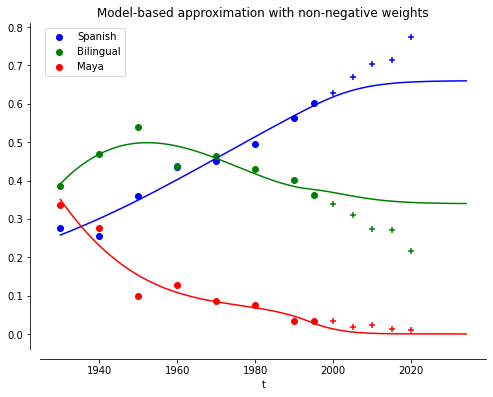

Epoch 1/500
32/32 - 1s - loss: 3.8178e-05 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2342e-06 - 84ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 5.5526e-07 - 88ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.5984e-07 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.3296e-07 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.1499e-07 - 83ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.0239e-07 - 80ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.8845e-07 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.7778e-07 - 79ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6706e-07 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.5787e-07 - 90ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4882e-07 - 92ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.4026e-07 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.3593e-07 - 84ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.2617e-07 - 81ms/epoch - 3ms/step
Epoch

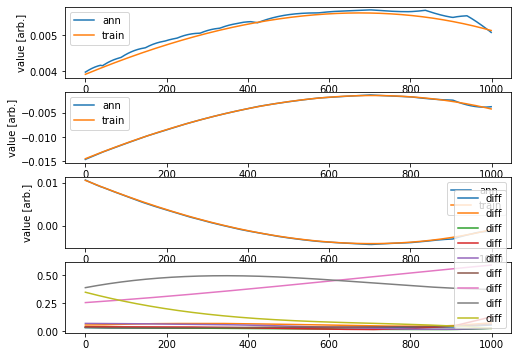

AG
AG
AG
AG
AG


0.026015520084125537


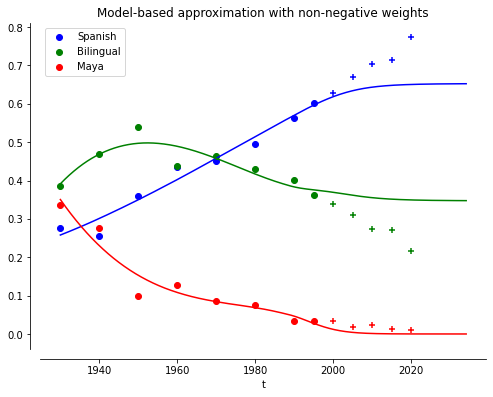

Epoch 1/500
32/32 - 1s - loss: 5.7143e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 1.1556e-05 - 100ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.0411e-06 - 101ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 9.8314e-07 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.5924e-07 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.7175e-07 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.0238e-07 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.4277e-07 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.9271e-07 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.5056e-07 - 94ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.1613e-07 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.8956e-07 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.6576e-07 - 90ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.4773e-07 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.3278e-07 - 99ms/epoch - 3ms/step
Epo

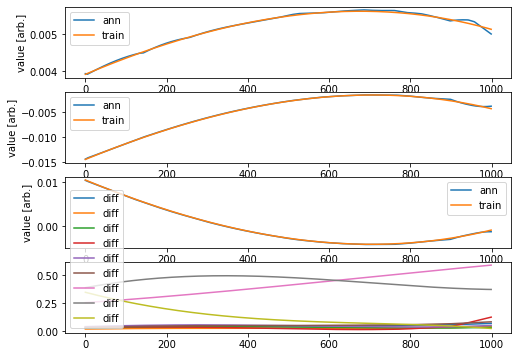

AG
AG
AG
AG
AG


0.030194126903577367


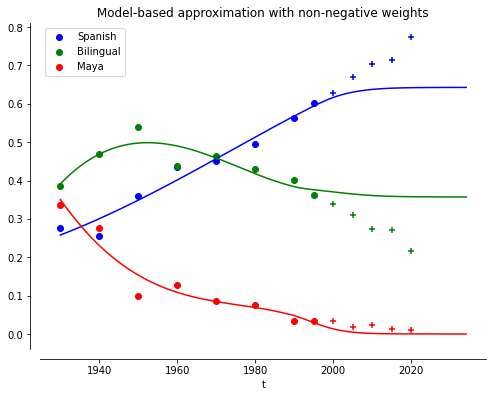

Epoch 1/500
32/32 - 1s - loss: 2.0485e-04 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 3.5388e-06 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0322e-06 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.3709e-07 - 83ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.2373e-07 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.5493e-07 - 85ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.0409e-07 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.5821e-07 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.2886e-07 - 92ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.0970e-07 - 84ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.9130e-07 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.7509e-07 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.6093e-07 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.4970e-07 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.4011e-07 - 87ms/epoch - 3ms/step
Epoch

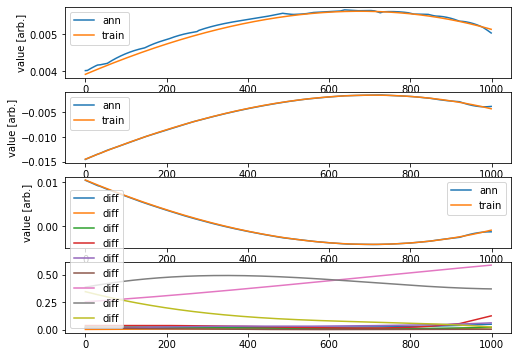

AG
AG
AG
AG
AG


0.03992032387215584


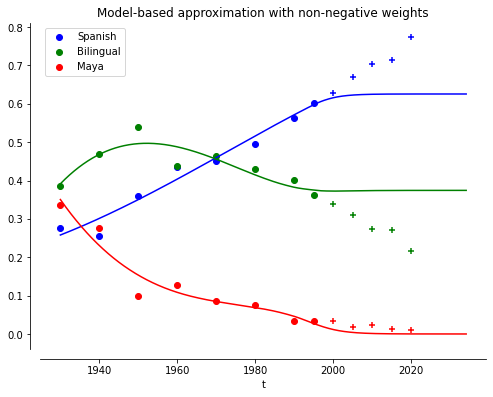

Epoch 1/500
32/32 - 1s - loss: 1.9342e-04 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 7.5410e-06 - 98ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.2227e-06 - 104ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.0246e-06 - 80ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4942e-06 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2129e-06 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0024e-06 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.3312e-07 - 94ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.1942e-07 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.4486e-07 - 99ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.8765e-07 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.4248e-07 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.0380e-07 - 96ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.7559e-07 - 102ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.4984e-07 - 86ms/epoch - 3ms/step
Epo

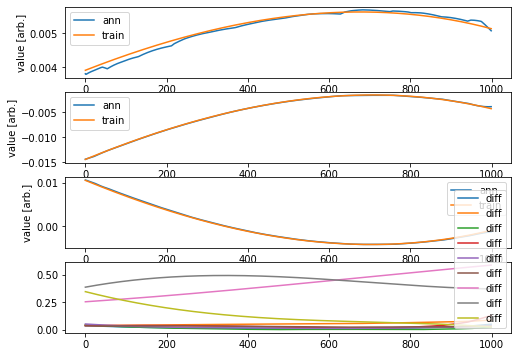

AG
AG
AG
AG
AG


0.023497746899979008


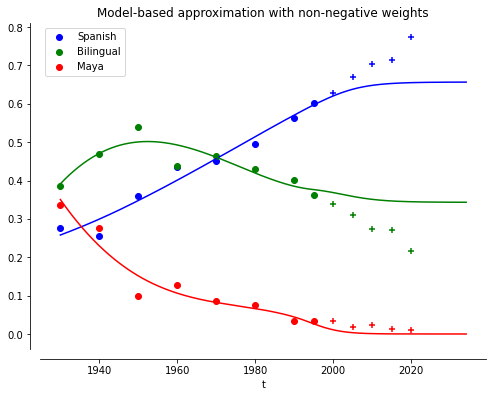

Epoch 1/500
32/32 - 1s - loss: 2.6190e-04 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 5.6685e-06 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.5946e-06 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0646e-06 - 102ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.5691e-07 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.8816e-07 - 88ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.9300e-07 - 94ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.4103e-07 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.0630e-07 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.7883e-07 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.5742e-07 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.3831e-07 - 81ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.2236e-07 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.0816e-07 - 77ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.9658e-07 - 104ms/epoch - 3ms/step
Ep

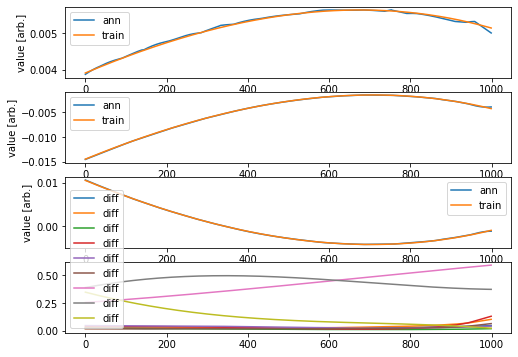

AG
AG
AG
AG
AG


0.024902479372632128


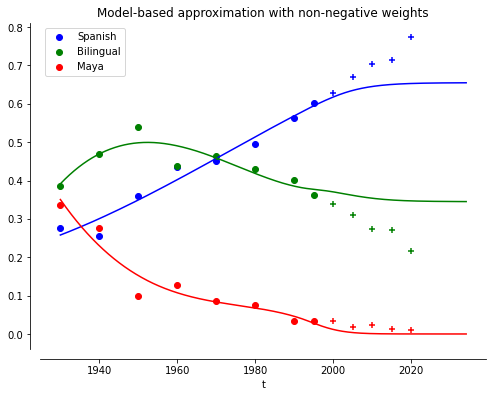

Epoch 1/500
32/32 - 1s - loss: 8.9289e-05 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 2.2223e-06 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 5.8315e-07 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.6470e-07 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.3262e-07 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.1390e-07 - 105ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.9775e-07 - 80ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.8462e-07 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.7423e-07 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6409e-07 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.5419e-07 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4624e-07 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.3710e-07 - 92ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.2969e-07 - 101ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.2240e-07 - 106ms/epoch - 3ms/step
Ep

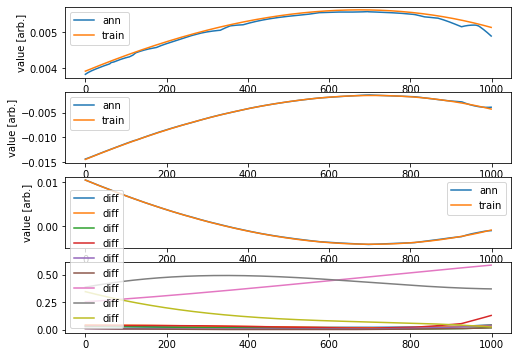

AG
AG
AG
AG
AG


0.028167408983392733


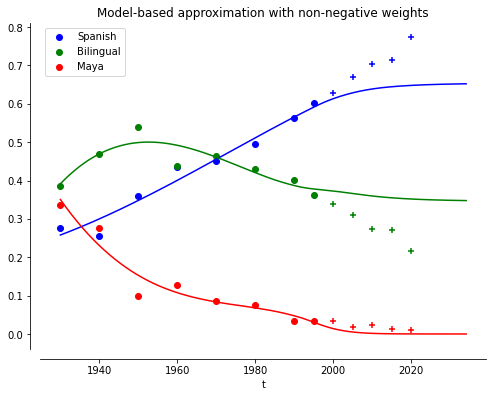

Epoch 1/500
32/32 - 1s - loss: 1.2160e-04 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 3.7760e-06 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7424e-06 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2149e-06 - 83ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.9315e-07 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.8882e-07 - 75ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 5.7402e-07 - 84ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.1489e-07 - 92ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.7791e-07 - 108ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.5926e-07 - 88ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.4731e-07 - 85ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.3487e-07 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.2616e-07 - 92ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.1925e-07 - 90ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.1044e-07 - 88ms/epoch - 3ms/step
Epoc

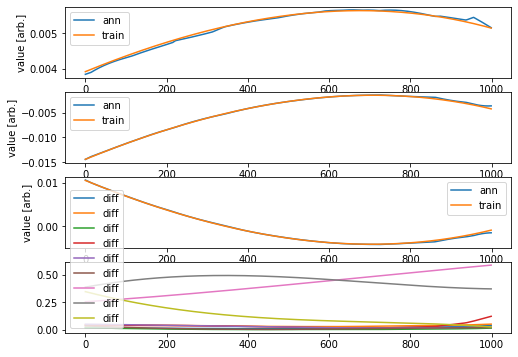

AG
AG
AG
AG
AG


0.030889080599550194


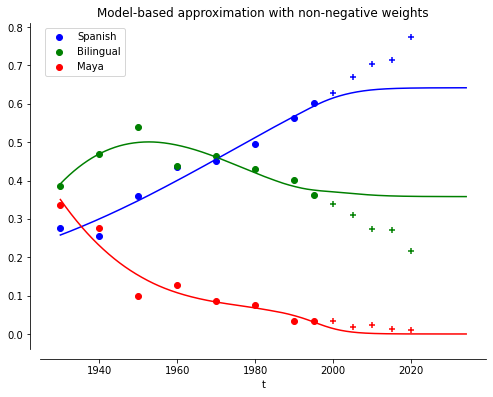

Epoch 1/500
32/32 - 1s - loss: 1.0411e-04 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 3.2584e-06 - 94ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2342e-06 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 8.4276e-07 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.2712e-07 - 97ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.1502e-07 - 86ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.4019e-07 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.8224e-07 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4078e-07 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1342e-07 - 81ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8780e-07 - 83ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.7035e-07 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.5478e-07 - 80ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.3960e-07 - 84ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2867e-07 - 86ms/epoch - 3ms/step
Epoch

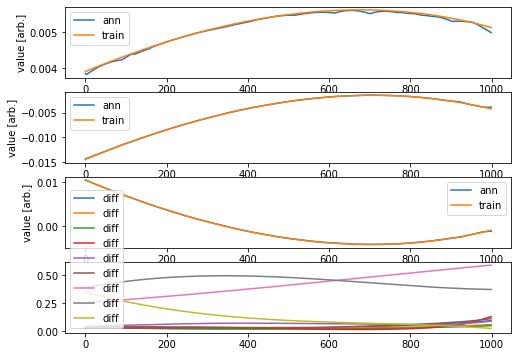

AG
AG
AG
AG
AG


0.028595746087266827


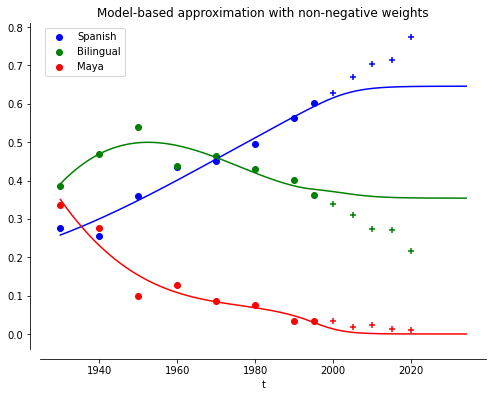

Epoch 1/500
32/32 - 1s - loss: 2.4133e-04 - 1s/epoch - 34ms/step
Epoch 2/500
32/32 - 0s - loss: 4.8427e-06 - 85ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 8.1414e-07 - 97ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.7034e-07 - 84ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.7440e-07 - 87ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.1270e-07 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.6845e-07 - 110ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.3857e-07 - 102ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.1433e-07 - 107ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.9842e-07 - 101ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8351e-07 - 109ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.7188e-07 - 113ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.6257e-07 - 101ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.5365e-07 - 100ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.4499e-07 - 83ms/epoch - 3ms/st

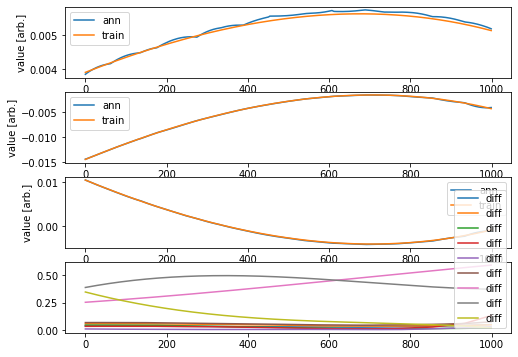

AG
AG
AG
AG
AG


0.017752803228114157


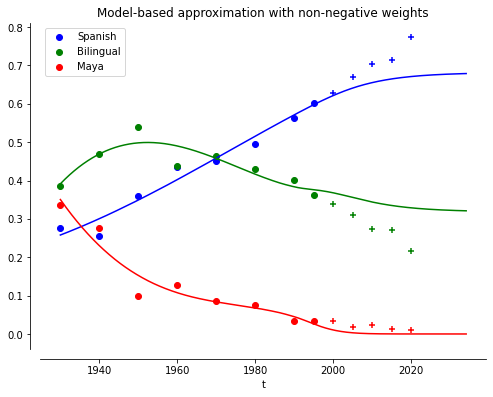

In [ ]:
Validation loss: 0.002484763715680521
Test loss: 0.0243487615414611

i12,i13,i21,i23,i31,i32 = [0, 1, 0, 1, 0, 0] #[1, 0, 1, 1, 0, 0]
#[1,0,1,1,0,1] #binaryRarray(6,1)
#[1, 1, 1, 0, 1, 0] 

#i13 = 0
#i31 = 0

E = [0.020382785074741235]

for _ in range(29):
  total = train3(X,Y,B,dX,dY,dB,mode = '2')
  E.append(total)

In [ ]:
print(E)

In [ ]:
E = [0.020382785074741235]

In [ ]:
def fitness(X,Y,B,dX,dY,dB):
  #i12,i13,i21,i23,i31,i32  = A
  total = train3(X,Y,B,dX,dY,dB)
  return total

In [ ]:
A = [0,1,0,1,0,1]
print(A[0:int(len(A)/2)])
print(A[int(len(A)/2):len(A)])

[0, 1, 0]
[1, 0, 1]


In [ ]:
def selectionP(pop,scores):
  selection_idx = 0 #random.randint(0,len(pop)-1)
  for ix in range(len(pop)):
    if scores[ix] < scores[selection_idx]:
      selection_idx = ix
  return pop[selection_idx]

def crossover(pa1,pa2):
  x11 = pa1[0:int(len(pa1)/2)]
  x12 = pa1[int(len(pa1)/2):len(pa1)]
  x21 = pa2[0:int(len(pa1)/2)]
  x22 = pa2[int(len(pa1)/2):len(pa1)]
  fl1 = x11 + x22
  fl2 = x12 + x21
  if random.random() < 0.5:
    return fl1
  else:
    return fl2

def mutation(fl,mr=0.2):
  fl2 = []
  for i in range(len(fl)):
    if random.random() < mr:
      outp = int(not int(fl[i]))
      fl2.append(outp)
    else:
      outp = int(fl[i])
      fl2.append(outp)
  return fl2   

def selection(pop,scores,n_pairs=1):
  Fl = []
  pop2 = 1*pop
  for _ in range(n_pairs):
    p1 = selectionP(pop2,scores)
    pop2.remove(p1)
    p2 = selectionP(pop2,scores)
    pop2.remove(p2)
    fl = crossover(p1,p2)
    fl = mutation(fl)
    Fl.append(fl)
  return Fl

In [ ]:
pop = [[0,1,0,1,0,1],[1,1,1,1,1,1],[1,0,1,1,0,1],[0,0,0,0,0,0]]
scores = [0.1,0.01,0.001,180]
n_pop = 2
selected = [selection(pop,scores) for _ in range(n_pop)]
print(selected)

[[1, 0, 1, 1, 0, 1], [1, 0, 1, 1, 0, 1]]


In [ ]:
ll = len(T0)

T0t = T0[6:ll]
Espat = Espa[6:ll]
Bilint = Bilin[6:ll]
Mayat = Maya[6:ll]

T0 = T0[0:6]
Espa = Espa[0:6]
Bilin = Bilin[0:6]
Maya = Maya[0:6]

print(T0)
print(T0t)

[1930, 1940, 1950, 1960, 1970, 1980]
[1990, 1995]


Epoch 1/500
32/32 - 4s - loss: 1.4662e-04 - 4s/epoch - 128ms/step
Epoch 2/500
32/32 - 0s - loss: 5.6177e-06 - 235ms/epoch - 7ms/step
Epoch 3/500
32/32 - 0s - loss: 2.0193e-06 - 212ms/epoch - 7ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2308e-06 - 216ms/epoch - 7ms/step
Epoch 5/500
32/32 - 0s - loss: 8.2124e-07 - 199ms/epoch - 6ms/step
Epoch 6/500
32/32 - 0s - loss: 6.1870e-07 - 186ms/epoch - 6ms/step
Epoch 7/500
32/32 - 0s - loss: 4.6013e-07 - 206ms/epoch - 6ms/step
Epoch 8/500
32/32 - 0s - loss: 3.7095e-07 - 140ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 3.3373e-07 - 145ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1343e-07 - 160ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9870e-07 - 148ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8581e-07 - 132ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.7572e-07 - 151ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 2.6506e-07 - 140ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5601e-07 - 175ms/epoch -

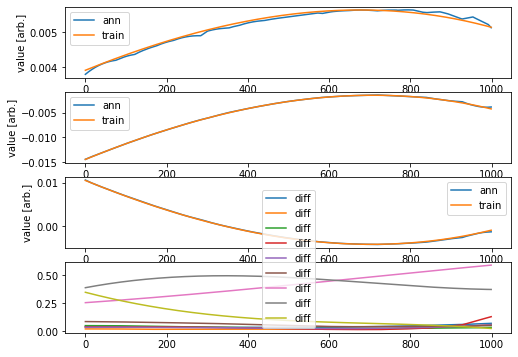

AG
AG


0.002395749354236503


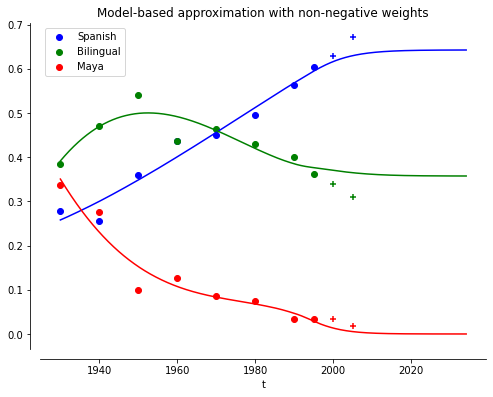

Epoch 1/500
32/32 - 1s - loss: 1.1189e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 3.1448e-06 - 101ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2049e-06 - 94ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 8.0466e-07 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.0503e-07 - 104ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.7171e-07 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.8578e-07 - 110ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.3747e-07 - 99ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.0483e-07 - 109ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.8268e-07 - 99ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6511e-07 - 100ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.5063e-07 - 97ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.4011e-07 - 112ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.3105e-07 - 108ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2321e-07 - 98ms/epoch - 3ms/ste

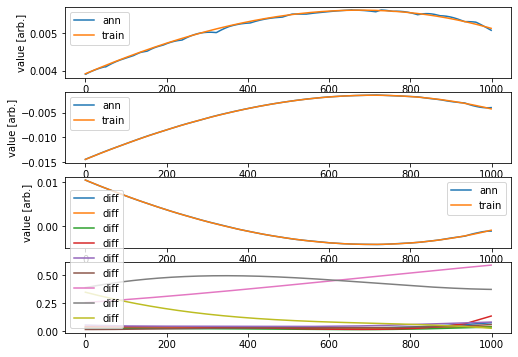

AG
AG


0.002073564214095858


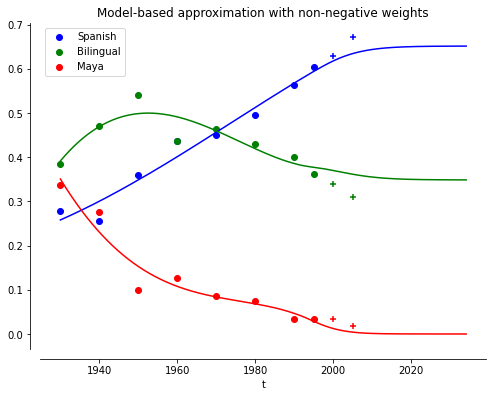

Epoch 1/500
32/32 - 1s - loss: 1.9131e-04 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 5.2968e-06 - 97ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7665e-06 - 103ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0050e-06 - 95ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.3233e-07 - 106ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.7718e-07 - 116ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 4.6973e-07 - 102ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.9237e-07 - 105ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4299e-07 - 111ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1581e-07 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0036e-07 - 101ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.9048e-07 - 107ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.8321e-07 - 115ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.7708e-07 - 117ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.7161e-07 - 116ms/epoch - 4ms

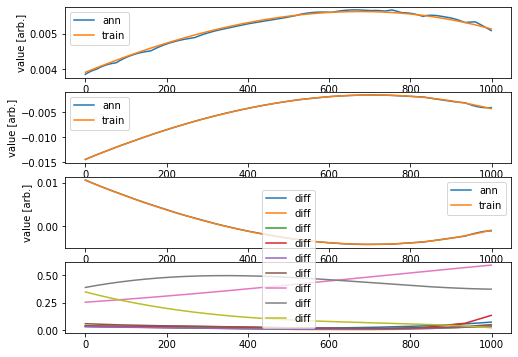

AG
AG


0.002174702037486419


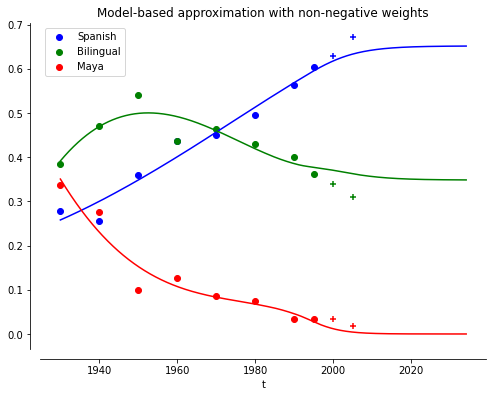

Epoch 1/500
32/32 - 2s - loss: 4.9136e-05 - 2s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4195e-06 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 5.2122e-07 - 100ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 3.3562e-07 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.9311e-07 - 111ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.6933e-07 - 107ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.5666e-07 - 98ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.4883e-07 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.4133e-07 - 105ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3298e-07 - 103ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.2681e-07 - 95ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.1921e-07 - 101ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.1264e-07 - 106ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.0489e-07 - 123ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.9942e-07 - 101ms/epoch - 3ms/

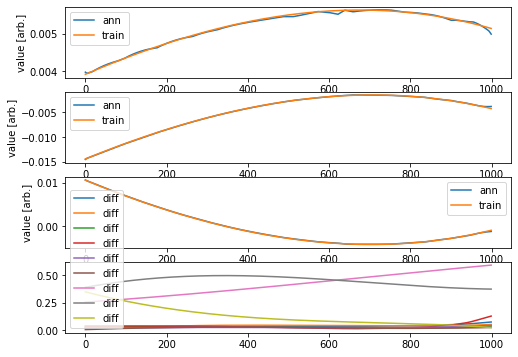

AG
AG


0.0024616978240699734


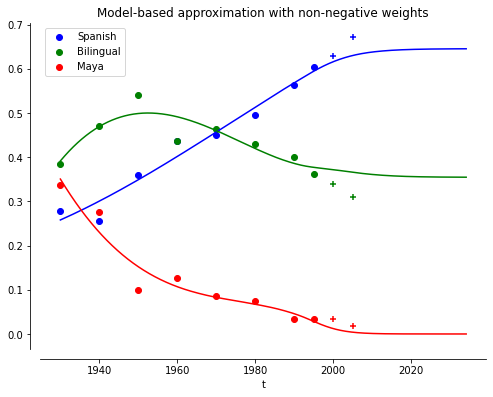

Epoch 1/500
32/32 - 2s - loss: 2.3182e-04 - 2s/epoch - 62ms/step
Epoch 2/500
32/32 - 0s - loss: 3.3996e-06 - 99ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 8.8984e-07 - 97ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.6916e-07 - 107ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.7032e-07 - 110ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.0046e-07 - 111ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.5543e-07 - 121ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.3224e-07 - 111ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.1365e-07 - 110ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.9281e-07 - 115ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.7429e-07 - 119ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.5827e-07 - 111ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.4273e-07 - 112ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.3002e-07 - 114ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.1862e-07 - 106ms/epoch - 3m

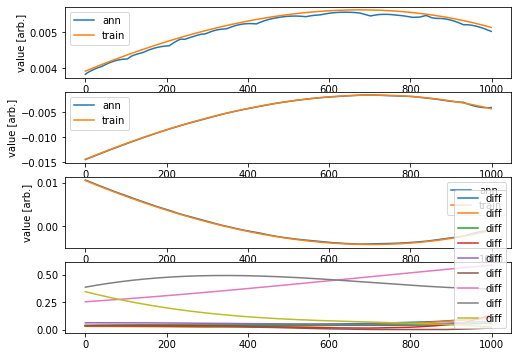

AG
AG


0.0022002719549750168


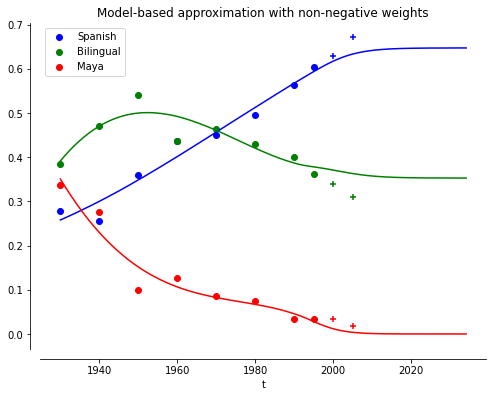

Epoch 1/500
32/32 - 1s - loss: 0.0018 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 4.3837e-05 - 95ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 5.1514e-06 - 102ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 3.2370e-06 - 101ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.3587e-06 - 106ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8857e-06 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5943e-06 - 108ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4111e-06 - 96ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.2913e-06 - 111ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.1996e-06 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1260e-06 - 99ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0652e-06 - 99ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0123e-06 - 103ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 9.6284e-07 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 9.1833e-07 - 105ms/epoch - 3ms/step
Ep

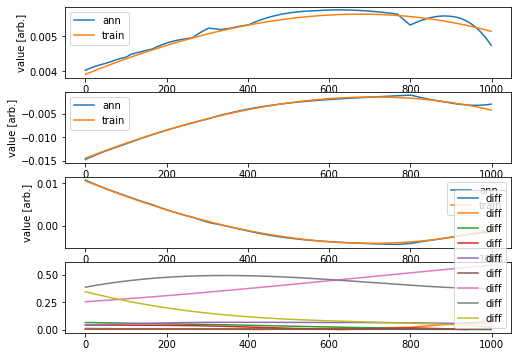

AG
AG


0.001606746241628382


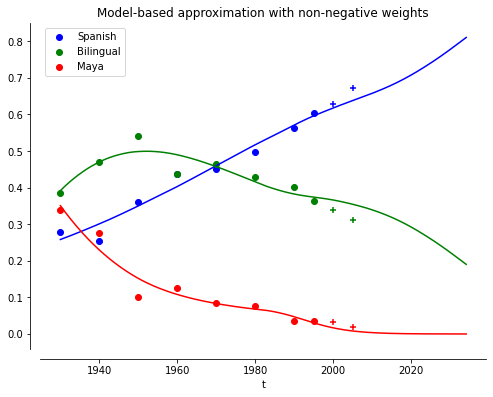

Epoch 1/500
32/32 - 1s - loss: 0.0016 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 3.1270e-05 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 6.7171e-06 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.6605e-06 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.7012e-06 - 114ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.9604e-06 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.4359e-06 - 101ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.0694e-06 - 109ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.8089e-06 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.6372e-06 - 94ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.5122e-06 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.4042e-06 - 96ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.3117e-06 - 90ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.2315e-06 - 105ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.1639e-06 - 97ms/epoch - 3ms/step
Epoc

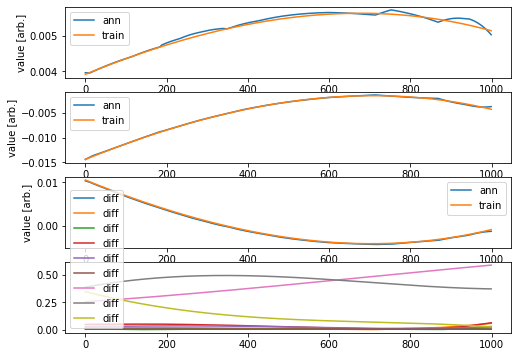

AG
AG


0.0014601229998715585


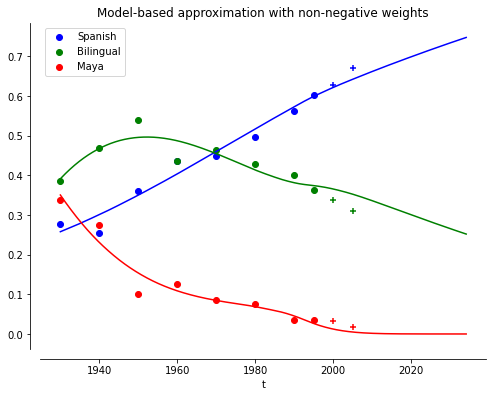

Epoch 1/500
32/32 - 1s - loss: 9.3627e-04 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 4.0919e-05 - 77ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0476e-05 - 85ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.1698e-06 - 83ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.6214e-06 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 2.8358e-06 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.2703e-06 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.8286e-06 - 81ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.5402e-06 - 77ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3506e-06 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1811e-06 - 75ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0370e-06 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.3031e-07 - 86ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.3856e-07 - 95ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.6123e-07 - 89ms/epoch - 3ms/step
Epoch

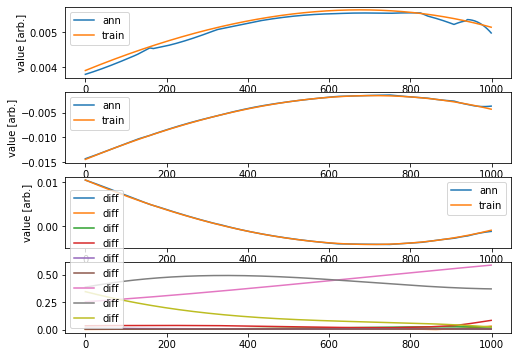

AG
AG


0.002290550466557253


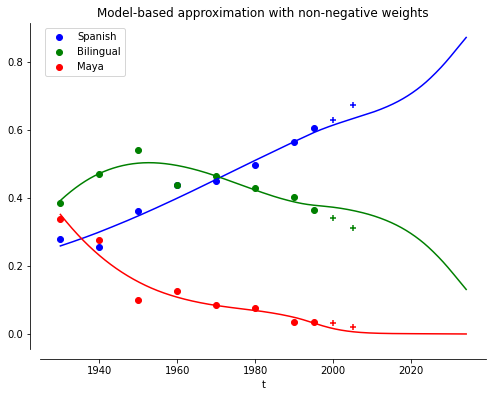

Epoch 1/500
32/32 - 1s - loss: 0.0026 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 4.0016e-05 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.3407e-05 - 108ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.3215e-06 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.6704e-06 - 100ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.6848e-06 - 111ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1913e-06 - 102ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 9.3737e-07 - 110ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.8192e-07 - 102ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.7548e-07 - 100ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.9872e-07 - 104ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.4048e-07 - 132ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 4.9747e-07 - 122ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 4.6183e-07 - 108ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.3202e-07 - 112ms/epoch - 3ms/st

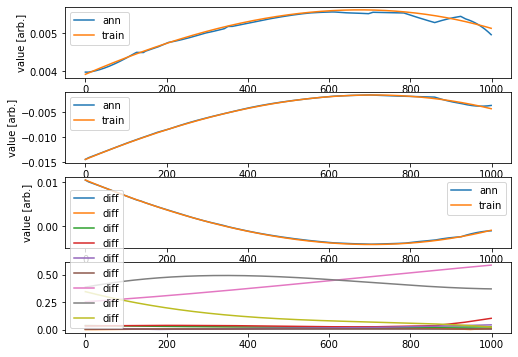

AG
AG


0.0012875353909477289


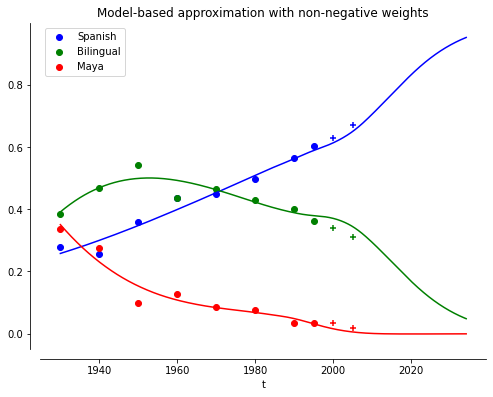

Epoch 1/500
32/32 - 1s - loss: 0.0014 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 3.0116e-05 - 101ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.6173e-06 - 107ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 3.0867e-06 - 100ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.4382e-06 - 103ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.9807e-06 - 118ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.6474e-06 - 103ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.3801e-06 - 110ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.1592e-06 - 110ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.7566e-07 - 104ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.2356e-07 - 110ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.0361e-07 - 105ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.1029e-07 - 102ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.4098e-07 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.8649e-07 - 113ms/epoch - 4ms/s

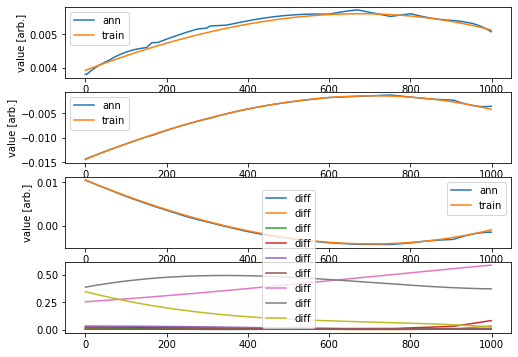

AG
AG


0.0013172820901218559


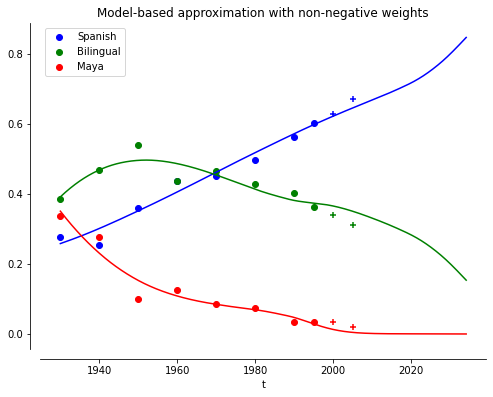

In [ ]:
iters = 5

# Initial population
Pob = [binaryRarray(6,0.5),binaryRarray(6,0.5)]
totales = []
medias = []

for p in Pob:
  i12,i13,i21,i23,i31,i32 = p
  totali = []
  for _ in range(iters):
    total = train3(X,Y,B,dX,dY,dB,mode='2')
    while math.isnan(total):
      total = train3(X,Y,B,dX,dY,dB,mode='2')
    totali.append(total)
  totales.append(totali)
  medias.append(sum(totali)/len(totali))

In [ ]:
print(Pob)
print(medias)
print(totales)

[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1]]
[0.002261197076972754, 0.0015924474378253555]
[[0.002395749354236503, 0.002073564214095858, 0.002174702037486419, 0.0024616978240699734, 0.0022002719549750168], [0.001606746241628382, 0.0014601229998715585, 0.002290550466557253, 0.0012875353909477289, 0.0013172820901218559]]


In [ ]:
Pob = [[1, 0, 1, 0, 1, 0], [0, 1, 0, 0, 1, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 1], [0, 1, 0, 0, 0, 0]]
medias = [0.002000165621292309, 0.0018853953182761073, 0.0022206389976438465, 0.002202214792683737, 0.002253898280356165]
totales = [[0.002462764366649153, 0.0014607309217298545, 0.0019357864838403173, 0.002251305486804802, 0.0018902408474374198], [0.0022774182111345138, 0.0010463178939832745, 0.0014036476789977864, 0.002091436489057634, 0.0026081563182073285], [0.0026384213775648966, 0.0008151960122919175, 0.0026263159464838693, 0.0027856746262010586, 0.0022375870256774897], [0.00274106095954429, 0.002285913920925153, 0.0017601263245566265, 0.001385235500448174, 0.00283873725794444], [0.0016964785896196027, 0.002640714053819701, 0.0016778430383598683, 0.0025232937865733206, 0.0027311619334083343]]


____________________________
Iteración =  0
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1]]
[0.002261197076972754, 0.0015924474378253555]
Epoch 1/500
32/32 - 1s - loss: 0.0014 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 2.4546e-05 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.9050e-06 - 76ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 8.4546e-07 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.9448e-07 - 84ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.1859e-07 - 85ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.5828e-07 - 79ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.1336e-07 - 98ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.7902e-07 - 97ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.5039e-07 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.2587e-07 - 94ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.0068e-07 - 80ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.9079e-07 - 98ms/

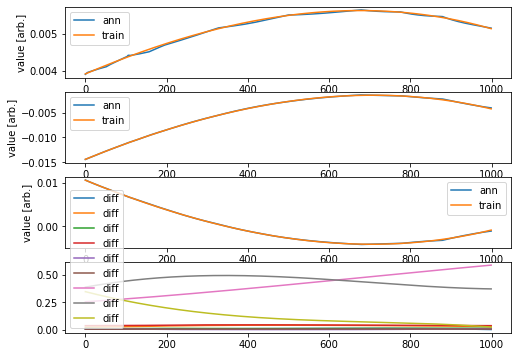

AG
AG


0.0869928261511875


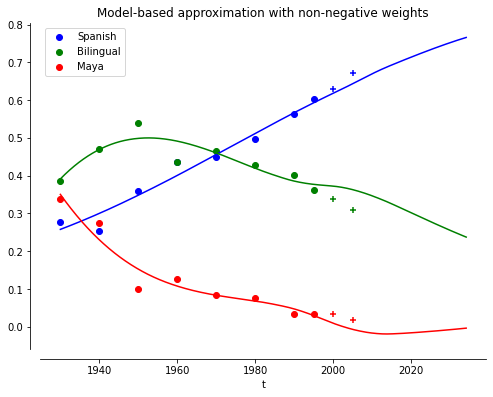

Epoch 1/500
32/32 - 1s - loss: 8.7007e-04 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 2.3460e-05 - 65ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.9842e-06 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3528e-06 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 9.9002e-07 - 74ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.8039e-07 - 71ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 6.4373e-07 - 85ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.2114e-07 - 75ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.2952e-07 - 114ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.4951e-07 - 76ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9732e-07 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.7327e-07 - 79ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.5521e-07 - 73ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.4603e-07 - 82ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2708e-07 - 87ms/epoch - 3ms/step
Epoc

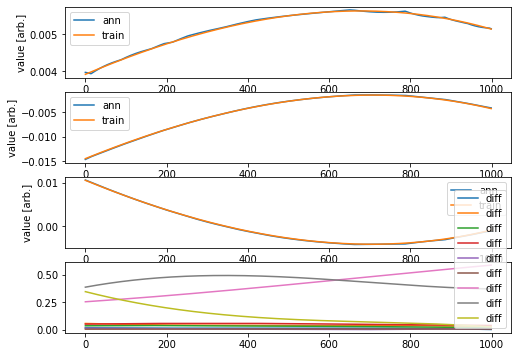

AG
AG


0.017811079727277763


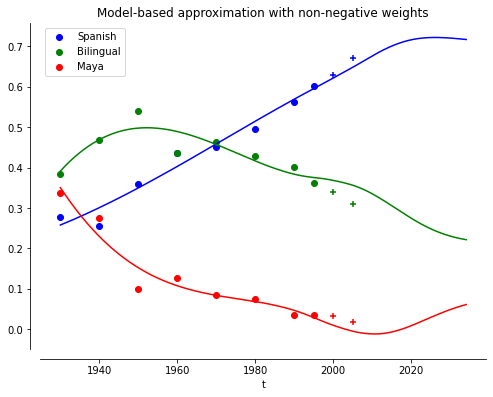

Epoch 1/500
32/32 - 1s - loss: 0.0035 - 1s/epoch - 43ms/step
Epoch 2/500
32/32 - 0s - loss: 6.4573e-05 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2181e-05 - 85ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.6569e-06 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.5751e-06 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.3969e-06 - 94ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.6953e-06 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.2465e-06 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.5469e-07 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.7226e-07 - 92ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.6010e-07 - 116ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 5.9131e-07 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.4891e-07 - 96ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.2479e-07 - 94ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.0866e-07 - 97ms/epoch - 3ms/step
Epoch 1

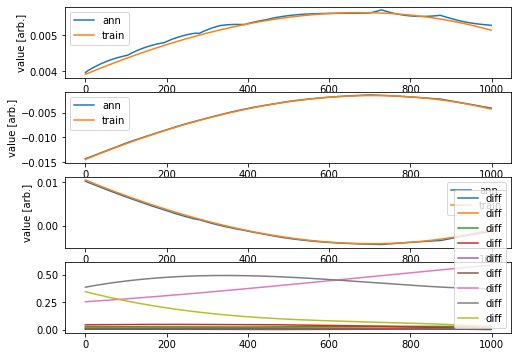

AG
AG


0.05144721000870003


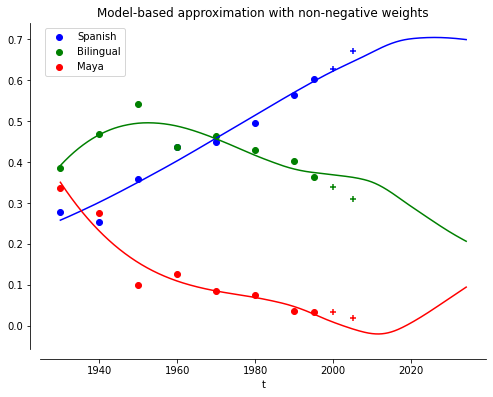

Epoch 1/500
32/32 - 1s - loss: 4.6985e-04 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0595e-05 - 74ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.9598e-06 - 78ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2105e-06 - 71ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0317e-06 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 9.1661e-07 - 83ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.3381e-07 - 72ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 7.5770e-07 - 79ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 6.9503e-07 - 76ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 6.4084e-07 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.9490e-07 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.5437e-07 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.2205e-07 - 77ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.8876e-07 - 80ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.4649e-07 - 72ms/epoch - 2ms/step
Epoch

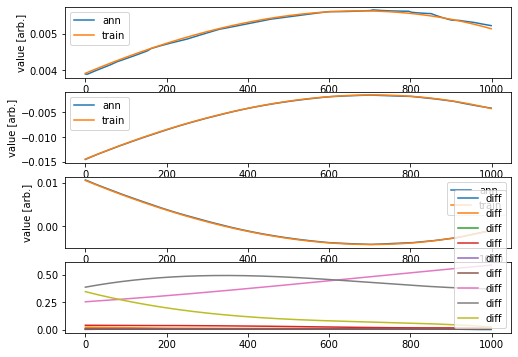

AG
AG


1.8656685600836347


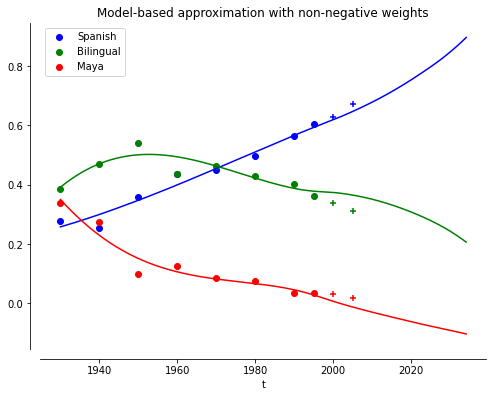

Epoch 1/500
32/32 - 1s - loss: 7.0756e-04 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 1.8212e-05 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.3803e-06 - 91ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.8370e-06 - 109ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.3822e-06 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.1936e-06 - 99ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0892e-06 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0094e-06 - 99ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.3861e-07 - 113ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 8.7805e-07 - 110ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.2560e-07 - 109ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.7217e-07 - 109ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.2724e-07 - 95ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.7986e-07 - 95ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.4053e-07 - 91ms/epoch - 3ms/step


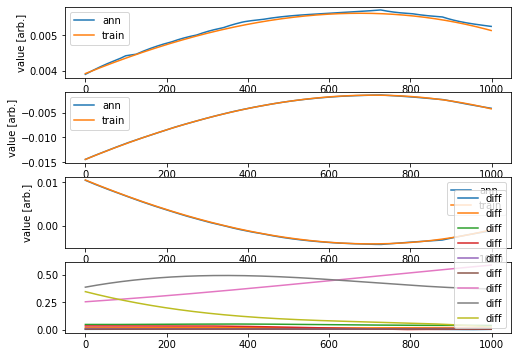

AG
AG


2.5134130770351835


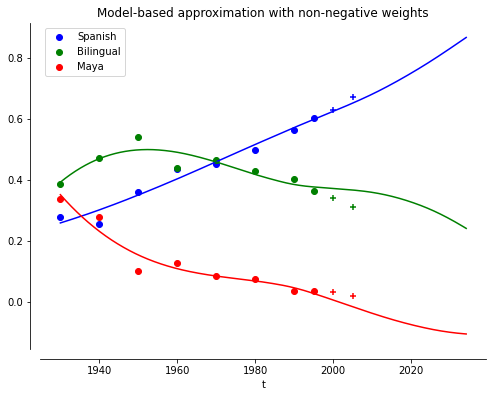

____________________________
Iteración =  1
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 0, 1, 1, 1]]
[0.002261197076972754, 0.0015924474378253555, 0.9070665506011967]
Epoch 1/500
32/32 - 1s - loss: 2.1946e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 3.9267e-06 - 73ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 8.4416e-07 - 95ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.1978e-07 - 74ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 5.1746e-07 - 85ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.5822e-07 - 83ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.2066e-07 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.9542e-07 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.7806e-07 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6666e-07 - 82ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.5815e-07 - 75ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 3.5274e-07 - 71ms/epoch - 2ms/step
Epoch 

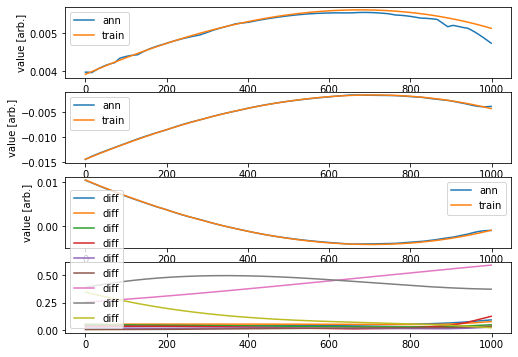

AG
AG


0.002402192505263112


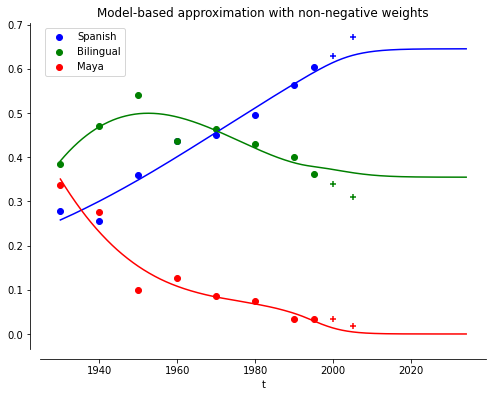

Epoch 1/500
32/32 - 2s - loss: 1.0912e-04 - 2s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 3.1640e-06 - 101ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 6.0103e-07 - 108ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.6590e-07 - 126ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 4.0747e-07 - 109ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.6561e-07 - 106ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.3177e-07 - 100ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.0636e-07 - 120ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.8787e-07 - 112ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.7715e-07 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6619e-07 - 102ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.5891e-07 - 97ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.5351e-07 - 134ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.4796e-07 - 105ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.4395e-07 - 111ms/epoch - 3m

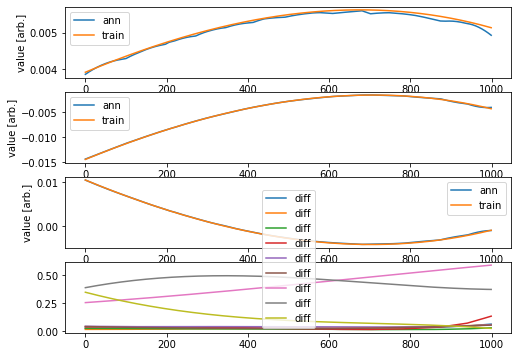

AG
AG


0.0026502539430857766


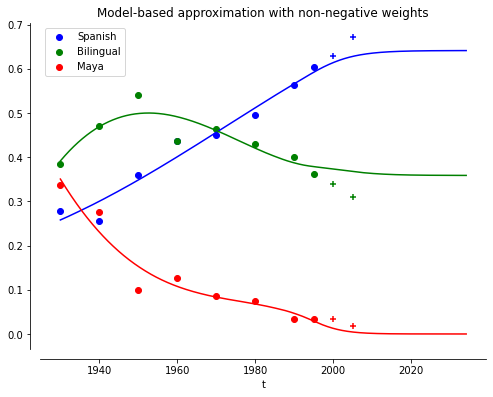

Epoch 1/500
32/32 - 1s - loss: 7.1355e-04 - 1s/epoch - 43ms/step
Epoch 2/500
32/32 - 0s - loss: 6.6678e-05 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4970e-05 - 88ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.3763e-06 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.3774e-06 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2370e-06 - 98ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.0352e-07 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.2653e-07 - 97ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.4418e-07 - 113ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 5.0476e-07 - 81ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.7517e-07 - 100ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.4900e-07 - 84ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.2817e-07 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.0774e-07 - 83ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.8977e-07 - 97ms/epoch - 3ms/step
Epo

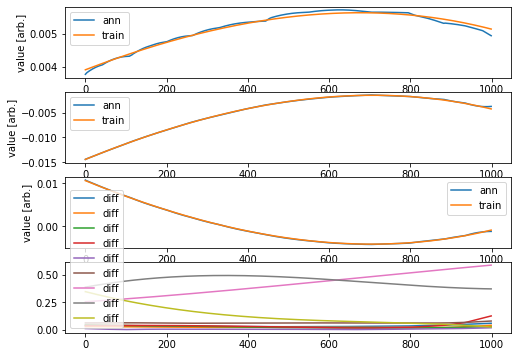

AG
AG


0.002502521368210912


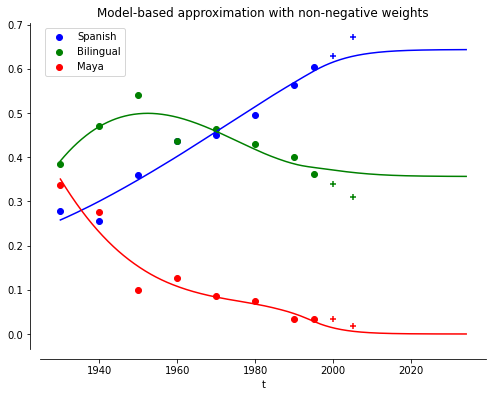

Epoch 1/500
32/32 - 1s - loss: 7.0164e-05 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 2.7513e-06 - 108ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 9.9323e-07 - 116ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 6.3008e-07 - 122ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 4.6240e-07 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.6668e-07 - 120ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 3.1739e-07 - 108ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.8385e-07 - 111ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.5971e-07 - 113ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3456e-07 - 103ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1346e-07 - 128ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.9672e-07 - 115ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.8214e-07 - 106ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.6772e-07 - 117ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.5632e-07 - 109ms/epoch - 

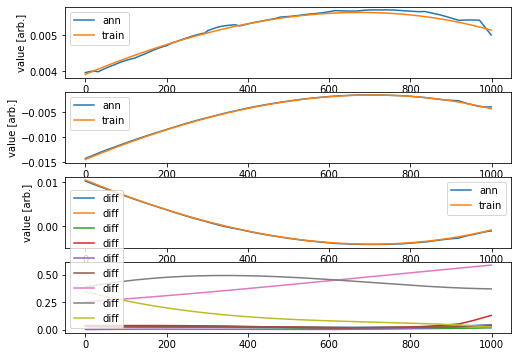

AG
AG


0.002657669939983435


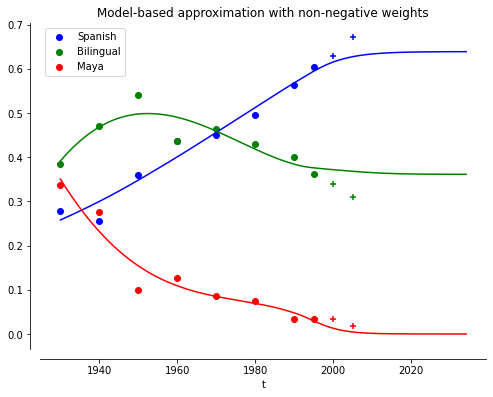

Epoch 1/500
32/32 - 1s - loss: 2.1260e-05 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 7.1323e-07 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.6574e-07 - 115ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 3.1958e-07 - 106ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.8882e-07 - 108ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.6269e-07 - 117ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 2.3884e-07 - 103ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.2137e-07 - 108ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.0549e-07 - 112ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.9233e-07 - 111ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.8334e-07 - 106ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.7511e-07 - 109ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.6679e-07 - 120ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.5988e-07 - 114ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.5265e-07 - 107ms/epoch - 3

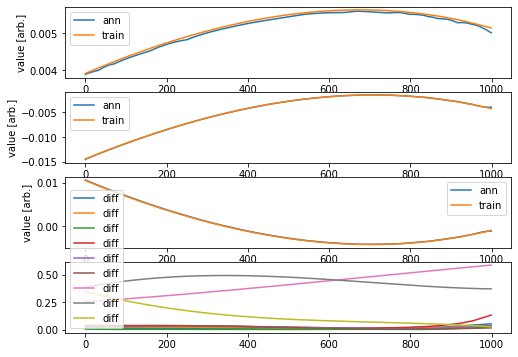

AG
AG


0.0022099516031954497


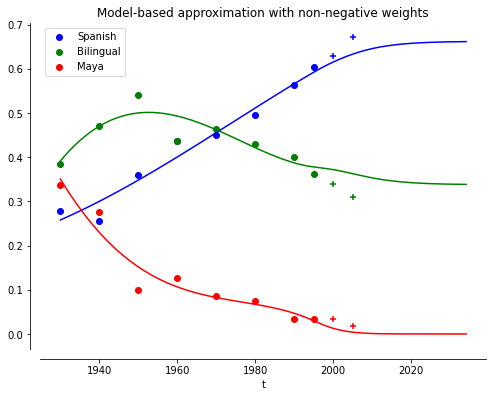

____________________________
Iteración =  2
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 0, 1, 1, 1], [1, 0, 1, 1, 0, 0]]
[0.002261197076972754, 0.0015924474378253555, 0.9070665506011967, 0.0024845178719477374]
Epoch 1/500
32/32 - 1s - loss: 0.0017 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 6.1481e-05 - 107ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 8.9350e-06 - 109ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.5436e-06 - 144ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7005e-06 - 112ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3568e-06 - 112ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1462e-06 - 113ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 9.8902e-07 - 117ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.6628e-07 - 108ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.1787e-07 - 116ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 5.7925e-07 - 106ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s 

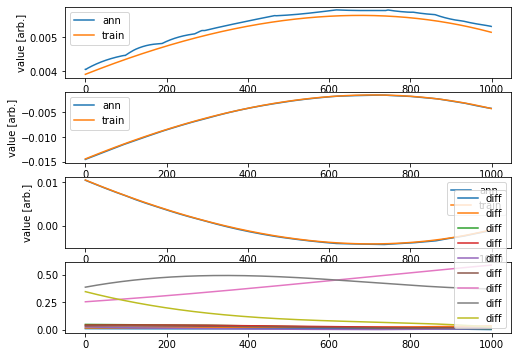

AG
AG


0.04222952019542339


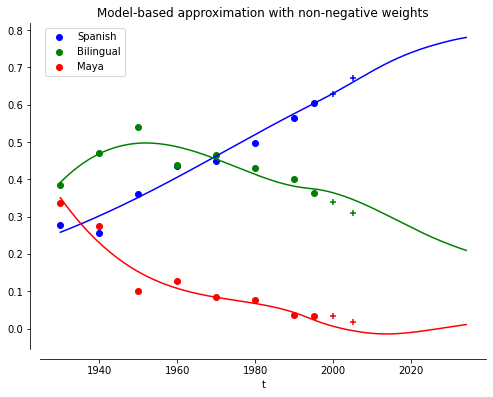

Epoch 1/500
32/32 - 1s - loss: 6.3902e-04 - 1s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 1.5802e-05 - 101ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.1794e-06 - 107ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2274e-06 - 105ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.4768e-07 - 110ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9233e-07 - 123ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 7.4426e-07 - 103ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.8616e-07 - 115ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 6.3900e-07 - 107ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.0359e-07 - 124ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 5.6906e-07 - 111ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.3831e-07 - 98ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.0526e-07 - 118ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 4.7616e-07 - 124ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.5853e-07 - 110ms/epoch - 3

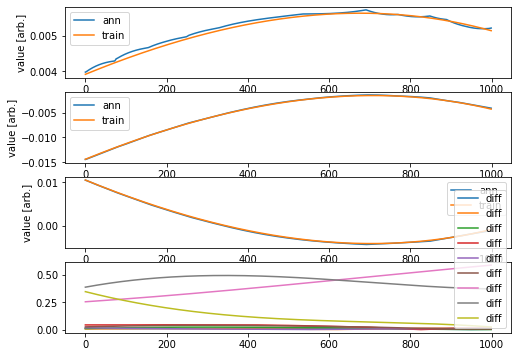

AG
AG


1.4311286118301378


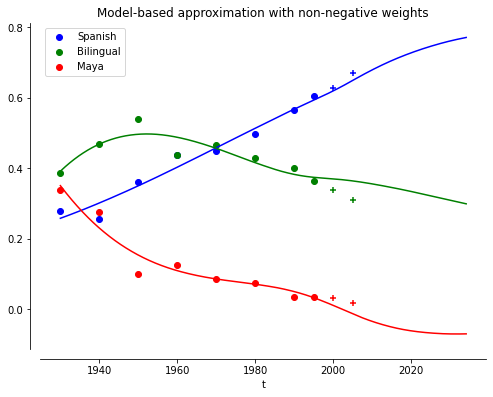

Epoch 1/500
32/32 - 1s - loss: 2.9350e-04 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 4.2635e-06 - 113ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4187e-06 - 127ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0727e-06 - 112ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.2958e-07 - 120ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9464e-07 - 115ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 6.8326e-07 - 105ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.9550e-07 - 112ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.2885e-07 - 110ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.8775e-07 - 119ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 4.5745e-07 - 121ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 4.3457e-07 - 118ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 4.2713e-07 - 124ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 4.1096e-07 - 116ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.0020e-07 - 109ms/epoch - 

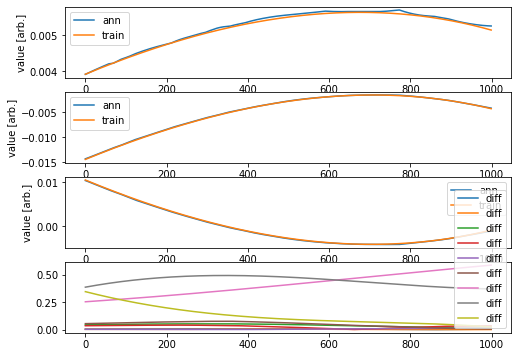

AG
AG


1.1282963109503878


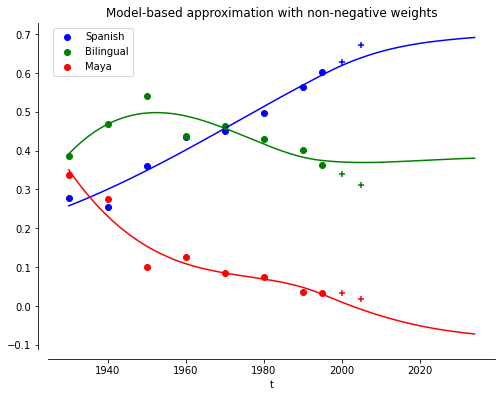

Epoch 1/500
32/32 - 1s - loss: 0.0031 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6922e-04 - 105ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7416e-05 - 117ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 6.9870e-06 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.0394e-06 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.1892e-06 - 98ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.4687e-06 - 106ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.7685e-06 - 116ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.1085e-06 - 106ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.6324e-06 - 104ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.4051e-06 - 116ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.2750e-06 - 122ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.1626e-06 - 121ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0687e-06 - 114ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 9.7694e-07 - 109ms/epoch - 3ms/ste

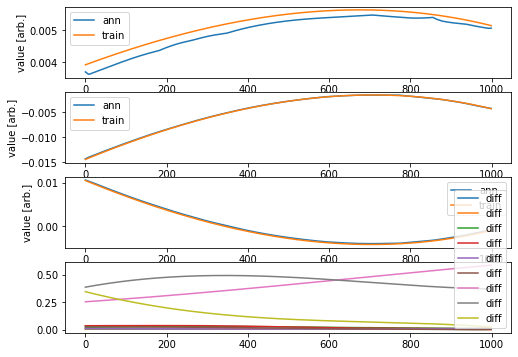

AG
AG


0.20701325668849765


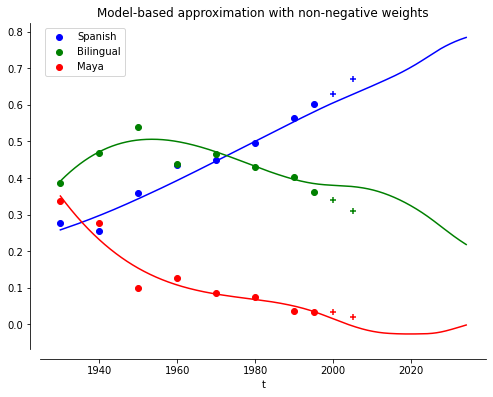

Epoch 1/500
32/32 - 1s - loss: 8.3307e-04 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 3.6449e-05 - 107ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.7102e-06 - 103ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.2353e-06 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.2211e-06 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2768e-06 - 114ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 8.7737e-07 - 125ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 6.8922e-07 - 112ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 5.6624e-07 - 98ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.7716e-07 - 104ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.0954e-07 - 107ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.6514e-07 - 130ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.1961e-07 - 109ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.7864e-07 - 113ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5434e-07 - 118ms/epoch - 4m

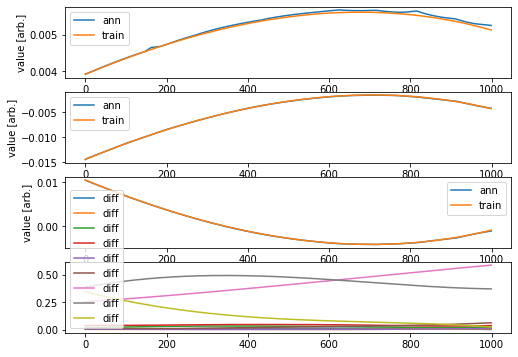

AG
AG


0.0542812249434267


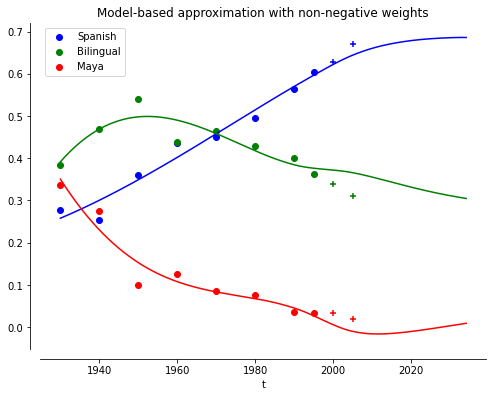

____________________________
Iteración =  3
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 0, 1, 1, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 1, 0]]
[0.002261197076972754, 0.0015924474378253555, 0.9070665506011967, 0.0024845178719477374, 0.5725897849215746]
Epoch 1/500
32/32 - 1s - loss: 5.9037e-04 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 6.0594e-06 - 120ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.8815e-06 - 135ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0262e-06 - 124ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 6.4225e-07 - 119ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 4.4409e-07 - 121ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 3.4698e-07 - 114ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 2.9209e-07 - 116ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.5763e-07 - 118ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3134e-07 - 114ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1112e-07 - 129

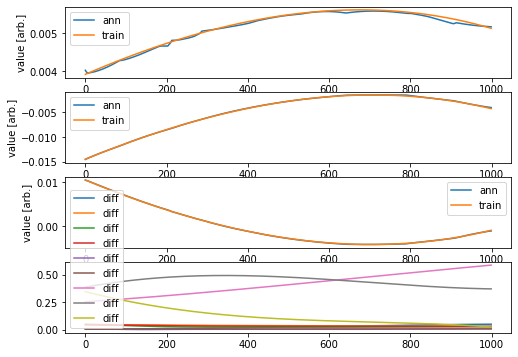

AG
AG


0.5795499199863061


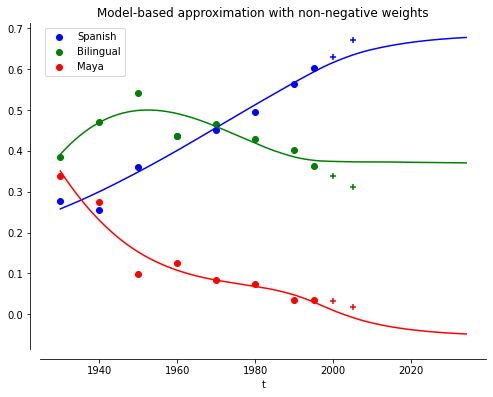

Epoch 1/500
32/32 - 1s - loss: 0.0012 - 1s/epoch - 43ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0613e-05 - 108ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.0990e-06 - 117ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.2039e-06 - 118ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.3675e-06 - 113ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 9.1653e-07 - 108ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.6345e-07 - 116ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.1560e-07 - 117ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.1457e-07 - 109ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.2853e-07 - 125ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6964e-07 - 131ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.3169e-07 - 112ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.0299e-07 - 107ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8074e-07 - 110ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.6451e-07 - 130ms/epoch - 4ms/

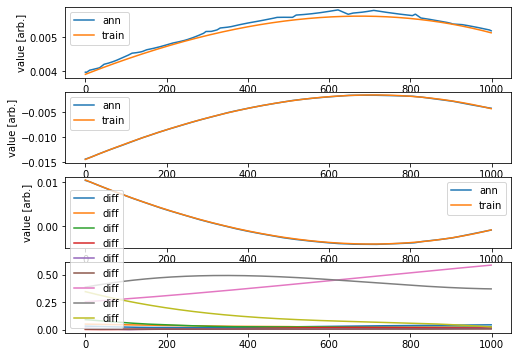

AG
AG


2.006474073725318


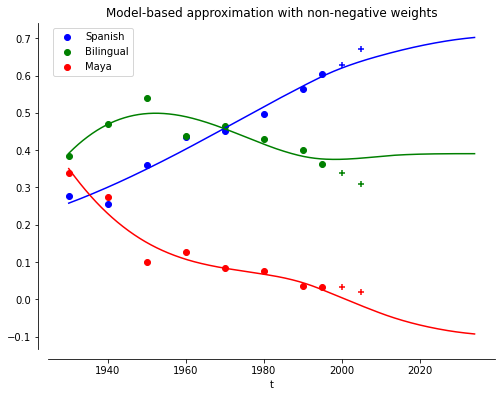

Epoch 1/500
32/32 - 1s - loss: 0.0014 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 9.8554e-06 - 125ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4358e-06 - 113ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 9.0241e-07 - 117ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 6.1313e-07 - 114ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 4.6679e-07 - 108ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.7497e-07 - 130ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 3.1611e-07 - 104ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.6849e-07 - 115ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3704e-07 - 120ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1385e-07 - 114ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.8149e-07 - 118ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.6045e-07 - 112ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.4130e-07 - 110ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2238e-07 - 139ms/epoch - 4ms/

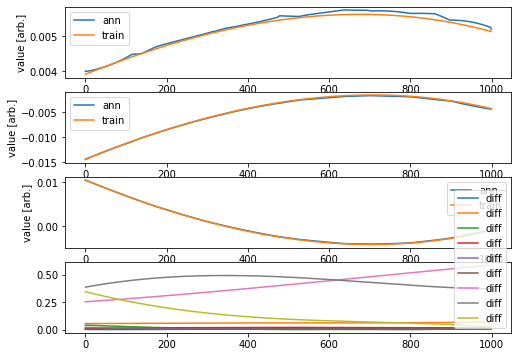

AG
AG


0.003131726536713376


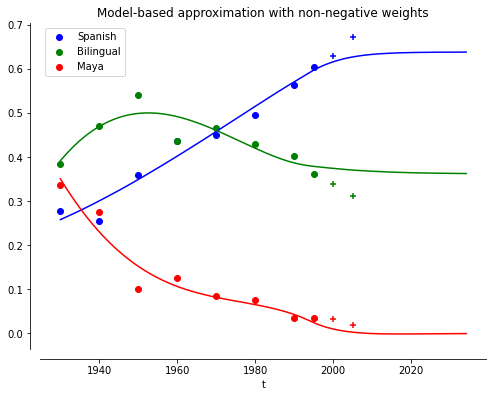

Epoch 1/500
32/32 - 1s - loss: 0.0011 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 2.2622e-05 - 121ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.6046e-06 - 114ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.7530e-06 - 125ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.1137e-06 - 115ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.0121e-07 - 112ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 6.3386e-07 - 118ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.1831e-07 - 111ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3221e-07 - 118ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6144e-07 - 111ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0280e-07 - 116ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.5776e-07 - 113ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.2215e-07 - 129ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.9093e-07 - 124ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.6357e-07 - 119ms/epoch - 4ms/

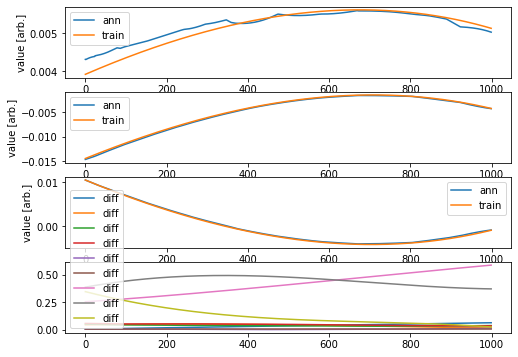

AG
AG


0.03571889076455758


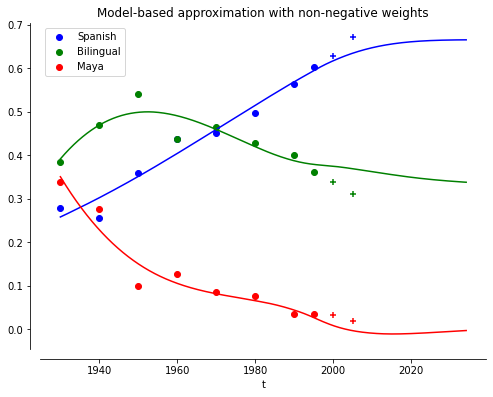

Epoch 1/500
32/32 - 1s - loss: 3.3233e-04 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 7.2127e-06 - 124ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2461e-06 - 111ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.0858e-07 - 113ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 5.9030e-07 - 135ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 5.1681e-07 - 106ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.6996e-07 - 118ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.4103e-07 - 117ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.1547e-07 - 114ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.9206e-07 - 108ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.7073e-07 - 108ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4513e-07 - 111ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.2342e-07 - 116ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 3.0282e-07 - 132ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.8832e-07 - 118ms/epoch - 

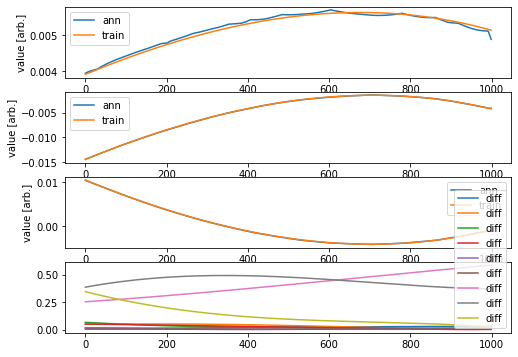

AG
AG


1.2432483713998157


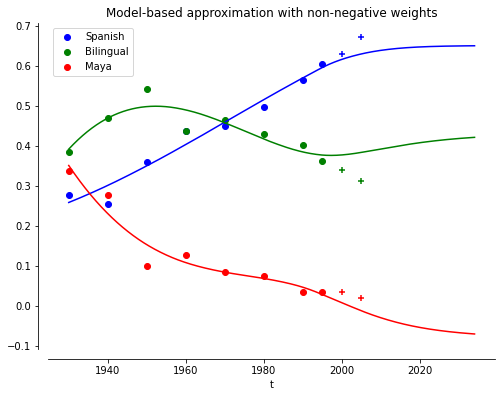

____________________________
Iteración =  4
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 1, 0], [1, 1, 1, 0, 1, 1]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.5725897849215746, 0.7736245964825421]
Epoch 1/500
32/32 - 2s - loss: 8.6885e-05 - 2s/epoch - 48ms/step
Epoch 2/500
32/32 - 0s - loss: 8.3456e-06 - 114ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 5.4062e-06 - 124ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 3.9136e-06 - 128ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 2.8273e-06 - 138ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.2121e-06 - 127ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.7881e-06 - 119ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4858e-06 - 133ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.2484e-06 - 124ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0572e-06 - 123ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 8.9891e-07 - 137

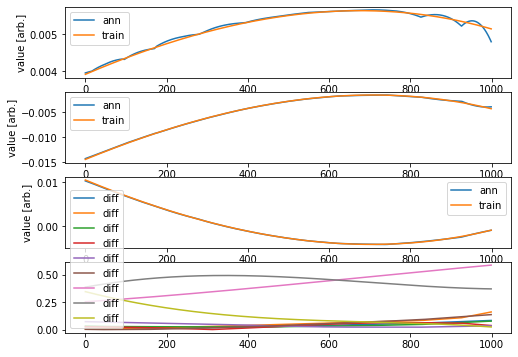

AG
AG


0.0030476430786512366


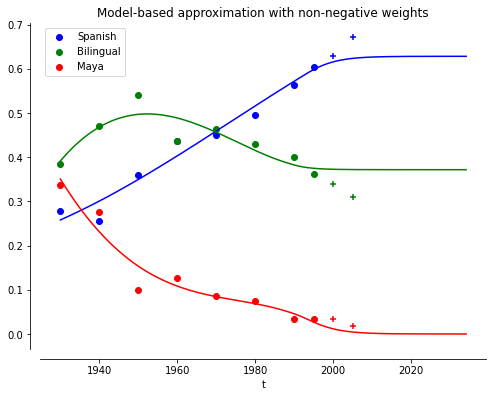

Epoch 1/500
32/32 - 1s - loss: 1.3899e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2105e-05 - 126ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 6.8743e-06 - 124ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 5.2862e-06 - 127ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 3.9900e-06 - 120ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.9661e-06 - 127ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 2.2203e-06 - 123ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.6889e-06 - 142ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.3026e-06 - 125ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0555e-06 - 128ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 8.8405e-07 - 131ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 7.5348e-07 - 117ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 6.4669e-07 - 138ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 5.5610e-07 - 131ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.8141e-07 - 131ms/epoch - 

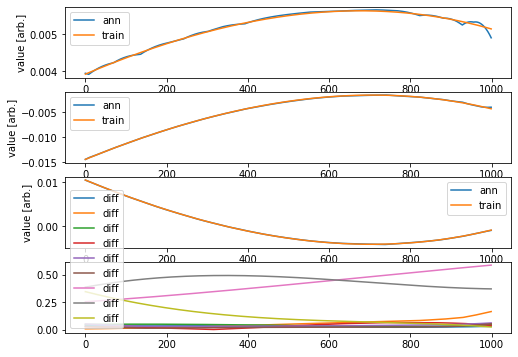

AG
AG


0.0033967874300435954


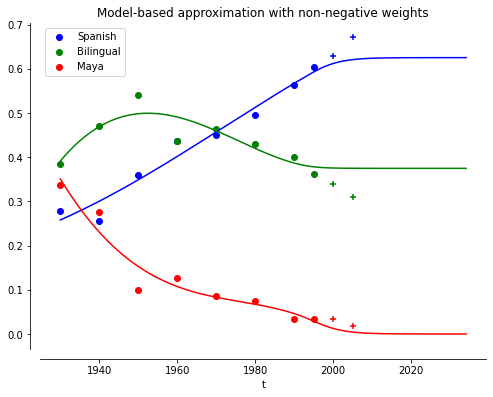

Epoch 1/500
32/32 - 1s - loss: 0.0010 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 9.6095e-06 - 106ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.0832e-06 - 121ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 5.6868e-06 - 132ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 4.1117e-06 - 126ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.5783e-06 - 138ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.6180e-06 - 128ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0916e-06 - 124ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 9.3762e-07 - 124ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 8.4799e-07 - 128ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 7.8387e-07 - 127ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 7.0972e-07 - 124ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 6.5187e-07 - 146ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 5.9781e-07 - 128ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 5.5139e-07 - 120ms/epoch - 4ms/

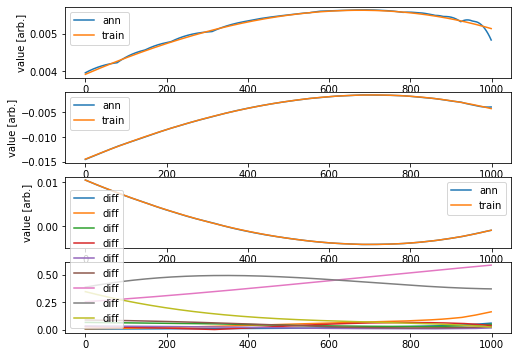

AG
AG


0.0032187855446698926


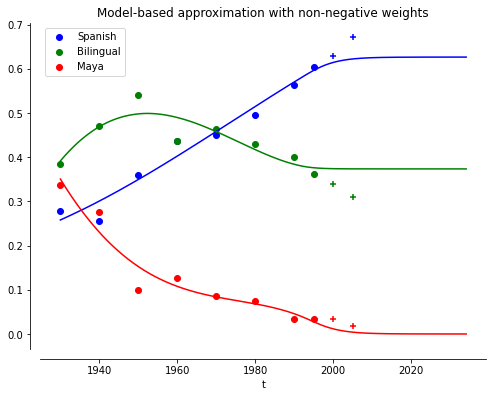

Epoch 1/500
32/32 - 1s - loss: 1.9631e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 8.4661e-06 - 133ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.7538e-06 - 132ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.5584e-06 - 128ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.8782e-06 - 137ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.5231e-06 - 128ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3017e-06 - 130ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1350e-06 - 140ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0042e-06 - 130ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 9.0162e-07 - 126ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 8.0903e-07 - 150ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 7.2638e-07 - 128ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 6.5255e-07 - 130ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 5.8634e-07 - 119ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 5.2210e-07 - 131ms/epoch - 

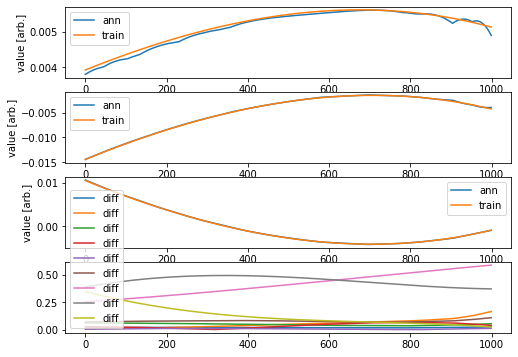

AG
AG


0.004516732764159214


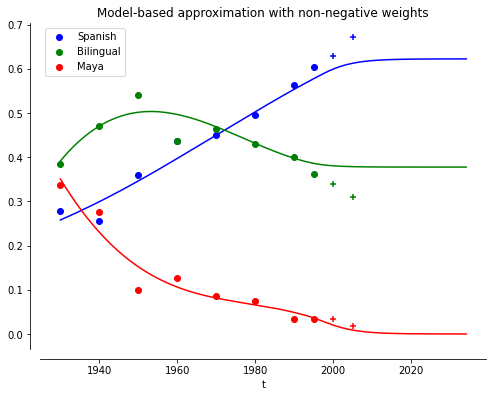

Epoch 1/500
32/32 - 1s - loss: 5.5795e-05 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 7.0373e-06 - 132ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 4.6279e-06 - 137ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 3.6317e-06 - 129ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 2.7339e-06 - 142ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.1130e-06 - 131ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.7168e-06 - 134ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4448e-06 - 135ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.2441e-06 - 134ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0497e-06 - 130ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 8.8279e-07 - 128ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 7.4026e-07 - 130ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 6.4117e-07 - 144ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 5.4973e-07 - 127ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.6773e-07 - 130ms/epoch - 

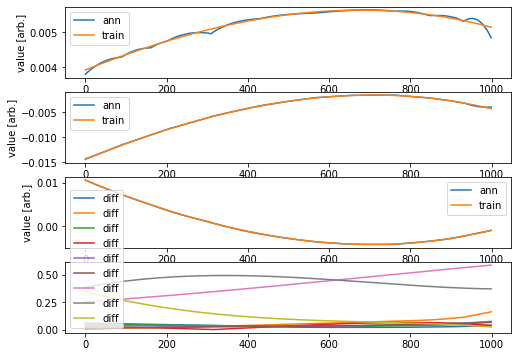

AG
AG


0.0031599558947638723


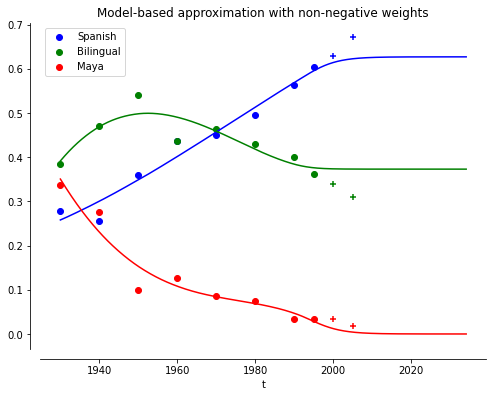

____________________________
Iteración =  5
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 1, 0], [0, 1, 0, 1, 0, 0]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.5725897849215746, 0.0034679809424575624]
Epoch 1/500
32/32 - 1s - loss: 9.6016e-04 - 1s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6476e-05 - 126ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.6304e-06 - 120ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.4356e-06 - 130ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2297e-06 - 127ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0805e-06 - 119ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 9.6438e-07 - 135ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 8.6607e-07 - 131ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 7.8994e-07 - 136ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 7.2424e-07 - 130ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 6.7223e-07 - 

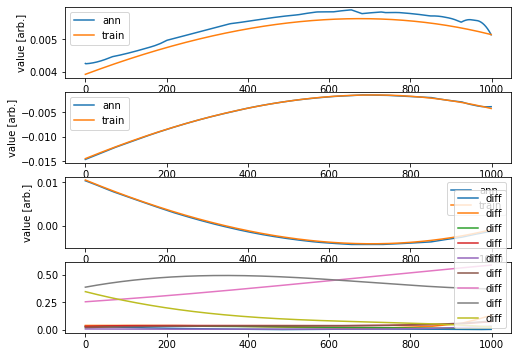

AG
AG


0.0027921737788992383


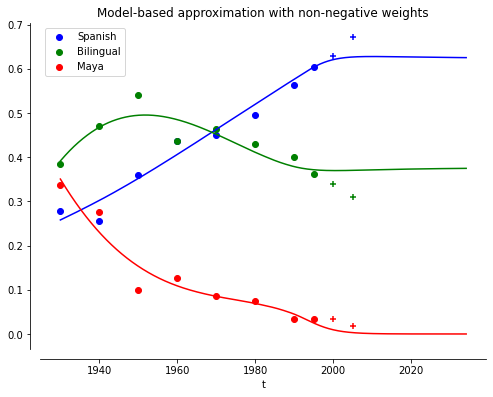

Epoch 1/500
32/32 - 1s - loss: 7.4877e-04 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2690e-05 - 120ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.8449e-06 - 122ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 3.2902e-06 - 125ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 2.9182e-06 - 111ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.5883e-06 - 117ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 2.3007e-06 - 134ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 2.0652e-06 - 123ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.8782e-06 - 152ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 1.7181e-06 - 117ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.5778e-06 - 115ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.4532e-06 - 115ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.3387e-06 - 113ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.2386e-06 - 121ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.1450e-06 - 137ms/epoch - 

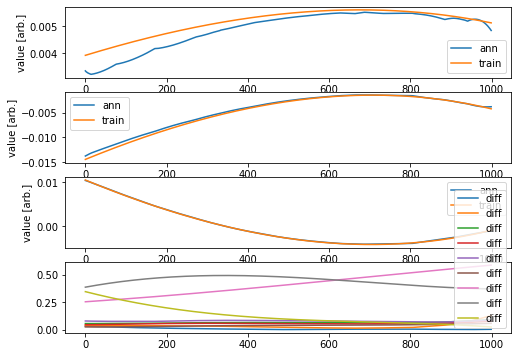

AG
AG


0.004025745236471454


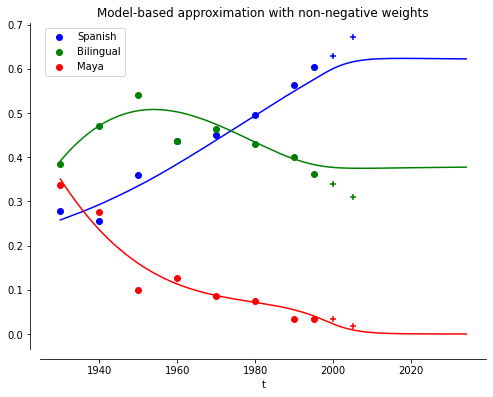

Epoch 1/500
32/32 - 1s - loss: 1.0154e-04 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 9.4722e-06 - 122ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 4.4269e-06 - 128ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.6639e-06 - 128ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.8745e-06 - 140ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4183e-06 - 125ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1389e-06 - 121ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 9.5640e-07 - 136ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.2829e-07 - 126ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 7.3455e-07 - 116ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 6.6520e-07 - 132ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 6.1271e-07 - 122ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 5.6674e-07 - 138ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 5.2967e-07 - 123ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.9961e-07 - 128ms/epoch - 

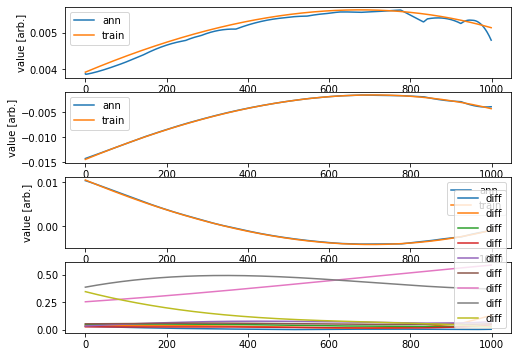

AG
AG


0.0033516839792331714


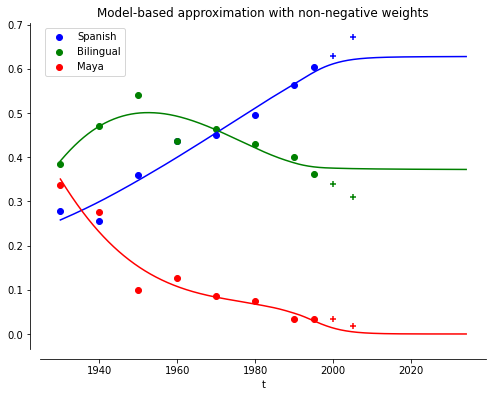

Epoch 1/500
32/32 - 2s - loss: 3.6153e-04 - 2s/epoch - 49ms/step
Epoch 2/500
32/32 - 0s - loss: 8.2226e-06 - 124ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.9615e-06 - 136ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.3452e-06 - 136ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 2.0297e-06 - 121ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8083e-06 - 141ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.6415e-06 - 136ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4977e-06 - 136ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.3640e-06 - 136ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2435e-06 - 129ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1329e-06 - 128ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0313e-06 - 122ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 9.4908e-07 - 117ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 8.6954e-07 - 143ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 7.9717e-07 - 123ms/epoch - 

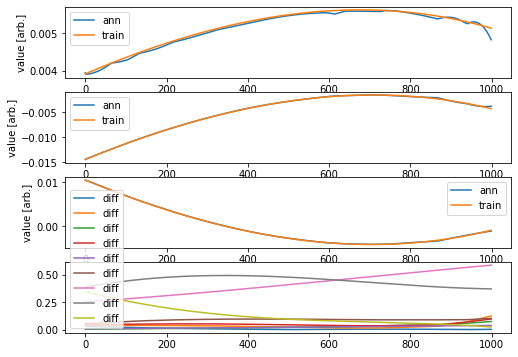

AG
AG


0.0026816968641554815


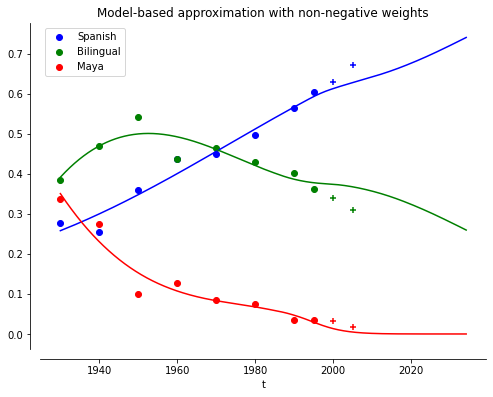

Epoch 1/500
32/32 - 2s - loss: 2.0994e-04 - 2s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 4.6509e-06 - 163ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 1.6280e-06 - 143ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.1330e-06 - 151ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 8.9090e-07 - 145ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 7.4997e-07 - 149ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 6.5390e-07 - 138ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.8751e-07 - 148ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 5.4493e-07 - 139ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 5.1399e-07 - 143ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 4.9097e-07 - 154ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 4.7134e-07 - 142ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 4.5384e-07 - 153ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 4.3970e-07 - 131ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.2562e-07 - 133ms/epoch - 

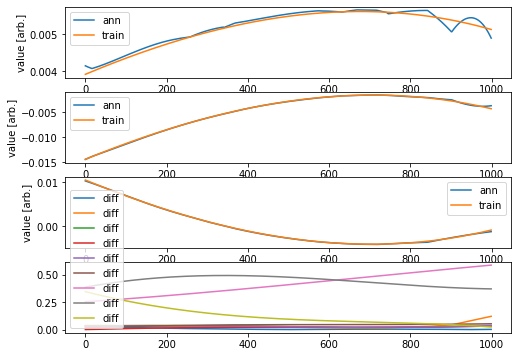

AG
AG


0.0026419001707194117


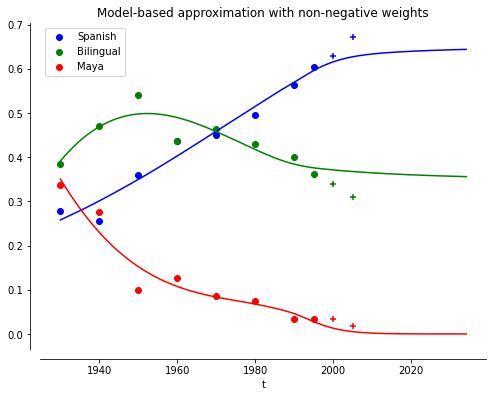

____________________________
Iteración =  6
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [0, 1, 0, 1, 0, 0], [1, 1, 0, 0, 0, 0]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.0034679809424575624, 0.0030986400058957515]
Epoch 1/500
32/32 - 2s - loss: 9.5896e-04 - 2s/epoch - 48ms/step
Epoch 2/500
32/32 - 0s - loss: 1.3781e-05 - 140ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.1870e-06 - 145ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 2.1824e-06 - 145ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7326e-06 - 142ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3676e-06 - 135ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0848e-06 - 135ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 8.6286e-07 - 139ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 6.9984e-07 - 140ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 5.8479e-07 - 158ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 5.0632e-07

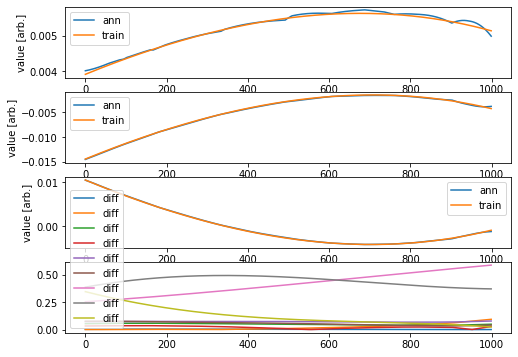

AG
AG


0.0020371733476371957


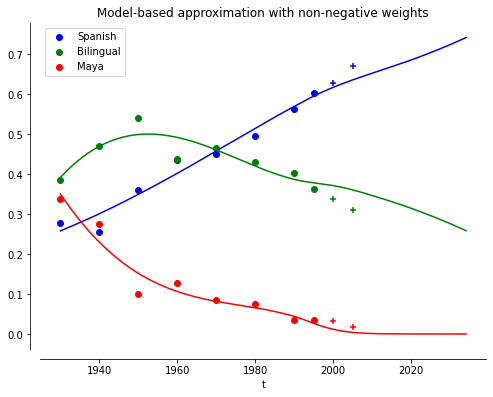

Epoch 1/500
32/32 - 2s - loss: 7.4639e-04 - 2s/epoch - 50ms/step
Epoch 2/500
32/32 - 0s - loss: 1.1245e-05 - 140ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.1015e-06 - 146ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6550e-06 - 131ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0933e-06 - 143ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.6188e-07 - 153ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 7.1468e-07 - 142ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.9289e-07 - 138ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.9457e-07 - 150ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 4.2278e-07 - 141ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.6689e-07 - 136ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.1811e-07 - 154ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 2.8166e-07 - 153ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 2.5212e-07 - 145ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2900e-07 - 148ms/epoch - 

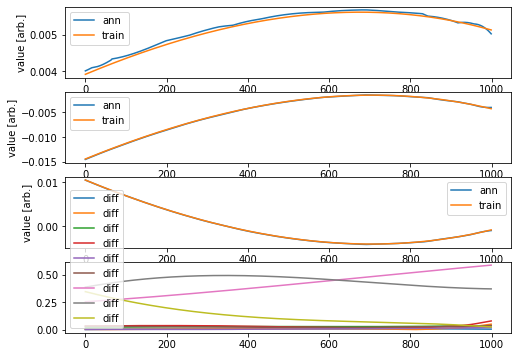

AG
AG


0.0018075133341009676


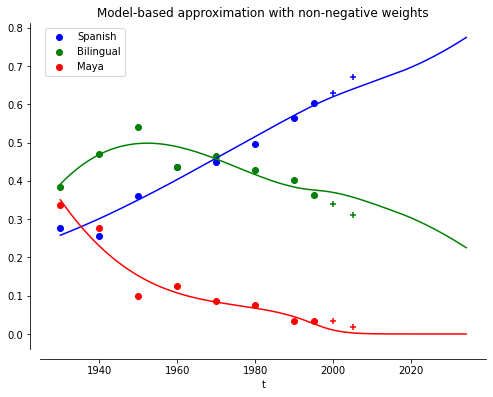

Epoch 1/500
32/32 - 1s - loss: 9.7532e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4461e-05 - 158ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 1.9080e-06 - 139ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.1986e-06 - 147ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 9.1630e-07 - 148ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9614e-07 - 149ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 7.1948e-07 - 138ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 6.7089e-07 - 129ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 6.2374e-07 - 144ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 5.8895e-07 - 132ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 5.6173e-07 - 131ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 5.3638e-07 - 136ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 5.1324e-07 - 149ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 4.9387e-07 - 137ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.7789e-07 - 136ms/epoch - 

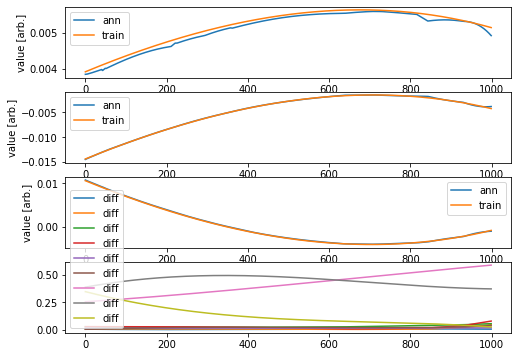

AG
AG


0.0023926802692759157


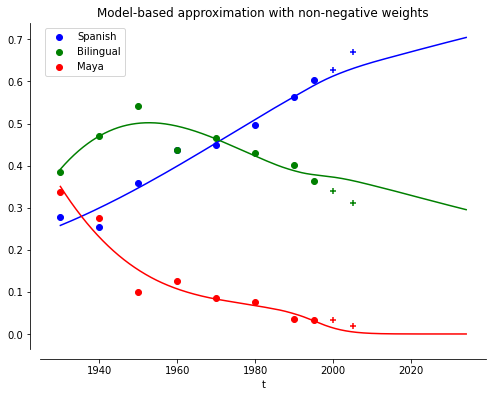

Epoch 1/500
32/32 - 2s - loss: 8.5669e-04 - 2s/epoch - 59ms/step
Epoch 2/500
32/32 - 0s - loss: 1.5441e-05 - 113ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.3162e-06 - 104ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.4603e-06 - 93ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0755e-06 - 88ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.1096e-07 - 101ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.2644e-07 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.0738e-07 - 135ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3587e-07 - 183ms/epoch - 6ms/step
Epoch 10/500
32/32 - 0s - loss: 3.8839e-07 - 164ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 3.5707e-07 - 139ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.3461e-07 - 146ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 3.1611e-07 - 146ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 3.0141e-07 - 150ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 2.8691e-07 - 156ms/epoch - 5ms

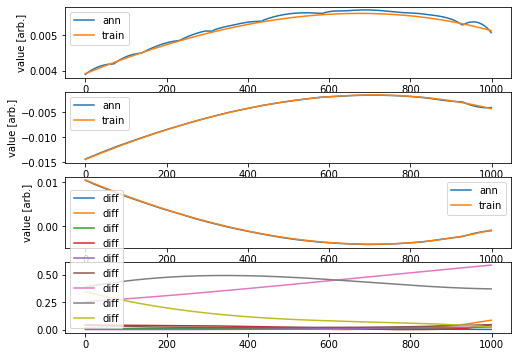

AG
AG


0.0024195419835114705


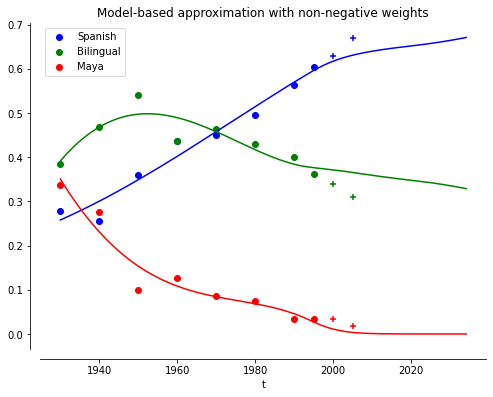

Epoch 1/500
32/32 - 2s - loss: 0.0022 - 2s/epoch - 50ms/step
Epoch 2/500
32/32 - 0s - loss: 3.0239e-05 - 150ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 6.7354e-06 - 135ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.7680e-06 - 153ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7166e-06 - 160ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3511e-06 - 147ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1269e-06 - 133ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 9.9060e-07 - 142ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.6895e-07 - 144ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 7.9337e-07 - 146ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 7.2958e-07 - 148ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 6.6911e-07 - 135ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 6.2987e-07 - 154ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 5.9463e-07 - 147ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 5.6873e-07 - 149ms/epoch - 5ms/

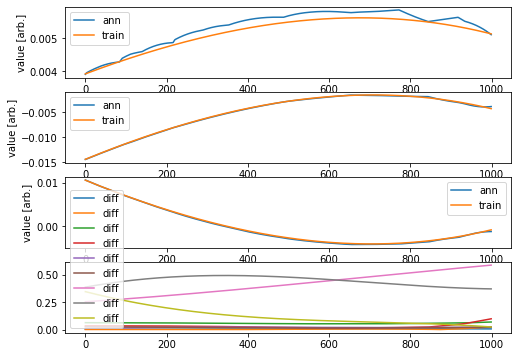

AG
AG


0.0008762275760545686


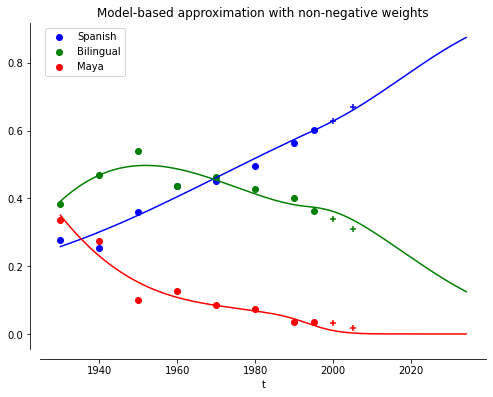

____________________________
Iteración =  7
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 0, 0, 0], [1, 1, 0, 1, 0, 0]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.0030986400058957515, 0.0019066273021160238]
Epoch 1/500
32/32 - 1s - loss: 8.7225e-04 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 1.5135e-05 - 126ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.8052e-06 - 143ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.3651e-06 - 134ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 2.1970e-06 - 115ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.0522e-06 - 138ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.9008e-06 - 137ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.7638e-06 - 133ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.6360e-06 - 144ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.5198e-06 - 118ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.4157e-06

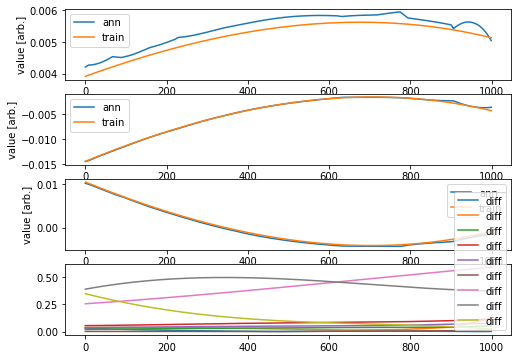

AG
AG


0.0022149036225305244


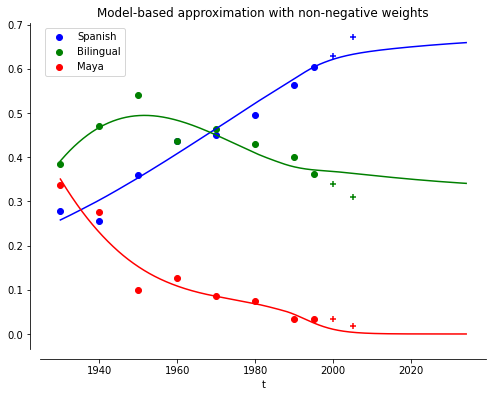

Epoch 1/500
32/32 - 1s - loss: 0.0012 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 2.8103e-05 - 148ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 4.0454e-06 - 151ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6758e-06 - 162ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4218e-06 - 136ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3136e-06 - 137ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2192e-06 - 144ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1331e-06 - 141ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0594e-06 - 165ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 9.8984e-07 - 153ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 9.2646e-07 - 149ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 8.6899e-07 - 144ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 8.1593e-07 - 151ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 7.6684e-07 - 140ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 7.2062e-07 - 160ms/epoch - 5ms/

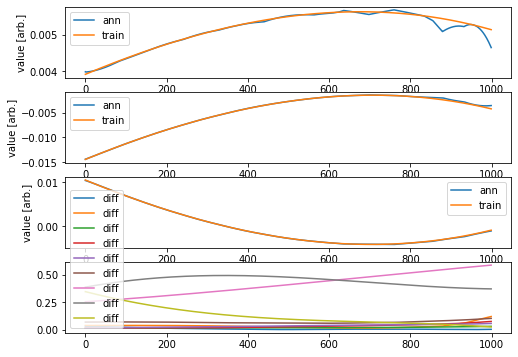

AG
AG


0.003304296722286614


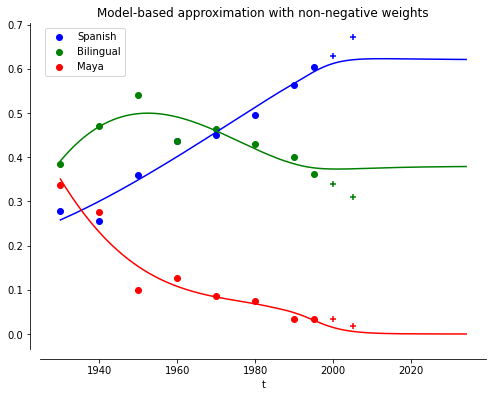

Epoch 1/500
32/32 - 2s - loss: 0.0014 - 2s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 1.5029e-05 - 144ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 5.9316e-06 - 152ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 3.6988e-06 - 145ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 2.7055e-06 - 170ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 2.1110e-06 - 156ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 1.7193e-06 - 147ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4466e-06 - 149ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.2701e-06 - 142ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.1388e-06 - 145ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 1.0269e-06 - 136ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 9.3613e-07 - 129ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 8.6082e-07 - 157ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 7.9151e-07 - 145ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 7.3569e-07 - 147ms/epoch - 5ms/

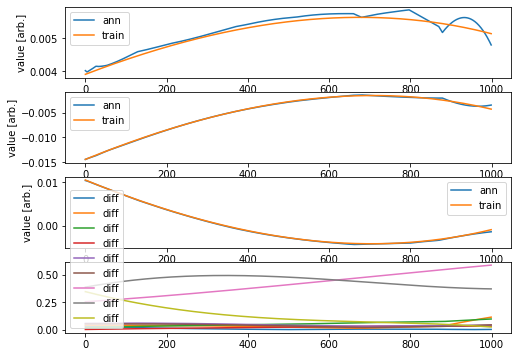

AG
AG


0.0022354654780201043


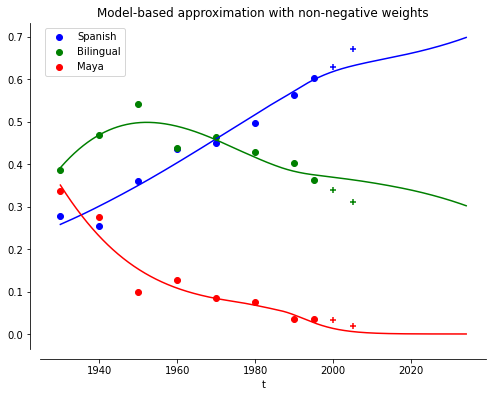

Epoch 1/500
32/32 - 1s - loss: 2.8656e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2949e-05 - 147ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 4.1718e-06 - 151ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 2.0947e-06 - 143ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2442e-06 - 155ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0122e-06 - 155ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 9.3412e-07 - 149ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 8.7782e-07 - 138ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.3024e-07 - 140ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 7.9394e-07 - 152ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 7.6515e-07 - 141ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 7.3685e-07 - 155ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 7.1111e-07 - 139ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 6.8605e-07 - 153ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 6.6485e-07 - 134ms/epoch - 

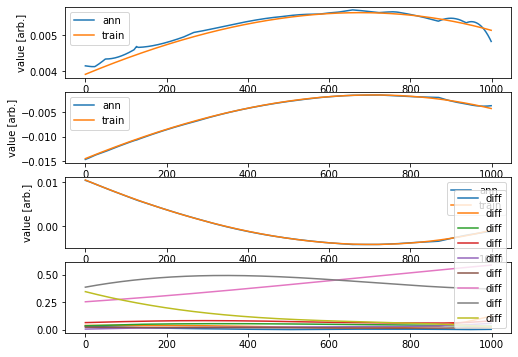

AG
AG


0.002936487758474618


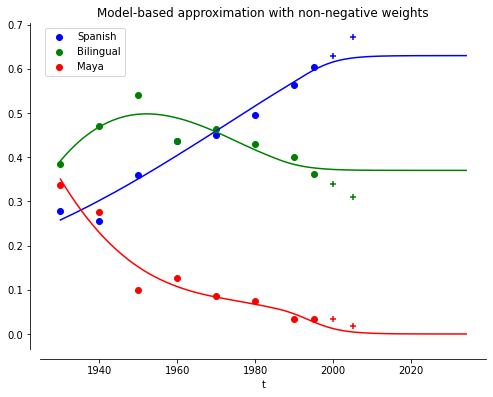

Epoch 1/500
32/32 - 1s - loss: 9.7541e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 2.9193e-05 - 152ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2056e-05 - 142ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 5.2357e-06 - 137ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 3.5107e-06 - 155ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 2.9073e-06 - 158ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 2.4450e-06 - 152ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 2.0540e-06 - 147ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.7410e-06 - 149ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 1.4794e-06 - 129ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.2769e-06 - 149ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 1.1247e-06 - 161ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0086e-06 - 142ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 9.2203e-07 - 161ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 8.4973e-07 - 148ms/epoch - 

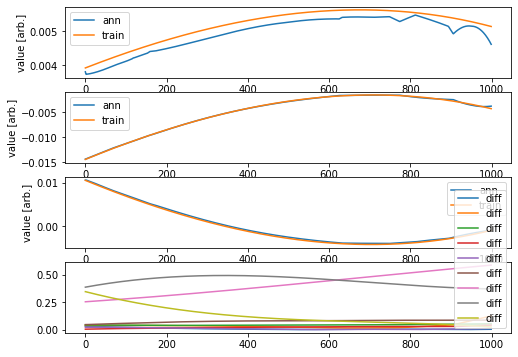

AG
AG


0.003610419483125814


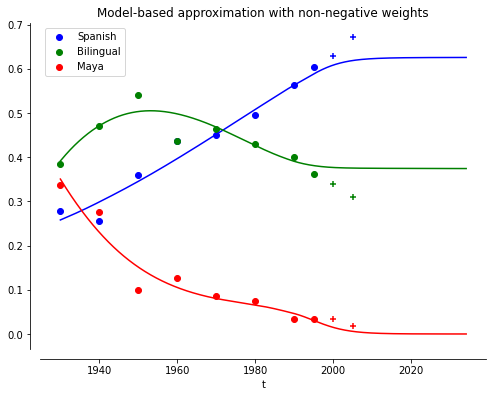

____________________________
Iteración =  8
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 0], [1, 1, 0, 0, 0, 0]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.0019066273021160238, 0.002860314612887535]
Epoch 1/500
32/32 - 1s - loss: 5.0375e-04 - 1s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4143e-05 - 142ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.4395e-06 - 128ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2385e-06 - 146ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 9.0860e-07 - 138ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 6.4051e-07 - 153ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 5.2902e-07 - 145ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 4.8026e-07 - 130ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.5150e-07 - 136ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 4.2167e-07 - 143ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.8847e-07 

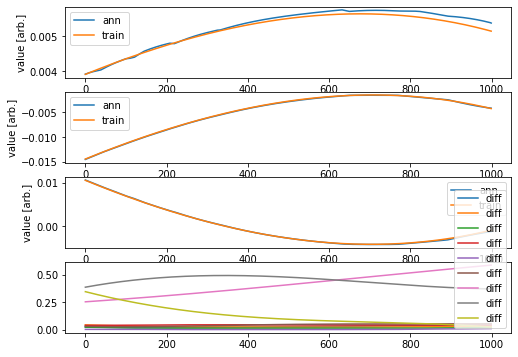

AG
AG


0.5306571256627265


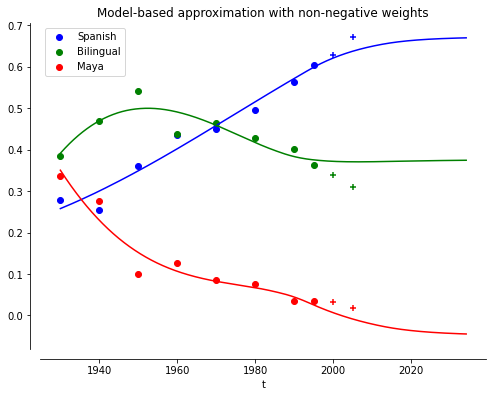

Epoch 1/500
32/32 - 1s - loss: 3.4203e-04 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 6.6133e-06 - 121ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 9.8349e-07 - 147ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 7.1703e-07 - 141ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 6.0879e-07 - 144ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 5.1878e-07 - 142ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 4.2012e-07 - 132ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 3.4666e-07 - 114ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 3.1579e-07 - 122ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.8866e-07 - 125ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6550e-07 - 139ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.3502e-07 - 140ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.1272e-07 - 145ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8466e-07 - 136ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.5813e-07 - 138ms/epoch - 

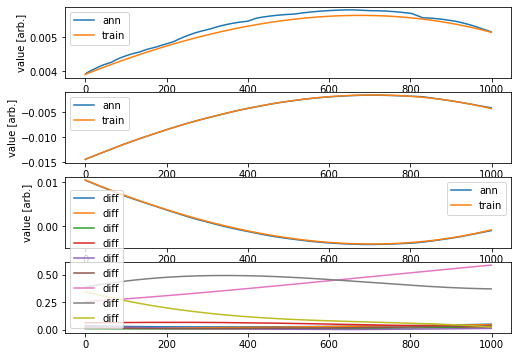

AG
AG


0.6903091476213484


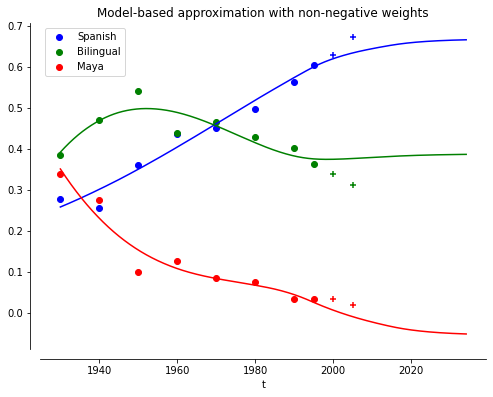

Epoch 1/500
32/32 - 1s - loss: 7.4006e-04 - 1s/epoch - 43ms/step
Epoch 2/500
32/32 - 0s - loss: 2.2174e-05 - 140ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.0260e-06 - 149ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2923e-06 - 151ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 8.4210e-07 - 147ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 7.1631e-07 - 145ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 6.3903e-07 - 119ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.7629e-07 - 115ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 5.2056e-07 - 124ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 4.6267e-07 - 132ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 4.0568e-07 - 113ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.5284e-07 - 136ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.1566e-07 - 118ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.7401e-07 - 132ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.4827e-07 - 132ms/epoch - 

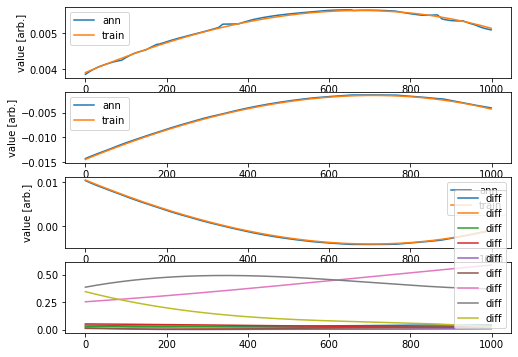

AG
AG


0.39897626303571027


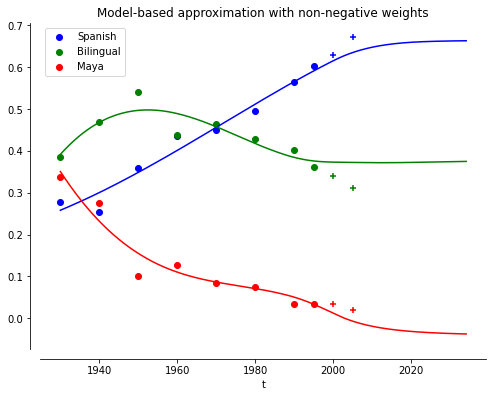

Epoch 1/500
32/32 - 1s - loss: 6.9238e-04 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 9.1218e-06 - 134ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.6278e-06 - 123ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0028e-06 - 133ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 7.9662e-07 - 116ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 6.6405e-07 - 113ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 5.6940e-07 - 128ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.9467e-07 - 153ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3593e-07 - 132ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.8538e-07 - 152ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 3.4280e-07 - 113ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.1508e-07 - 114ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.8754e-07 - 132ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.6907e-07 - 114ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.3526e-07 - 156ms/epoch - 

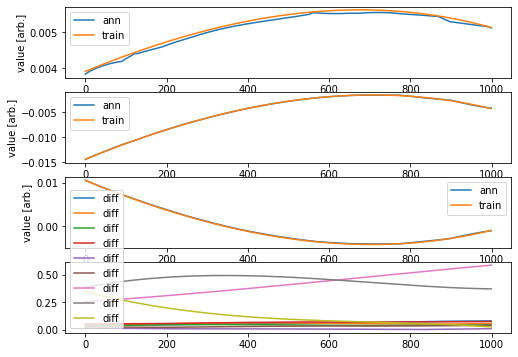

AG
AG


0.01865668850234079


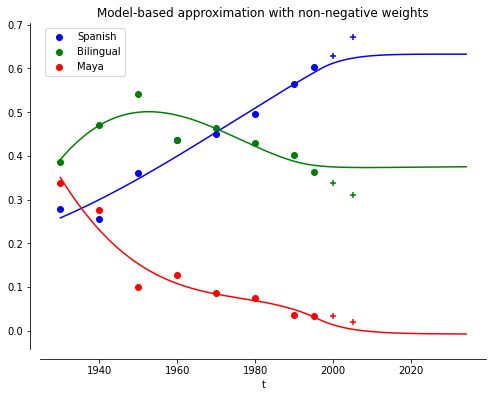

Epoch 1/500
32/32 - 1s - loss: 3.6020e-04 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 9.1009e-06 - 139ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.0503e-06 - 151ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2329e-06 - 157ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 9.2605e-07 - 166ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 7.1748e-07 - 146ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 5.4055e-07 - 151ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 4.0326e-07 - 148ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 2.8630e-07 - 140ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.0350e-07 - 142ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.5603e-07 - 156ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 1.1306e-07 - 141ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 8.6117e-08 - 138ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 6.9229e-08 - 152ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 6.0413e-08 - 146ms/epoch - 

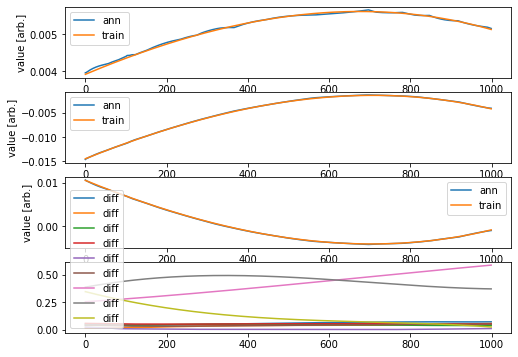

AG
AG


0.04998422853904309


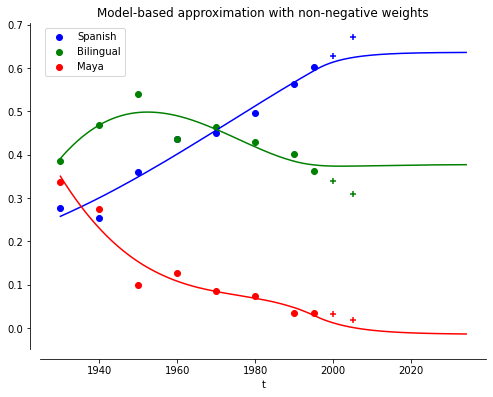

____________________________
Iteración =  9
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 0], [1, 1, 0, 0, 0, 0]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.0019066273021160238, 0.002860314612887535]
Epoch 1/500
32/32 - 1s - loss: 7.5785e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 1.7333e-05 - 147ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 5.7581e-06 - 143ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.3079e-06 - 163ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 9.8507e-07 - 146ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 5.8401e-07 - 146ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 4.5014e-07 - 136ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 3.8659e-07 - 148ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4247e-07 - 134ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1095e-07 - 150ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8471e-07 

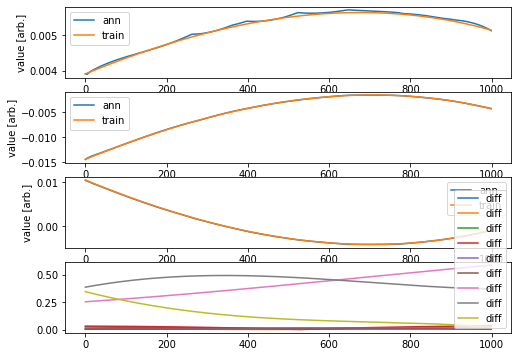

AG
AG


1.6200899670652191


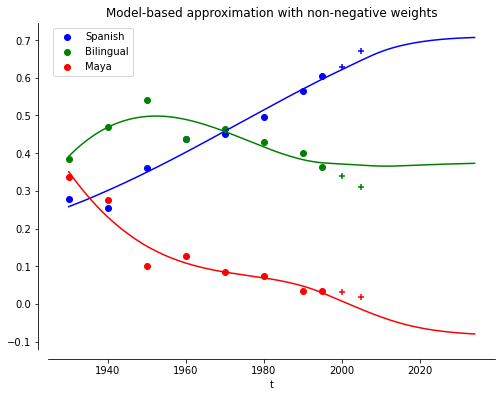

Epoch 1/500
32/32 - 2s - loss: 0.0010 - 2s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 3.5548e-05 - 133ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0441e-05 - 148ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 5.5433e-06 - 138ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 3.3221e-06 - 150ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 2.1955e-06 - 166ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 1.4859e-06 - 131ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0142e-06 - 133ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 7.0454e-07 - 142ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 5.0911e-07 - 154ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 3.6746e-07 - 138ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6055e-07 - 155ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 1.9663e-07 - 144ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 1.6173e-07 - 153ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 1.4114e-07 - 144ms/epoch - 4ms/

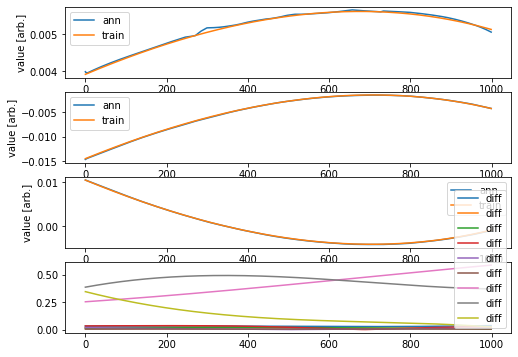

AG
AG


2.4103370604717784


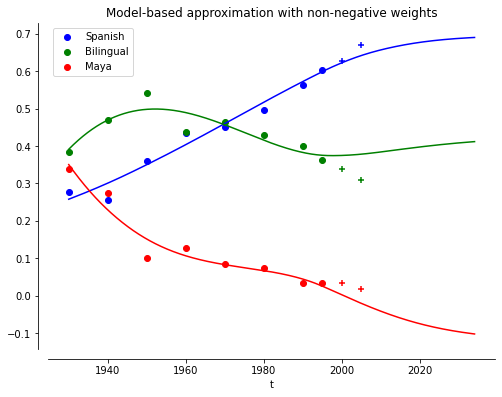

Epoch 1/500
32/32 - 1s - loss: 8.7983e-04 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 2.0328e-05 - 117ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 4.5848e-06 - 141ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.5575e-06 - 110ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.7648e-07 - 132ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.1110e-07 - 140ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 6.7068e-07 - 128ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.4481e-07 - 134ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.4255e-07 - 143ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6868e-07 - 135ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.1872e-07 - 142ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8429e-07 - 133ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.5773e-07 - 150ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 2.3412e-07 - 148ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 2.1637e-07 - 156ms/epoch - 

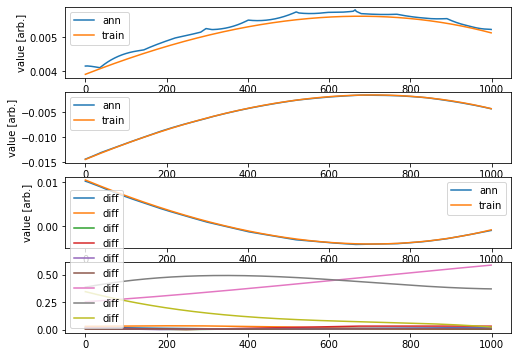

AG
AG


0.5630534567365022


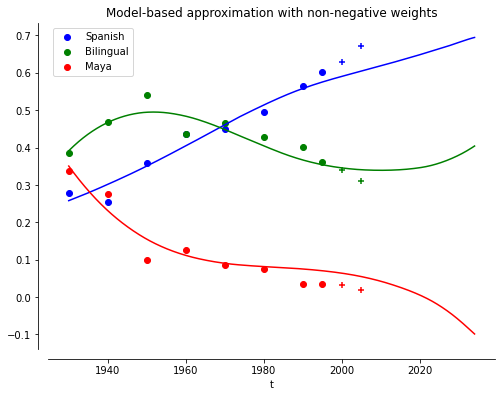

Epoch 1/500
32/32 - 1s - loss: 0.0010 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 1.1228e-05 - 149ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 4.0123e-06 - 124ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.3721e-06 - 134ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.6546e-06 - 139ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3003e-06 - 143ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0837e-06 - 143ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 9.7186e-07 - 147ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 8.5490e-07 - 175ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 7.4884e-07 - 129ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 6.6713e-07 - 150ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 5.9705e-07 - 142ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 5.3526e-07 - 154ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 4.6289e-07 - 155ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 4.0898e-07 - 148ms/epoch - 5ms/

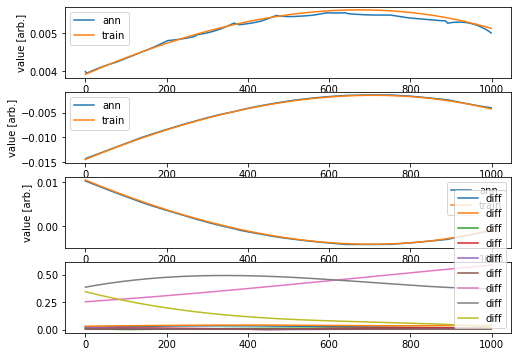

AG
AG


0.23294705666858373


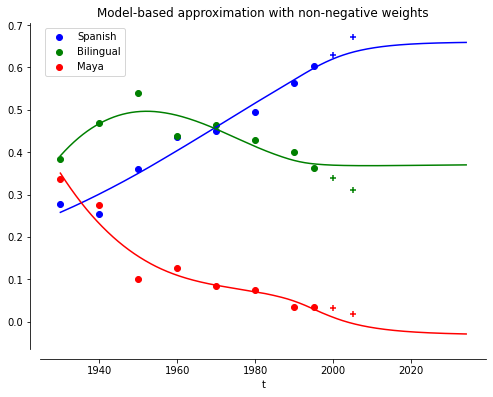

Epoch 1/500
32/32 - 1s - loss: 0.0013 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 2.4421e-05 - 143ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 5.6326e-06 - 141ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 3.7423e-06 - 149ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 2.7737e-06 - 135ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.1234e-06 - 138ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.7348e-06 - 140ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4562e-06 - 136ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.2428e-06 - 132ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0612e-06 - 134ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 9.2380e-07 - 128ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 8.1923e-07 - 130ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 7.2374e-07 - 125ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 6.4712e-07 - 123ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 5.7954e-07 - 140ms/epoch - 4ms/

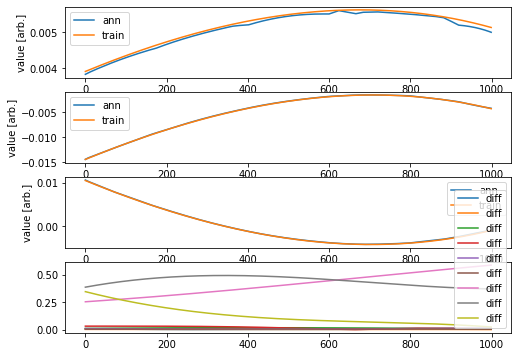

AG
AG


2.2696394906617714


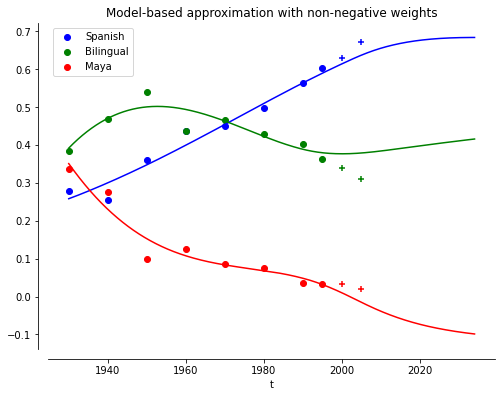

____________________________
Iteración =  10
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 0], [1, 1, 0, 0, 0, 0]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.0019066273021160238, 0.002860314612887535]
Epoch 1/500
32/32 - 1s - loss: 0.0013 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 3.2941e-05 - 129ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 6.0901e-06 - 148ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 3.7229e-06 - 148ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 2.5967e-06 - 138ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.9329e-06 - 135ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.4898e-06 - 152ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 1.2387e-06 - 151ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0547e-06 - 137ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 8.9113e-07 - 133ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 7.5505e-07 - 1

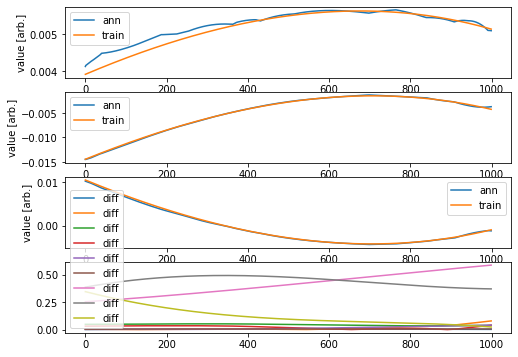

AG
AG


0.0013880368385916417


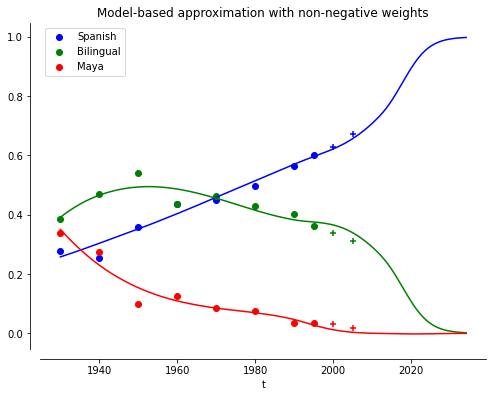

Epoch 1/500
32/32 - 1s - loss: 7.0845e-04 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 2.1249e-05 - 132ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.6987e-06 - 134ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.6481e-06 - 134ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 2.1709e-06 - 146ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8263e-06 - 148ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5783e-06 - 145ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4091e-06 - 133ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.2967e-06 - 131ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2093e-06 - 144ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1317e-06 - 136ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0695e-06 - 151ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0060e-06 - 138ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 9.6141e-07 - 119ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 9.2788e-07 - 122ms/epoch - 

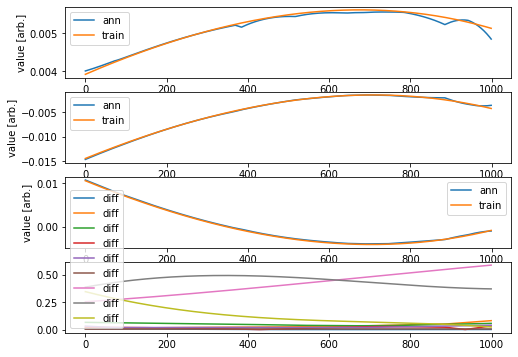

AG
AG


0.002631526738367072


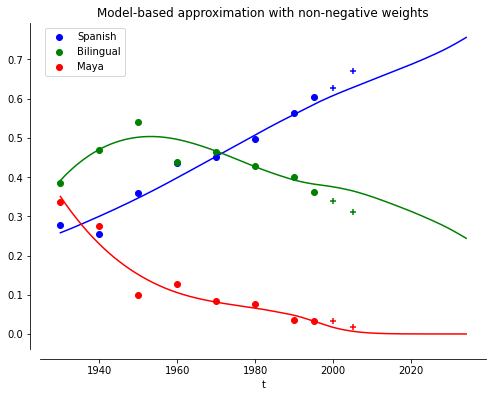

Epoch 1/500
32/32 - 1s - loss: 0.0012 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 3.2844e-05 - 131ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4587e-05 - 146ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0032e-05 - 123ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 7.7992e-06 - 122ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 6.2512e-06 - 135ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 5.0510e-06 - 139ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.1455e-06 - 133ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4832e-06 - 125ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.9226e-06 - 146ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 2.3959e-06 - 133ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.9006e-06 - 129ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.4192e-06 - 132ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 9.7046e-07 - 129ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 7.0746e-07 - 122ms/epoch - 4ms/

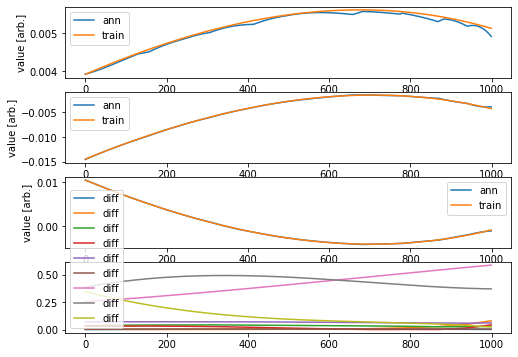

AG
AG


0.0022298346836003655


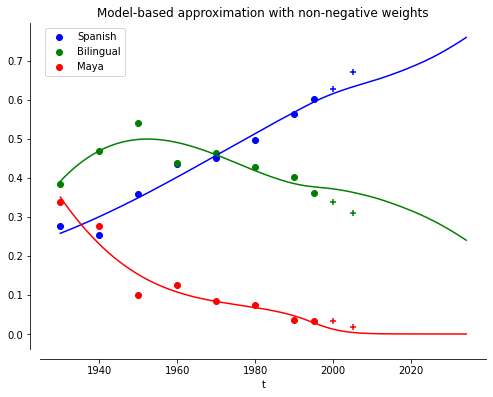

Epoch 1/500
32/32 - 1s - loss: 6.5225e-04 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 2.3329e-05 - 114ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 6.5942e-06 - 117ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.3851e-06 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4846e-06 - 98ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0799e-06 - 94ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.4183e-07 - 94ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.7354e-07 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.8490e-07 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.4060e-07 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.0910e-07 - 102ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.8667e-07 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.6026e-07 - 111ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.4540e-07 - 103ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.3191e-07 - 100ms/epoch - 3ms/step

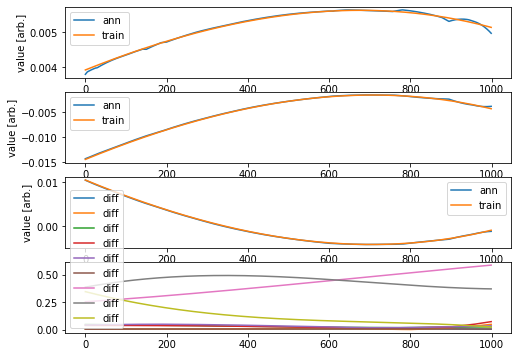

AG
AG


0.0013183682124931109


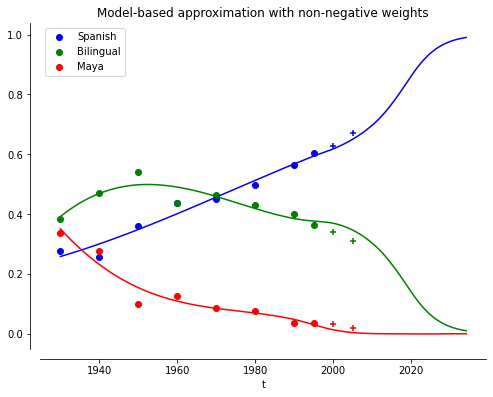

Epoch 1/500
32/32 - 1s - loss: 7.2867e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6493e-05 - 90ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.9794e-06 - 95ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.9574e-06 - 127ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7538e-06 - 118ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.6075e-06 - 100ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.4764e-06 - 98ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.3403e-06 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.2115e-06 - 109ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0924e-06 - 140ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 9.8844e-07 - 110ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.9613e-07 - 131ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 8.0888e-07 - 139ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 6.9792e-07 - 121ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 5.8470e-07 - 122ms/epoch - 4ms/

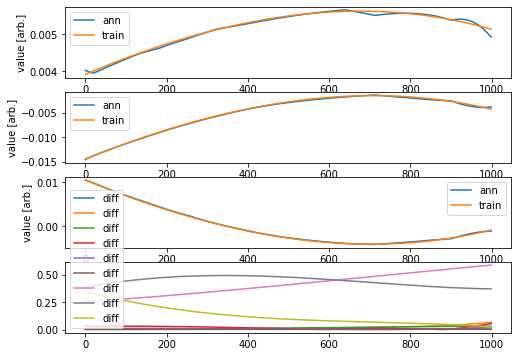

AG
AG


0.0018446146224949348


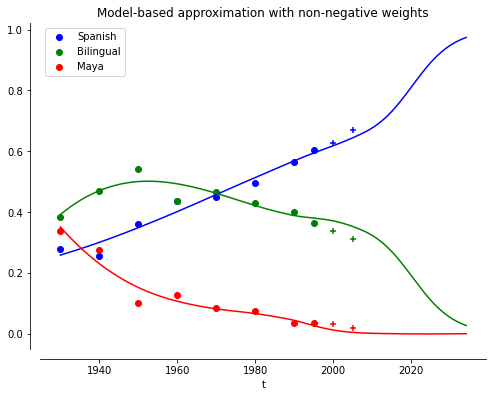

____________________________
Iteración =  11
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 0], [1, 1, 0, 1, 0, 1]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.0019066273021160238, 0.001882476219109425]
Epoch 1/500
32/32 - 1s - loss: 6.8839e-04 - 1s/epoch - 40ms/step
Epoch 2/500
32/32 - 0s - loss: 2.7868e-05 - 87ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 9.2912e-06 - 103ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.1699e-06 - 131ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 3.4141e-06 - 118ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.5384e-06 - 102ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.0339e-06 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.6754e-06 - 97ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4244e-06 - 111ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2580e-06 - 122ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1390e-06 - 

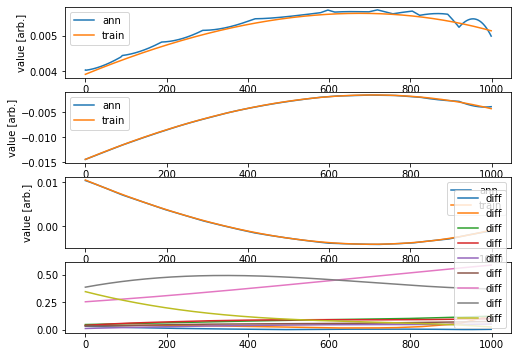

AG
AG


0.003016777945356112


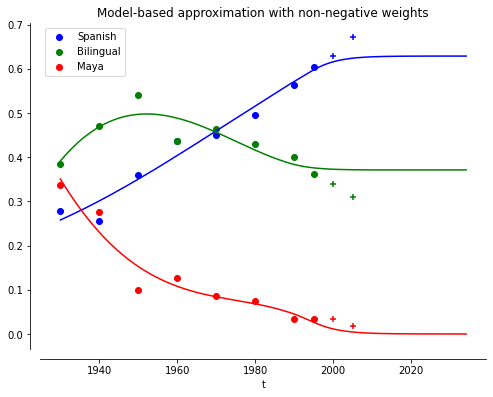

Epoch 1/500
32/32 - 1s - loss: 5.7424e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6380e-05 - 120ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 5.9146e-06 - 112ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.6936e-06 - 106ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.8659e-06 - 103ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.1694e-06 - 103ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.5729e-06 - 114ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.9313e-06 - 109ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.5093e-06 - 101ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2859e-06 - 113ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1179e-06 - 128ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 9.8365e-07 - 98ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 8.7988e-07 - 104ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.9916e-07 - 115ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 7.3965e-07 - 109ms/epoch - 3

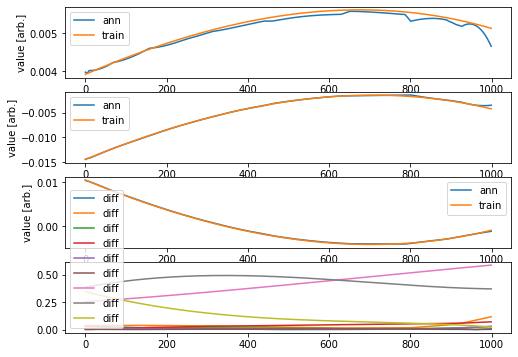

AG
AG


0.0029663662858371593


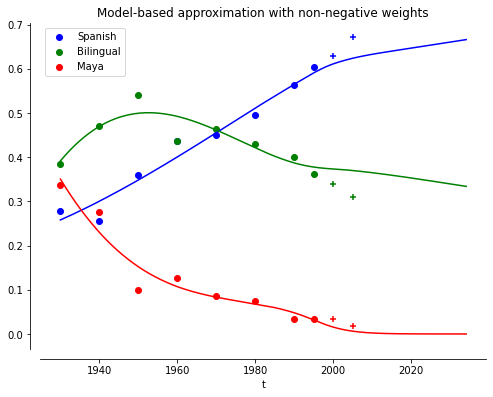

Epoch 1/500
32/32 - 1s - loss: 0.0013 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 2.2163e-05 - 136ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 4.4678e-06 - 150ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 3.2424e-06 - 147ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 2.6289e-06 - 135ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.9208e-06 - 134ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.4641e-06 - 145ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1959e-06 - 141ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0220e-06 - 143ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 8.9624e-07 - 157ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 8.0742e-07 - 138ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 7.4422e-07 - 134ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 6.9502e-07 - 125ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 6.6522e-07 - 135ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 6.4329e-07 - 131ms/epoch - 4ms/

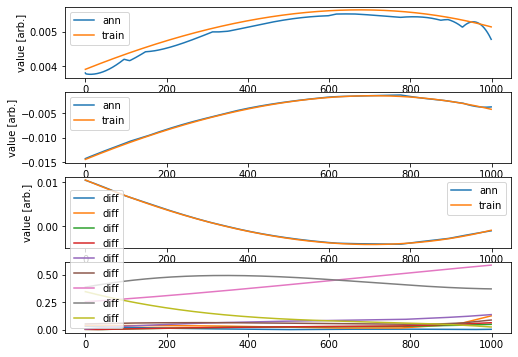

AG
AG


0.0030960252764423704


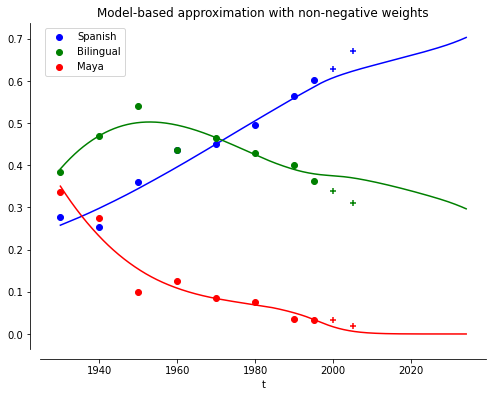

Epoch 1/500
32/32 - 1s - loss: 4.0299e-04 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4402e-05 - 134ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 4.4359e-06 - 128ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.7395e-06 - 138ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 2.0390e-06 - 140ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.6847e-06 - 158ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 1.4669e-06 - 120ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.3099e-06 - 152ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.1807e-06 - 136ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0702e-06 - 138ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 9.7739e-07 - 141ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 9.0282e-07 - 147ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 8.4425e-07 - 139ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 7.9906e-07 - 140ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 7.6304e-07 - 162ms/epoch - 

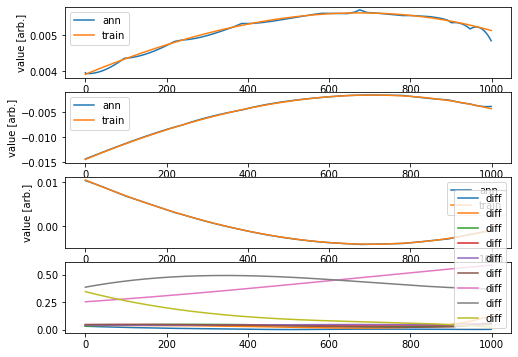

AG
AG


0.0027410782367323578


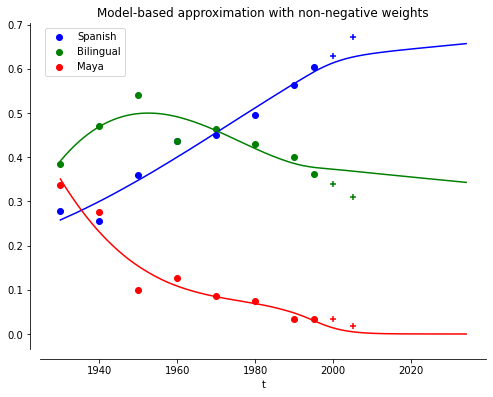

Epoch 1/500
32/32 - 1s - loss: 4.2314e-04 - 1s/epoch - 44ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4858e-05 - 148ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 7.3779e-06 - 146ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 4.2074e-06 - 141ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 2.7404e-06 - 145ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 1.9057e-06 - 152ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3572e-06 - 132ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 9.7715e-07 - 148ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 7.4234e-07 - 145ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 6.2138e-07 - 143ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 5.5600e-07 - 149ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 5.1478e-07 - 151ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 4.9136e-07 - 155ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 4.6024e-07 - 143ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.4101e-07 - 147ms/epoch - 

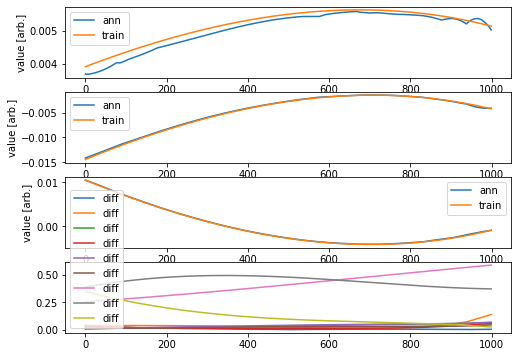

AG
AG


0.00343783200325503


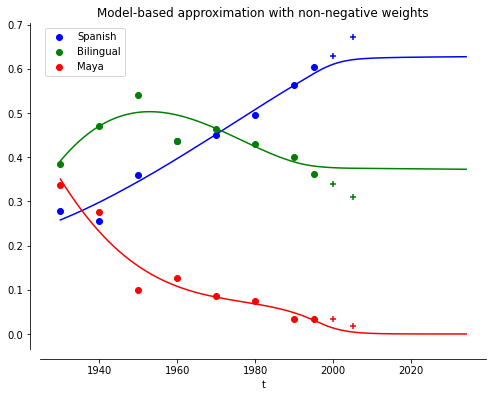

____________________________
Iteración =  12
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 0], [1, 1, 0, 1, 0, 1]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.0019066273021160238, 0.001882476219109425]
Epoch 1/500
32/32 - 1s - loss: 5.2120e-04 - 1s/epoch - 43ms/step
Epoch 2/500
32/32 - 0s - loss: 2.8288e-05 - 145ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7480e-05 - 140ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6372e-05 - 120ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.5828e-05 - 127ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.5472e-05 - 137ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5235e-05 - 141ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.5054e-05 - 150ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4905e-05 - 112ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.4767e-05 - 137ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.4634e-05

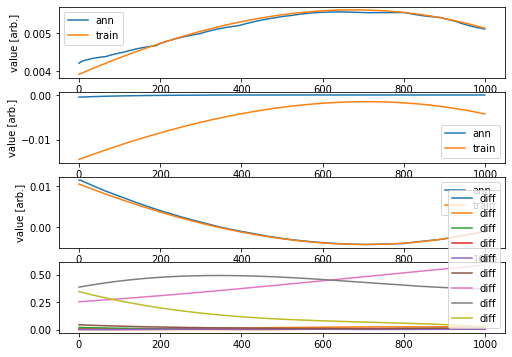

AG
AG


1.1233188069986872


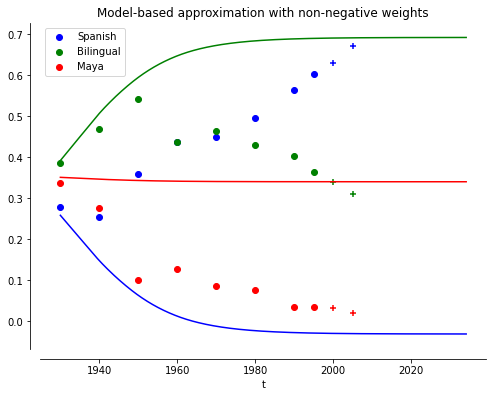

Epoch 1/500
32/32 - 1s - loss: 7.9094e-04 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 3.5375e-05 - 140ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.6689e-05 - 141ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.5552e-05 - 105ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.5076e-05 - 104ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4754e-05 - 105ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.4524e-05 - 118ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4390e-05 - 149ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4281e-05 - 131ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.4169e-05 - 125ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.4045e-05 - 132ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.3950e-05 - 132ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.3881e-05 - 123ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.3817e-05 - 140ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3763e-05 - 115ms/epoch - 

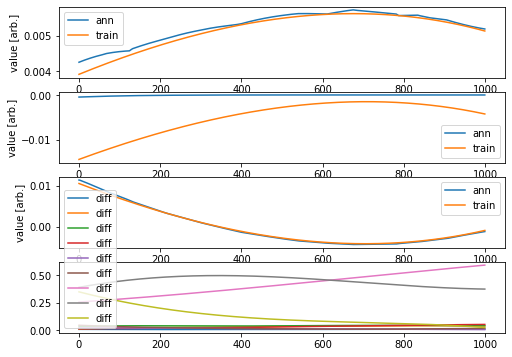

AG
AG


1.0102961732312137


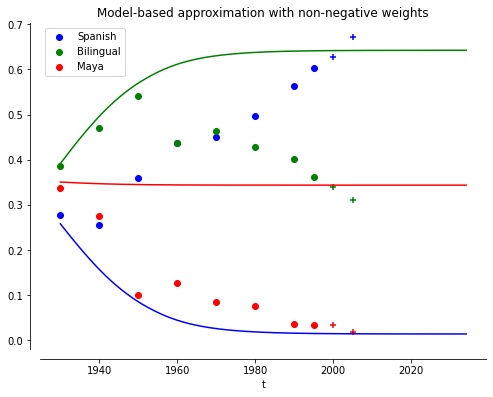

Epoch 1/500
32/32 - 1s - loss: 8.4261e-04 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 2.8337e-05 - 111ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.5062e-05 - 117ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.4439e-05 - 109ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4198e-05 - 122ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4040e-05 - 119ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3926e-05 - 134ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.3833e-05 - 127ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.3753e-05 - 121ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3684e-05 - 130ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.3565e-05 - 115ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.3414e-05 - 124ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.3299e-05 - 113ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.3218e-05 - 150ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3149e-05 - 151ms/epoch - 

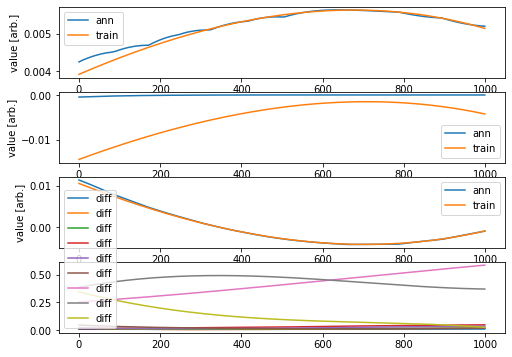

AG
AG


0.9754112316761211


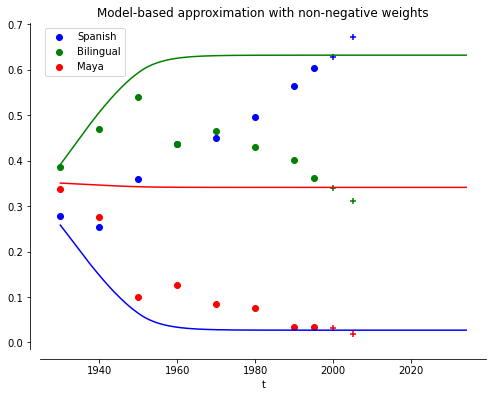

Epoch 1/500
32/32 - 1s - loss: 4.5792e-04 - 1s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 2.1545e-05 - 153ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 1.6124e-05 - 143ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.5166e-05 - 142ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4603e-05 - 159ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4169e-05 - 150ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3810e-05 - 147ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 1.3512e-05 - 146ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.3281e-05 - 142ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3108e-05 - 142ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.2994e-05 - 142ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.2914e-05 - 142ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.2851e-05 - 130ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.2797e-05 - 142ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2753e-05 - 133ms/epoch - 

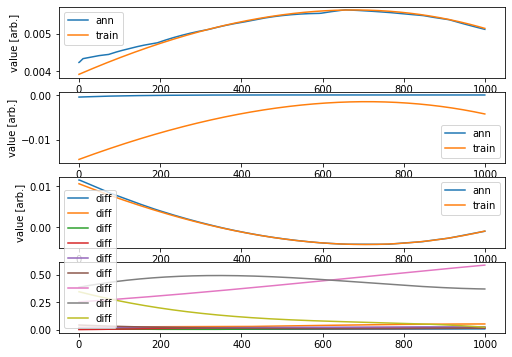

AG
AG


1.141852036816398


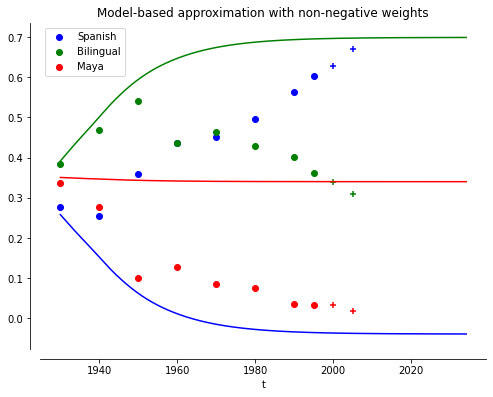

Epoch 1/500
32/32 - 1s - loss: 0.0023 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 3.1704e-05 - 144ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7163e-05 - 132ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.5335e-05 - 131ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4572e-05 - 134ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4202e-05 - 136ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3990e-05 - 167ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 1.3824e-05 - 129ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.3693e-05 - 139ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3566e-05 - 138ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.3455e-05 - 145ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 1.3354e-05 - 127ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.3259e-05 - 116ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.3171e-05 - 128ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3091e-05 - 133ms/epoch - 4ms/

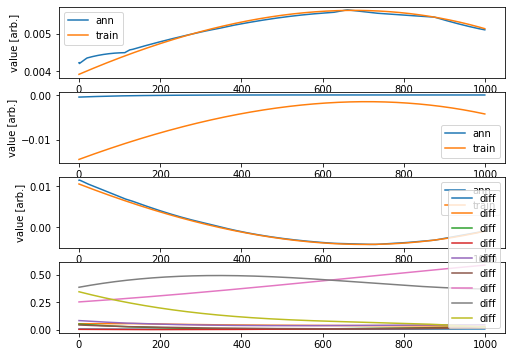

AG
AG


1.1100074370326645


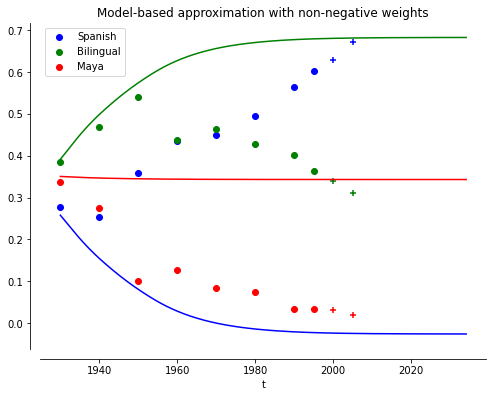

____________________________
Iteración =  13
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 0], [1, 1, 0, 1, 0, 1]]
[0.002261197076972754, 0.0015924474378253555, 0.0024845178719477374, 0.0019066273021160238, 0.001882476219109425]
Epoch 1/500
32/32 - 2s - loss: 2.4996e-04 - 2s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 7.4983e-06 - 137ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.9646e-06 - 142ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6283e-06 - 156ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 8.9940e-07 - 146ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 5.5211e-07 - 136ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 3.9064e-07 - 132ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 3.0894e-07 - 128ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.6758e-07 - 135ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.4052e-07 - 157ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 2.2495e-07

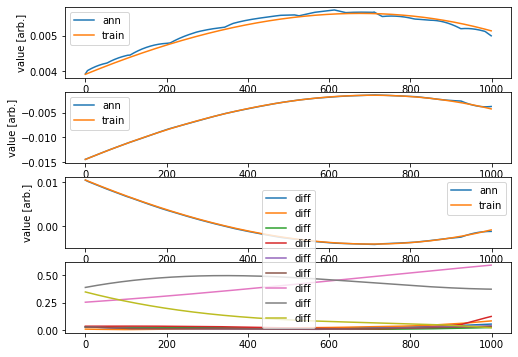

AG
AG


0.0019274404156067047


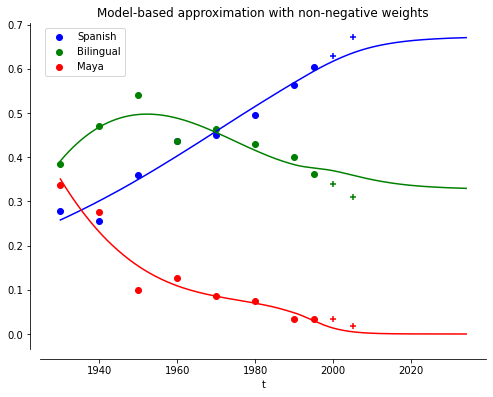

Epoch 1/500
32/32 - 1s - loss: 3.6505e-05 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 1.3954e-06 - 147ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 7.6511e-07 - 131ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 5.9327e-07 - 144ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 5.0641e-07 - 148ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 4.5405e-07 - 146ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 4.2334e-07 - 146ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 4.0868e-07 - 145ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 3.9463e-07 - 126ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.7379e-07 - 130ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.6013e-07 - 155ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4844e-07 - 149ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 3.3788e-07 - 145ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 3.2765e-07 - 127ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.1976e-07 - 146ms/epoch - 

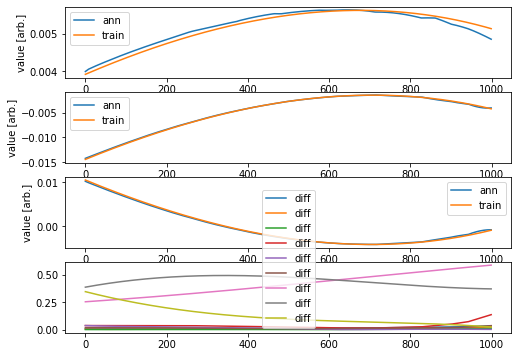

AG
AG


0.001980367340627882


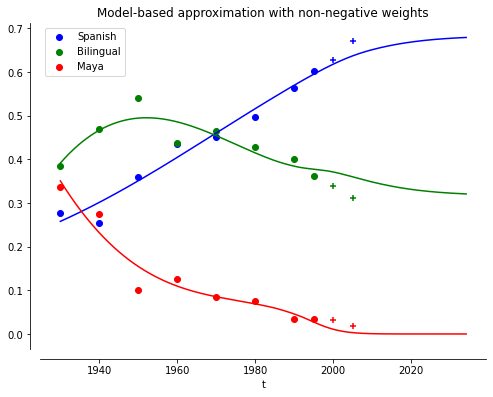

Epoch 1/500
32/32 - 1s - loss: 2.6167e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 5.4926e-06 - 156ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 1.8909e-06 - 147ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 9.0037e-07 - 149ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 5.2600e-07 - 145ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 3.5244e-07 - 164ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 2.8100e-07 - 142ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 2.4712e-07 - 147ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 2.3395e-07 - 133ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.2417e-07 - 137ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1602e-07 - 135ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.1075e-07 - 150ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 2.0835e-07 - 147ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 2.0421e-07 - 145ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0079e-07 - 144ms/epoch - 

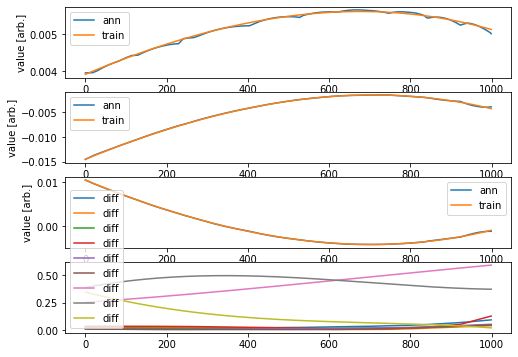

AG
AG


0.002598030947007053


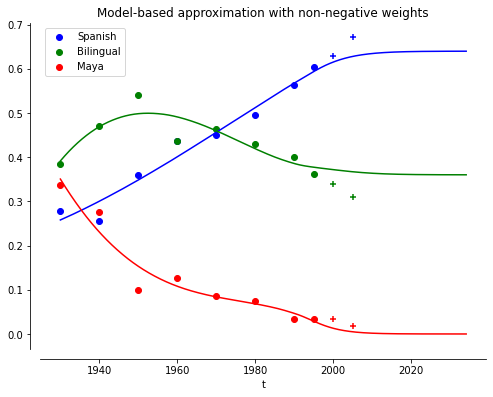

Epoch 1/500
32/32 - 1s - loss: 1.2422e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 1.3472e-06 - 158ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 6.6340e-07 - 151ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 4.9264e-07 - 148ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 4.5012e-07 - 151ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 4.3471e-07 - 142ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 4.1529e-07 - 168ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 3.9650e-07 - 141ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 3.7886e-07 - 143ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.7561e-07 - 145ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 3.5902e-07 - 145ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4865e-07 - 148ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 3.3650e-07 - 134ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 3.2351e-07 - 167ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 3.1773e-07 - 151ms/epoch - 

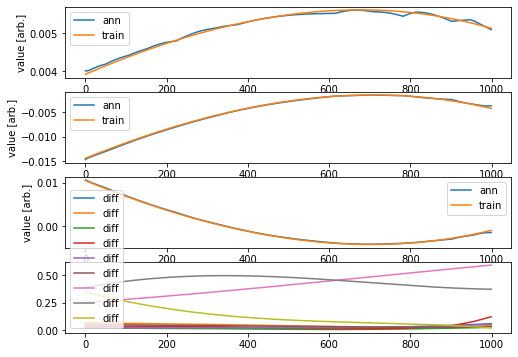

AG
AG


0.0020257536041255694


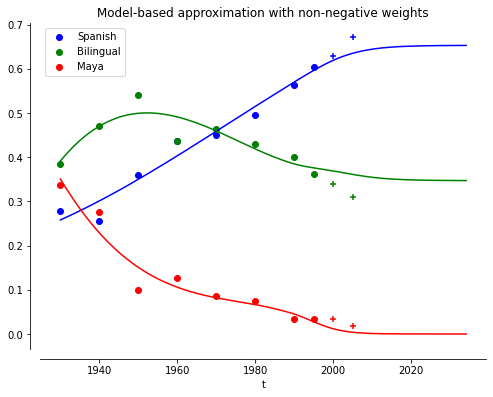

Epoch 1/500
32/32 - 2s - loss: 4.4526e-04 - 2s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 2.6584e-05 - 153ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 2.9970e-06 - 145ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 9.7519e-07 - 155ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 5.5438e-07 - 147ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 4.6329e-07 - 156ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 4.0552e-07 - 149ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 3.6345e-07 - 142ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 3.3698e-07 - 153ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1572e-07 - 145ms/epoch - 5ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0187e-07 - 157ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 2.9033e-07 - 141ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.8023e-07 - 136ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.7241e-07 - 142ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.6599e-07 - 151ms/epoch - 

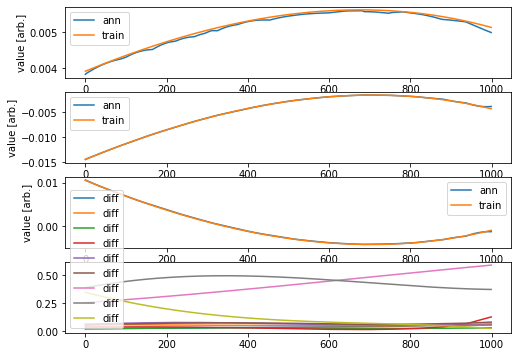

AG
AG


0.002148505130205295


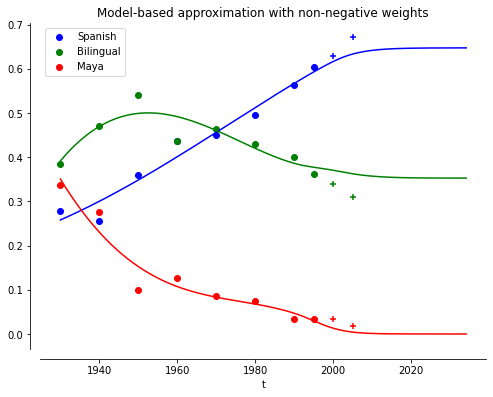

____________________________
Iteración =  14
Min =  0.0015924474378253555
[[1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0]]
[0.002261197076972754, 0.0015924474378253555, 0.0019066273021160238, 0.001882476219109425, 0.002136019487514501]
Epoch 1/500
32/32 - 1s - loss: 1.2399e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 1.7724e-06 - 145ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 4.6929e-07 - 155ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 3.6092e-07 - 151ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 3.3448e-07 - 159ms/epoch - 5ms/step
Epoch 6/500
32/32 - 0s - loss: 3.1165e-07 - 172ms/epoch - 5ms/step
Epoch 7/500
32/32 - 0s - loss: 2.9732e-07 - 128ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 2.8819e-07 - 153ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 2.7748e-07 - 164ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 2.6992e-07 - 134ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6339e-07 

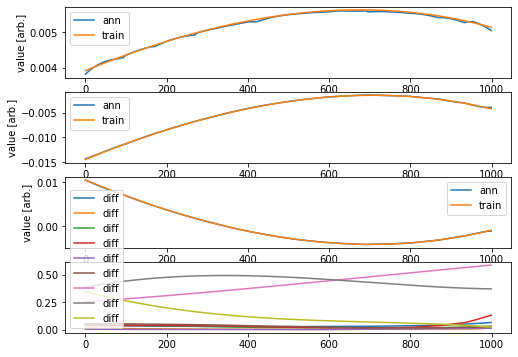

AG
AG


0.0025725410144924465


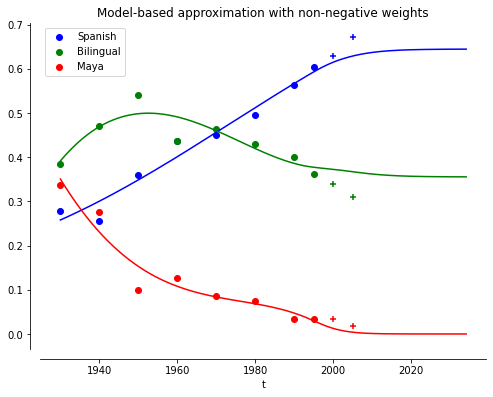

Epoch 1/500
32/32 - 1s - loss: 2.6159e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4700e-05 - 141ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.8745e-06 - 139ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2633e-06 - 124ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0306e-06 - 132ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.7275e-07 - 135ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 7.5013e-07 - 134ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 6.5590e-07 - 134ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 5.8494e-07 - 126ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 5.2861e-07 - 143ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 4.8441e-07 - 131ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 4.5118e-07 - 123ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 4.2493e-07 - 137ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 4.0699e-07 - 132ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.9375e-07 - 131ms/epoch - 

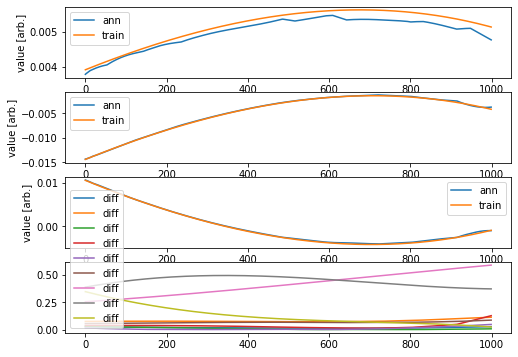

AG
AG


0.0024639031033361876


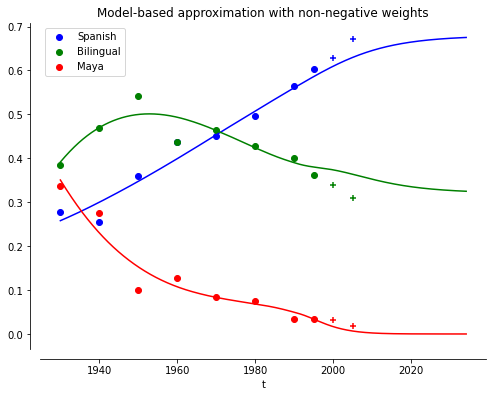

Epoch 1/500
32/32 - 1s - loss: 3.9347e-04 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 5.5029e-06 - 144ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 9.1084e-07 - 156ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 5.4258e-07 - 153ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 5.1453e-07 - 139ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 4.8879e-07 - 140ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 4.6446e-07 - 139ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.4352e-07 - 145ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 4.2514e-07 - 146ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 4.0708e-07 - 126ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.9071e-07 - 128ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.7913e-07 - 144ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.6596e-07 - 132ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 3.6010e-07 - 141ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.4914e-07 - 143ms/epoch - 

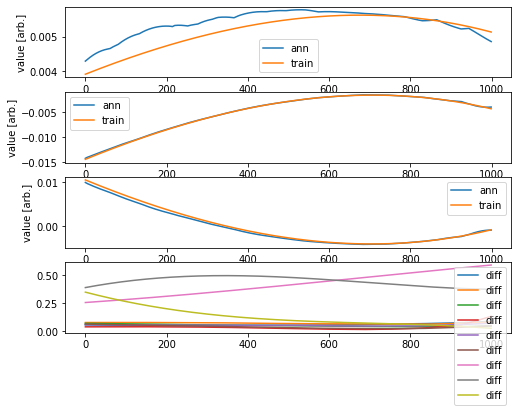

AG
AG


0.0024167629537437743


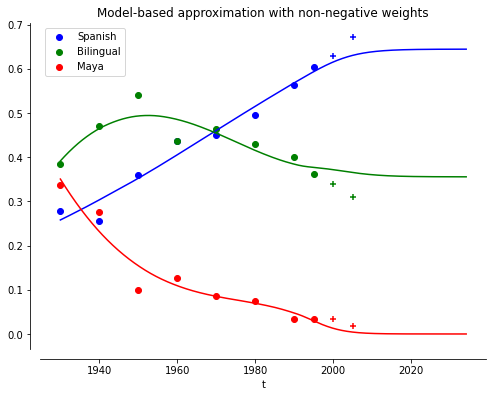

Epoch 1/500
32/32 - 1s - loss: 2.0990e-04 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 6.2789e-06 - 131ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.8458e-06 - 150ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 1.1248e-06 - 138ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 8.2080e-07 - 139ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 6.4751e-07 - 141ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 5.3217e-07 - 138ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.5331e-07 - 131ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.0265e-07 - 140ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6867e-07 - 135ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.4066e-07 - 134ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.2341e-07 - 133ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.0316e-07 - 137ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.8972e-07 - 131ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.8136e-07 - 143ms/epoch - 

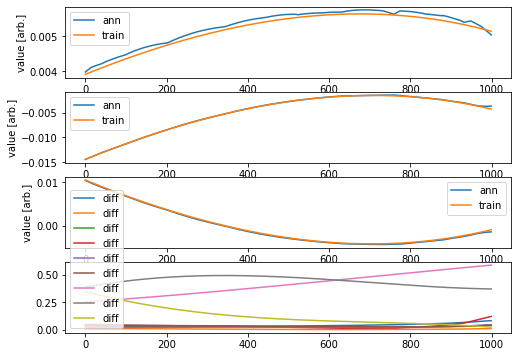

AG
AG


0.002410813790895564


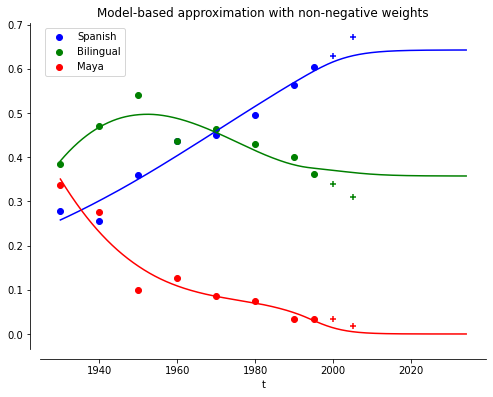

Epoch 1/500
32/32 - 1s - loss: 2.7330e-04 - 1s/epoch - 45ms/step
Epoch 2/500
32/32 - 0s - loss: 6.8165e-06 - 145ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 2.4577e-06 - 133ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3933e-06 - 139ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 9.6375e-07 - 139ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 7.4004e-07 - 128ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 5.9774e-07 - 152ms/epoch - 5ms/step
Epoch 8/500
32/32 - 0s - loss: 5.1022e-07 - 141ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.5374e-07 - 140ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 4.1160e-07 - 136ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.8108e-07 - 137ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.5793e-07 - 134ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.4024e-07 - 151ms/epoch - 5ms/step
Epoch 14/500
32/32 - 0s - loss: 3.1967e-07 - 164ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 3.0252e-07 - 154ms/epoch - 

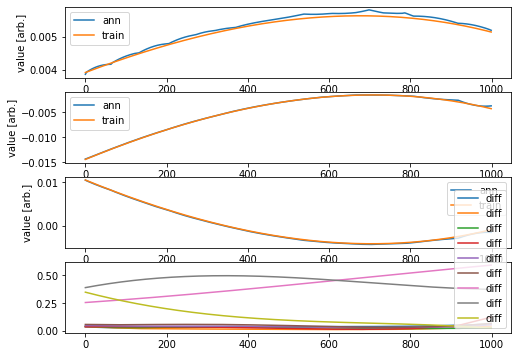

AG
AG


0.0013817254095537348


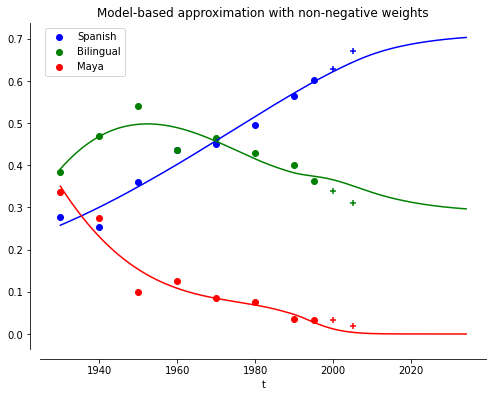

____________________________
Iteración =  15
Min =  0.0015924474378253555
[[1, 0, 1, 1, 0, 0], [1, 1, 0, 1, 0, 0], [1, 1, 0, 1, 0, 1], [1, 0, 1, 1, 0, 0], [1, 0, 1, 1, 0, 0]]
[0.0015924474378253555, 0.0019066273021160238, 0.001882476219109425, 0.002136019487514501, 0.0022491492544043415]


In [ ]:
Mins = []
iters = 5

Kc = 5 # Carrying capacity

for it in range(15):
  print("____________________________")
  print("Iteración = ", it)
  print("Min = ", min(medias))
  Mins.append(min(medias))
  print(Pob)
  print(medias)  

  fl = selection(Pob,medias)[0]
  Pob.append(fl)

  i12,i13,i21,i23,i31,i32 = fl #[0, 1, 1, 1, 0, 0]
  totali = []
  for _ in range(iters):
    total = train3(X,Y,B,dX,dY,dB,mode='2')
    while math.isnan(total):
      total = train3(X,Y,B,dX,dY,dB,mode='2')
    totali.append(total)
  totales.append(totali)
  medias.append(sum(totali)/len(totali))

  lP = len(Pob)

  if lP > Kc:
    maxP = max(medias)
    for pi in range(lP):
      if medias[pi] == maxP:
        medias.remove(medias[pi])
        totales.remove(totales[pi])
        Pob.remove(Pob[pi])
        break
  
print("____________________________")
print("Iteración = ", it+1)
print("Min = ", min(medias))
print(Pob)
print(medias)


In [ ]:
print(totales)

[[0.001606746241628382, 0.0014601229998715585, 0.002290550466557253, 0.0012875353909477289, 0.0013172820901218559], [0.0020371733476371957, 0.0018075133341009676, 0.0023926802692759157, 0.0024195419835114705, 0.0008762275760545686], [0.0013880368385916417, 0.002631526738367072, 0.0022298346836003655, 0.0013183682124931109, 0.0018446146224949348], [0.0019274404156067047, 0.001980367340627882, 0.002598030947007053, 0.0020257536041255694, 0.002148505130205295], [0.0025725410144924465, 0.0024639031033361876, 0.0024167629537437743, 0.002410813790895564, 0.0013817254095537348]]


____________________________
Iteración =  0
Min =  0.0007080179095114976
[[0, 0, 1, 1, 0, 0], [0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 0, 0, 1, 1], [1, 1, 1, 1, 1, 0]]
[0.0020240300174778673, 0.0008204643533100255, 0.0007080179095114976, 0.0011440782807707046, 0.0008271984263875942]
Epoch 1/500
32/32 - 2s - loss: 5.8838e-04 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 6.4244e-06 - 109ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.3454e-06 - 122ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0076e-06 - 127ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 5.0213e-07 - 124ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.9446e-07 - 122ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 2.0611e-07 - 117ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.7056e-07 - 118ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4965e-07 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2972e-07 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1288e-07

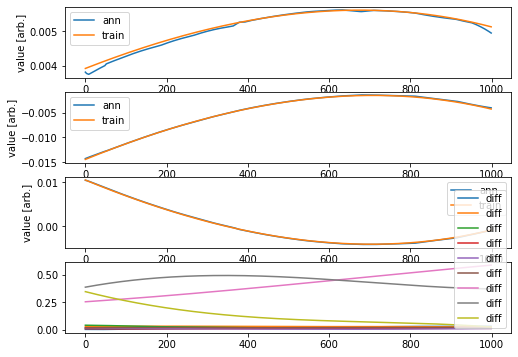

AG


0.000639975803083156


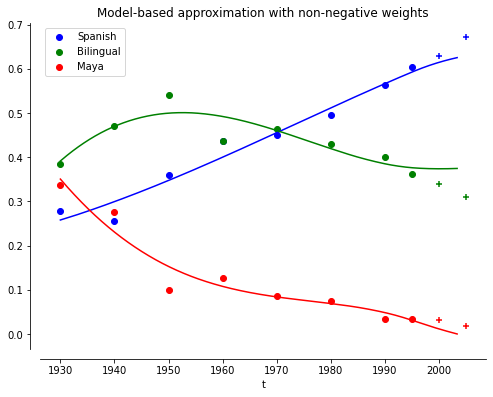

Epoch 1/500
32/32 - 1s - loss: 8.5351e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0480e-05 - 72ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.0316e-06 - 75ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3460e-06 - 78ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0698e-06 - 78ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 8.7369e-07 - 80ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 7.4548e-07 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.3160e-07 - 75ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 5.3848e-07 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.5602e-07 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.8715e-07 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.3076e-07 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.8750e-07 - 78ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.4972e-07 - 82ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.1332e-07 - 75ms/epoch - 2ms/step
Epoch

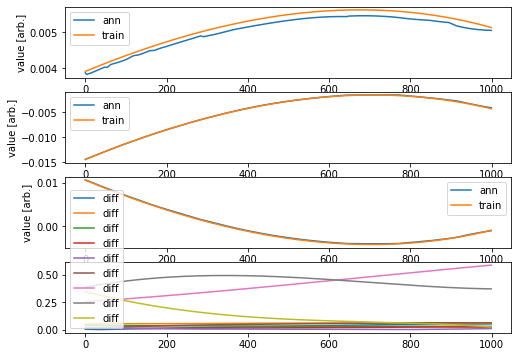

AG
AG


0.00309343919070177


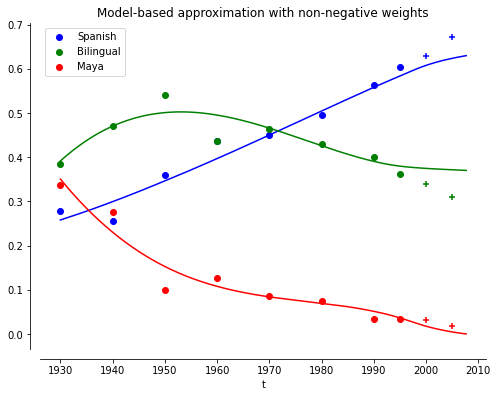

Epoch 1/500
32/32 - 2s - loss: 4.2908e-04 - 2s/epoch - 50ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0858e-05 - 80ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 3.8857e-06 - 67ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.9519e-06 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2665e-06 - 90ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 9.4137e-07 - 79ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 7.2213e-07 - 75ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.8753e-07 - 78ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.6790e-07 - 76ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.7641e-07 - 70ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0647e-07 - 82ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.4454e-07 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.9428e-07 - 73ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 1.5783e-07 - 64ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2817e-07 - 82ms/epoch - 3ms/step
Epoch

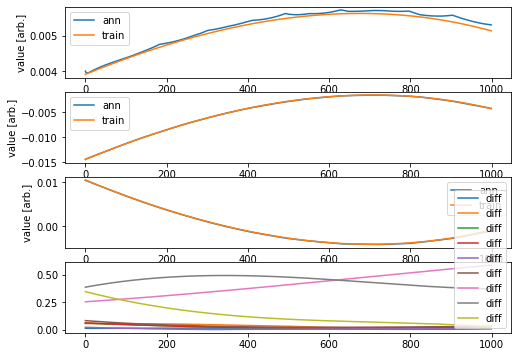

AG


0.0008840259223190421


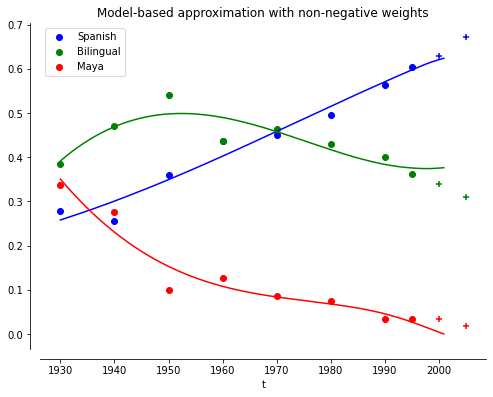

Epoch 1/500
32/32 - 1s - loss: 4.7777e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0799e-05 - 66ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.6026e-06 - 70ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.5430e-06 - 73ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2414e-06 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0100e-06 - 73ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 8.5679e-07 - 76ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 7.0953e-07 - 75ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 5.7928e-07 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.8317e-07 - 85ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.8741e-07 - 77ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.9946e-07 - 86ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.2817e-07 - 80ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.7541e-07 - 74ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.4052e-07 - 79ms/epoch - 2ms/step
Epoch

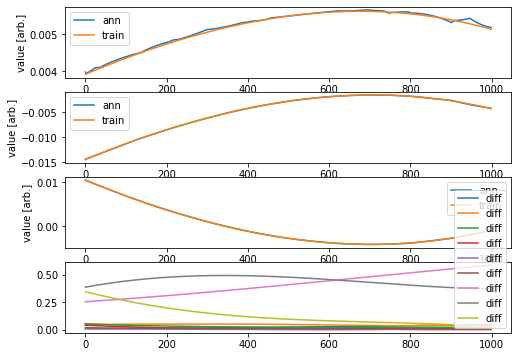

AG
0.0008002000267073882


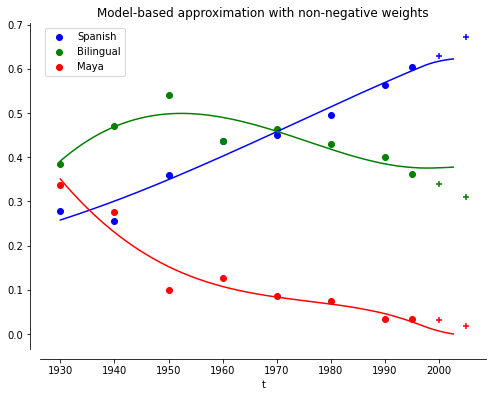

Epoch 1/500
32/32 - 1s - loss: 7.7596e-04 - 1s/epoch - 40ms/step
Epoch 2/500
32/32 - 0s - loss: 2.8729e-05 - 71ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 7.9581e-06 - 78ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 4.4218e-06 - 85ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.4974e-06 - 75ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4881e-06 - 78ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0118e-06 - 94ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.5129e-07 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.0558e-07 - 83ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.1210e-07 - 84ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.4502e-07 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.0356e-07 - 101ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.6701e-07 - 79ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.4204e-07 - 87ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.2455e-07 - 80ms/epoch - 2ms/step
Epoc

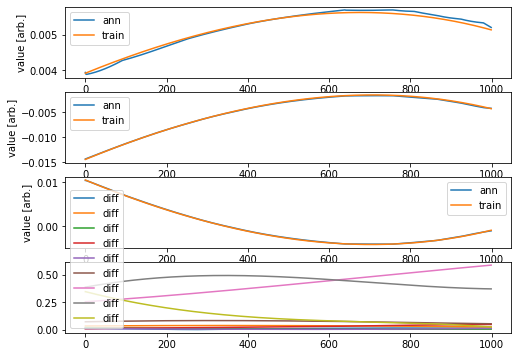

AG


0.0008020104823026851


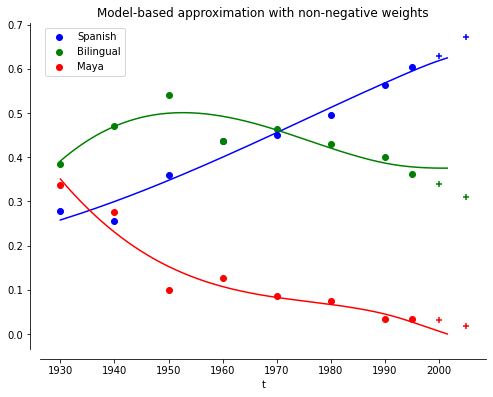

____________________________
Iteración =  1
Min =  0.0007080179095114976
[[0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 0, 0, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 1, 0, 1, 0]]
[0.0008204643533100255, 0.0007080179095114976, 0.0011440782807707046, 0.0008271984263875942, 0.0012439302850228084]
Epoch 1/500
32/32 - 1s - loss: 7.2522e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 5.6972e-06 - 75ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2674e-06 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 8.3906e-07 - 93ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.2395e-07 - 75ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.7824e-07 - 77ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 4.0444e-07 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.6231e-07 - 79ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.3318e-07 - 87ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1371e-07 - 82ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9196e-07 - 77ms/

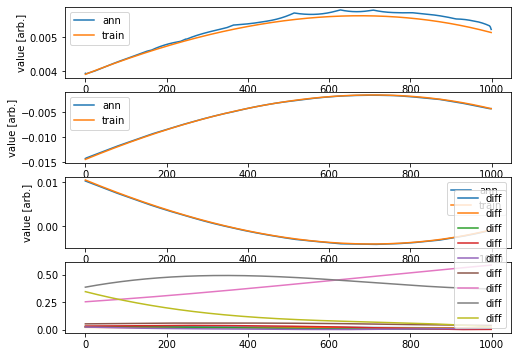

AG


0.0008292066889573189


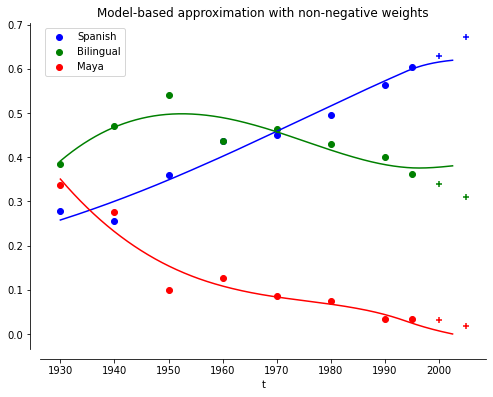

Epoch 1/500
32/32 - 1s - loss: 3.8690e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 3.7428e-06 - 79ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 5.9470e-07 - 72ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 3.3815e-07 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.9823e-07 - 92ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.7851e-07 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.6050e-07 - 81ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.4548e-07 - 80ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.3254e-07 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.2120e-07 - 82ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.0976e-07 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.9877e-07 - 79ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 1.8911e-07 - 77ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8247e-07 - 79ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.7102e-07 - 82ms/epoch - 3ms/step
Epoch

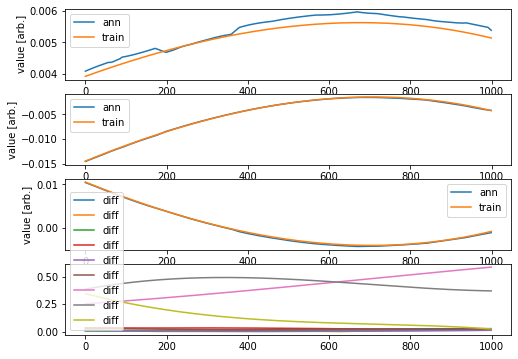

3.555901207925165e-08


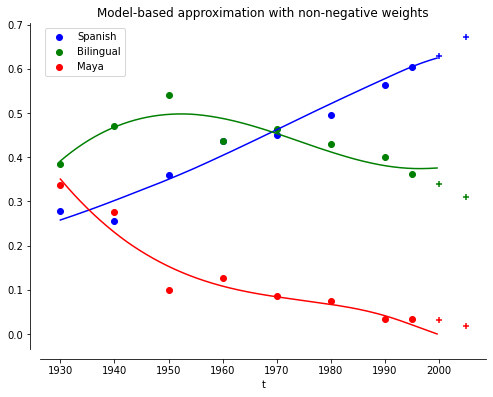

Epoch 1/500
32/32 - 1s - loss: 8.1008e-05 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 2.5611e-06 - 72ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 7.6073e-07 - 80ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 4.2487e-07 - 78ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 3.0937e-07 - 82ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.5023e-07 - 79ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 2.0432e-07 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.7166e-07 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4845e-07 - 101ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3127e-07 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.2337e-07 - 90ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0680e-07 - 83ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.7867e-08 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.6976e-08 - 74ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 7.9562e-08 - 91ms/epoch - 3ms/step
Epoc

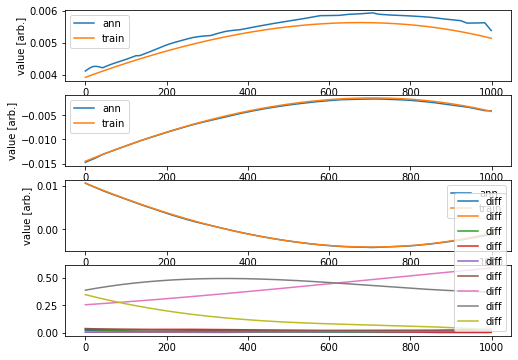

3.2718918484425683e-08


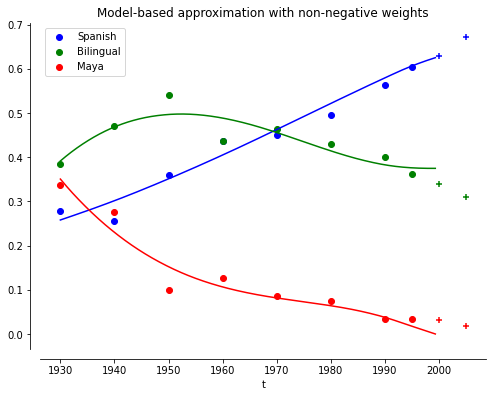

Epoch 1/500
32/32 - 1s - loss: 5.7292e-04 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4324e-05 - 86ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.6550e-07 - 99ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.7143e-07 - 105ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7785e-07 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4039e-07 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1986e-07 - 105ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0576e-07 - 81ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.6187e-08 - 92ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.9341e-08 - 110ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.2354e-08 - 135ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 7.7131e-08 - 114ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 7.2357e-08 - 114ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 7.0043e-08 - 121ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 6.4583e-08 - 125ms/epoch - 4ms/st

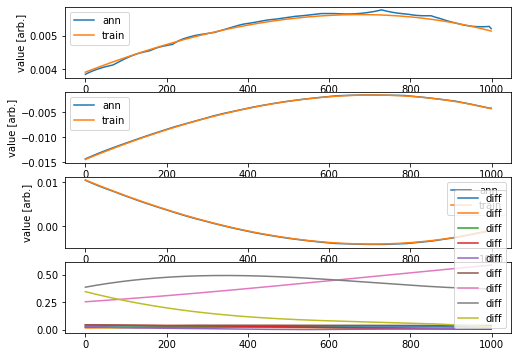

AG


0.000642775730886701


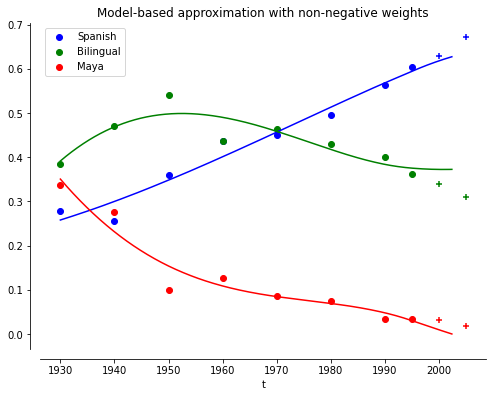

Epoch 1/500
32/32 - 1s - loss: 0.0010 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 1.9326e-05 - 83ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.1417e-06 - 81ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3718e-06 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.1817e-06 - 82ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0433e-06 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.5569e-07 - 84ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.9007e-07 - 82ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.2941e-07 - 79ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 7.8458e-07 - 94ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.4156e-07 - 84ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.9497e-07 - 80ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 6.6250e-07 - 97ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.2370e-07 - 84ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.9208e-07 - 79ms/epoch - 2ms/step
Epoch 16/

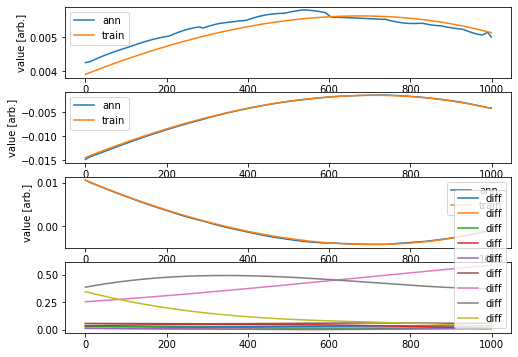

AG


0.0007533167699498672


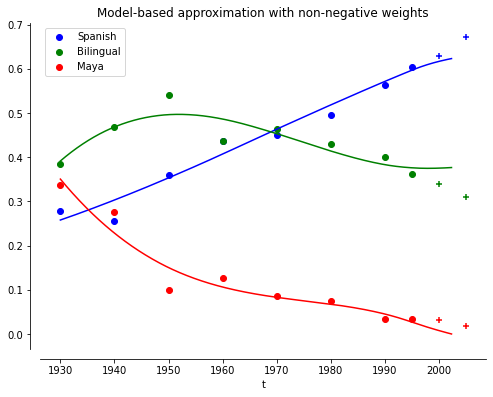

____________________________
Iteración =  2
Min =  0.0004450734935448902
[[0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 0, 0, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0]]
[0.0008204643533100255, 0.0007080179095114976, 0.0011440782807707046, 0.0008271984263875942, 0.0004450734935448902]
Epoch 1/500
32/32 - 1s - loss: 1.9032e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 5.5779e-06 - 86ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.9260e-06 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.1025e-06 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.4357e-07 - 81ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.6310e-07 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.3891e-07 - 94ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.5125e-07 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.8833e-07 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.4367e-07 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1811e-07 - 101ms

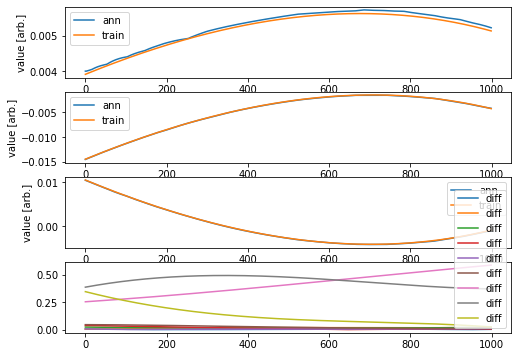

AG


0.0007694197451703377


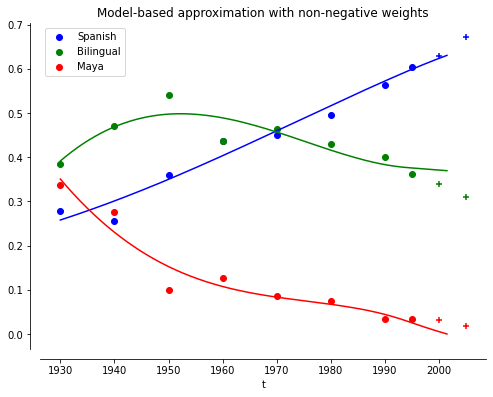

Epoch 1/500
32/32 - 1s - loss: 2.7012e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 2.3530e-06 - 86ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.8874e-07 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.4054e-07 - 83ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.0809e-07 - 82ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8629e-07 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.7238e-07 - 112ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.5986e-07 - 96ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4876e-07 - 84ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3814e-07 - 82ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.2711e-07 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.1893e-07 - 84ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.1112e-07 - 111ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0571e-07 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 9.8549e-08 - 91ms/epoch - 3ms/step
Epo

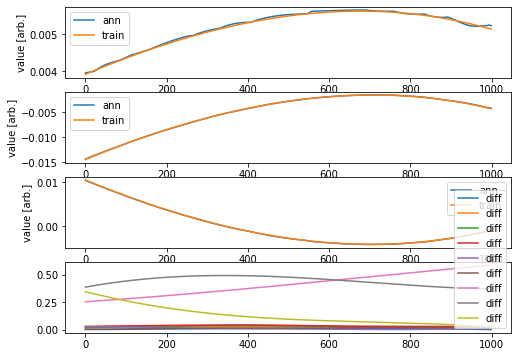

AG
AG


0.0020115939176953306


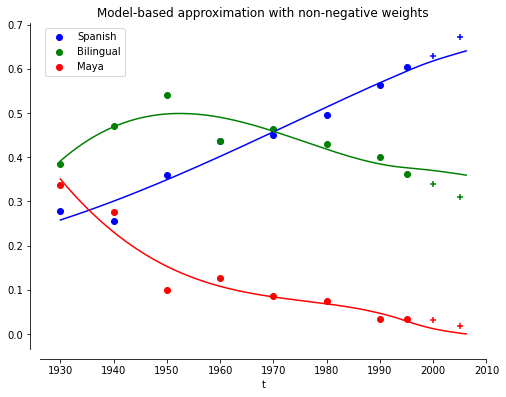

Epoch 1/500
32/32 - 1s - loss: 6.3149e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 9.5683e-06 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.8862e-06 - 77ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0233e-06 - 84ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.6983e-07 - 97ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9618e-07 - 79ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 7.3109e-07 - 93ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.7622e-07 - 100ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.1599e-07 - 92ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.5598e-07 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.0055e-07 - 90ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.5257e-07 - 105ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.0668e-07 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.6215e-07 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.2794e-07 - 97ms/epoch - 3ms/step
Epo

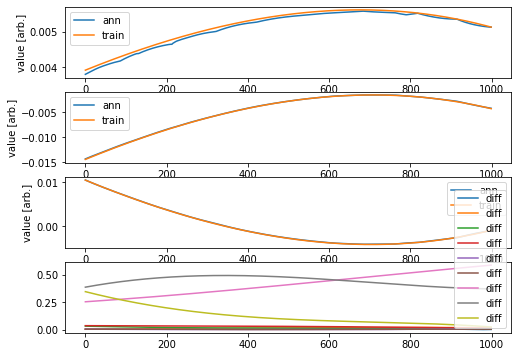

AG


0.0006821790934889336


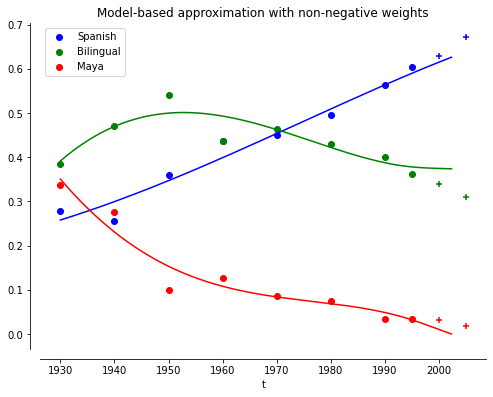

Epoch 1/500
32/32 - 1s - loss: 7.7849e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 1.4750e-05 - 86ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7121e-06 - 99ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 9.8795e-07 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.1454e-07 - 87ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.9333e-07 - 81ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.3593e-07 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.9645e-07 - 92ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.4282e-07 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.8534e-07 - 82ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.4564e-07 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.9262e-07 - 93ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.5957e-07 - 93ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.1381e-07 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.6685e-07 - 91ms/epoch - 3ms/step
Epoch

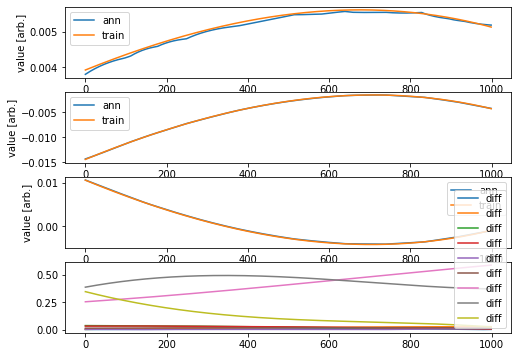

AG


0.0006977839660272023


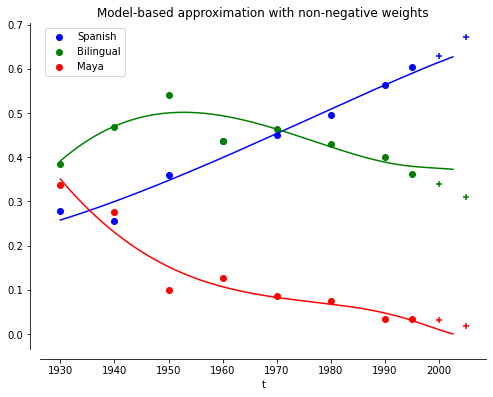

Epoch 1/500
32/32 - 1s - loss: 0.0017 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2726e-05 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.4852e-06 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6285e-06 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.3642e-06 - 96ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.1466e-06 - 85ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.8767e-07 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.5569e-07 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.9361e-07 - 122ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 7.4784e-07 - 80ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 7.0722e-07 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.8027e-07 - 85ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.5629e-07 - 94ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.3200e-07 - 93ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.1197e-07 - 83ms/epoch - 3ms/step
Epoch 16

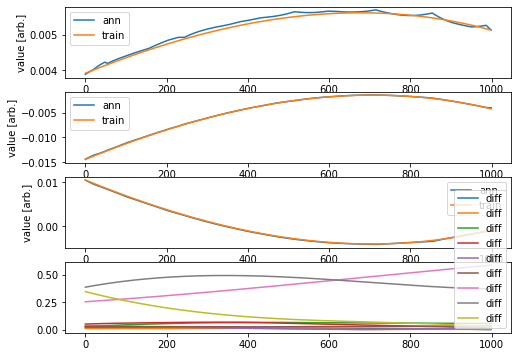

AG


0.0005972201239764306


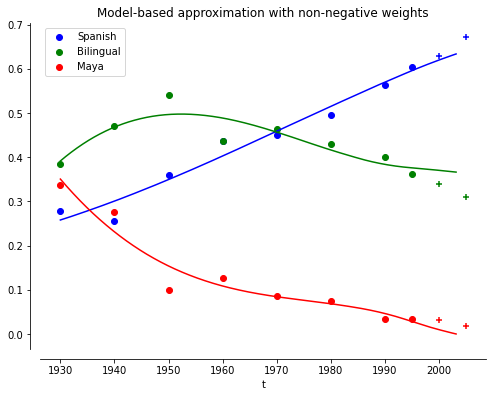

____________________________
Iteración =  3
Min =  0.0004450734935448902
[[0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [1, 1, 0, 1, 1, 0]]
[0.0008204643533100255, 0.0007080179095114976, 0.0008271984263875942, 0.0004450734935448902, 0.0009516393692716469]
Epoch 1/500
32/32 - 2s - loss: 9.8783e-04 - 2s/epoch - 50ms/step
Epoch 2/500
32/32 - 0s - loss: 1.9661e-05 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.3471e-06 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.9519e-07 - 109ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.9641e-07 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.4651e-07 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.0687e-07 - 84ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.7507e-07 - 98ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.4780e-07 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.2666e-07 - 93ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.0230e-07 - 89ms

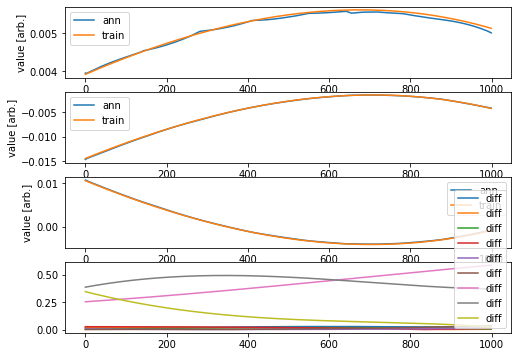

AG


0.0008175732980650141


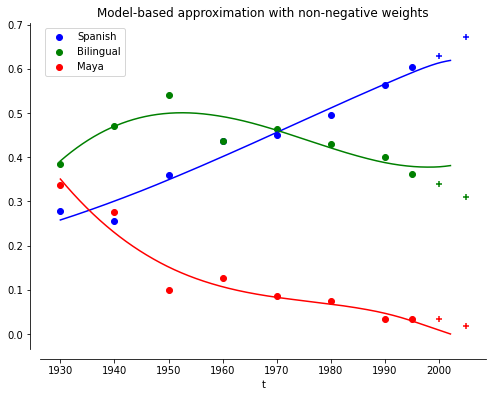

Epoch 1/500
32/32 - 1s - loss: 0.0011 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2758e-05 - 97ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.4450e-06 - 100ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3303e-06 - 88ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.6210e-07 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.5493e-07 - 96ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.0570e-07 - 102ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.8942e-07 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.0547e-07 - 86ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.5248e-07 - 93ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0972e-07 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8136e-07 - 102ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.5746e-07 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.2876e-07 - 86ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0658e-07 - 83ms/epoch - 3ms/step
Epoch 

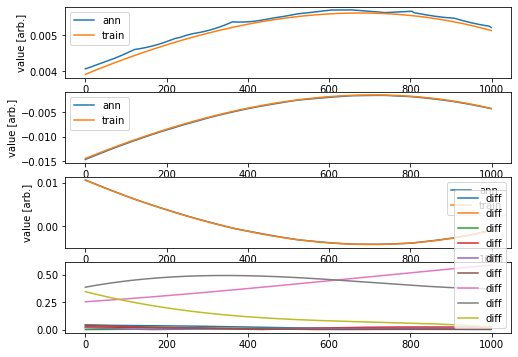

1.7261603254057985e-08


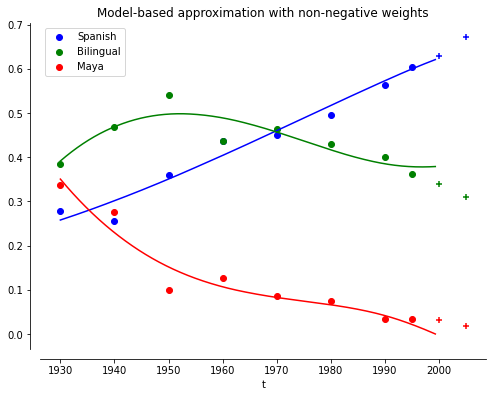

Epoch 1/500
32/32 - 2s - loss: 0.0015 - 2s/epoch - 54ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0383e-05 - 101ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.1214e-06 - 108ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.0226e-07 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.4004e-07 - 100ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.7719e-07 - 104ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.3504e-07 - 111ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.9694e-07 - 105ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.6508e-07 - 108ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3791e-07 - 101ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1529e-07 - 105ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.9576e-07 - 105ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.8274e-07 - 122ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.7206e-07 - 118ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.6315e-07 - 100ms/epoch - 3ms/

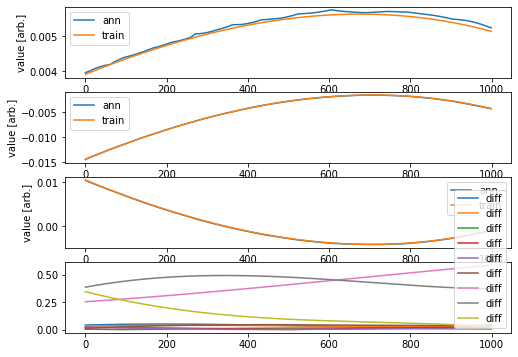

AG


0.0008737871090929233


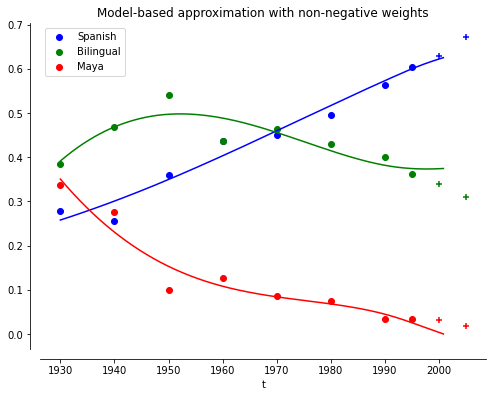

Epoch 1/500
32/32 - 1s - loss: 6.7900e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 4.1552e-06 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0250e-06 - 94ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.2488e-07 - 120ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 5.9634e-07 - 100ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.1433e-07 - 102ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.3685e-07 - 100ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.7133e-07 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.2242e-07 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.7424e-07 - 88ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.2956e-07 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.9057e-07 - 109ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.5878e-07 - 103ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.4042e-07 - 99ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2486e-07 - 95ms/epoch - 3ms/step

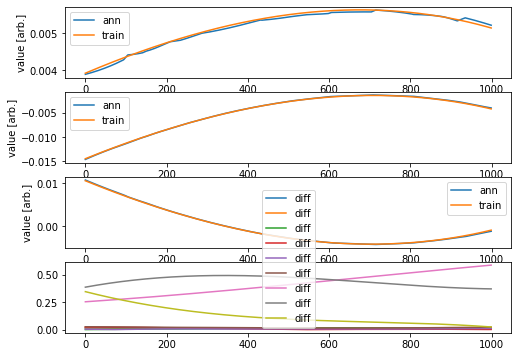

AG
0.0006343979420949666


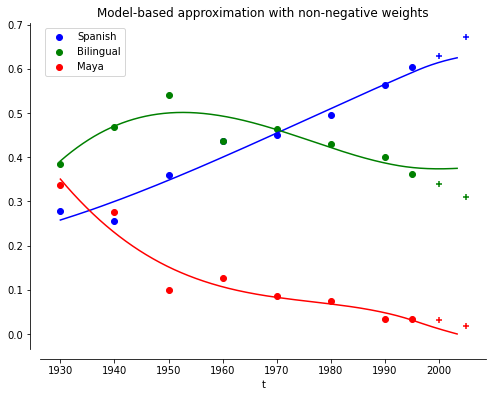

Epoch 1/500
32/32 - 2s - loss: 7.0118e-04 - 2s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0123e-05 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0526e-06 - 111ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 8.1127e-07 - 104ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.3592e-07 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.7826e-07 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.3189e-07 - 101ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.8994e-07 - 91ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.6132e-07 - 97ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.2580e-07 - 97ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.0126e-07 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.7387e-07 - 101ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.4821e-07 - 101ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.2355e-07 - 101ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.9771e-07 - 106ms/epoch - 3ms/st

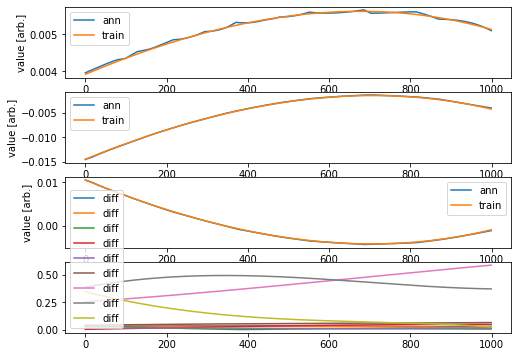

AG


0.0007771855322898305


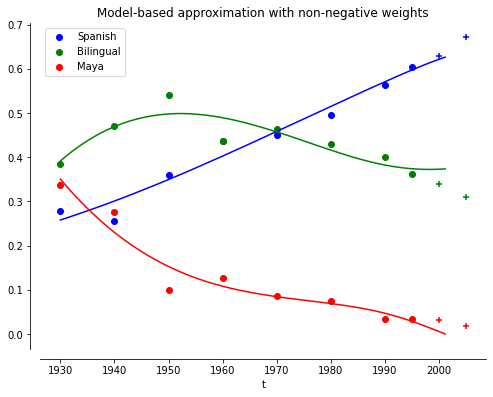

____________________________
Iteración =  4
Min =  0.0004450734935448902
[[0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [0, 1, 1, 1, 1, 0]]
[0.0008204643533100255, 0.0007080179095114976, 0.0008271984263875942, 0.0004450734935448902, 0.0006205922286291976]
Epoch 1/500
32/32 - 1s - loss: 8.2488e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 3.8709e-05 - 97ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.3018e-06 - 96ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 3.5687e-06 - 95ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.3099e-06 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.6900e-06 - 95ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3449e-06 - 120ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1298e-06 - 94ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.7419e-07 - 91ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.6096e-07 - 95ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.7454e-07 - 96ms

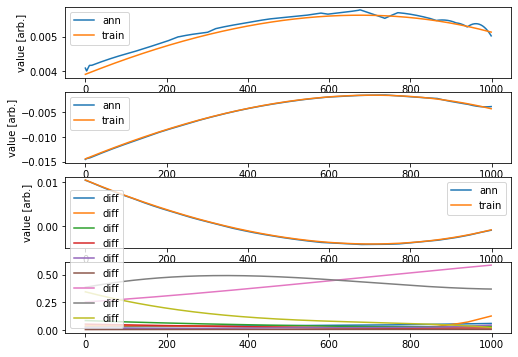

AG
AG


0.004251611654185334


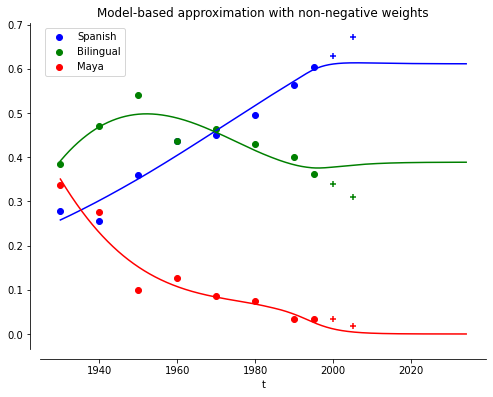

Epoch 1/500
32/32 - 1s - loss: 1.7989e-04 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 4.7770e-06 - 113ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.3828e-06 - 107ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6361e-06 - 120ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.1828e-06 - 125ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 9.0663e-07 - 112ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 7.3127e-07 - 111ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.1725e-07 - 106ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.3490e-07 - 110ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.7968e-07 - 108ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.4341e-07 - 99ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.1375e-07 - 113ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.8955e-07 - 96ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.7094e-07 - 113ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.4913e-07 - 100ms/epoch - 3m

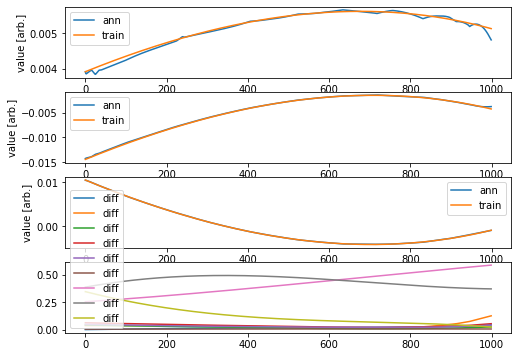

AG
AG


0.0034294025339489543


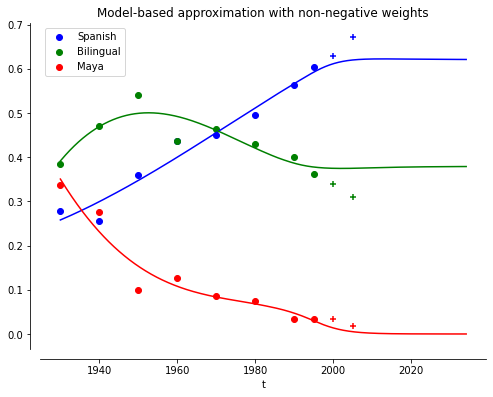

Epoch 1/500
32/32 - 1s - loss: 3.0621e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 7.6787e-06 - 107ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7702e-06 - 105ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2714e-06 - 104ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0317e-06 - 107ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.6231e-07 - 105ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.3677e-07 - 108ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.4419e-07 - 99ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.7491e-07 - 111ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.2510e-07 - 101ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.8680e-07 - 101ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.5437e-07 - 109ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.2768e-07 - 112ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.0630e-07 - 102ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.8872e-07 - 118ms/epoch - 4

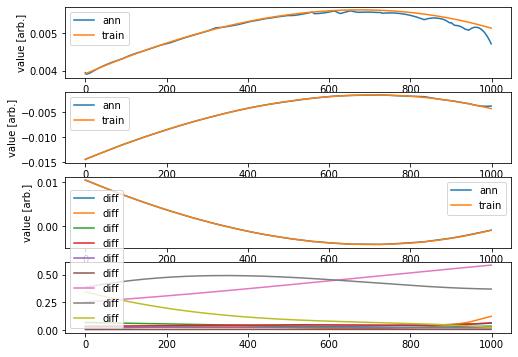

AG
AG


0.0034056713081935136


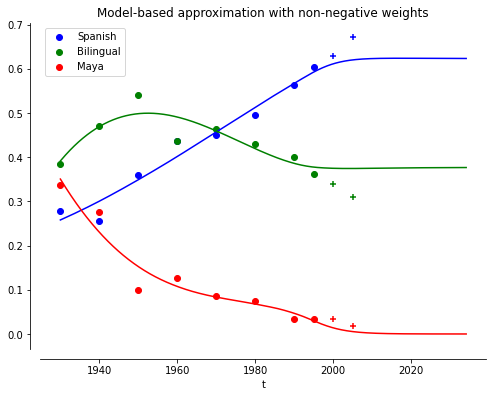

Epoch 1/500
32/32 - 1s - loss: 1.1491e-04 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 5.1759e-06 - 115ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.7810e-06 - 113ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.9201e-06 - 125ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.3550e-06 - 109ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 9.6521e-07 - 110ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.0627e-07 - 124ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.2690e-07 - 120ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.1439e-07 - 105ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.4280e-07 - 119ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9699e-07 - 110ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6728e-07 - 135ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.4954e-07 - 120ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.3579e-07 - 123ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2326e-07 - 108ms/epoch - 

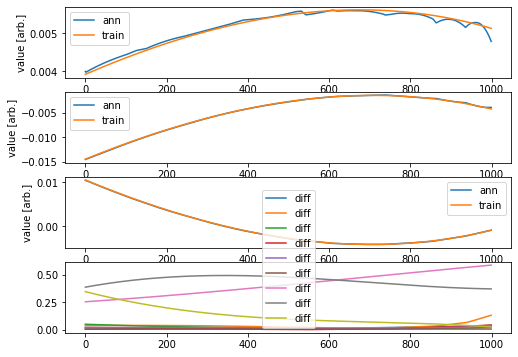

AG
AG


0.0037538902475714843


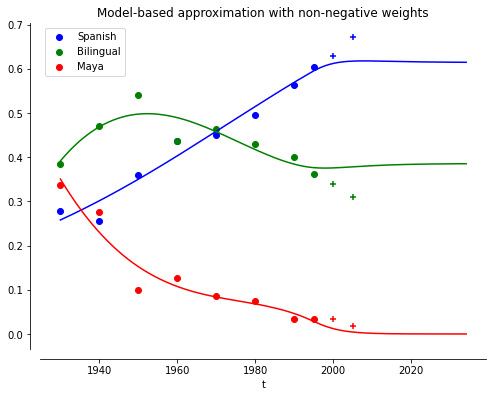

Epoch 1/500
32/32 - 1s - loss: 8.9577e-04 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 2.9986e-05 - 116ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 4.1418e-06 - 112ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.4900e-06 - 120ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 2.1086e-06 - 110ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8018e-06 - 120ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5475e-06 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.3209e-06 - 109ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.1425e-06 - 116ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0143e-06 - 122ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 9.1128e-07 - 113ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 8.2021e-07 - 104ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.4071e-07 - 108ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.7125e-07 - 131ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 6.1158e-07 - 112ms/epoch - 3

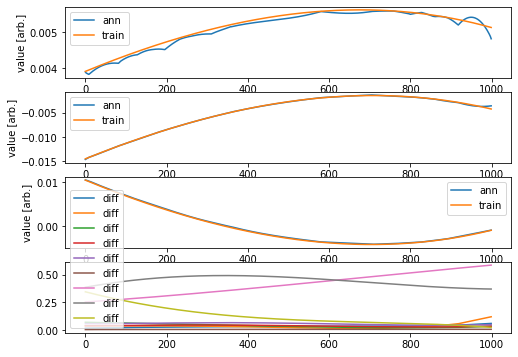

AG
AG


0.003766842554632459


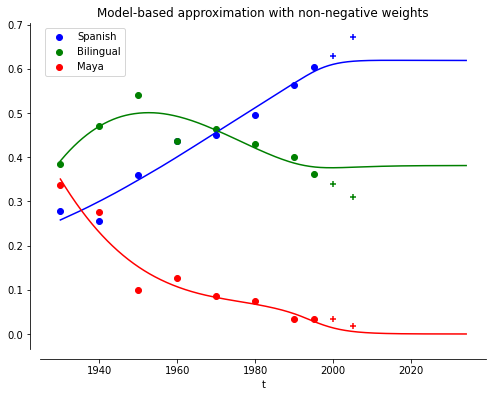

____________________________
Iteración =  5
Min =  0.0004450734935448902
[[0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [0, 1, 1, 1, 1, 0]]
[0.0008204643533100255, 0.0007080179095114976, 0.0008271984263875942, 0.0004450734935448902, 0.0006205922286291976]
Epoch 1/500
32/32 - 1s - loss: 0.0018 - 1s/epoch - 42ms/step
Epoch 2/500
32/32 - 0s - loss: 4.4601e-05 - 113ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0213e-05 - 112ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 4.3527e-06 - 116ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.9244e-06 - 122ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.1013e-06 - 124ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 8.4238e-07 - 126ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 7.2567e-07 - 106ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.4961e-07 - 126ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 5.9791e-07 - 126ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 5.6578e-07 - 

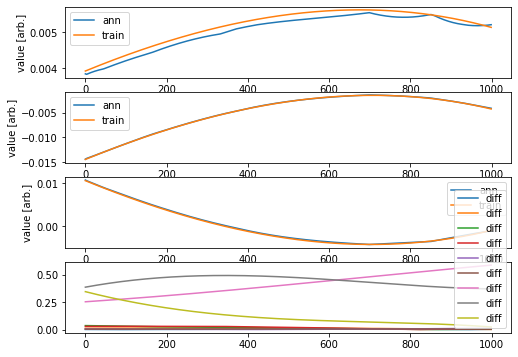

AG


0.0007328353753237681


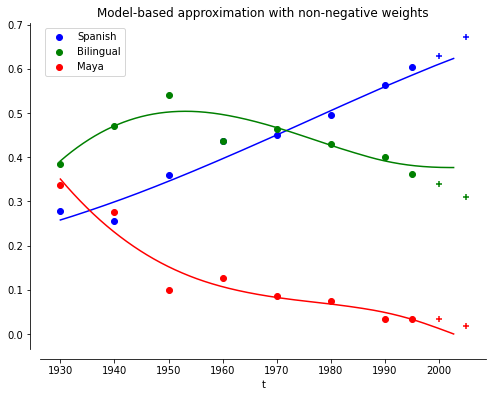

Epoch 1/500
32/32 - 1s - loss: 0.0010 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 9.8613e-06 - 121ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.9777e-06 - 115ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.7383e-06 - 123ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2620e-06 - 115ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 9.4610e-07 - 123ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 7.3763e-07 - 120ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.7857e-07 - 128ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.5317e-07 - 123ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.7049e-07 - 112ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.1121e-07 - 109ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6567e-07 - 113ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.3416e-07 - 116ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.0053e-07 - 117ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.7888e-07 - 125ms/epoch - 4ms/

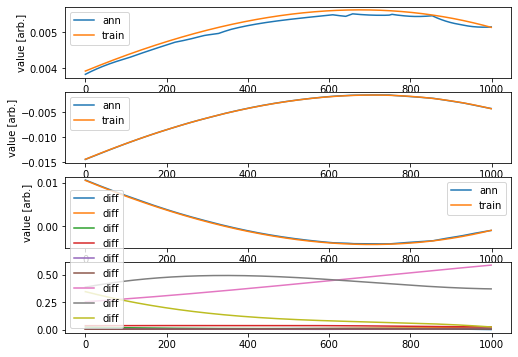

AG


0.0006627385444956569


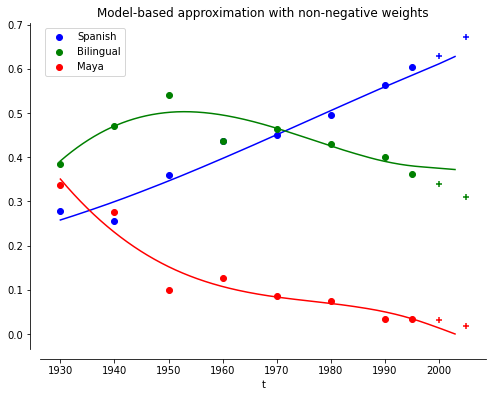

Epoch 1/500
32/32 - 1s - loss: 8.8732e-04 - 1s/epoch - 40ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2174e-05 - 128ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.4628e-06 - 114ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.7821e-06 - 116ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4496e-06 - 109ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.1867e-06 - 113ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 9.7404e-07 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.0740e-07 - 106ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.7274e-07 - 124ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 5.6558e-07 - 116ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 4.8915e-07 - 114ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 4.2276e-07 - 114ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.6204e-07 - 127ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 3.1796e-07 - 113ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.8157e-07 - 118ms/epoch - 4

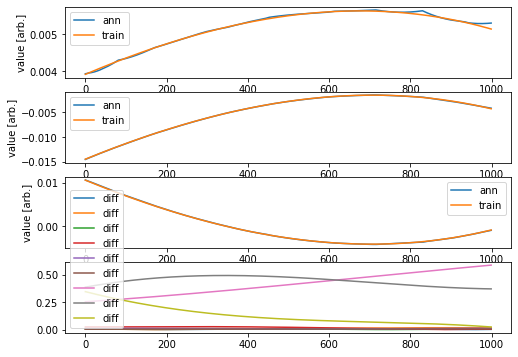

AG


0.0007154077433149297


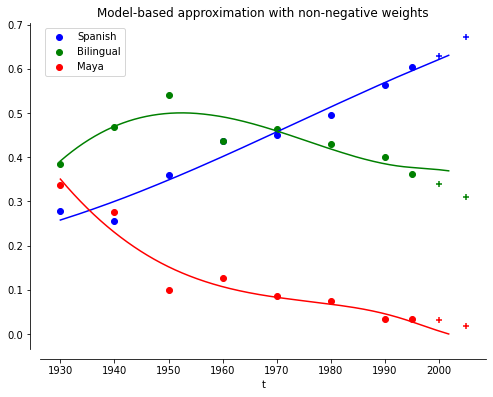

Epoch 1/500
32/32 - 1s - loss: 0.0012 - 1s/epoch - 40ms/step
Epoch 2/500
32/32 - 0s - loss: 1.8668e-05 - 126ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 2.6792e-06 - 124ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.5725e-06 - 107ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.1642e-06 - 108ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 9.0496e-07 - 117ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 7.4122e-07 - 116ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 6.2996e-07 - 114ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 5.7161e-07 - 108ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.2547e-07 - 104ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.9363e-07 - 118ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 4.7092e-07 - 108ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.4313e-07 - 114ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 4.2326e-07 - 115ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.0133e-07 - 106ms/epoch - 3ms/

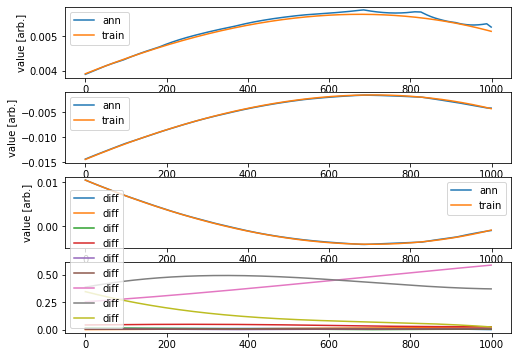

AG


0.0008275955546252044


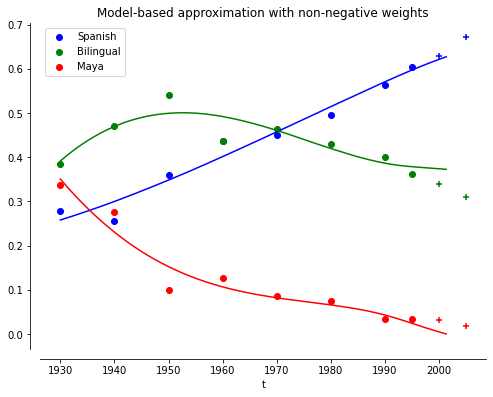

Epoch 1/500
32/32 - 1s - loss: 0.0013 - 1s/epoch - 40ms/step
Epoch 2/500
32/32 - 0s - loss: 4.6847e-05 - 117ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 8.8572e-06 - 122ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 4.5641e-06 - 114ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 3.5037e-06 - 118ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.9799e-06 - 120ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 2.6194e-06 - 110ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.3455e-06 - 131ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.1084e-06 - 103ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.9087e-06 - 107ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.7242e-06 - 100ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.5606e-06 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.4030e-06 - 106ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.2731e-06 - 126ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.1582e-06 - 144ms/epoch - 4ms/s

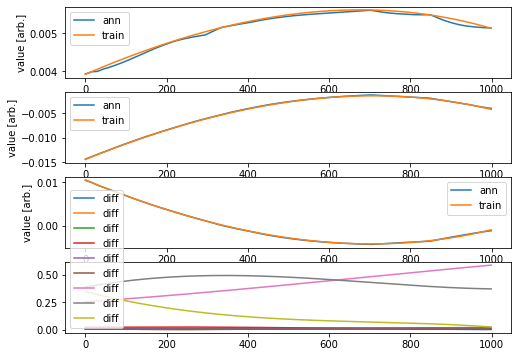

AG


AG
0.0013559389869372248


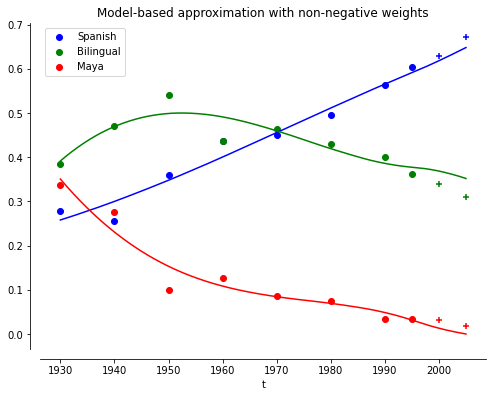

____________________________
Iteración =  6
Min =  0.0004450734935448902
[[0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [0, 1, 1, 1, 1, 0]]
[0.0008204643533100255, 0.0007080179095114976, 0.0008271984263875942, 0.0004450734935448902, 0.0006205922286291976]
Epoch 1/500
32/32 - 1s - loss: 1.4285e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 3.5496e-06 - 123ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.3966e-06 - 123ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 8.7215e-07 - 102ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.4271e-07 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.0656e-07 - 111ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.4809e-07 - 108ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.1104e-07 - 108ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.8048e-07 - 118ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.5567e-07 - 116ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.3668e-0

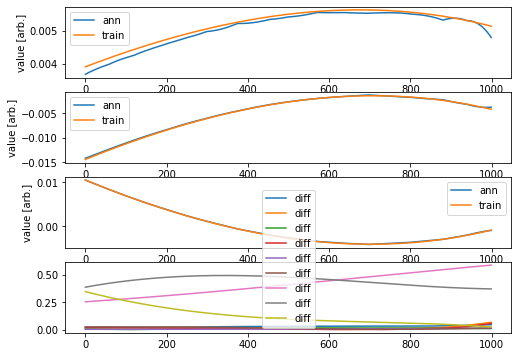

AG
AG


0.0035301848102514727


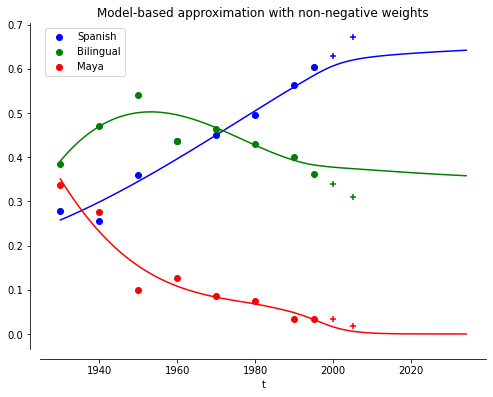

Epoch 1/500
32/32 - 1s - loss: 3.4626e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 8.3111e-06 - 102ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 9.7671e-07 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.6538e-07 - 116ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 5.8635e-07 - 128ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 5.3716e-07 - 126ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 4.9600e-07 - 108ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.5917e-07 - 105ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.2513e-07 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.9404e-07 - 103ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.6458e-07 - 102ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.3843e-07 - 107ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.1476e-07 - 108ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.9462e-07 - 113ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.7580e-07 - 106ms/epoch - 3m

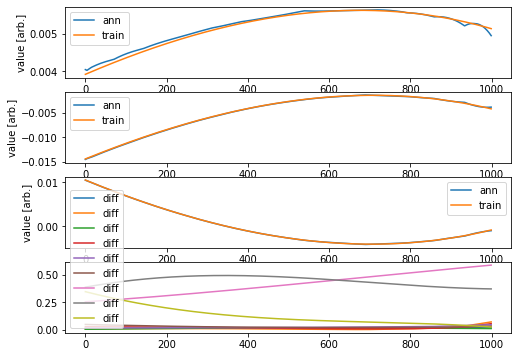

AG
AG


0.0022740232507754495


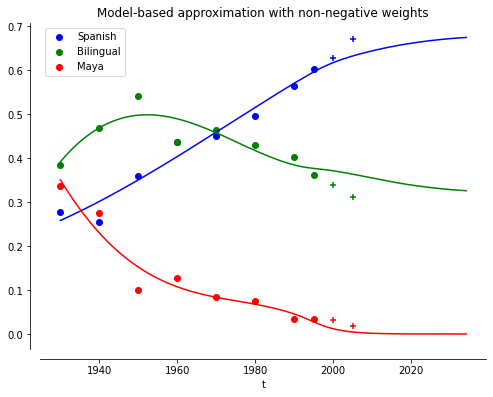

Epoch 1/500
32/32 - 1s - loss: 3.1291e-04 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6733e-05 - 103ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 5.1700e-06 - 112ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.1958e-06 - 118ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 5.7066e-07 - 87ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.0512e-07 - 116ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 3.5967e-07 - 118ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 3.3713e-07 - 107ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.2046e-07 - 106ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.0784e-07 - 103ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9623e-07 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8292e-07 - 96ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.7377e-07 - 101ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.6412e-07 - 104ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5618e-07 - 118ms/epoch - 4ms

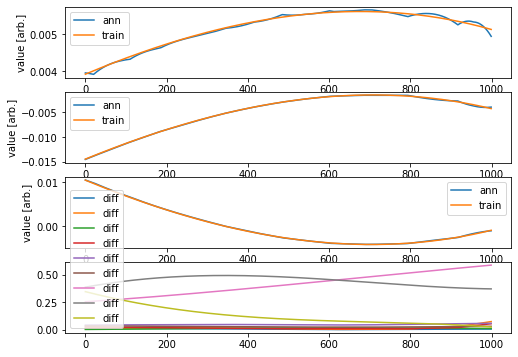

AG
AG


0.002962940534395035


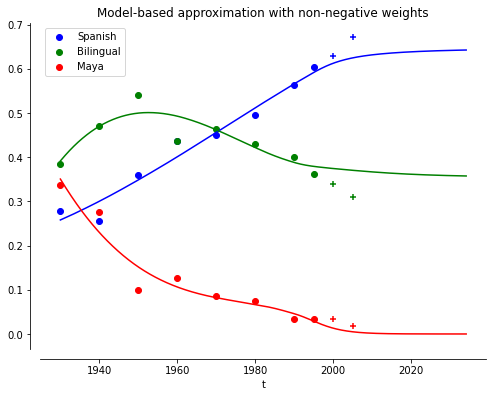

Epoch 1/500
32/32 - 1s - loss: 9.7491e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 1.5150e-05 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.9696e-06 - 107ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.7825e-06 - 116ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.5517e-06 - 114ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.6879e-07 - 116ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 5.5589e-07 - 131ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.3311e-07 - 118ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 3.8105e-07 - 111ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.4803e-07 - 102ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.2559e-07 - 119ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 3.0974e-07 - 120ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.9931e-07 - 122ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.9278e-07 - 112ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.8809e-07 - 120ms/epoch - 4

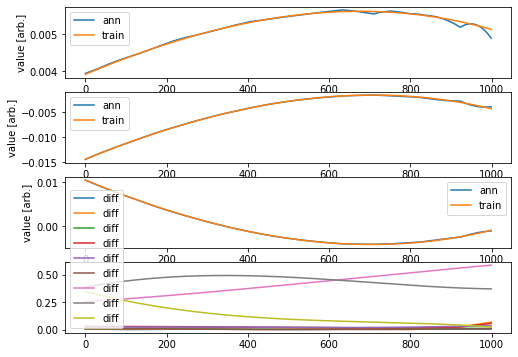

AG
AG


0.003039880207414328


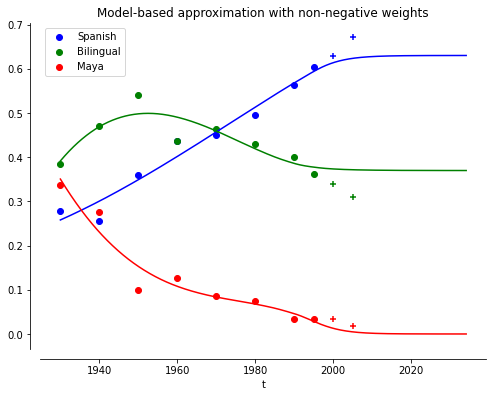

Epoch 1/500
32/32 - 1s - loss: 1.5486e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 4.6054e-06 - 102ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.4066e-07 - 117ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 4.6836e-07 - 142ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 4.0934e-07 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.7461e-07 - 110ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.4496e-07 - 104ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.2198e-07 - 101ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.9981e-07 - 97ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.7986e-07 - 119ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6366e-07 - 106ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.4890e-07 - 111ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.3702e-07 - 141ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.2475e-07 - 100ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.1585e-07 - 99ms/epoch - 3m

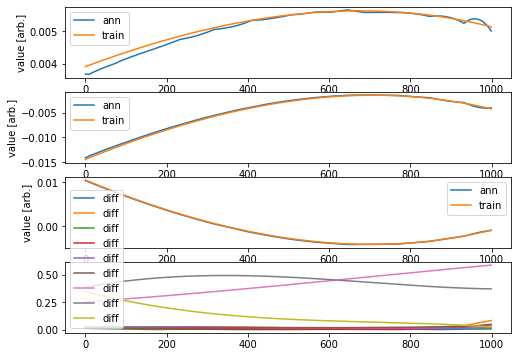

AG
AG


0.0028295895403351186


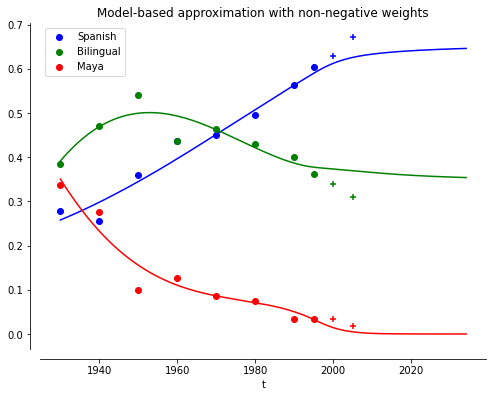

____________________________
Iteración =  7
Min =  0.0004450734935448902
[[0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [0, 1, 1, 1, 1, 0]]
[0.0008204643533100255, 0.0007080179095114976, 0.0008271984263875942, 0.0004450734935448902, 0.0006205922286291976]
Epoch 1/500
32/32 - 1s - loss: 2.7963e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 7.7979e-06 - 101ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.8995e-06 - 105ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.1732e-06 - 124ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7798e-06 - 105ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.5411e-06 - 110ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.3668e-06 - 132ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.2337e-06 - 96ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0997e-06 - 119ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 8.6425e-07 - 112ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.2288e-07

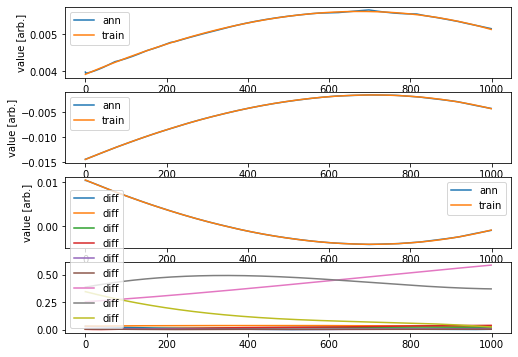

AG


0.0007860819915089963


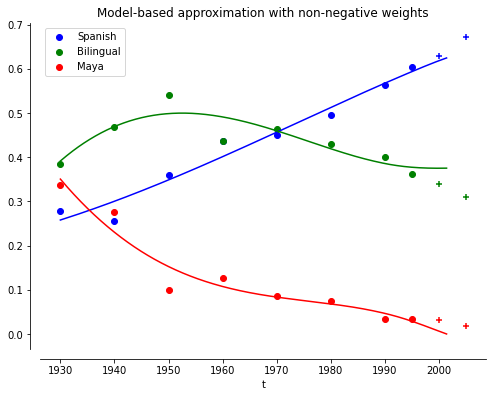

Epoch 1/500
32/32 - 1s - loss: 3.6084e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 3.6911e-06 - 97ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 9.0611e-07 - 123ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 6.3865e-07 - 107ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.2430e-07 - 103ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.4004e-07 - 104ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.7893e-07 - 111ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.2371e-07 - 113ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.7965e-07 - 119ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 2.4993e-07 - 102ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.2644e-07 - 98ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.0608e-07 - 113ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.9043e-07 - 96ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8168e-07 - 109ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.6191e-07 - 108ms/epoch - 3ms

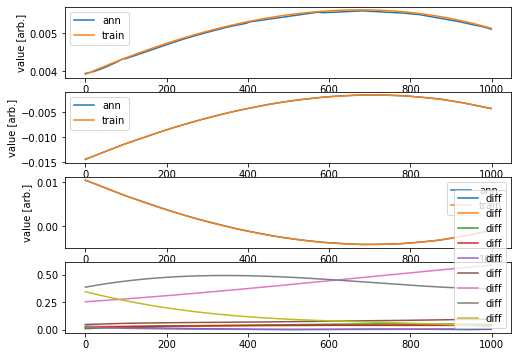

AG


0.0006168371363474101


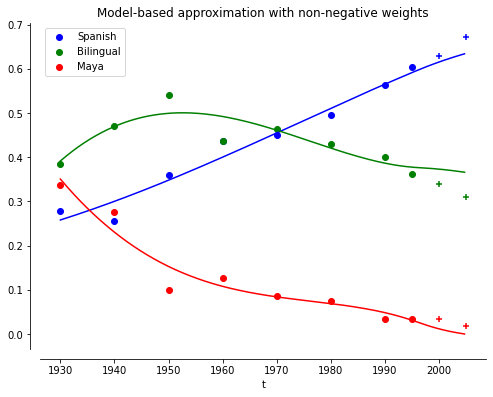

Epoch 1/500
32/32 - 1s - loss: 5.3045e-04 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 9.1360e-06 - 115ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 4.0992e-06 - 106ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.6062e-06 - 108ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.9460e-06 - 122ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4901e-06 - 107ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1193e-06 - 107ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.7887e-07 - 116ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 7.1127e-07 - 104ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.8793e-07 - 99ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.8293e-07 - 109ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.9231e-07 - 104ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.1670e-07 - 113ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.5875e-07 - 125ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.1796e-07 - 103ms/epoch - 3

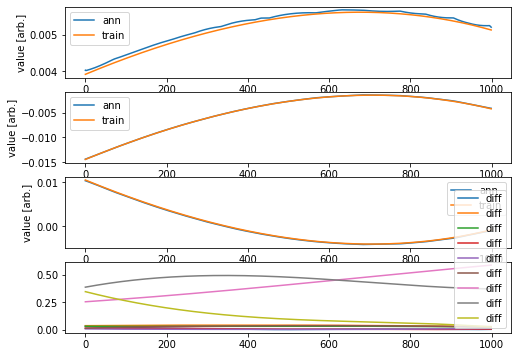

AG


0.0007690669185794137


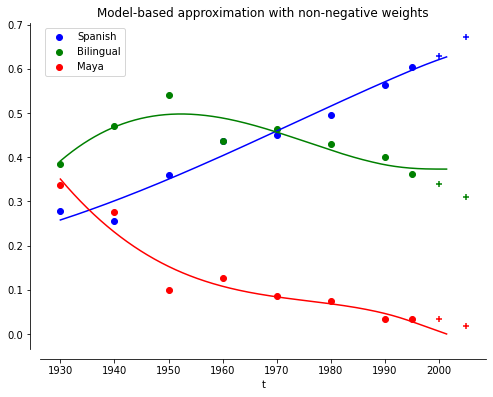

Epoch 1/500
32/32 - 1s - loss: 0.0025 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 7.7284e-05 - 106ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4856e-05 - 111ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.6437e-06 - 109ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.8587e-06 - 115ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 3.7926e-06 - 119ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 3.0416e-06 - 108ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.5211e-06 - 118ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.1183e-06 - 98ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.8165e-06 - 117ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.5699e-06 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.3766e-06 - 103ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.2189e-06 - 116ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0851e-06 - 104ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 9.6803e-07 - 114ms/epoch - 4ms/st

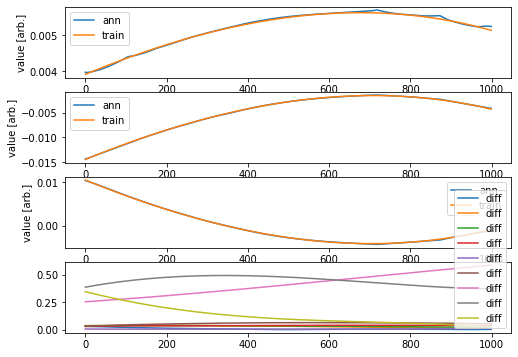

AG


0.0007105936031007846


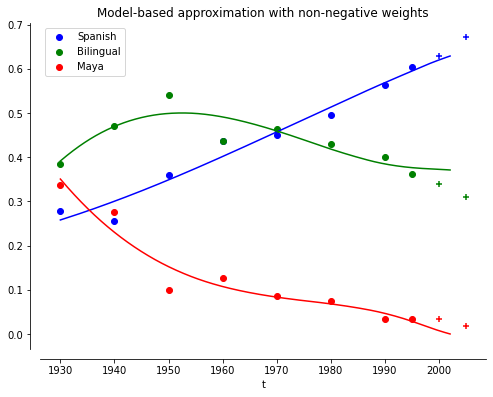

Epoch 1/500
32/32 - 1s - loss: 2.5097e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 5.7903e-06 - 113ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4233e-06 - 120ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 7.6117e-07 - 120ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 4.8320e-07 - 110ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.2298e-07 - 107ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.3252e-07 - 113ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.8246e-07 - 120ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4760e-07 - 118ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2449e-07 - 122ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.0354e-07 - 111ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.9482e-08 - 105ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 8.0297e-08 - 103ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.8454e-08 - 98ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.1749e-08 - 99ms/epoch - 3m

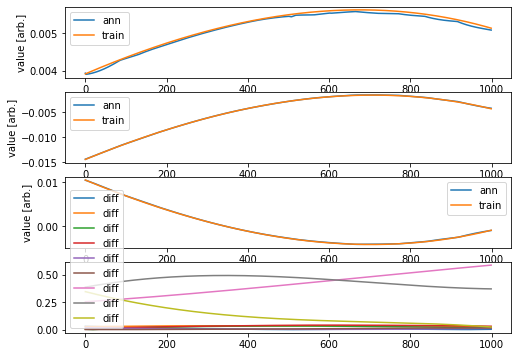

AG


0.000652417295647413


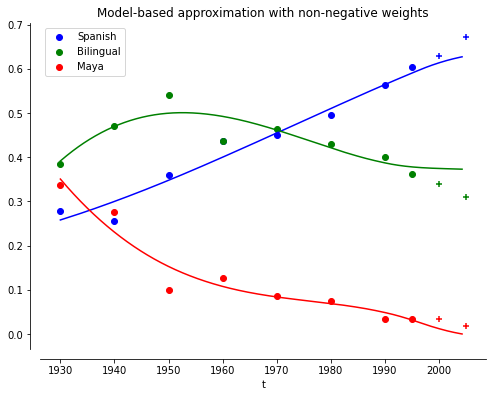

____________________________
Iteración =  8
Min =  0.0004450734935448902
[[0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [0, 1, 1, 1, 1, 0], [1, 1, 0, 0, 1, 0]]
[0.0008204643533100255, 0.0007080179095114976, 0.0004450734935448902, 0.0006205922286291976, 0.0007069993890368036]
Epoch 1/500
32/32 - 1s - loss: 3.5458e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2766e-05 - 117ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 9.5684e-06 - 134ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 9.2063e-06 - 121ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 9.0690e-06 - 115ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.9651e-06 - 107ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.8948e-06 - 99ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.8515e-06 - 103ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.8262e-06 - 108ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.8138e-06 - 105ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.8075e-06

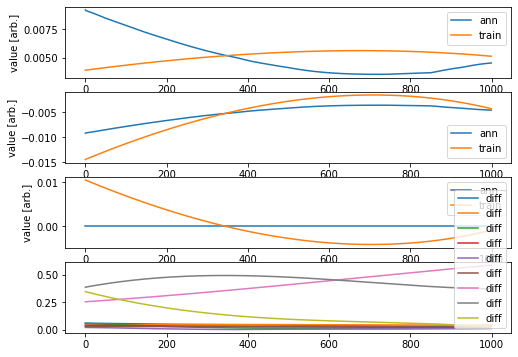

AG


0.0013913055585881957


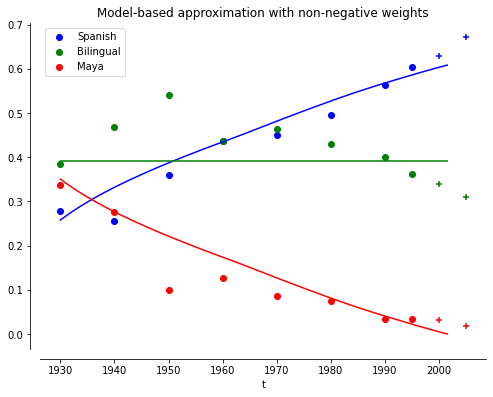

Epoch 1/500
32/32 - 2s - loss: 1.9802e-04 - 2s/epoch - 50ms/step
Epoch 2/500
32/32 - 0s - loss: 1.1459e-05 - 128ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 9.3563e-06 - 138ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 9.1882e-06 - 110ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.0938e-06 - 128ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 9.0195e-06 - 129ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 8.9529e-06 - 121ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 8.9018e-06 - 113ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.8687e-06 - 112ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 8.8501e-06 - 124ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 8.8403e-06 - 133ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 8.8339e-06 - 112ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 8.8288e-06 - 129ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 8.8236e-06 - 115ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 8.8195e-06 - 112ms/epoch - 

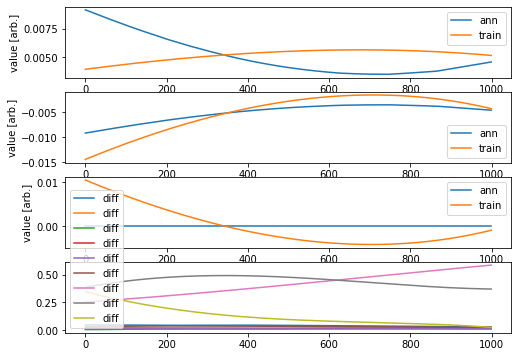

2.1129535852227928e-08


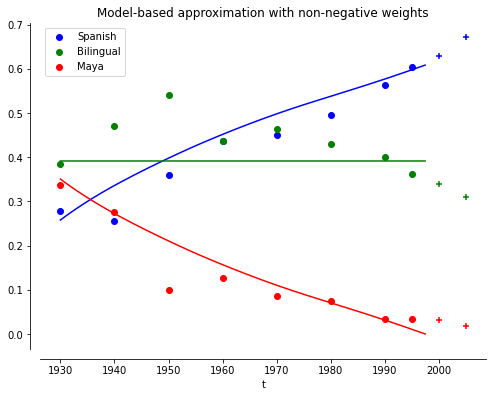

Epoch 1/500
32/32 - 1s - loss: 1.9949e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2452e-05 - 115ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 9.3101e-06 - 99ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 9.0649e-06 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.9498e-06 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.8857e-06 - 103ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.8444e-06 - 105ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.8168e-06 - 115ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.8025e-06 - 97ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.7952e-06 - 107ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.7875e-06 - 110ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.7846e-06 - 120ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 8.7817e-06 - 109ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.7789e-06 - 94ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.7776e-06 - 115ms/epoch - 4ms/s

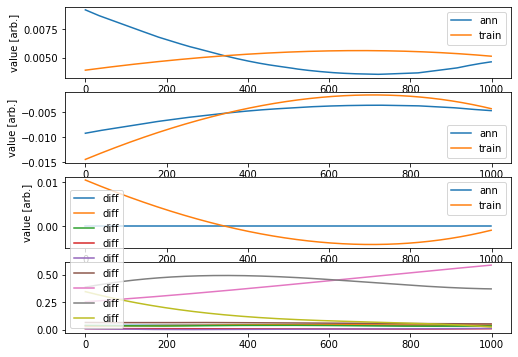

2.7824792763480143e-09


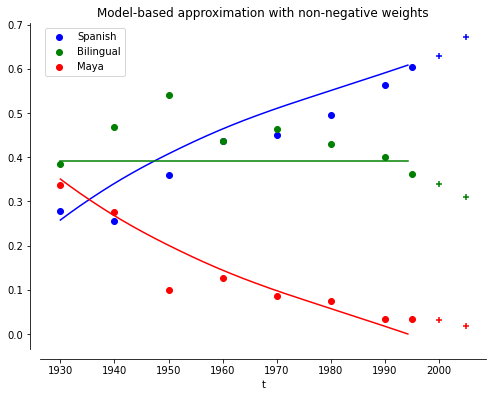

Epoch 1/500
32/32 - 1s - loss: 2.1000e-04 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0049e-05 - 124ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 8.9762e-06 - 122ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 8.8925e-06 - 119ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 8.8561e-06 - 118ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.8272e-06 - 111ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.7985e-06 - 106ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.7867e-06 - 122ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.7769e-06 - 103ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.7724e-06 - 113ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 8.7696e-06 - 121ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 8.7667e-06 - 128ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 8.7651e-06 - 110ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.7639e-06 - 106ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.7631e-06 - 118ms/epoch - 

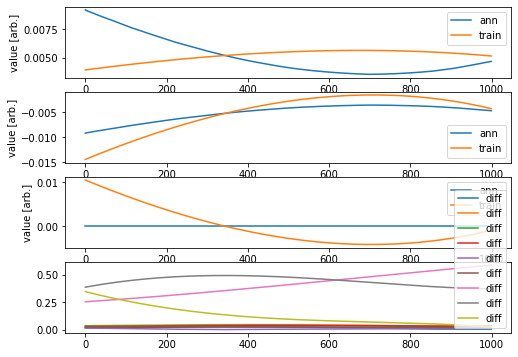

AG
AG


0.008619708697261235


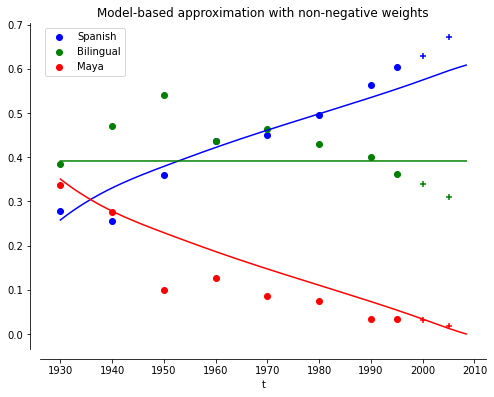

Epoch 1/500
32/32 - 1s - loss: 1.4244e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0584e-05 - 113ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 9.1773e-06 - 114ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 8.9924e-06 - 113ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 8.9078e-06 - 120ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.8599e-06 - 123ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 8.8314e-06 - 122ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 8.8170e-06 - 98ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.8067e-06 - 112ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.7982e-06 - 107ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.7912e-06 - 107ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.7864e-06 - 117ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 8.7814e-06 - 100ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.7783e-06 - 107ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.7740e-06 - 101ms/epoch - 3

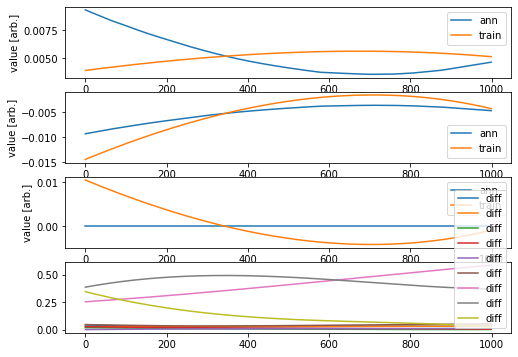

4.161655185001058e-08


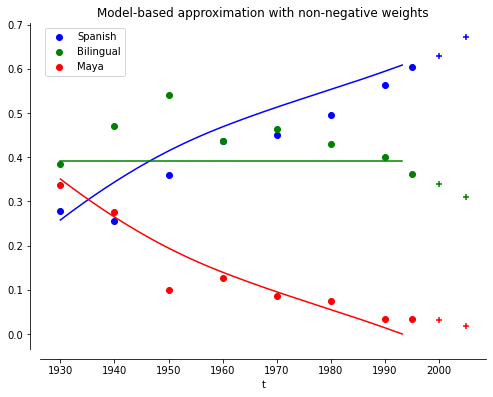

____________________________
Iteración =  9
Min =  0.0004450734935448902
[[0, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [0, 1, 1, 1, 1, 0], [1, 1, 0, 0, 1, 0]]
[0.0008204643533100255, 0.0007080179095114976, 0.0004450734935448902, 0.0006205922286291976, 0.0007069993890368036]
Epoch 1/500
32/32 - 1s - loss: 0.0011 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6750e-05 - 104ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.2953e-06 - 116ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 2.0589e-06 - 106ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.3884e-06 - 99ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0632e-06 - 94ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.1211e-07 - 100ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.1664e-07 - 110ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.2414e-07 - 110ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.4580e-07 - 112ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.7673e-07 - 10

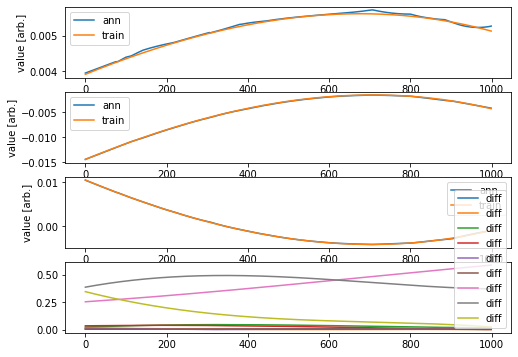

AG


0.0008222980730611283


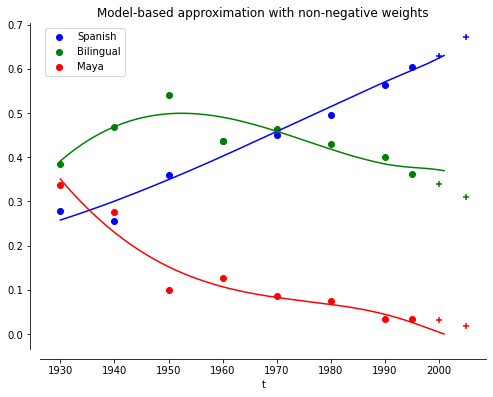

Epoch 1/500
32/32 - 1s - loss: 7.1520e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2654e-05 - 104ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.8606e-06 - 99ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.1769e-06 - 106ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.5659e-07 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.3107e-07 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.2290e-07 - 124ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 6.4556e-07 - 104ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.8318e-07 - 110ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.2784e-07 - 116ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 4.7983e-07 - 113ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 4.3650e-07 - 114ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.9973e-07 - 116ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 3.6534e-07 - 113ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.3653e-07 - 114ms/epoch - 4m

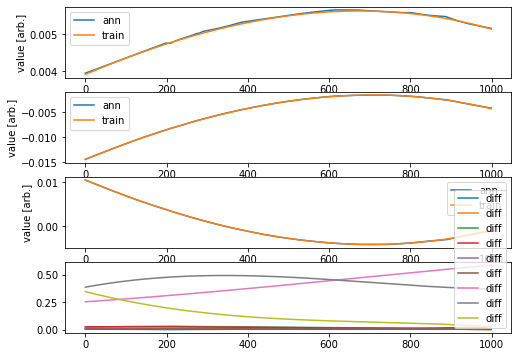

AG


0.0006292875874536858


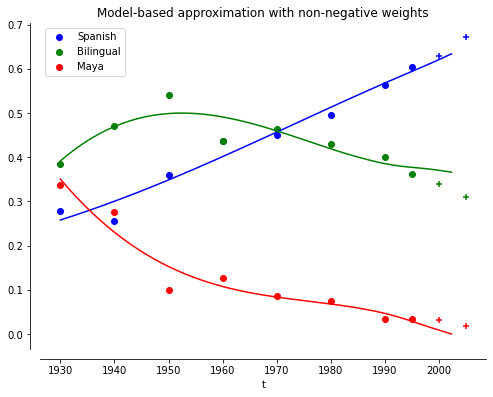

Epoch 1/500
32/32 - 2s - loss: 0.0012 - 2s/epoch - 52ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0554e-05 - 136ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 1.9459e-06 - 118ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.1523e-06 - 93ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.5451e-07 - 111ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.6030e-07 - 96ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.3466e-07 - 100ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.6431e-07 - 110ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.0967e-07 - 101ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.5639e-07 - 101ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.2513e-07 - 98ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.9704e-07 - 125ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.7114e-07 - 102ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.5302e-07 - 103ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.3700e-07 - 99ms/epoch - 3ms/step

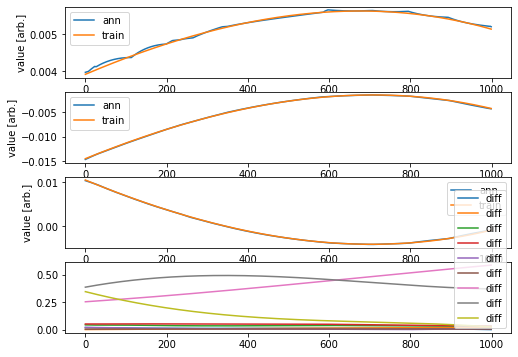

AG


0.0006358336277045672


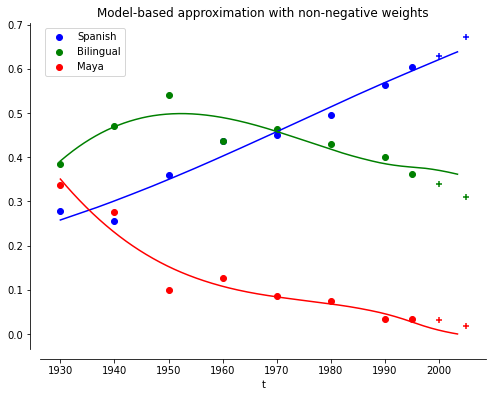

Epoch 1/500
32/32 - 1s - loss: 0.0014 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 1.7403e-05 - 112ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.5664e-06 - 98ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.0485e-06 - 114ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4559e-06 - 122ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 1.1245e-06 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.4330e-07 - 100ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.2711e-07 - 100ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.4331e-07 - 98ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.8810e-07 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.4237e-07 - 94ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.9428e-07 - 101ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.5520e-07 - 95ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.2248e-07 - 98ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.0586e-07 - 107ms/epoch - 3ms/step
Ep

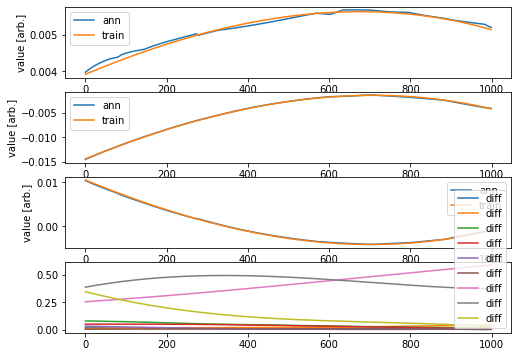

AG


0.0006532170966114112


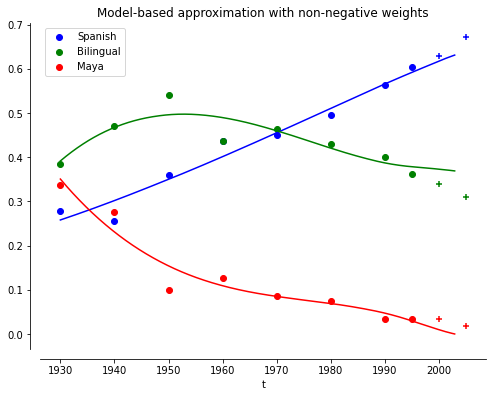

Epoch 1/500
32/32 - 1s - loss: 0.0019 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 2.9236e-05 - 100ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.5046e-06 - 94ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 3.1707e-06 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.5974e-06 - 104ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.2267e-06 - 102ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.9535e-06 - 104ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.6965e-06 - 107ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4956e-06 - 111ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3431e-06 - 101ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.2091e-06 - 97ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.1006e-06 - 98ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0077e-06 - 105ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 9.4610e-07 - 102ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.7011e-07 - 93ms/epoch - 3ms/step


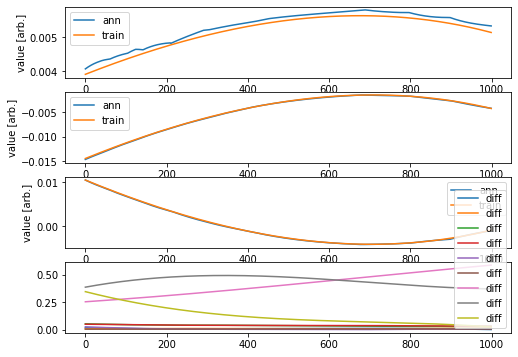

AG


0.0007584965187494231


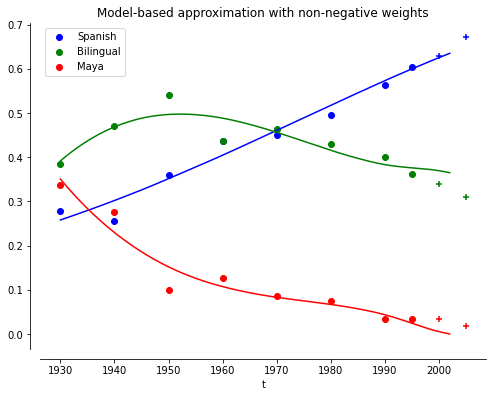

____________________________
Iteración =  10
Min =  0.0004450734935448902
[[1, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 0], [0, 1, 1, 1, 1, 0], [1, 1, 0, 0, 1, 0], [1, 1, 0, 1, 1, 1]]
[0.0007080179095114976, 0.0004450734935448902, 0.0006205922286291976, 0.0007069993890368036, 0.0006998265807160431]


In [ ]:
for it in range(10):
  print("____________________________")
  print("Iteración = ", it)
  print("Min = ", min(medias))
  Mins.append(min(medias))
  print(Pob)
  print(medias)  

  fl = selection(Pob,medias)[0]
  Pob.append(fl)

  i12,i13,i21,i23,i31,i32 = fl #[0, 1, 1, 1, 0, 0]
  totali = []
  for _ in range(iters):
    total = train3(X,Y,B,dX,dY,dB,mode='2')
    while math.isnan(total):
      total = train3(X,Y,B,dX,dY,dB,mode='2')
    totali.append(total)
  totales.append(totali)
  medias.append(sum(totali)/len(totali))

  lP = len(Pob)

  if lP > Kc:
    maxP = max(medias)
    for pi in range(lP):
      if medias[pi] == maxP:
        medias.remove(medias[pi])
        totales.remove(totales[pi])
        Pob.remove(Pob[pi])
        break
  
print("____________________________")
print("Iteración = ", it+1)
print("Min = ", min(medias))
print(Pob)
print(medias)


In [ ]:
print(totales)

[[0.0006903104211627013, 0.0006867192269337334, 0.0007302701892963135, 0.0006493785200977452, 0.0007834111900669948], [0.0008292066889573189, 3.555901207925165e-08, 3.2718918484425683e-08, 0.000642775730886701, 0.0007533167699498672], [0.0008175732980650141, 1.7261603254057985e-08, 0.0008737871090929233, 0.0006343979420949666, 0.0007771855322898305], [0.0007860819915089963, 0.0006168371363474101, 0.0007690669185794137, 0.0007105936031007846, 0.000652417295647413], [0.0008222980730611283, 0.0006292875874536858, 0.0006358336277045672, 0.0006532170966114112, 0.0007584965187494231]]


In [ ]:
selection(Pob,medias)[0]

[0, 1, 0, 1, 0, 0]